In [2]:
import os, glob

import pickle
import numpy as np
import pandas as pd
import lightkurve as lk
import matplotlib.pyplot as plt
from tqdm.auto import tqdm

from astropy.io import fits
from astropy.table import Table

path = os.path.dirname(os.getcwd())
sys.path.append(path)
from kepler_apertures import EXBAMachine

%matplotlib inline
%load_ext line_profiler


Created TAP+ (v1.2.1) - Connection:
	Host: gea.esac.esa.int
	Use HTTPS: True
	Port: 443
	SSL Port: 443
Created TAP+ (v1.2.1) - Connection:
	Host: geadata.esac.esa.int
	Use HTTPS: True
	Port: 443
	SSL Port: 443


In [3]:
quarters = np.arange(5, 18)
channels = np.arange(1, 85)
channels = np.delete(channels, [4,5,6,7])

In [4]:
# histogram with # sources and # quarters available 

In [5]:
big_cat_path = "../data/catalogs/EXBA_catalog_all_sources.csv"
big_df = pd.read_csv(big_cat_path, index_col=0, header=[0, 1])

In [6]:
big_df.head(500).tail(10)

5                                 \
                                       ra  ra_error        dec dec_error   
designation                                                                
Gaia EDR3 2119507467986132992  282.364613  0.108148  46.670020  0.116477   
Gaia EDR3 2119507467986133504  282.355582  0.127348  46.671282  0.127811   
Gaia EDR3 2119507467986133632  282.344831  0.074703  46.671918  0.077101   
Gaia EDR3 2119507467986134784  282.355826  0.189236  46.674860  0.196690   
Gaia EDR3 2119507502345874432  282.363779  0.163140  46.678621  0.170126   
Gaia EDR3 2119507502345876096  282.356345  0.290721  46.688811  0.310135   
Gaia EDR3 2119507506642065664  282.349235  0.094364  46.681543  0.097652   
Gaia EDR3 2119507506642066176  282.363536  0.022259  46.675239  0.023380   
Gaia EDR3 2119507811583514496  282.328912  0.080440  46.655417  0.081947   
Gaia EDR3 2119507815879705984  282.336178  0.056714  46.651357  0.059025   

                                                                            \
                                   pmra     pmdec  parallax parallax_error   
designation                                                                  
Gaia EDR3 2119507467986132992 -1.545840 -1.570931  0.038650       0.118956   
Gaia EDR3 2119507467986133504 -0.826977 -3.851126  0.382827       0.136528   
Gaia EDR3 2119507467986133632 -9.015687 -5.943678  0.374894       0.081721   
Gaia EDR3 2119507467986134784 -1.014073 -3.769438 -0.121982       0.210158   
Gaia EDR3 2119507502345874432 -0.664693 -4.018731  0.337162       0.179385   
Gaia EDR3 2119507502345876096  5.518538 -3.315359  0.806256       0.318507   
Gaia EDR3 2119507506642065664  1.185829  0.920140  0.216201       0.102570   
Gaia EDR3 2119507506642066176 -1.955744 -0.500337  0.624736       0.024447   
Gaia EDR3 2119507811583514496 -2.097588  0.282641  0.131143       0.086444   
Gaia EDR3 2119507815879705984 -0.515528 -4.030103  0.184780       0.061513   

                                                             ...  \
                              phot_g_n_obs phot_g_mean_flux  ...   
designation                                                  ...   
Gaia EDR3 2119507467986132992        359.0       723.203324  ...   
Gaia EDR3 2119507467986133504        345.0       615.154767  ...   
Gaia EDR3 2119507467986133632        341.0      1319.678971  ...   
Gaia EDR3 2119507467986134784        334.0       345.715359  ...   
Gaia EDR3 2119507502345874432        336.0       424.263254  ...   
Gaia EDR3 2119507502345876096        342.0       218.862559  ...   
Gaia EDR3 2119507506642065664        355.0       875.790636  ...   
Gaia EDR3 2119507506642066176        357.0     10782.153025  ...   
Gaia EDR3 2119507811583514496        372.0      1088.124882  ...   
Gaia EDR3 2119507815879705984        388.0      1854.357869  ...   

                                         17                    \
                              phot_rp_n_obs phot_rp_mean_flux   
designation                                                     
Gaia EDR3 2119507467986132992          37.0        506.509574   
Gaia EDR3 2119507467986133504          35.0        522.449711   
Gaia EDR3 2119507467986133632          33.0       1082.282494   
Gaia EDR3 2119507467986134784          31.0        240.754312   
Gaia EDR3 2119507502345874432          34.0        301.754302   
Gaia EDR3 2119507502345876096          33.0        274.057189   
Gaia EDR3 2119507506642065664          37.0        615.515488   
Gaia EDR3 2119507506642066176          37.0       7364.100744   
Gaia EDR3 2119507811583514496          39.0        678.267832   
Gaia EDR3 2119507815879705984          40.0       1327.211265   

                                                                        \
                              phot_rp_mean_flux_error phot_rp_mean_mag   
designation                                                              
Gaia EDR3 2119507467986132992                6.050681        17.986427   
Gaia EDR3

In [44]:
file_count = (np.isfinite(big_df.loc[:, ([str(q) for q in quarters], "channel")]).sum(axis=1).value_counts())

In [45]:
file_count

13    4339
10    1255
6     1238
7     1189
3      704
9      252
4      221
1      109
11       6
8        5
2        5
5        3
12       1
dtype: int64

In [55]:
# total number of LCFs
(file_count.index.values * file_count.values).sum()

90224

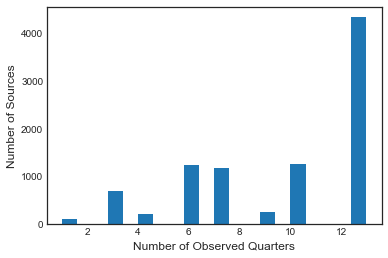

In [9]:
with plt.style.context('seaborn-white'):
    plt.hist(np.isfinite(big_df.loc[:, ([str(q) for q in quarters], "channel")]).sum(axis=1).values, bins=20)
    plt.xlabel("Number of Observed Quarters", fontsize=12)
    plt.ylabel("Number of Sources", fontsize=12)
    
    plt.savefig("../data/figures/paper/source_quarters.pdf", 
                format="pdf", bbox_inches="tight")
    
    plt.show()

# Reduce big catalog

In [11]:
def give_me_full_lc(name):
    print(big_df.loc[name, ([str(q) for q in quarters], ["channel"])])
    flc = []
    for q in quarters:
        ch = big_df.loc[name, (str(q), "channel")]
        if np.isfinite(ch):
            try:
                fname = "../data/export/%i/%02i/lc_q%i_ch%02i_%s.fits.gz" % (q, int(ch), q, int(ch), name.replace(" ", "_"))
                lc = lk.KeplerLightCurve.read(fname)
            except FileNotFoundError:
                fname = "../data/export/%i/%02i/lc_%s.fits.gz" % (q, int(ch), name.replace(" ", "_"))
                lc = lk.KeplerLightCurve.read(fname)
            flc.append(lc)
        else:
            continue
    return lk.LightCurveCollection(flc)


apertures = ["O", 1, 2, 3, 4, 5, 6, 7]
names_remove = ['ROW', 'COLUMN', 'FLFRSAPO', 'CRWDSAPO', 'PERCUTO', 'FLFRSAP1', 'CRWDSAP1', 
                'FLFRSAP2', 'CRWDSAP2', 'FLFRSAP3', 'CRWDSAP3', 'FLFRSAP4', 'CRWDSAP4', 
                'FLFRSAP5', 'CRWDSAP5', 'FLFRSAP6', 'CRWDSAP6', 'FLFRSAP7', 'CRWDSAP7', 
                'FILENAME', 'CHANNEL', 'QUARTER', 'OUTPUT', 'MODULE']

def stitch_lcs(flc, aperture="O", plot=False):
    new_flc, scales = [], []
    for i, lc in enumerate(flc):
        flx_complet = lc.meta["FLFRSAP%s" % (str(aperture))]
        flx_crowd = lc.meta["CRWDSAP%s" % (str(aperture))]
        scales.append(flx_complet)
        new_lc = lc.copy()
        # for k in names_remove: 
        #     del new_lc[0].meta[k]
        ext = aperture if aperture != "O" else ""
        new_lc.flux = lc["flux%s" % str(ext)]
        new_lc.flux_err = lc["flux_err%s" % str(ext)]
        for ap in range(1, 8):
            if ap == aperture:
                continue
            new_lc.remove_columns(["flux%s" % str(ap), "flux_err%s" % str(ap)])
        print(new_lc.meta["QUARTER"])
        new_lc.flux = (new_lc.flux.value - (1 - flx_crowd) * np.median(new_lc.flux.value)) * lc.flux.unit
        new_lc = correct_lc(new_lc.normalize(), plot=plot)
        new_flc.append(new_lc * flx_complet)
    return lk.LightCurveCollection(new_flc).stitch()

def scale_lc(lc, aperture="O"):
    
    if self.meta.get("SCALED"):
        print("Warning: LC has been already scaled")
    
    scale = lc.meta["FLFRSAP%s" % (str(aperture))]
    new_lc = lc.copy()
    
    new_lc.flux = lc.flux * scale
    new_lc.flux_err = lc.flux_err * scale
    
    lc.meta["SCALED"] = True
    return

def correct_lc(lc, plot=False):
    # creating Design matrix
    times = lc.time.jd
    breaks = list(np.where(np.diff(times) > 0.3)[0] + 1)
    # spline DM
    n_knots = int((lc.time[-1] - lc.time[0]).value / 1.5)
    spline_dm = lk.designmatrix.create_spline_matrix(
        times,
        n_knots=n_knots,
        include_intercept=True,
        name="spline_dm",
    )#.split(breaks)
    spline_dm = lk.DesignMatrix(
        spline_dm.X[:, spline_dm.X.sum(axis=0) != 0], name="spline_dm"
    )
    # offset matrix
    offset_dm = lk.DesignMatrix(np.ones_like(times), name="offset")#.split(breaks)
    offset_dm.prior_mu = np.ones(1)
    offset_dm.prior_sigma = np.ones(1) * 0.000001

    # DM with CBVs, first 4 only
    cbvs = lk.correctors.download_kepler_cbvs(
        mission="Kepler", quarter=lc.meta["QUARTER"], channel=lc.meta["CHANNEL"]
    )
    basis = 4
    cbv_dm = cbvs[
        np.in1d(cbvs.cadenceno.value, lc.cadenceno.value)
    ].to_designmatrix()
    cbv_dm = lk.DesignMatrix(cbv_dm.X[:, :basis], name="cbv").split(breaks)
    cbv_dm.prior_mu = np.ones(basis * (len(breaks)+ 1))
    cbv_dm.prior_sigma = np.ones(basis * (len(breaks)+ 1)) * 10

    # collection of DMs
    dmc = lk.DesignMatrixCollection([offset_dm, cbv_dm, spline_dm])
    
    rc = lk.RegressionCorrector(lc)
    clc = rc.correct(dmc, sigma=3)
    if plot:
        rc.diagnose()
        plt.show()
    return clc

# Do one example

In [25]:
duration = np.linspace(0.1, 0.5, 51)
duration

array([0.1  , 0.108, 0.116, 0.124, 0.132, 0.14 , 0.148, 0.156, 0.164,
       0.172, 0.18 , 0.188, 0.196, 0.204, 0.212, 0.22 , 0.228, 0.236,
       0.244, 0.252, 0.26 , 0.268, 0.276, 0.284, 0.292, 0.3  , 0.308,
       0.316, 0.324, 0.332, 0.34 , 0.348, 0.356, 0.364, 0.372, 0.38 ,
       0.388, 0.396, 0.404, 0.412, 0.42 , 0.428, 0.436, 0.444, 0.452,
       0.46 , 0.468, 0.476, 0.484, 0.492, 0.5  ])

In [26]:
def report_source(name, pmin=0.5, pmax=20, ffrac=1000, plot=True, aperture="7"):
    eg = give_me_full_lc(name) 
    if plot:
        eg.plot()
        plt.legend("")
        plt.show()
    
    slc = stitch_lcs(eg, aperture=aperture, plot=plot)
    if plot:
        slc.plot()
        plt.show()
        
    duration = [0.005, 0.0075, 0.01, 0.02, 0.03, 0.05, 0.10, 0.125, 0.15, 0.175, 0.20, 0.25, 0.33, 0.4]
    duration = np.linspace(0.1, 0.5, 51)
    period = 1 / np.linspace(1/pmin, 1/pmax, 10000)
    
    slc = slc.remove_outliers(sigma_lower=1e10, sigma_upper=3)
    periodogram = slc.to_periodogram(method="bls", period=period, frequency_factor=ffrac, duration=duration)
    
    best_fit_period = periodogram.period_at_max_power
    power_amax = np.argmax(periodogram.power)
    power_snr = periodogram.snr[power_amax]
    
    qua = np.isfinite(big_df.loc[name, ([str(q) for q in quarters], "channel")])
    print(big_df.loc[name, str(quarters[qua][0])])
    
    info = ("Period : %.3f d SNR: %.4f \ndepth: %.4f duration: %.4f d" 
            % (best_fit_period.value, power_snr, periodogram.depth_at_max_power.value, periodogram.duration_at_max_power.value))
    
    if plot:
        fig = plt.figure(figsize=(15, 9))

        plt.subplots_adjust(wspace=0.25, hspace=0.25)

        sub1 = fig.add_subplot(2, 2, 1)
        sub1.axvline(
            best_fit_period.value,
            color="r",
            linestyle="--",
            label="Period : %.3f d \nsnr %.4f"
            % (best_fit_period.value, power_snr),
        )
        periodogram.plot(ax=sub1)
        sub1.legend()
        
        fslc = slc.fold(
            period=best_fit_period,
            epoch_time=periodogram.transit_time_at_max_power,
        )

        sub2 = fig.add_subplot(2, 2, 2)
        fslc.errorbar(ax=sub2, alpha=0.8)
        fslc.bin(bins=2500).plot(ax=sub2, alpha=0.8, lw=0, c='k', marker=".", ms=1)

        sub3 = fig.add_subplot(2, 2, (3, 4))
        slc.plot(ax=sub3)
        periodogram.get_transit_model().plot(ax=sub3, color="r")
        plt.show()

        ax = fslc.errorbar(alpha=0.8, c='tab:blue')
        fslc.bin(bins=2500).plot(ax=ax, alpha=0.8, lw=0, c='k', 
                              marker=".", ms=1, 
                              label=info)
        ax.set_xlim(-0.5, 0.5)
        plt.show()
    data_dict = {"period": best_fit_period}
    return slc, periodogram

In [601]:
rr_lyr = ["Gaia EDR3 2126834549053808000", "Gaia EDR3 2076505018468891392", 
          "Gaia EDR3 2126834549053809152", "Gaia EDR3 2076789487048365952"]


5   channel     NaN
6   channel     NaN
7   channel    17.0
8   channel    57.0
9   channel     NaN
10  channel     NaN
11  channel    17.0
12  channel    57.0
13  channel     NaN
14  channel     NaN
15  channel    17.0
16  channel    57.0
17  channel     NaN
Name: Gaia EDR3 2077240046296834304, dtype: float64


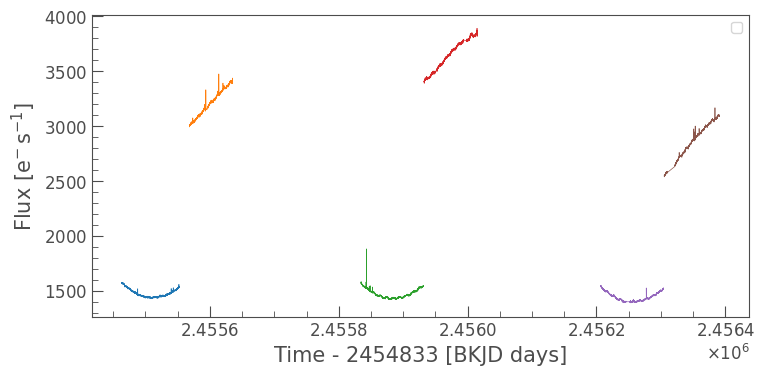

7


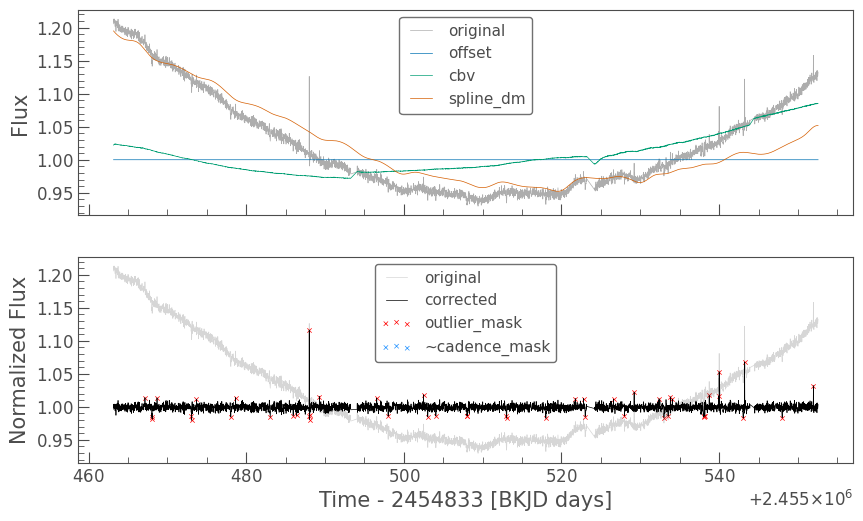

8


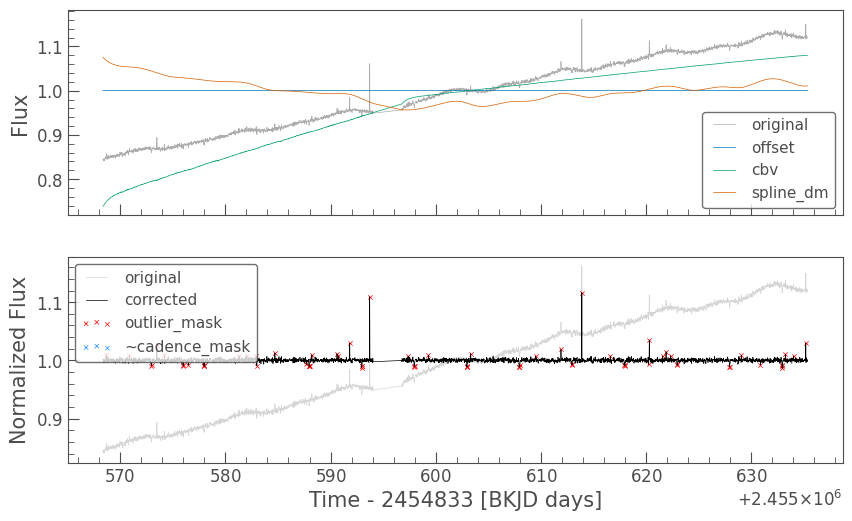

11


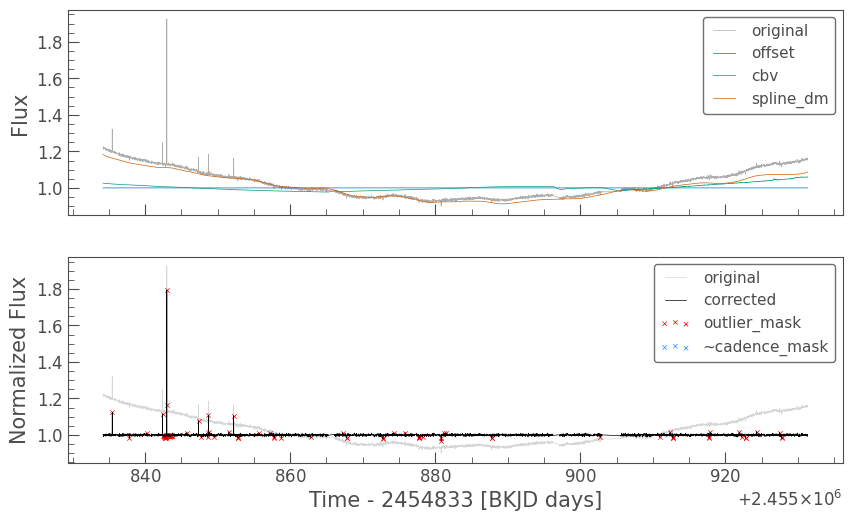

12


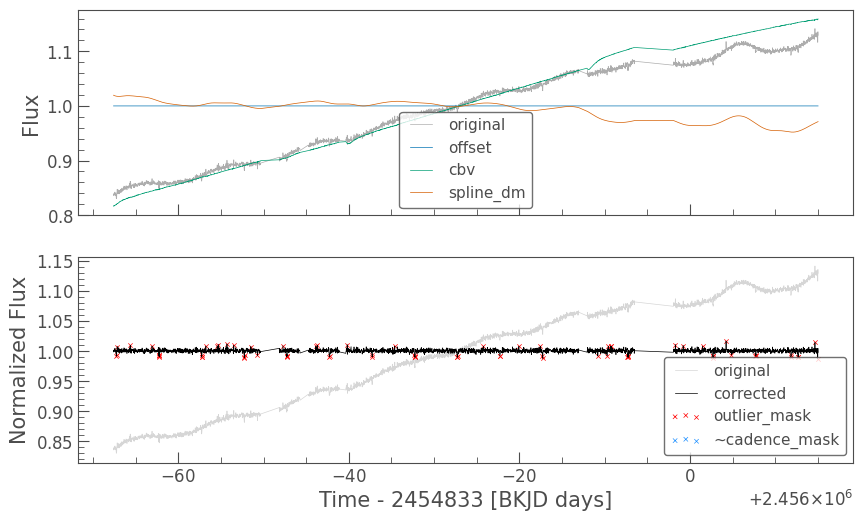

15


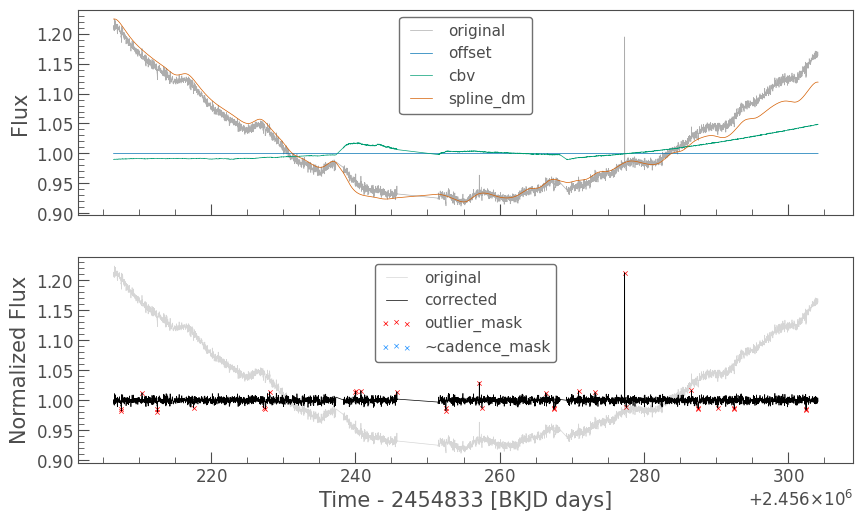

16


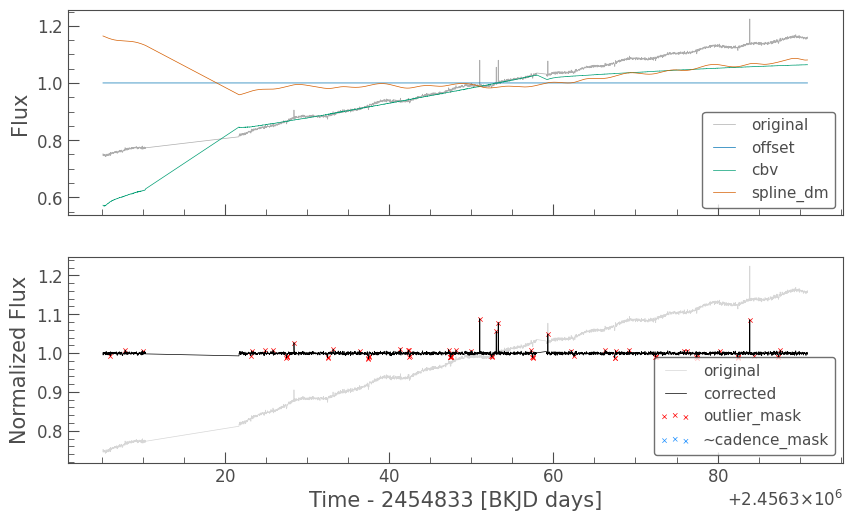

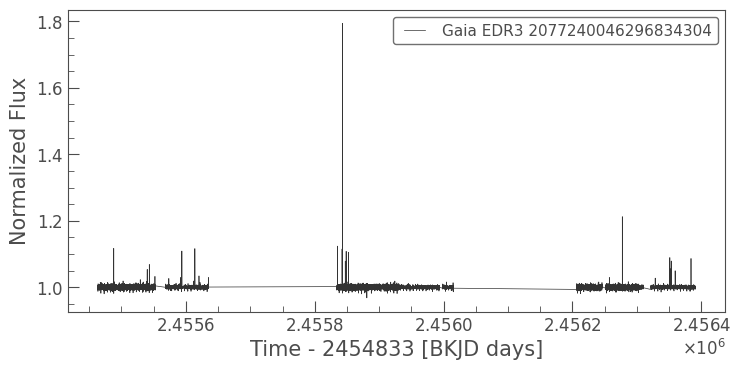

ra                          295.859493
ra_error                      0.132511
dec                          42.713193
dec_error                     0.142235
pmra                         -1.994920
pmdec                        -9.407661
parallax                      1.030341
parallax_error                0.155608
phot_g_n_obs                410.000000
phot_g_mean_flux           4345.644952
phot_g_mean_flux_error       16.552574
phot_g_mean_mag              16.592232
phot_bp_n_obs                46.000000
phot_bp_mean_flux          1716.888633
phot_bp_mean_flux_error       8.338573
phot_bp_mean_mag             17.251686
phot_rp_n_obs                47.000000
phot_rp_mean_flux          4357.314376
phot_rp_mean_flux_error       8.755736
phot_rp_mean_mag             15.649848
col                         555.272134
row                         572.286012
clean_flag                    0.000000
quarter                       7.000000
channel                      17.000000
index                    

/Users/jorgemarpa/.pyenv/versions/adap/lib/python3.8/site-packages/lightkurve/lightcurve.py:876: LightkurveWarning: `epoch_time` appears to be given in JD, however the light curve time uses BKJD (i.e. JD - 2454833).
  warnings.warn(
No period specified. Using period at max power
No duration specified. Using duration at max power
No transit time specified. Using transit time at max power


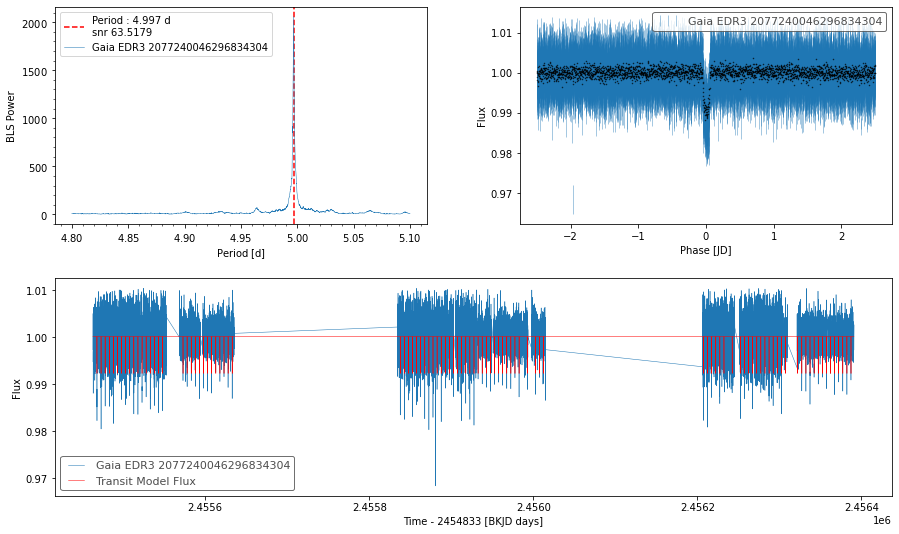

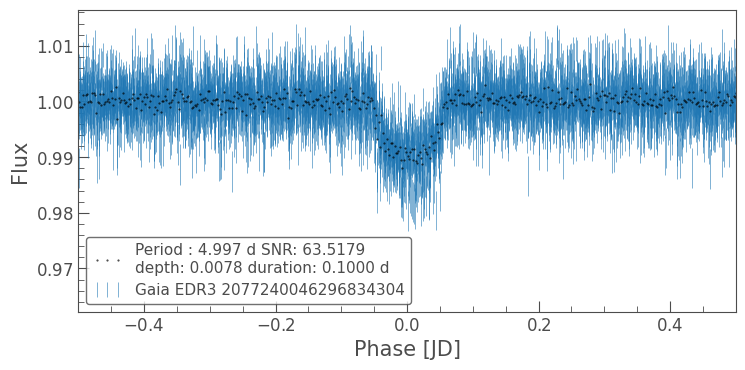

In [27]:
lc, periodogram = report_source("Gaia EDR3 2077240046296834304", aperture="7", pmin=4.8, pmax=5.1, ffrac=1000, plot=True)

In [767]:
# lc = lc.remove_outliers(sigma=10)
print("period      : ", periodogram.period_at_max_power)
print("duration    : ", periodogram.duration_at_max_power)
print("depth       : ", periodogram.depth_at_max_power)
print("transit_time: ", periodogram.transit_time_at_max_power)

period      :  97.67887371320627 d
duration    :  0.14 d
depth       :  0.00865680573873878
transit_time:  2455278.8101431234


In [753]:
flc = lc.fold(period=periodogram.period_at_max_power, 
              epoch_time=periodogram.transit_time_at_max_power)

# bflc = flc.bin(bins=4000, aggregate_func=np.nanmedian)
flc_p = flc[flc.time.value > 0]
flc_n = flc[flc.time.value < 0]
flc_n.time = flc_n.time * -1

/Users/jorgemarpa/.pyenv/versions/adap/lib/python3.8/site-packages/lightkurve/lightcurve.py:876: LightkurveWarning: `epoch_time` appears to be given in JD, however the light curve time uses BKJD (i.e. JD - 2454833).
  warnings.warn(


(-0.01, 0.5)

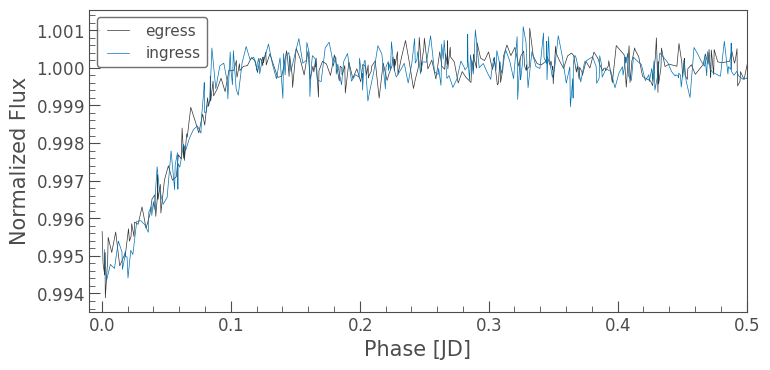

In [758]:
ax = flc_p.plot(label="egress")
flc_n.plot(ax=ax, label="ingress")
ax.set_xlim(-0.01, 0.5)

<AxesSubplot:title={'center':'Gaia EDR3 2128156948006546816'}, xlabel='Phase', ylabel='Cycle'>

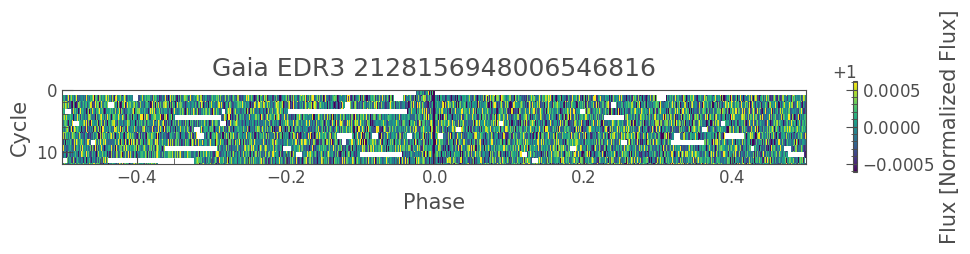

In [744]:
lc.plot_river(periodogram.period_at_max_power, periodogram.transit_time_at_max_power)

# Inspect data base

In [12]:
batches = np.arange(1, 95)
batches

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34,
       35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51,
       52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68,
       69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85,
       86, 87, 88, 89, 90, 91, 92, 93, 94])

In [13]:
bls_results_dict = {}
power, frequency = [], []
for batch in tqdm(batches, desc="Batches"):
    try:
        aux = pd.read_csv("../data/export/long_bls/bls_shortP_results_%02i.csv" % (batch), index_col=0)
        aux2 = pickle.load(open("../data/export/long_bls/bls_shortP_results_%02i.pkl" % (batch), "rb"))
    except FileNotFoundError:
        continue
    aux["batch"] = batch
    bls_results_dict[batch] = aux
    power.append(aux2["power"])
    frequency.append(aux2["frequency"])
bls_results = pd.concat(list(bls_results_dict.values()), axis=0).reset_index()

Batches:   0%|          | 0/94 [00:00<?, ?it/s]

In [14]:
bls_results

,index,designation,BLS_period,BLS_period_SNR,BLS_duration,BLS_depth,BLS_transit_time,batch
0,0,Gaia EDR3 2105384211065299328,0.511571,3.768638,0.45,0.000874,2.455277e+06,1
1,1,Gaia EDR3 2105384241127278208,0.502123,3.386933,0.45,0.000511,2.455277e+06,1
2,2,Gaia EDR3 2105384245425035392,0.535044,4.607028,0.45,0.000180,2.455277e+06,1
3,3,Gaia EDR3 2105384245425036032,0.512035,4.567887,0.45,0.000143,2.455277e+06,1
4,4,Gaia EDR3 2105384275487021696,0.525694,3.776993,0.45,0.000394,2.455277e+06,1
...,...,...,...,...,...,...,...,...
9322,22,Gaia EDR3 2086539951857563136,0.506324,3.567991,0.45,0.004995,2.456016e+06,94
9323,23,Gaia EDR3 2129526011778662272,0.515252,4.468443,0.45,0.008300,2.456107e+06,94
9324,24,Gaia EDR3 2143714973114706560,0.569760,4.087125,0.45,0.000493,2.456392e+06,94
9325,25,Gaia EDR3 2076208704382822912,19.901148,16.093070,0.03,0.016267,2.456395e+06,94


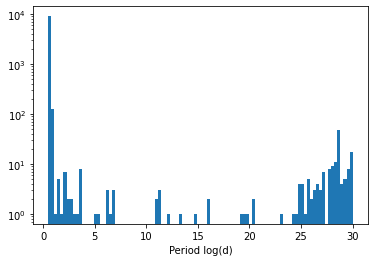

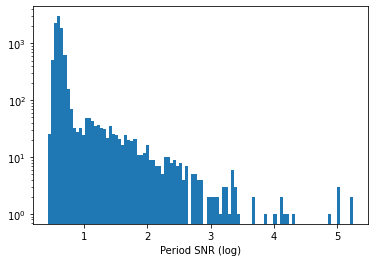

In [15]:
plt.hist(bls_results.BLS_period, bins=100, log=True)
plt.xlabel("Period log(d)")
# plt.xscale("log")
plt.show()

plt.hist(np.log10(bls_results.BLS_period_SNR), bins=100, log=True)
plt.xlabel("Period SNR (log)")
plt.show()

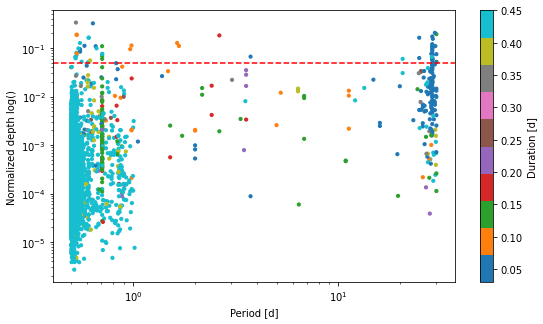

In [16]:
plt.figure(figsize=(9,5))
cbar = plt.scatter(bls_results.BLS_period, bls_results.BLS_depth, c=bls_results.BLS_duration, s=10, cmap="tab10")
plt.colorbar(cbar, label="Duration [d]")
# plt.axvline(0.7, c="r", ls="--")
plt.axhline(0.05, c="r", ls="--")
plt.xscale("log")
plt.yscale("log")
plt.xlabel("Period [d]")
plt.ylabel("Normalized depth log()")
plt.show()

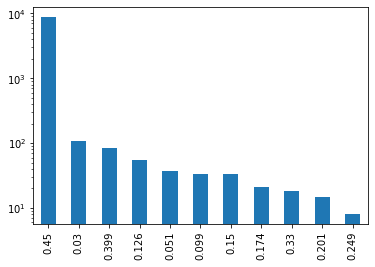

In [17]:
bls_results.BLS_duration.value_counts().plot(kind="bar")
plt.yscale("log")

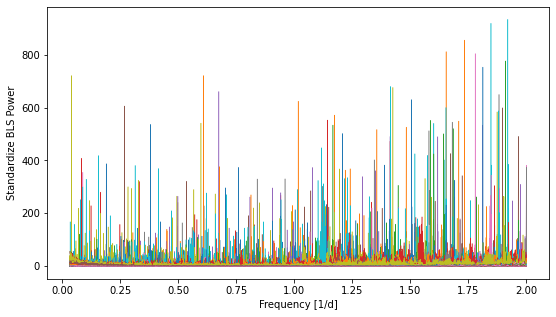

In [18]:
filtered = {}
plt.figure(figsize=(9, 5))
for ic in range(len(power)):
    pmean, pstd = power[ic].mean(), power[ic].std()
    aux = []
    for s in range(power[ic].shape[0]):
        freq = frequency[ic]
        pow = power[ic][s, :]
        pow_n = (pow - pmean) / pstd
        if np.any(pow_n > 50):
            aux.append(s)
        plt.plot(freq, pow_n, lw=0.5)
    filtered[batches[ic]] = aux

    # if ic == 10: break
        
plt.xlabel("Frequency [1/d]")
plt.ylabel("Standardize BLS Power")
plt.show()


In [19]:
from_whitening = pd.concat([bls_results_dict[i].loc[filtered[i]] for i in batches], axis=0).reset_index()
from_whitening

,index,designation,BLS_period,BLS_period_SNR,BLS_duration,BLS_depth,BLS_transit_time,batch
0,97,Gaia EDR3 2104814389164263168,0.595171,1497.167118,0.051,0.043160,2.455277e+06,1
1,1,Gaia EDR3 2104814453586115328,0.595171,429.935983,0.051,0.003186,2.455277e+06,2
2,42,Gaia EDR3 2116940078273294976,0.690936,638.984565,0.450,0.000375,2.455277e+06,2
3,85,Gaia EDR3 2100490555389337984,0.580361,1095.924153,0.051,0.111263,2.455277e+06,2
4,45,Gaia EDR3 2099202344379380864,0.516771,8.568141,0.450,0.000021,2.455277e+06,4
...,...,...,...,...,...,...,...,...
150,77,Gaia EDR3 2105956644307237760,0.604010,97.126891,0.450,0.000111,2.455569e+06,91
151,78,Gaia EDR3 2105956644307734016,28.328454,187.423462,0.126,0.001588,2.455581e+06,91
152,63,Gaia EDR3 2126185081280264192,0.645087,370.167120,0.450,0.019104,2.455569e+06,92
153,98,Gaia EDR3 2078734140854317440,0.525966,304.336778,0.450,0.061087,2.455569e+06,92


In [20]:
from_depth = bls_results.query("BLS_depth < 0.1 and BLS_period_SNR >= 50")
from_depth

,index,designation,BLS_period,BLS_period_SNR,BLS_duration,BLS_depth,BLS_transit_time,batch
97,97,Gaia EDR3 2104814389164263168,0.595171,1497.167118,0.051,0.043160,2.455277e+06,1
101,1,Gaia EDR3 2104814453586115328,0.595171,429.935983,0.051,0.003186,2.455277e+06,2
142,42,Gaia EDR3 2116940078273294976,0.690936,638.984565,0.450,0.000375,2.455277e+06,2
466,66,Gaia EDR3 2107605804371181824,0.817339,69.743893,0.450,0.000026,2.455277e+06,5
549,49,Gaia EDR3 2143714934457116928,0.605737,66.023636,0.450,0.000051,2.455277e+06,6
...,...,...,...,...,...,...,...,...
9114,14,Gaia EDR3 2086538891008244352,0.785760,80.838452,0.450,0.002573,2.455569e+06,92
9115,15,Gaia EDR3 2086538891010054528,0.785760,148.462188,0.450,0.004855,2.455569e+06,92
9162,62,Gaia EDR3 2126185081277282048,0.645169,93.582815,0.399,0.015146,2.455569e+06,92
9163,63,Gaia EDR3 2126185081280264192,0.645087,370.167120,0.450,0.019104,2.455569e+06,92


In [27]:
len(list(set(from_whitening.designation.values.tolist() + from_depth.designation.values.tolist())))

299

In [28]:
to_check = bls_results[np.in1d(bls_results.designation, list(set(from_whitening.designation.values.tolist() + from_depth.designation.values.tolist())))]

In [29]:
to_check

,index,designation,BLS_period,BLS_period_SNR,BLS_duration,BLS_depth,BLS_transit_time,batch
97,97,Gaia EDR3 2104814389164263168,0.595171,1497.167118,0.051,0.043160,2.455277e+06,1
101,1,Gaia EDR3 2104814453586115328,0.595171,429.935983,0.051,0.003186,2.455277e+06,2
142,42,Gaia EDR3 2116940078273294976,0.690936,638.984565,0.450,0.000375,2.455277e+06,2
185,85,Gaia EDR3 2100490555389337984,0.580361,1095.924153,0.051,0.111263,2.455277e+06,2
345,45,Gaia EDR3 2099202344379380864,0.516771,8.568141,0.450,0.000021,2.455277e+06,4
...,...,...,...,...,...,...,...,...
9115,15,Gaia EDR3 2086538891010054528,0.785760,148.462188,0.450,0.004855,2.455569e+06,92
9162,62,Gaia EDR3 2126185081277282048,0.645169,93.582815,0.399,0.015146,2.455569e+06,92
9163,63,Gaia EDR3 2126185081280264192,0.645087,370.167120,0.450,0.019104,2.455569e+06,92
9198,98,Gaia EDR3 2078734140854317440,0.525966,304.336778,0.450,0.061087,2.455569e+06,92


# Plot highlights  

In [41]:
lcs_dict[1][0].time[-1] - lcs_dict[1][0].time[0]

<TimeDelta object: scale='tdb' format='jd' value=1147.51119489735>

index                                          97
designation         Gaia EDR3 2104814389164263168
BLS_period                               0.595171
BLS_period_SNR                        1497.167118
BLS_duration                                0.051
BLS_depth                                 0.04316
BLS_transit_time                   2455276.855354
batch                                           1
Name: 97, dtype: object
ra                          281.863289
ra_error                      0.047834
dec                          42.639542
dec_error                     0.053762
pmra                         -0.952858
pmdec                        -8.116801
parallax                      0.281690
parallax_error                0.055311
phot_g_n_obs                402.000000
phot_g_mean_flux           2165.390437
phot_g_mean_flux_error        7.617895
phot_g_mean_mag              17.348526
phot_bp_n_obs                44.000000
phot_bp_mean_flux          1056.627735
phot_bp_mean_flux_error      1

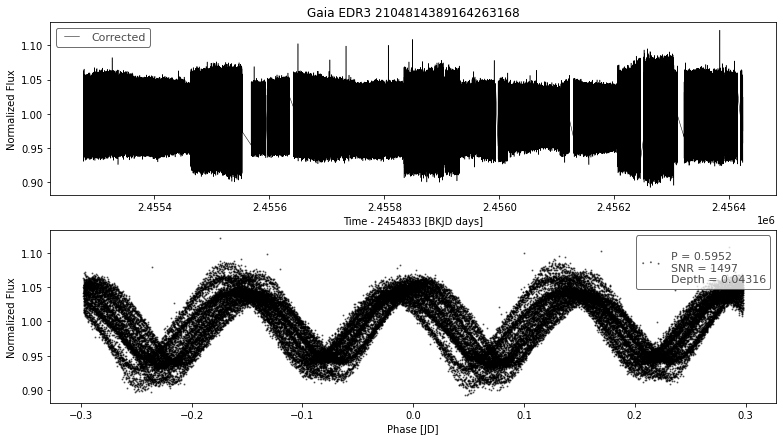

__________________________________________
index                                           1
designation         Gaia EDR3 2104814453586115328
BLS_period                               0.595171
BLS_period_SNR                         429.935983
BLS_duration                                0.051
BLS_depth                                0.003186
BLS_transit_time                   2455276.561354
batch                                           2
Name: 101, dtype: object
ra                           281.858955
ra_error                       0.015171
dec                           42.638243
dec_error                      0.016538
pmra                           1.432249
pmdec                          3.113066
parallax                       1.282674
parallax_error                 0.017256
phot_g_n_obs                 400.000000
phot_g_mean_flux           18968.971170
phot_g_mean_flux_error         8.547072
phot_g_mean_mag               14.992257
phot_bp_n_obs                 44.000000
phot_bp_mean

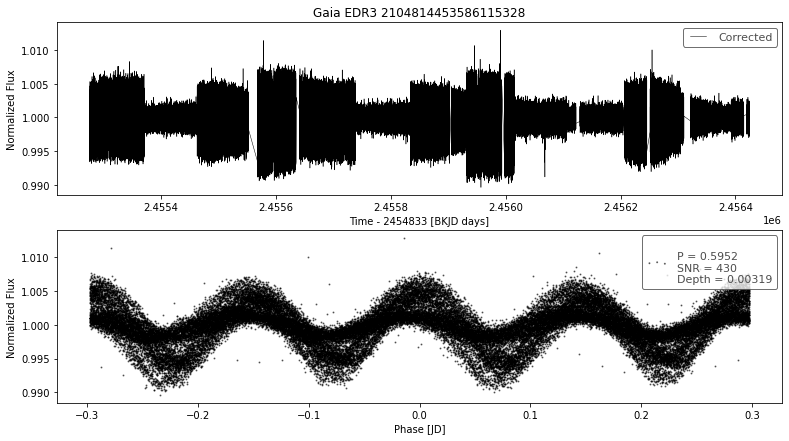

__________________________________________
index                                          42
designation         Gaia EDR3 2116940078273294976
BLS_period                               0.690936
BLS_period_SNR                         638.984565
BLS_duration                                 0.45
BLS_depth                                0.000375
BLS_transit_time                   2455276.937951
batch                                           2
Name: 142, dtype: object
ra                            280.772606
ra_error                        0.009391
dec                            43.551178
dec_error                       0.010715
pmra                           -2.683306
pmdec                          -5.225392
parallax                        1.308065
parallax_error                  0.010950
phot_g_n_obs                  397.000000
phot_g_mean_flux           369202.654881
phot_g_mean_flux_error         56.808254
phot_g_mean_mag                11.769205
phot_bp_n_obs                  46.000000

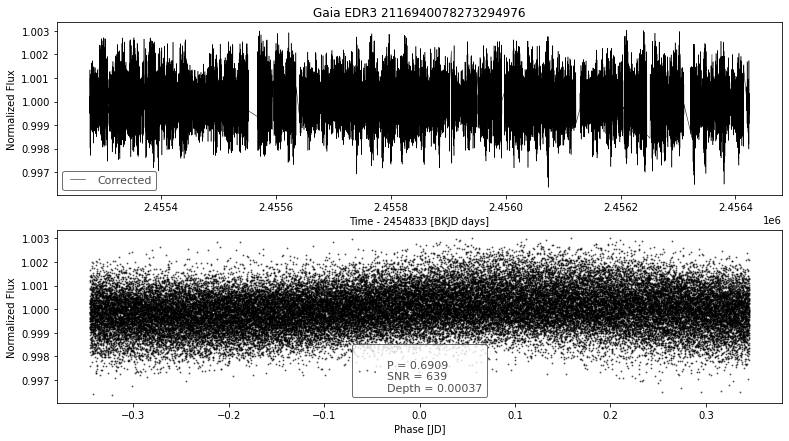

__________________________________________
index                                          85
designation         Gaia EDR3 2100490555389337984
BLS_period                               0.580361
BLS_period_SNR                        1095.924153
BLS_duration                                0.051
BLS_depth                                0.111263
BLS_transit_time                   2455276.824932
batch                                           2
Name: 185, dtype: object
ra                         286.659364
ra_error                     0.104356
dec                         39.717271
dec_error                    0.117824
pmra                        -2.292945
pmdec                       -7.709565
parallax                     0.211536
parallax_error               0.126039
phot_g_n_obs               390.000000
phot_g_mean_flux           626.579080
phot_g_mean_flux_error       2.917055
phot_g_mean_mag             18.694927
phot_bp_n_obs               39.000000
phot_bp_mean_flux          268.242553


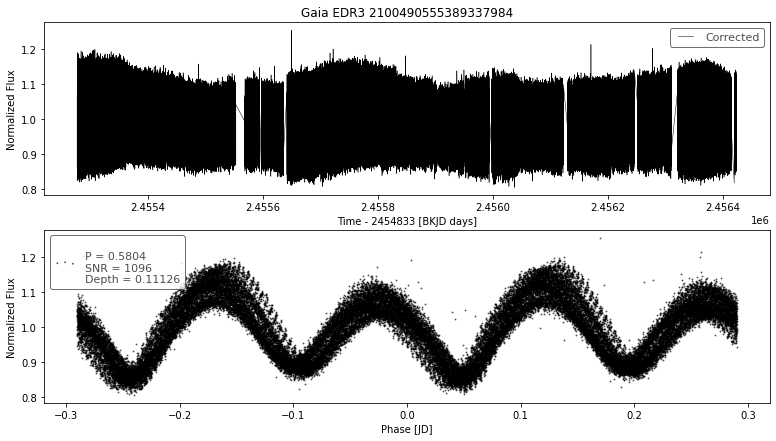

__________________________________________
index                                          45
designation         Gaia EDR3 2099202344379380864
BLS_period                               0.516771
BLS_period_SNR                           8.568141
BLS_duration                                 0.45
BLS_depth                                0.000021
BLS_transit_time                   2455276.772406
batch                                           4
Name: 345, dtype: object
ra                           286.407154
ra_error                       0.009553
dec                           38.131723
dec_error                      0.011699
pmra                         -14.437467
pmdec                        -13.382898
parallax                       0.447436
parallax_error                 0.011864
phot_g_n_obs                 389.000000
phot_g_mean_flux           56772.917977
phot_g_mean_flux_error         7.539156
phot_g_mean_mag               13.802013
phot_bp_n_obs                 42.000000
phot_bp_mean

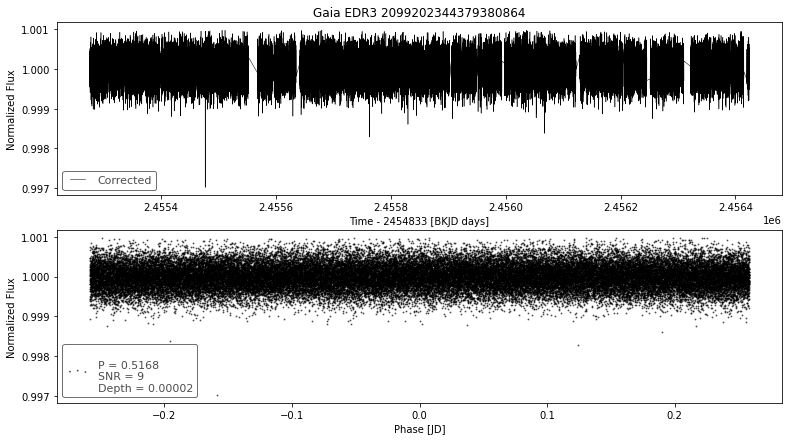

__________________________________________
index                                           8
designation         Gaia EDR3 2100240347774313728
BLS_period                               1.672736
BLS_period_SNR                         335.224454
BLS_duration                                0.099
BLS_depth                                0.109797
BLS_transit_time                       2455276.54
batch                                           5
Name: 408, dtype: object
ra                         285.514700
ra_error                     0.272827
dec                         39.099597
dec_error                    0.334507
pmra                        -0.833320
pmdec                       -3.849202
parallax                    -0.133873
parallax_error               0.337280
phot_g_n_obs               363.000000
phot_g_mean_flux           208.678476
phot_g_mean_flux_error       1.020855
phot_g_mean_mag             19.888672
phot_bp_n_obs               39.000000
phot_bp_mean_flux           97.811692


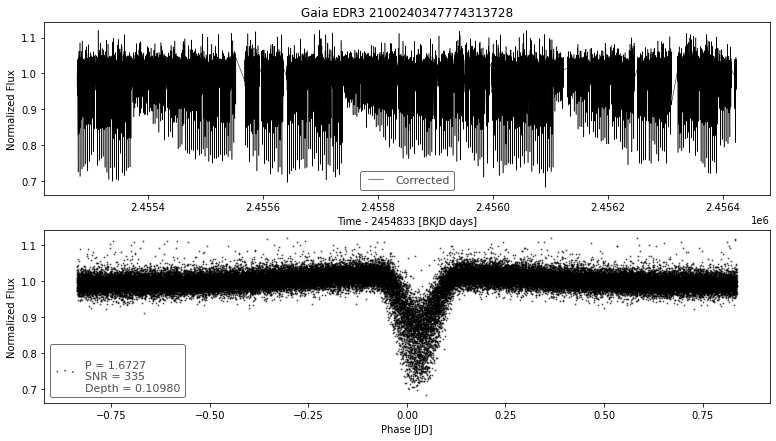

__________________________________________
index                                          66
designation         Gaia EDR3 2107605804371181824
BLS_period                               0.817339
BLS_period_SNR                          69.743893
BLS_duration                                 0.45
BLS_depth                                0.000026
BLS_transit_time                    2455277.06383
batch                                           5
Name: 466, dtype: object
ra                         2.837491e+02
ra_error                   1.234714e-02
dec                        4.740141e+01
dec_error                  1.392082e-02
pmra                      -1.407482e+00
pmdec                     -6.088671e+00
parallax                   5.011329e-01
parallax_error             1.359865e-02
phot_g_n_obs               3.670000e+02
phot_g_mean_flux           1.224846e+06
phot_g_mean_flux_error     4.812405e+02
phot_g_mean_mag            1.046716e+01
phot_bp_n_obs              4.100000e+01
phot_bp_mean

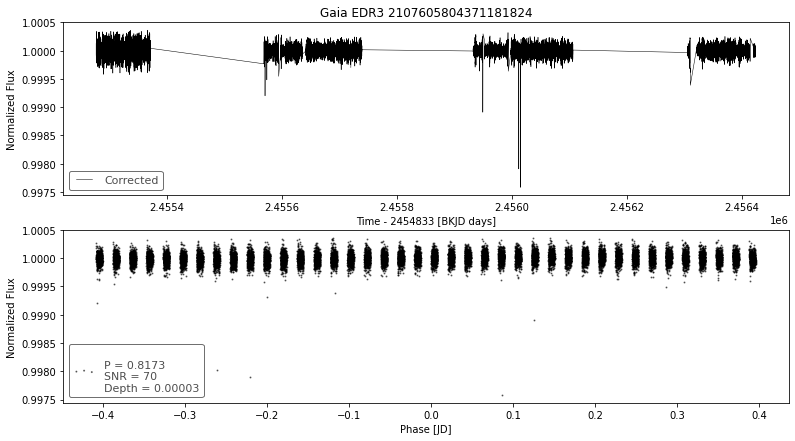

__________________________________________
index                                          49
designation         Gaia EDR3 2143714934457116928
BLS_period                               0.605737
BLS_period_SNR                          66.023636
BLS_duration                                 0.45
BLS_depth                                0.000051
BLS_transit_time                   2455276.862918
batch                                           6
Name: 549, dtype: object
ra                            282.720435
ra_error                        0.009462
dec                            48.258944
dec_error                       0.009433
pmra                            2.228803
pmdec                          -2.826559
parallax                        0.505625
parallax_error                  0.009874
phot_g_n_obs                  320.000000
phot_g_mean_flux           217286.831657
phot_g_mean_flux_error         32.753975
phot_g_mean_mag                12.344784
phot_bp_n_obs                  38.000000

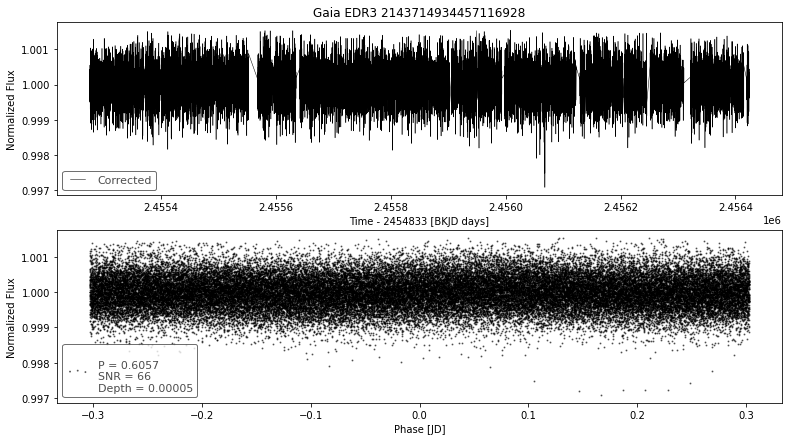

__________________________________________
index                                          81
designation         Gaia EDR3 2107265956496766208
BLS_period                               0.604584
BLS_period_SNR                       15434.251611
BLS_duration                                 0.45
BLS_depth                                0.050878
BLS_transit_time                   2455276.898714
batch                                           6
Name: 581, dtype: object
ra                           285.191785
ra_error                       0.015816
dec                           46.000274
dec_error                      0.017566
pmra                          -3.989429
pmdec                         -8.271337
parallax                       0.415496
parallax_error                 0.018058
phot_g_n_obs                 386.000000
phot_g_mean_flux           17797.969619
phot_g_mean_flux_error        88.418396
phot_g_mean_mag               15.061440
phot_bp_n_obs                 44.000000
phot_bp_mean

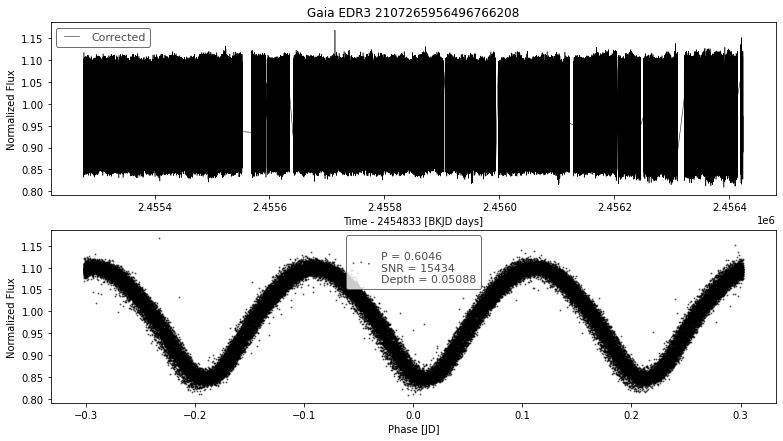

__________________________________________
index                                          11
designation         Gaia EDR3 2107266536313762816
BLS_period                               1.640355
BLS_period_SNR                        2427.490416
BLS_duration                                0.099
BLS_depth                                0.126843
BLS_transit_time                   2455277.341214
batch                                           7
Name: 611, dtype: object
ra                          285.176035
ra_error                      0.230411
dec                          46.016328
dec_error                     0.261470
pmra                         -1.111772
pmdec                        -4.213805
parallax                      0.882440
parallax_error                0.259449
phot_g_n_obs                375.000000
phot_g_mean_flux           1126.626326
phot_g_mean_flux_error        6.935340
phot_g_mean_mag              18.057917
phot_bp_n_obs                42.000000
phot_bp_mean_flux        

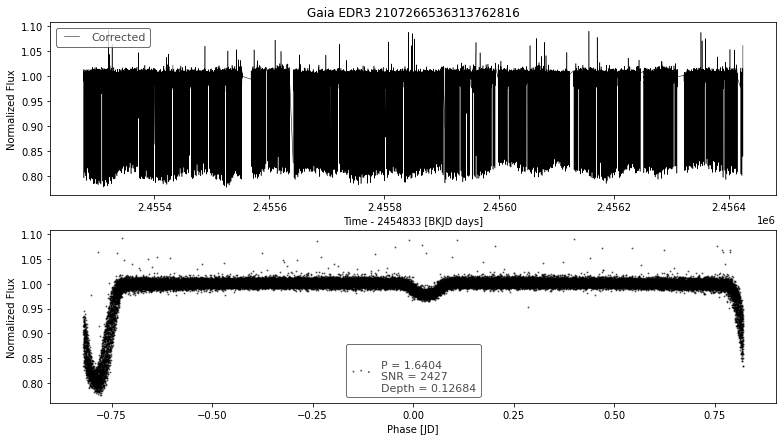

__________________________________________
index                                          39
designation         Gaia EDR3 2106327622103110784
BLS_period                              20.544483
BLS_period_SNR                         363.567451
BLS_duration                                 0.45
BLS_depth                                0.059753
BLS_transit_time                   2455296.879921
batch                                           7
Name: 639, dtype: object
ra                         286.150745
ra_error                     0.126754
dec                         45.048029
dec_error                    0.119900
pmra                        -2.935947
pmdec                       -3.028377
parallax                     0.358029
parallax_error               0.134610
phot_g_n_obs               383.000000
phot_g_mean_flux           598.586058
phot_g_mean_flux_error       0.945055
phot_g_mean_mag             18.744550
phot_bp_n_obs               42.000000
phot_bp_mean_flux          238.630068


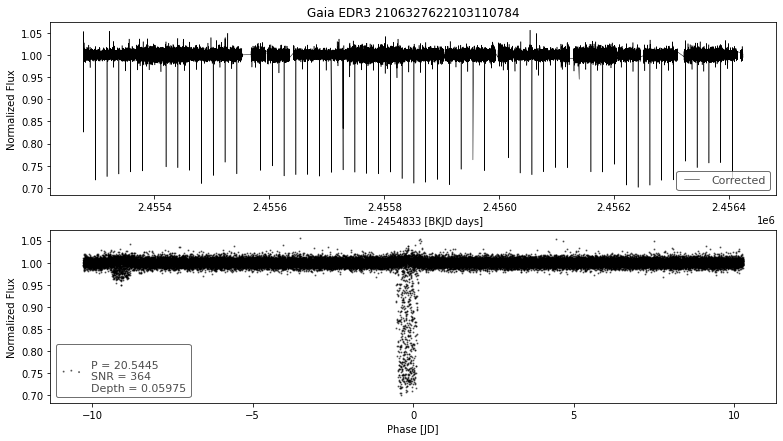

__________________________________________
index                                          43
designation         Gaia EDR3 2106327626401850880
BLS_period                              20.544483
BLS_period_SNR                         140.252085
BLS_duration                                 0.45
BLS_depth                                0.030445
BLS_transit_time                   2455296.839618
batch                                           7
Name: 643, dtype: object
ra                         286.152336
ra_error                     0.321177
dec                         45.047535
dec_error                    0.330142
pmra                        -4.759576
pmdec                       -6.254452
parallax                    -0.331044
parallax_error               0.353882
phot_g_n_obs               340.000000
phot_g_mean_flux           192.671547
phot_g_mean_flux_error       0.718506
phot_g_mean_mag             19.975323
phot_bp_n_obs               35.000000
phot_bp_mean_flux           77.901950


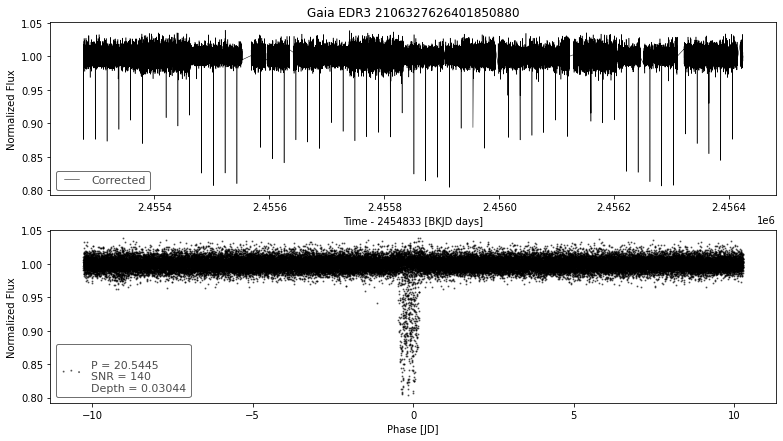

__________________________________________
index                                          20
designation         Gaia EDR3 2105957090984070400
BLS_period                               0.838641
BLS_period_SNR                         254.850049
BLS_duration                                 0.45
BLS_depth                                0.000629
BLS_transit_time                   2455276.778685
batch                                           8
Name: 720, dtype: object
ra                          284.921537
ra_error                      0.045291
dec                          44.400684
dec_error                     0.049286
pmra                         -1.090117
pmdec                        -4.241468
parallax                      0.292438
parallax_error                0.053160
phot_g_n_obs                351.000000
phot_g_mean_flux           2859.634662
phot_g_mean_flux_error        1.891893
phot_g_mean_mag              17.046590
phot_bp_n_obs                36.000000
phot_bp_mean_flux        

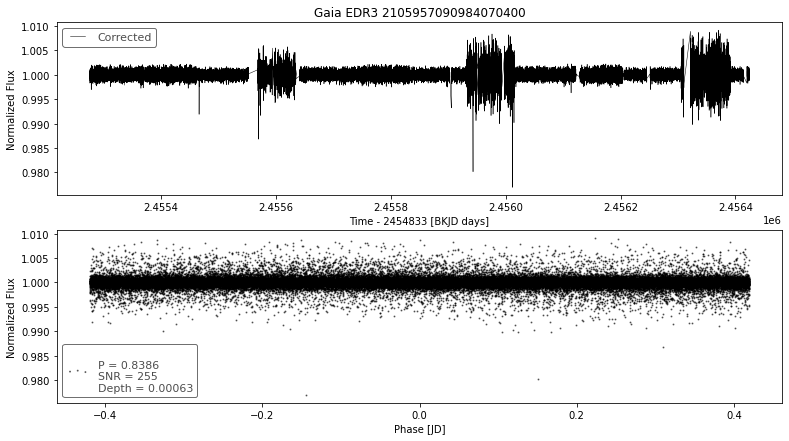

__________________________________________
index                                          22
designation         Gaia EDR3 2105957090984070912
BLS_period                                0.90411
BLS_period_SNR                         308.283926
BLS_duration                                 0.45
BLS_depth                                0.000076
BLS_transit_time                   2455277.027685
batch                                           8
Name: 722, dtype: object
ra                         2.849235e+02
ra_error                   8.711538e-03
dec                        4.440367e+01
dec_error                  9.845341e-03
pmra                      -3.682658e+00
pmdec                     -4.663238e+00
parallax                   6.163078e-01
parallax_error             1.023755e-02
phot_g_n_obs               3.270000e+02
phot_g_mean_flux           1.096770e+06
phot_g_mean_flux_error     1.827012e+02
phot_g_mean_mag            1.058708e+01
phot_bp_n_obs              3.600000e+01
phot_bp_mean

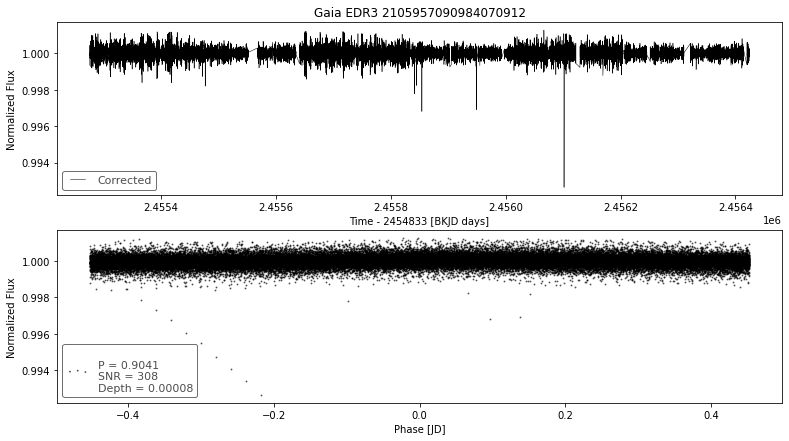

__________________________________________
index                                          54
designation         Gaia EDR3 2102900959754861440
BLS_period                               1.481648
BLS_period_SNR                         520.292406
BLS_duration                                0.099
BLS_depth                                0.033221
BLS_transit_time                   2455276.734874
batch                                           9
Name: 854, dtype: object
ra                         288.472397
ra_error                     0.081316
dec                         42.709240
dec_error                    0.093494
pmra                         0.998662
pmdec                        2.730900
parallax                     0.229695
parallax_error               0.094761
phot_g_n_obs               378.000000
phot_g_mean_flux           979.705539
phot_g_mean_flux_error       2.116154
phot_g_mean_mag             18.209627
phot_bp_n_obs               45.000000
phot_bp_mean_flux          459.439064


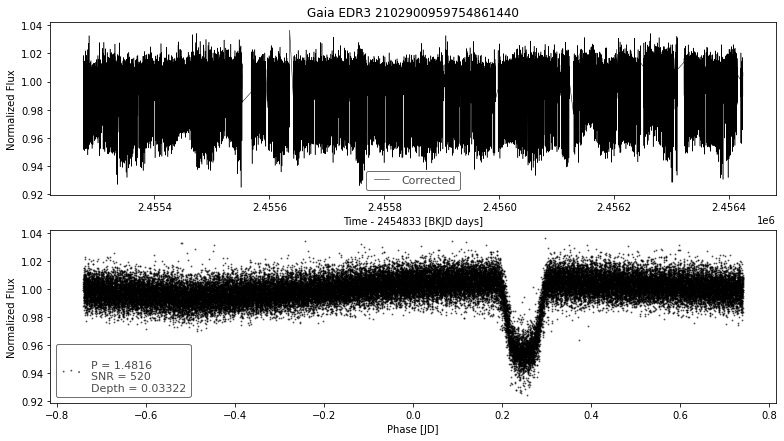

__________________________________________
index                                          61
designation         Gaia EDR3 2102900998414762112
BLS_period                               0.666569
BLS_period_SNR                          50.772398
BLS_duration                                 0.45
BLS_depth                                0.000045
BLS_transit_time                   2455276.955374
batch                                           9
Name: 861, dtype: object
ra                            288.437746
ra_error                        0.009978
dec                            42.713143
dec_error                       0.011100
pmra                           -4.243864
pmdec                          -9.831634
parallax                        0.371046
parallax_error                  0.011444
phot_g_n_obs                  375.000000
phot_g_mean_flux           132969.541018
phot_g_mean_flux_error         22.398970
phot_g_mean_mag                12.877987
phot_bp_n_obs                  44.000000

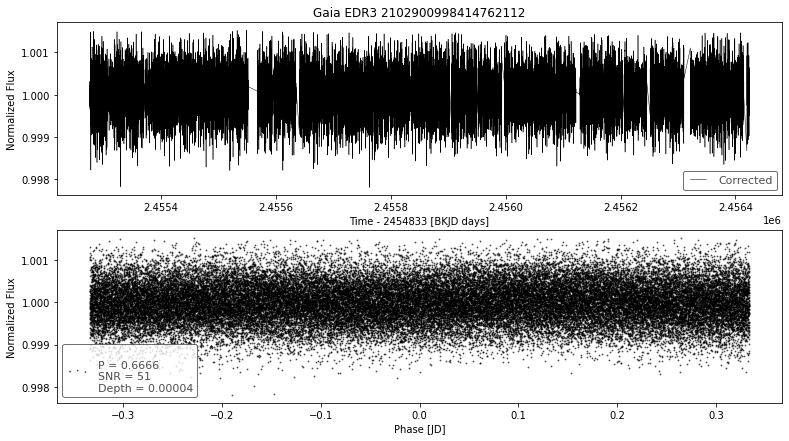

__________________________________________
index                                           4
designation         Gaia EDR3 2102525682694277888
BLS_period                                0.62998
BLS_period_SNR                          52.486763
BLS_duration                                0.399
BLS_depth                                0.004524
BLS_transit_time                   2455276.947874
batch                                          10
Name: 904, dtype: object
ra                         288.432756
ra_error                     0.178000
dec                         42.701193
dec_error                    0.193782
pmra                        -4.104726
pmdec                       -6.913199
parallax                     0.096814
parallax_error               0.202129
phot_g_n_obs               355.000000
phot_g_mean_flux           344.101319
phot_g_mean_flux_error       1.007810
phot_g_mean_mag             19.345652
phot_bp_n_obs               41.000000
phot_bp_mean_flux          141.956427


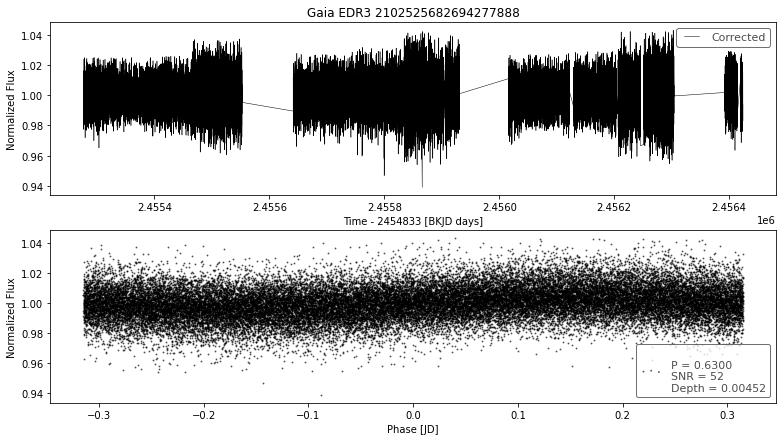

__________________________________________
index                                          71
designation         Gaia EDR3 2105552608144587008
BLS_period                               0.510698
BLS_period_SNR                          74.753604
BLS_duration                                 0.45
BLS_depth                                0.000039
BLS_transit_time                   2455276.742535
batch                                          10
Name: 971, dtype: object
ra                            286.304505
ra_error                        0.009308
dec                            43.036673
dec_error                       0.010325
pmra                           -7.815675
pmdec                           9.117754
parallax                        1.122798
parallax_error                  0.010738
phot_g_n_obs                  381.000000
phot_g_mean_flux           629549.131782
phot_g_mean_flux_error         93.911260
phot_g_mean_mag                11.189793
phot_bp_n_obs                  44.000000

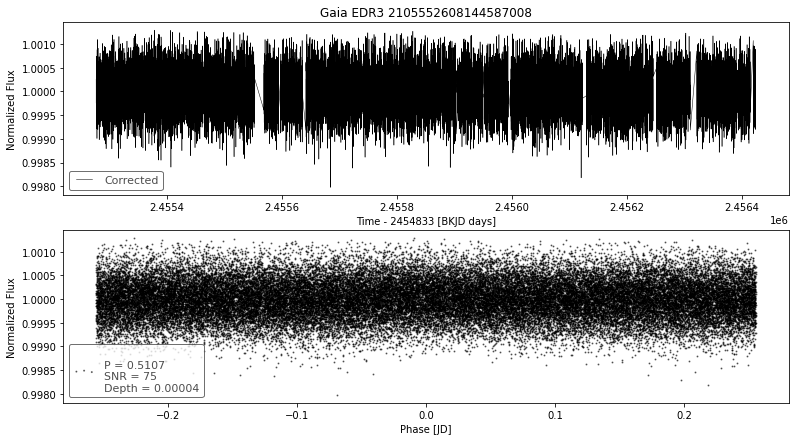

__________________________________________
index                                          89
designation         Gaia EDR3 2101470361990845568
BLS_period                               0.533696
BLS_period_SNR                           34.83383
BLS_duration                                 0.33
BLS_depth                                0.000138
BLS_transit_time                   2455276.868253
batch                                          12
Name: 1189, dtype: object
ra                           289.804001
ra_error                       0.014521
dec                           41.361309
dec_error                      0.016658
pmra                          -2.043260
pmdec                         -5.190858
parallax                       0.123512
parallax_error                 0.017467
phot_g_n_obs                 383.000000
phot_g_mean_flux           21133.100474
phot_g_mean_flux_error         4.743191
phot_g_mean_mag               14.874959
phot_bp_n_obs                 42.000000
phot_bp_mea

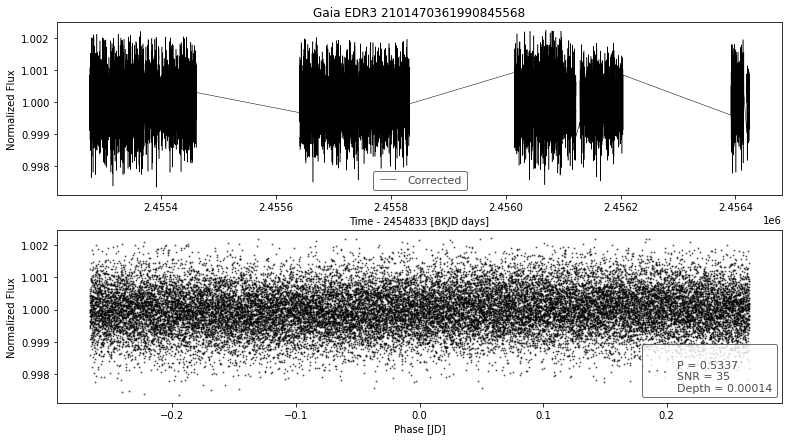

__________________________________________
index                                           1
designation         Gaia EDR3 2101136415390982528
BLS_period                                0.75261
BLS_period_SNR                         527.404346
BLS_duration                                 0.45
BLS_depth                                0.015067
BLS_transit_time                   2455276.745168
batch                                          13
Name: 1201, dtype: object
ra                         290.648252
ra_error                     0.118974
dec                         40.402277
dec_error                    0.120312
pmra                        -2.312777
pmdec                       -1.383678
parallax                     0.154849
parallax_error               0.135582
phot_g_n_obs               365.000000
phot_g_mean_flux           608.539500
phot_g_mean_flux_error       1.045084
phot_g_mean_mag             18.726645
phot_bp_n_obs               29.000000
phot_bp_mean_flux          308.236488

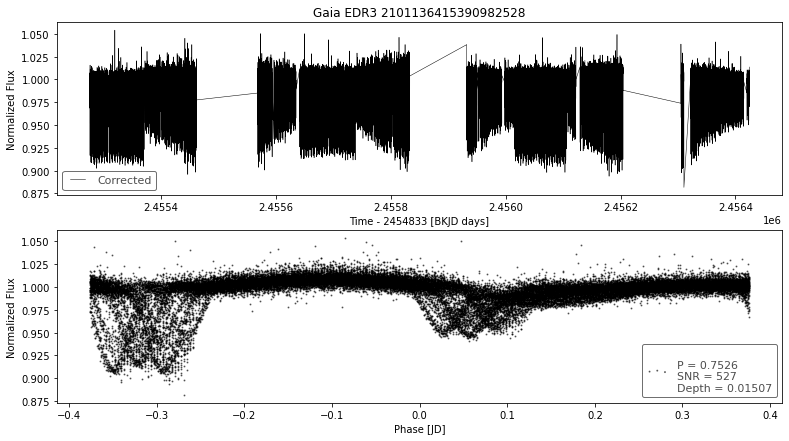

__________________________________________
index                                           9
designation         Gaia EDR3 2101136419694167040
BLS_period                                0.75261
BLS_period_SNR                         708.849025
BLS_duration                                 0.45
BLS_depth                                0.019845
BLS_transit_time                   2455276.754168
batch                                          13
Name: 1209, dtype: object
ra                         290.648045
ra_error                     0.112048
dec                         40.403228
dec_error                    0.110802
pmra                        -1.929957
pmdec                       -3.047022
parallax                     0.795976
parallax_error               0.128643
phot_g_n_obs               382.000000
phot_g_mean_flux           645.300761
phot_g_mean_flux_error       1.908764
phot_g_mean_mag             18.662962
phot_bp_n_obs               38.000000
phot_bp_mean_flux          163.886965

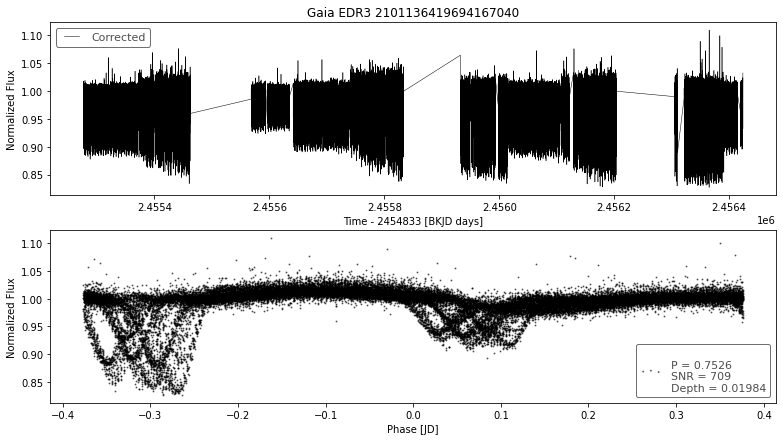

__________________________________________
index                                          10
designation         Gaia EDR3 2101136419694168320
BLS_period                                0.75261
BLS_period_SNR                          78.472982
BLS_duration                                 0.45
BLS_depth                                0.000677
BLS_transit_time                   2455276.751168
batch                                          13
Name: 1210, dtype: object
ra                          290.650615
ra_error                      0.027138
dec                          40.402914
dec_error                     0.027760
pmra                         -3.157111
pmdec                        -5.873823
parallax                      0.116814
parallax_error                0.031374
phot_g_n_obs                397.000000
phot_g_mean_flux           6878.999911
phot_g_mean_flux_error        2.801253
phot_g_mean_mag              16.093554
phot_bp_n_obs                44.000000
phot_bp_mean_flux       

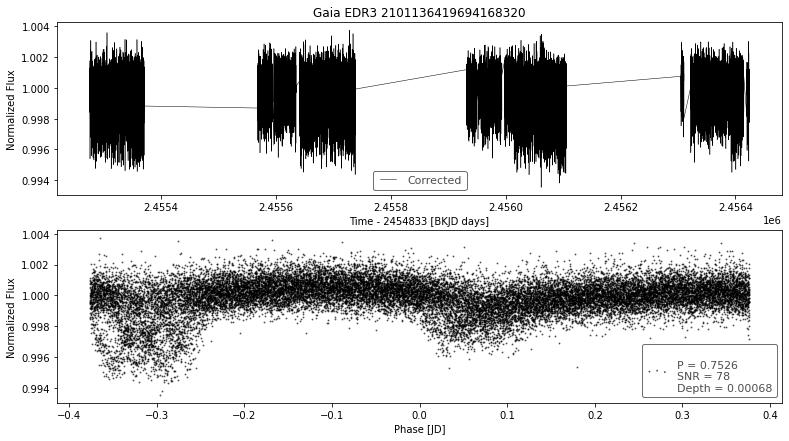

__________________________________________
index                                          84
designation         Gaia EDR3 2101137450481652480
BLS_period                               0.508858
BLS_period_SNR                         753.425405
BLS_duration                                0.399
BLS_depth                                0.001907
BLS_transit_time                   2455276.689668
batch                                          13
Name: 1284, dtype: object
ra                         290.607545
ra_error                     0.218595
dec                         40.429975
dec_error                    0.234198
pmra                        -2.576176
pmdec                       -4.322593
parallax                     0.126451
parallax_error               0.268376
phot_g_n_obs               337.000000
phot_g_mean_flux           319.143815
phot_g_mean_flux_error       1.000543
phot_g_mean_mag             19.427400
phot_bp_n_obs               38.000000
phot_bp_mean_flux          233.283669

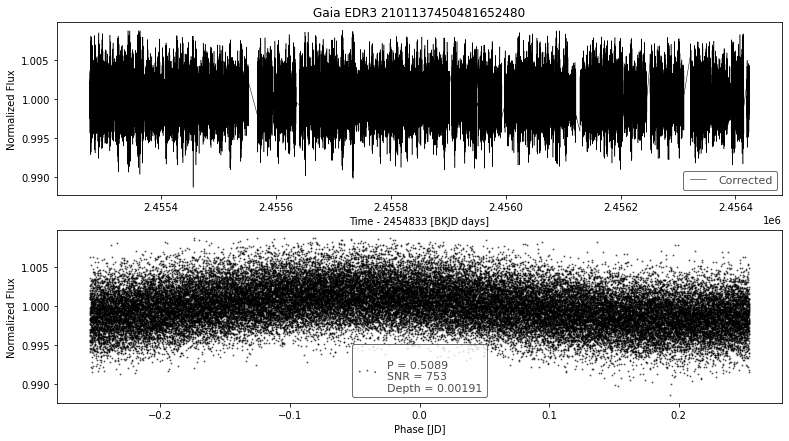

__________________________________________
index                                          85
designation         Gaia EDR3 2101137450486311680
BLS_period                               0.508858
BLS_period_SNR                        1498.473724
BLS_duration                                0.399
BLS_depth                                0.001855
BLS_transit_time                   2455276.689668
batch                                          13
Name: 1285, dtype: object
ra                           290.609050
ra_error                       0.008979
dec                           40.430660
dec_error                      0.009331
pmra                          -3.843077
pmdec                         -8.729809
parallax                       0.678211
parallax_error                 0.010612
phot_g_n_obs                 385.000000
phot_g_mean_flux           95546.363045
phot_g_mean_flux_error        31.946249
phot_g_mean_mag               13.236832
phot_bp_n_obs                 46.000000
phot_bp_mea

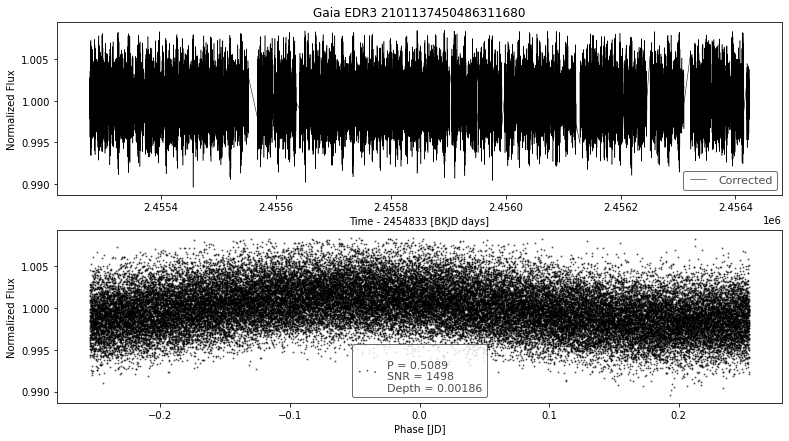

__________________________________________
index                                          25
designation         Gaia EDR3 2101033920292227584
BLS_period                               3.734361
BLS_period_SNR                         363.119929
BLS_duration                                0.051
BLS_depth                                0.066386
BLS_transit_time                   2455280.016742
batch                                          14
Name: 1325, dtype: object
ra                         289.309718
ra_error                     0.254458
dec                         39.745866
dec_error                    0.280828
pmra                        -2.848794
pmdec                      -14.413492
parallax                     1.415738
parallax_error               0.286213
phot_g_n_obs               326.000000
phot_g_mean_flux           241.807617
phot_g_mean_flux_error       1.076640
phot_g_mean_mag             19.728691
phot_bp_n_obs               27.000000
phot_bp_mean_flux           34.156151

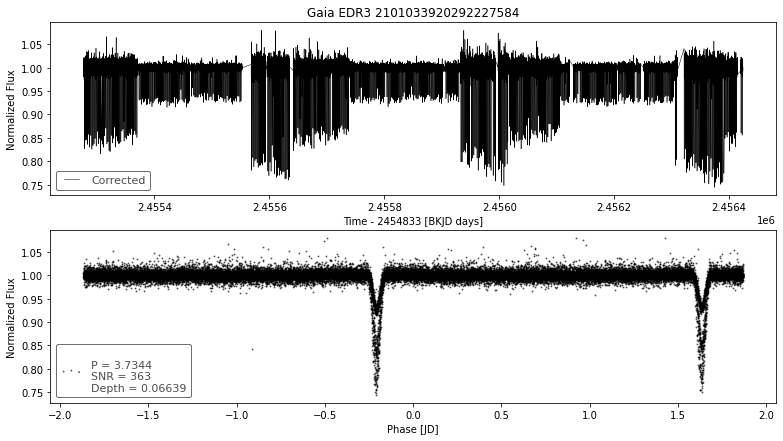

__________________________________________
index                                          20
designation         Gaia EDR3 2052807897189633920
BLS_period                               0.501183
BLS_period_SNR                          63.989817
BLS_duration                                 0.45
BLS_depth                                0.000034
BLS_transit_time                   2455276.745089
batch                                          15
Name: 1420, dtype: object
ra                            290.581264
ra_error                        0.009495
dec                            38.282828
dec_error                       0.011553
pmra                           -2.304885
pmdec                          -2.455049
parallax                        0.888359
parallax_error                  0.012573
phot_g_n_obs                  365.000000
phot_g_mean_flux           763303.601362
phot_g_mean_flux_error        104.370950
phot_g_mean_mag                10.980623
phot_bp_n_obs                  45.00000

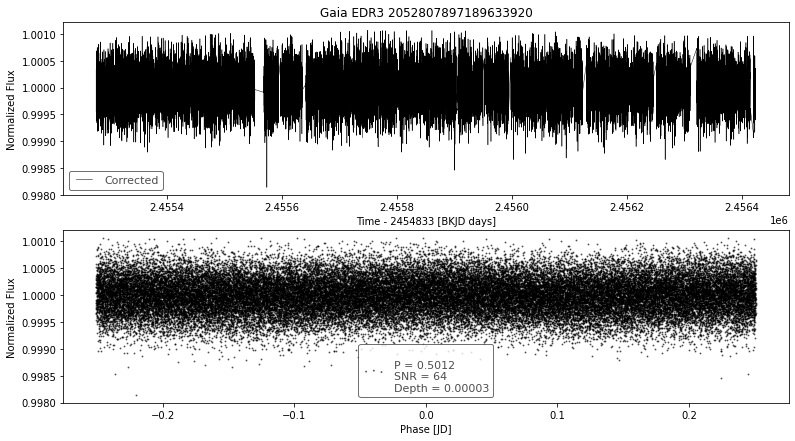

__________________________________________
index                                          79
designation         Gaia EDR3 2052810920846403200
BLS_period                               0.831917
BLS_period_SNR                          64.752463
BLS_duration                                0.174
BLS_depth                                0.001479
BLS_transit_time                   2455277.225089
batch                                          15
Name: 1479, dtype: object
ra                          290.550505
ra_error                      0.048929
dec                          38.295029
dec_error                     0.054298
pmra                         -1.893326
pmdec                        -6.353014
parallax                      0.207130
parallax_error                0.059753
phot_g_n_obs                386.000000
phot_g_mean_flux           2254.273156
phot_g_mean_flux_error        1.733380
phot_g_mean_mag              17.304850
phot_bp_n_obs                44.000000
phot_bp_mean_flux       

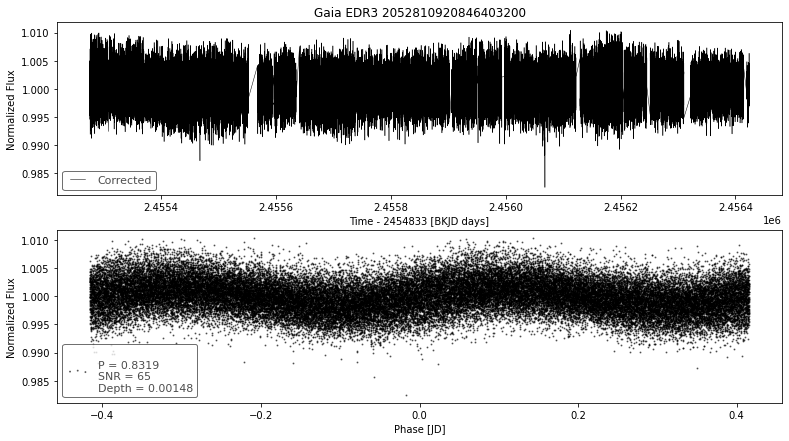

__________________________________________
index                                          87
designation         Gaia EDR3 2052810925146533888
BLS_period                               0.831917
BLS_period_SNR                         148.708832
BLS_duration                                0.174
BLS_depth                                0.006473
BLS_transit_time                   2455277.225089
batch                                          15
Name: 1487, dtype: object
ra                         290.551249
ra_error                     0.094664
dec                         38.296946
dec_error                    0.105008
pmra                        -3.245896
pmdec                       -8.554492
parallax                     0.562416
parallax_error               0.115990
phot_g_n_obs               369.000000
phot_g_mean_flux           933.450101
phot_g_mean_flux_error       1.558715
phot_g_mean_mag             18.262138
phot_bp_n_obs               43.000000
phot_bp_mean_flux          332.435352

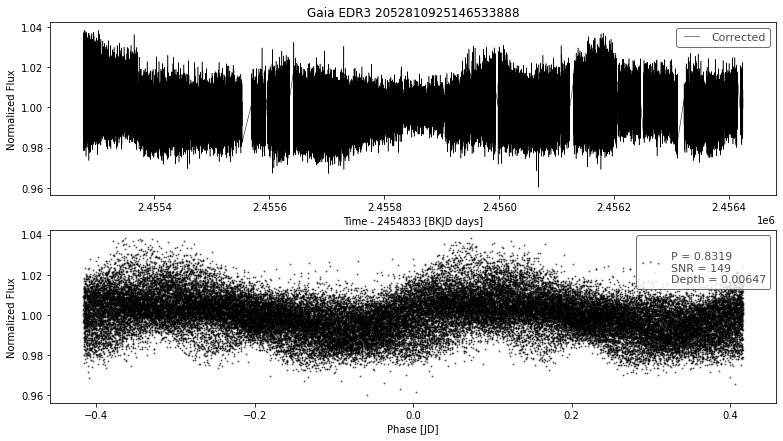

__________________________________________
index                                          15
designation         Gaia EDR3 2052765772152803968
BLS_period                               0.625793
BLS_period_SNR                          19.083086
BLS_duration                                 0.45
BLS_depth                                0.001747
BLS_transit_time                   2455276.895013
batch                                          16
Name: 1515, dtype: object
ra                         291.877625
ra_error                     0.429274
dec                         38.909740
dec_error                    0.446452
pmra                         4.035416
pmdec                       -8.735890
parallax                     2.690173
parallax_error               0.508075
phot_g_n_obs               355.000000
phot_g_mean_flux           514.225848
phot_g_mean_flux_error       3.353283
phot_g_mean_mag             18.909483
phot_bp_n_obs               36.000000
phot_bp_mean_flux           86.636587

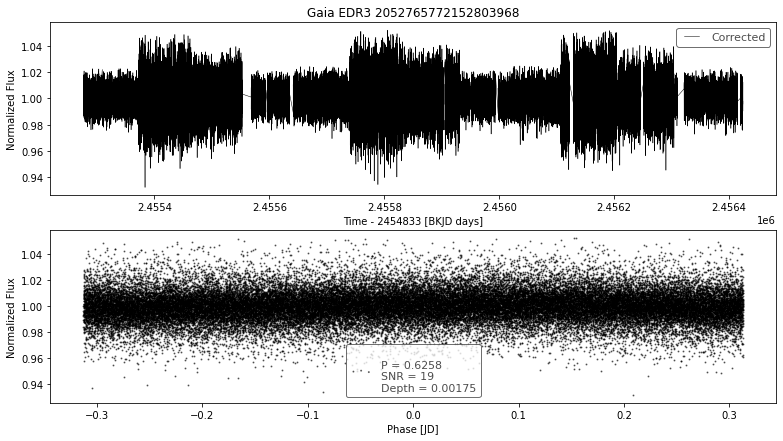

__________________________________________
index                                          69
designation         Gaia EDR3 2052766085686972288
BLS_period                                0.51219
BLS_period_SNR                           8.751104
BLS_duration                                 0.45
BLS_depth                                0.000035
BLS_transit_time                   2455276.760013
batch                                          16
Name: 1569, dtype: object
ra                         291.884126
ra_error                     0.100920
dec                         38.931956
dec_error                    0.102914
pmra                        -2.270503
pmdec                       -8.798534
parallax                     0.155995
parallax_error               0.115549
phot_g_n_obs               347.000000
phot_g_mean_flux           877.222345
phot_g_mean_flux_error       1.376396
phot_g_mean_mag             18.329592
phot_bp_n_obs               38.000000
phot_bp_mean_flux          397.088665

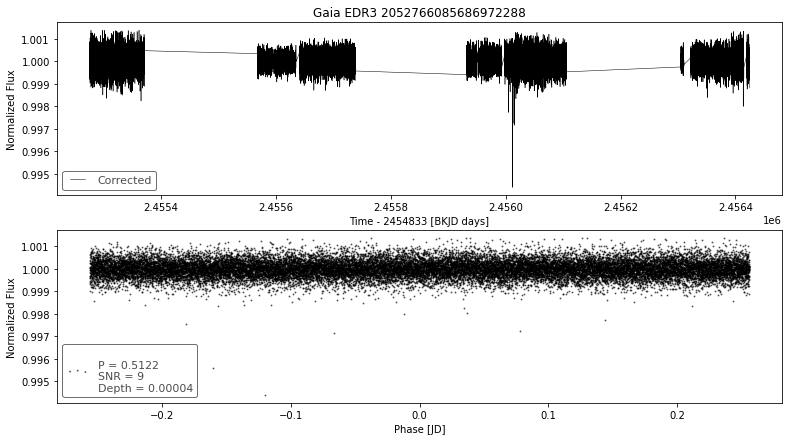

__________________________________________
index                                          70
designation         Gaia EDR3 2052766085691778688
BLS_period                               0.589992
BLS_period_SNR                          13.078693
BLS_duration                                 0.45
BLS_depth                                0.000019
BLS_transit_time                   2455276.850013
batch                                          16
Name: 1570, dtype: object
ra                            291.882166
ra_error                        0.009148
dec                            38.931442
dec_error                       0.010179
pmra                           -8.316030
pmdec                         -28.504449
parallax                        1.065189
parallax_error                  0.011295
phot_g_n_obs                  365.000000
phot_g_mean_flux           131885.686519
phot_g_mean_flux_error         21.109886
phot_g_mean_mag                12.886872
phot_bp_n_obs                  43.00000

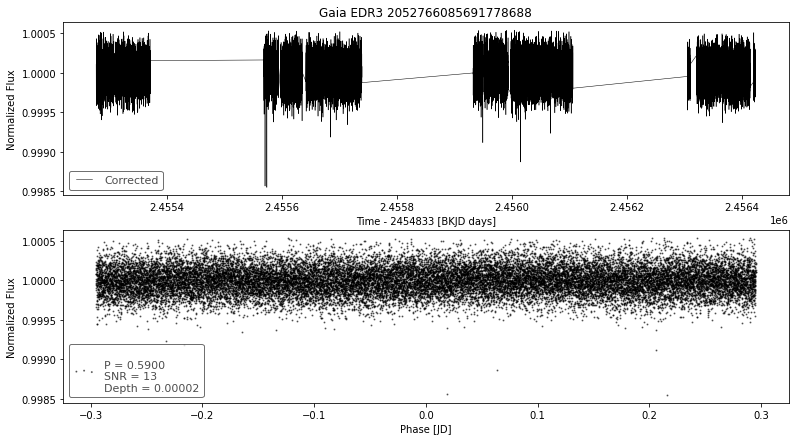

__________________________________________
index                                          45
designation         Gaia EDR3 2051918087349222784
BLS_period                               0.504065
BLS_period_SNR                          10.515032
BLS_duration                                 0.45
BLS_depth                                0.000062
BLS_transit_time                   2455276.729933
batch                                          17
Name: 1645, dtype: object
ra                           292.561704
ra_error                       0.014676
dec                           38.010945
dec_error                      0.017596
pmra                          -6.511927
pmdec                         -5.256048
parallax                       0.202222
parallax_error                 0.019400
phot_g_n_obs                 410.000000
phot_g_mean_flux           20973.629249
phot_g_mean_flux_error         4.536320
phot_g_mean_mag               14.883183
phot_bp_n_obs                 46.000000
phot_bp_mea

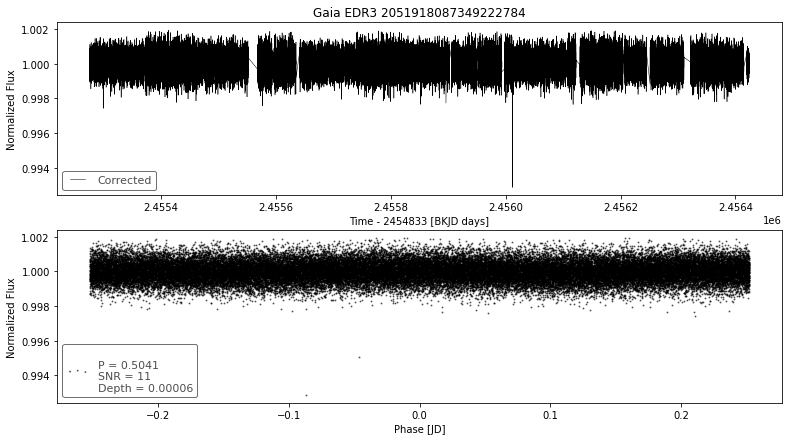

__________________________________________
index                                          72
designation         Gaia EDR3 2051918190428450432
BLS_period                               0.521114
BLS_period_SNR                          16.317144
BLS_duration                                0.399
BLS_depth                                0.000049
BLS_transit_time                   2455276.797433
batch                                          17
Name: 1672, dtype: object
ra                           292.571141
ra_error                       0.012219
dec                           38.024719
dec_error                      0.014268
pmra                          -3.671886
pmdec                         -3.057530
parallax                       0.190496
parallax_error                 0.016129
phot_g_n_obs                 394.000000
phot_g_mean_flux           34810.196549
phot_g_mean_flux_error         5.751831
phot_g_mean_mag               14.333100
phot_bp_n_obs                 44.000000
phot_bp_mea

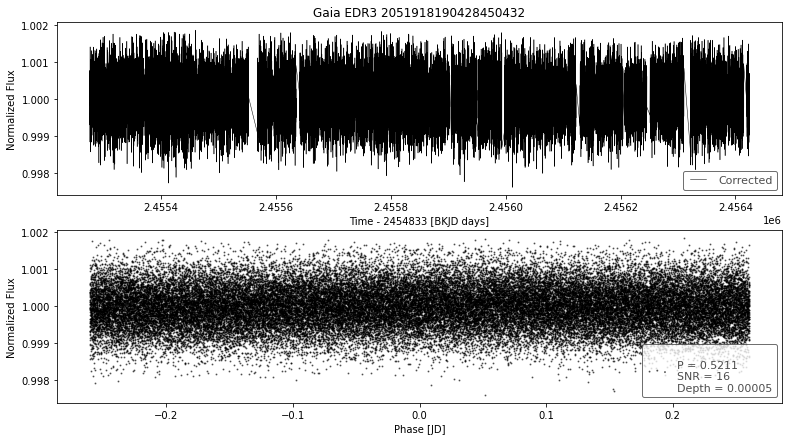

__________________________________________
index                                          88
designation         Gaia EDR3 2051919599177738112
BLS_period                               0.548138
BLS_period_SNR                          14.371393
BLS_duration                                 0.45
BLS_depth                                0.000076
BLS_transit_time                   2455276.747933
batch                                          17
Name: 1688, dtype: object
ra                           292.594135
ra_error                       0.016034
dec                           38.028585
dec_error                      0.018549
pmra                          -2.417704
pmdec                         -2.039332
parallax                       0.096930
parallax_error                 0.019934
phot_g_n_obs                 412.000000
phot_g_mean_flux           18200.020995
phot_g_mean_flux_error         4.148550
phot_g_mean_mag               15.037188
phot_bp_n_obs                 43.000000
phot_bp_mea

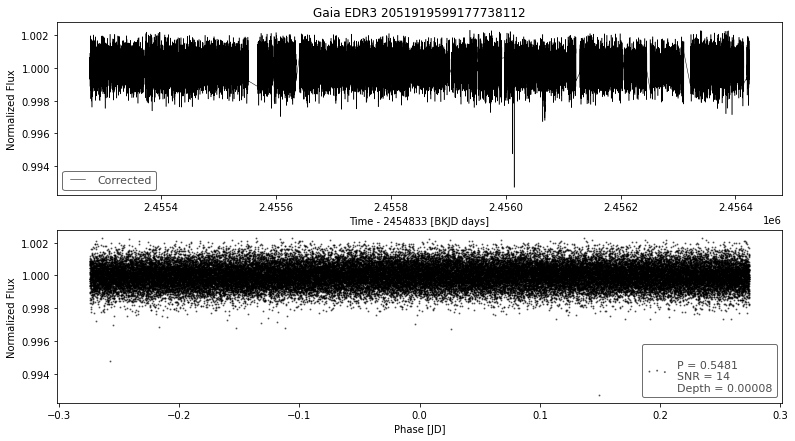

__________________________________________
index                                          47
designation         Gaia EDR3 2051871182004752512
BLS_period                               0.531408
BLS_period_SNR                         633.152174
BLS_duration                                 0.45
BLS_depth                                0.028481
BLS_transit_time                   2455276.762933
batch                                          18
Name: 1747, dtype: object
ra                          292.580673
ra_error                      0.054637
dec                          38.005914
dec_error                     0.061513
pmra                         -0.846513
pmdec                        -4.378393
parallax                      0.072628
parallax_error                0.069332
phot_g_n_obs                431.000000
phot_g_mean_flux           1727.883307
phot_g_mean_flux_error        2.593232
phot_g_mean_mag              17.593580
phot_bp_n_obs                41.000000
phot_bp_mean_flux       

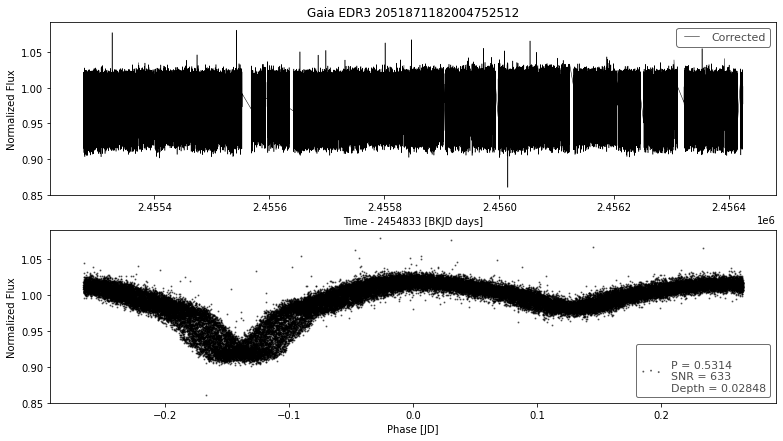

__________________________________________
index                                          41
designation         Gaia EDR3 2051773845167236352
BLS_period                               0.852706
BLS_period_SNR                         260.517212
BLS_duration                                 0.45
BLS_depth                                0.000219
BLS_transit_time                   2455277.150008
batch                                          19
Name: 1841, dtype: object
ra                            291.309928
ra_error                        0.009969
dec                            37.381359
dec_error                       0.011725
pmra                            1.241080
pmdec                          -7.847007
parallax                        1.057866
parallax_error                  0.012738
phot_g_n_obs                  413.000000
phot_g_mean_flux           176492.944840
phot_g_mean_flux_error         29.499056
phot_g_mean_mag                12.570548
phot_bp_n_obs                  51.00000

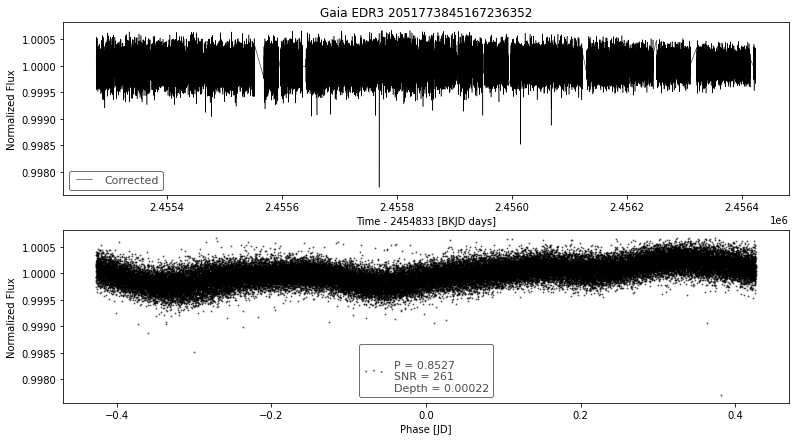

__________________________________________
index                                          61
designation         Gaia EDR3 2051774184464360064
BLS_period                                0.81642
BLS_period_SNR                          194.82915
BLS_duration                                0.099
BLS_depth                                0.010307
BLS_transit_time                   2455276.893508
batch                                          19
Name: 1861, dtype: object
ra                          291.335579
ra_error                      0.055797
dec                          37.388558
dec_error                     0.067964
pmra                         -0.943541
pmdec                        -3.796606
parallax                      0.016041
parallax_error                0.072577
phot_g_n_obs                384.000000
phot_g_mean_flux           1736.074893
phot_g_mean_flux_error        1.848317
phot_g_mean_mag              17.588446
phot_bp_n_obs                43.000000
phot_bp_mean_flux       

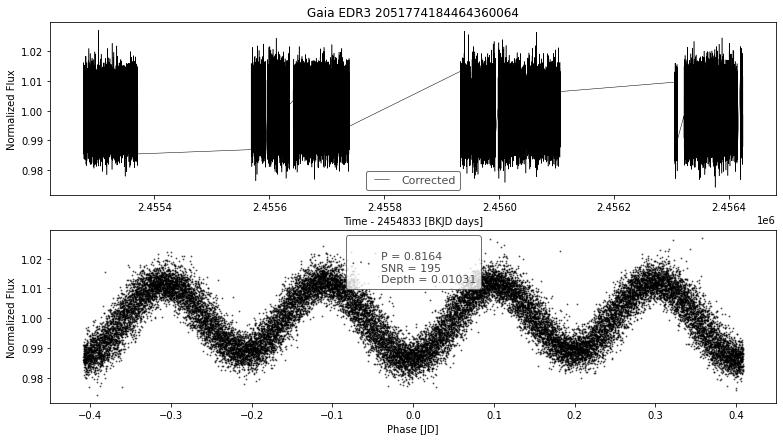

__________________________________________
index                                          28
designation         Gaia EDR3 2131296848274153600
BLS_period                               0.883528
BLS_period_SNR                         272.221286
BLS_duration                                0.201
BLS_depth                                0.000102
BLS_transit_time                   2455276.759168
batch                                          20
Name: 1928, dtype: object
ra                            287.115481
ra_error                        0.007789
dec                            49.124010
dec_error                       0.007975
pmra                           -5.970135
pmdec                          -6.995733
parallax                        0.922842
parallax_error                  0.008356
phot_g_n_obs                  405.000000
phot_g_mean_flux           942532.292924
phot_g_mean_flux_error        117.793434
phot_g_mean_mag                10.751626
phot_bp_n_obs                  42.00000

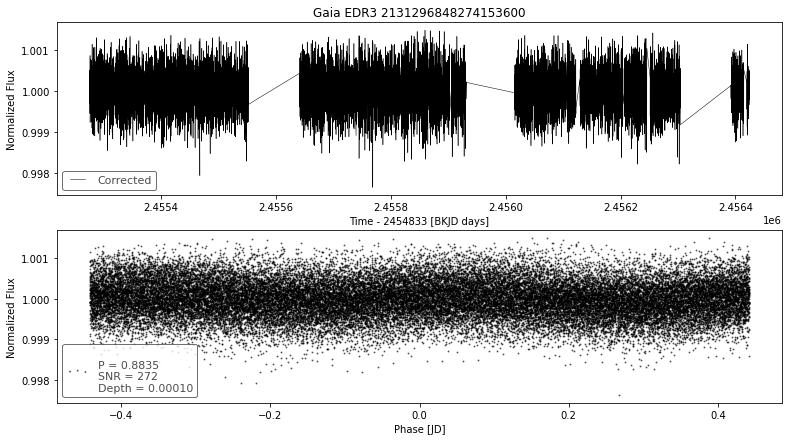

__________________________________________
index                                          29
designation         Gaia EDR3 2131296848274153984
BLS_period                               0.883528
BLS_period_SNR                         229.010252
BLS_duration                                0.201
BLS_depth                                0.000088
BLS_transit_time                   2455276.759168
batch                                          20
Name: 1929, dtype: object
ra                           287.116336
ra_error                       0.042088
dec                           49.124210
dec_error                      0.054419
pmra                           3.405982
pmdec                         -3.286782
parallax                       0.345573
parallax_error                 0.042169
phot_g_n_obs                 275.000000
phot_g_mean_flux            8733.237406
phot_g_mean_flux_error         7.419083
phot_g_mean_mag               15.834429
phot_bp_n_obs                  2.000000
phot_bp_mea

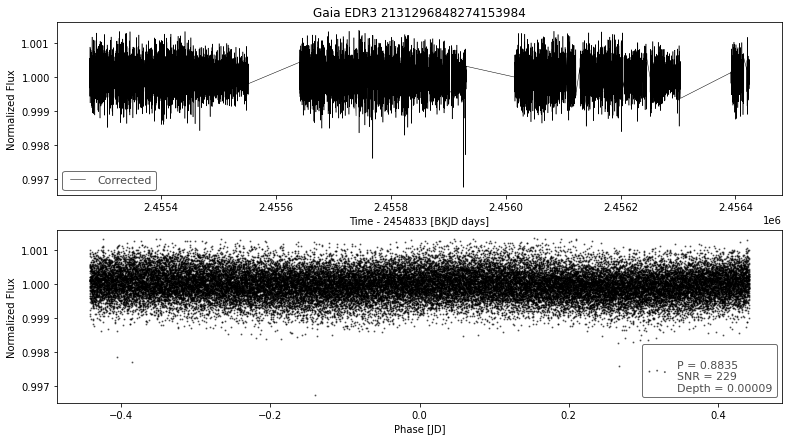

__________________________________________
index                                           1
designation         Gaia EDR3 2132183707479643264
BLS_period                               0.509776
BLS_period_SNR                          31.667904
BLS_duration                                 0.45
BLS_depth                                0.000066
BLS_transit_time                   2455276.784829
batch                                          21
Name: 2001, dtype: object
ra                           284.685030
ra_error                       0.009134
dec                           49.259624
dec_error                      0.011528
pmra                           1.889104
pmdec                         -3.308813
parallax                       0.284761
parallax_error                 0.011207
phot_g_n_obs                 317.000000
phot_g_mean_flux           87535.865787
phot_g_mean_flux_error        11.866728
phot_g_mean_mag               13.331902
phot_bp_n_obs                 38.000000
phot_bp_mea

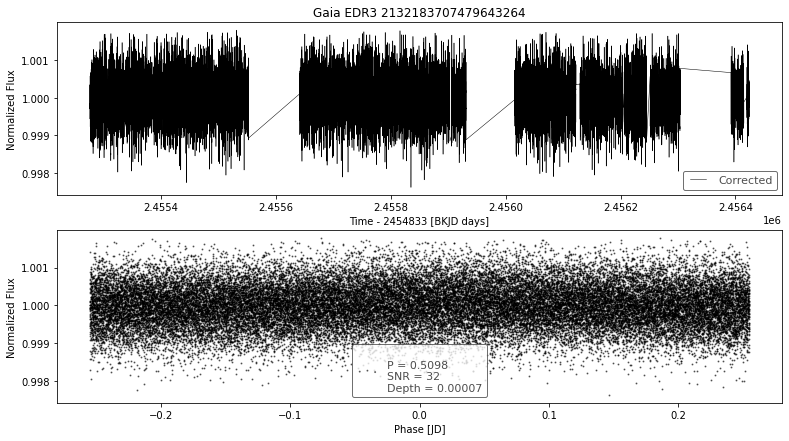

__________________________________________
index                                          47
designation         Gaia EDR3 2133602451140200192
BLS_period                               0.985036
BLS_period_SNR                          67.124626
BLS_duration                                0.174
BLS_depth                                 0.02357
BLS_transit_time                   2455277.216754
batch                                          21
Name: 2047, dtype: object
ra                         286.142877
ra_error                     0.170537
dec                         50.031650
dec_error                    0.175052
pmra                        -1.750962
pmdec                       -2.023801
parallax                     0.642324
parallax_error               0.181976
phot_g_n_obs               370.000000
phot_g_mean_flux           359.590753
phot_g_mean_flux_error       1.004638
phot_g_mean_mag             19.297846
phot_bp_n_obs               41.000000
phot_bp_mean_flux          131.576810

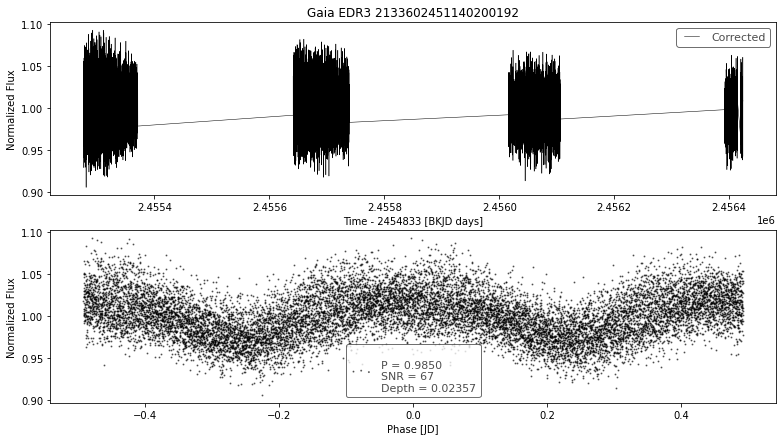

__________________________________________
index                                          27
designation         Gaia EDR3 2130350473702503296
BLS_period                               1.007084
BLS_period_SNR                          31.964042
BLS_duration                                 0.45
BLS_depth                                0.003116
BLS_transit_time                   2455276.952494
batch                                          22
Name: 2127, dtype: object
ra                         288.148249
ra_error                     0.192864
dec                         46.067904
dec_error                    0.226416
pmra                        -0.232083
pmdec                       -5.718586
parallax                     0.529686
parallax_error               0.235814
phot_g_n_obs               328.000000
phot_g_mean_flux           341.304857
phot_g_mean_flux_error       1.125393
phot_g_mean_mag             19.354511
phot_bp_n_obs               38.000000
phot_bp_mean_flux          106.977461

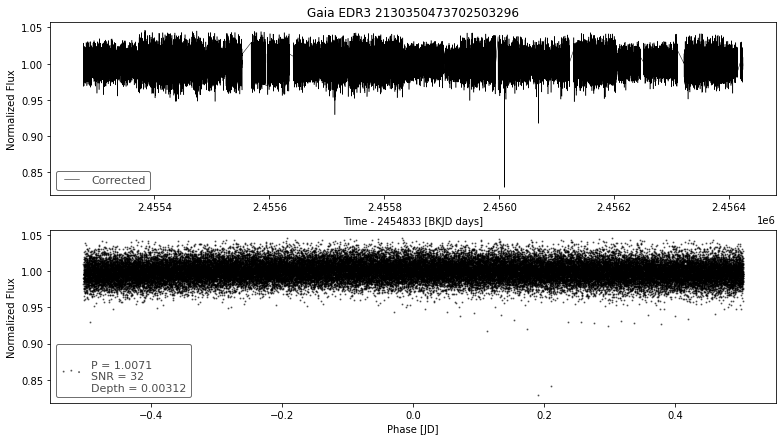

__________________________________________
index                                          27
designation         Gaia EDR3 2130912843837194624
BLS_period                              25.235131
BLS_period_SNR                         917.197205
BLS_duration                                0.249
BLS_depth                                0.032282
BLS_transit_time                   2455293.013006
batch                                          23
Name: 2227, dtype: object
ra                         288.672169
ra_error                     0.110265
dec                         47.636358
dec_error                    0.112138
pmra                        -1.262303
pmdec                        0.033584
parallax                     0.378002
parallax_error               0.116096
phot_g_n_obs               310.000000
phot_g_mean_flux           894.055519
phot_g_mean_flux_error       1.423857
phot_g_mean_mag             18.308956
phot_bp_n_obs               32.000000
phot_bp_mean_flux          428.612062

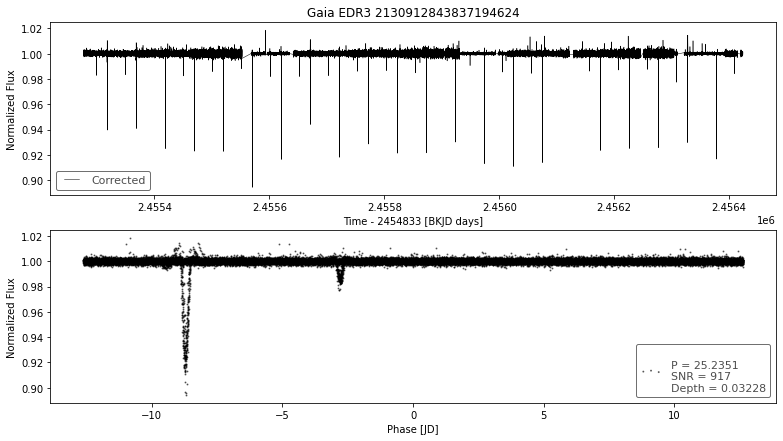

__________________________________________
index                                          28
designation         Gaia EDR3 2130912843839236224
BLS_period                              25.235131
BLS_period_SNR                        2292.969982
BLS_duration                                0.249
BLS_depth                                0.033557
BLS_transit_time                   2455293.013006
batch                                          23
Name: 2228, dtype: object
ra                           288.674766
ra_error                       0.019987
dec                           47.635980
dec_error                      0.019822
pmra                          -1.045451
pmdec                         -4.399511
parallax                       0.501445
parallax_error                 0.020195
phot_g_n_obs                 298.000000
phot_g_mean_flux           22267.215371
phot_g_mean_flux_error         6.282117
phot_g_mean_mag               14.818202
phot_bp_n_obs                 33.000000
phot_bp_mea

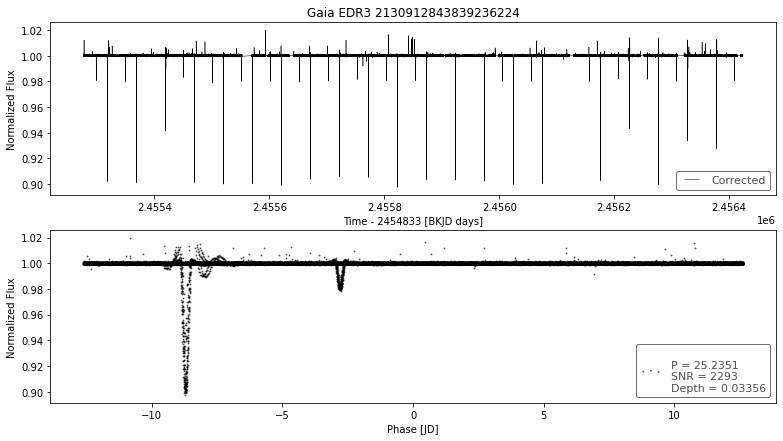

__________________________________________
index                                          97
designation         Gaia EDR3 2126185111340525056
BLS_period                               0.559047
BLS_period_SNR                         217.654237
BLS_duration                                 0.45
BLS_depth                                0.018919
BLS_transit_time                    2455276.85321
batch                                          23
Name: 2297, dtype: object
ra                         291.786200
ra_error                     0.109546
dec                         44.341185
dec_error                    0.126608
pmra                        -1.534132
pmdec                       -2.675874
parallax                     0.058308
parallax_error               0.127423
phot_g_n_obs               408.000000
phot_g_mean_flux           670.483494
phot_g_mean_flux_error       1.159747
phot_g_mean_mag             18.621397
phot_bp_n_obs               46.000000
phot_bp_mean_flux          400.437832

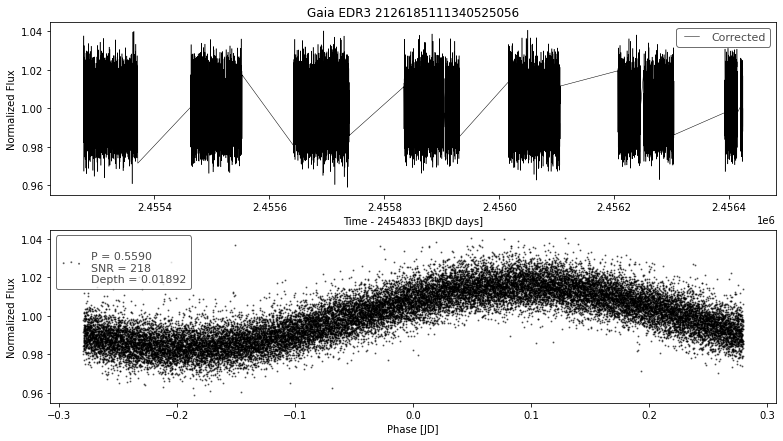

__________________________________________
index                                          84
designation         Gaia EDR3 2126834549053808000
BLS_period                               0.527275
BLS_period_SNR                         231.876448
BLS_duration                                 0.33
BLS_depth                                0.026763
BLS_transit_time                   2455276.661283
batch                                          24
Name: 2384, dtype: object
ra                         290.379486
ra_error                     0.302881
dec                         43.694606
dec_error                    0.274264
pmra                        -1.924767
pmdec                        2.117222
parallax                    -0.000917
parallax_error               0.320632
phot_g_n_obs               310.000000
phot_g_mean_flux           236.483526
phot_g_mean_flux_error       0.886863
phot_g_mean_mag             19.752865
phot_bp_n_obs               33.000000
phot_bp_mean_flux           86.001913

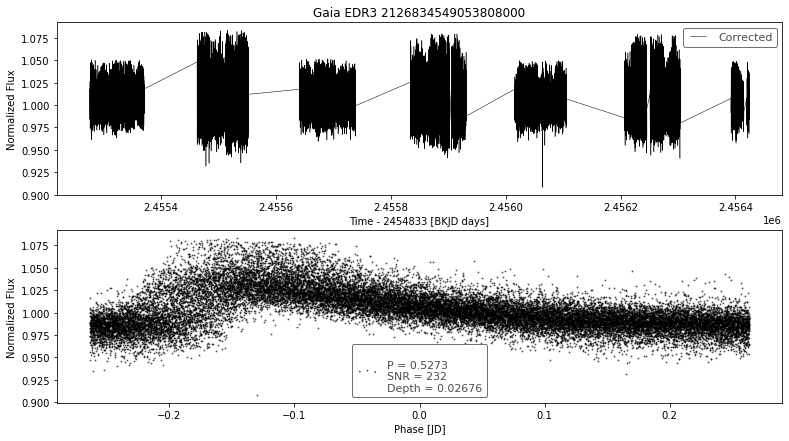

__________________________________________
index                                          85
designation         Gaia EDR3 2126834549053809152
BLS_period                               0.527275
BLS_period_SNR                       13330.674926
BLS_duration                                 0.33
BLS_depth                                0.334599
BLS_transit_time                   2455276.658283
batch                                          24
Name: 2385, dtype: object
ra                          290.379123
ra_error                      0.060521
dec                          43.696831
dec_error                     0.055894
pmra                         -0.898369
pmdec                         0.207937
parallax                      0.008914
parallax_error                0.062518
phot_g_n_obs                339.000000
phot_g_mean_flux           2319.686496
phot_g_mean_flux_error       29.992878
phot_g_mean_mag              17.273794
phot_bp_n_obs                38.000000
phot_bp_mean_flux       

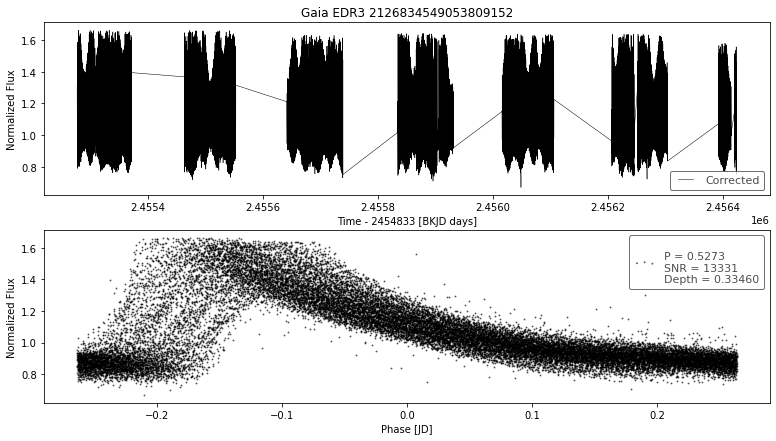

__________________________________________
index                                          86
designation         Gaia EDR3 2126834549053810816
BLS_period                               0.527275
BLS_period_SNR                          66.842381
BLS_duration                                 0.33
BLS_depth                                0.004922
BLS_transit_time                   2455276.658283
batch                                          24
Name: 2386, dtype: object
ra                         290.383315
ra_error                     0.176354
dec                         43.696422
dec_error                    0.162729
pmra                        -5.585126
pmdec                       -3.408093
parallax                     0.644044
parallax_error               0.190588
phot_g_n_obs               333.000000
phot_g_mean_flux           433.272002
phot_g_mean_flux_error       1.051448
phot_g_mean_mag             19.095465
phot_bp_n_obs               33.000000
phot_bp_mean_flux          161.378083

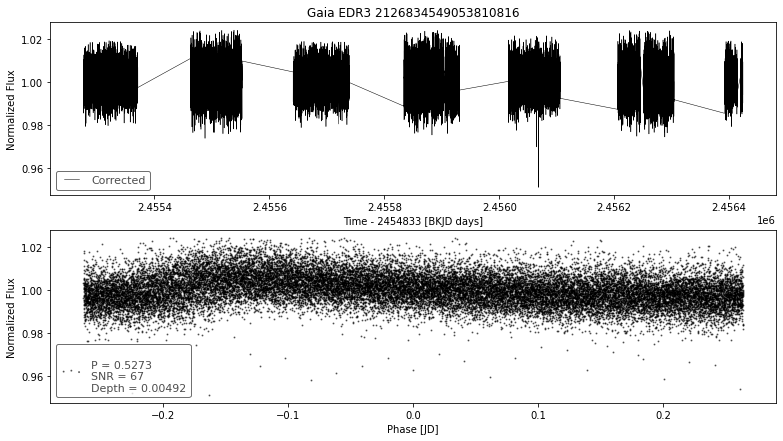

__________________________________________
index                                          16
designation         Gaia EDR3 2126834789571998976
BLS_period                               0.635016
BLS_period_SNR                         129.550228
BLS_duration                                 0.45
BLS_depth                                0.000402
BLS_transit_time                   2455276.901283
batch                                          25
Name: 2416, dtype: object
ra                           290.382892
ra_error                       0.015082
dec                           43.743705
dec_error                      0.015469
pmra                          -2.246002
pmdec                         -0.735077
parallax                       1.967479
parallax_error                 0.016731
phot_g_n_obs                 341.000000
phot_g_mean_flux           28941.577697
phot_g_mean_flux_error         6.619769
phot_g_mean_mag               14.533562
phot_bp_n_obs                 38.000000
phot_bp_mea

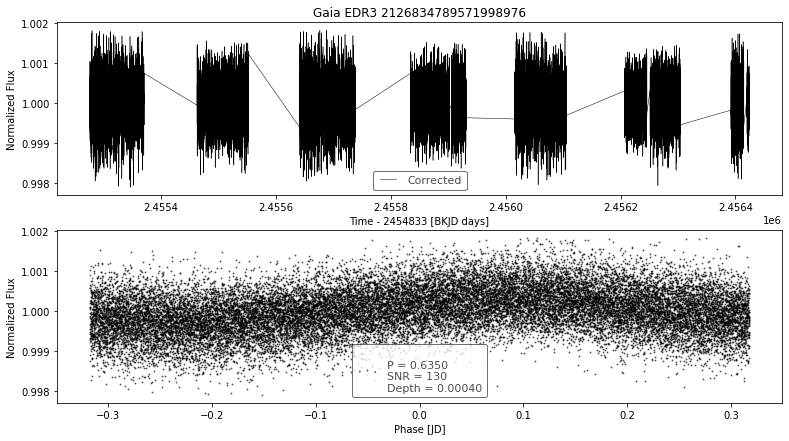

__________________________________________
index                                          18
designation         Gaia EDR3 2126834789572002176
BLS_period                               0.635016
BLS_period_SNR                         148.391454
BLS_duration                                 0.45
BLS_depth                                0.001406
BLS_transit_time                   2455276.901283
batch                                          25
Name: 2418, dtype: object
ra                          290.384934
ra_error                      0.074993
dec                          43.747818
dec_error                     0.070502
pmra                         -0.243809
pmdec                        -4.111180
parallax                      0.011910
parallax_error                0.081728
phot_g_n_obs                339.000000
phot_g_mean_flux           1351.452172
phot_g_mean_flux_error        1.537233
phot_g_mean_mag              17.860365
phot_bp_n_obs                34.000000
phot_bp_mean_flux       

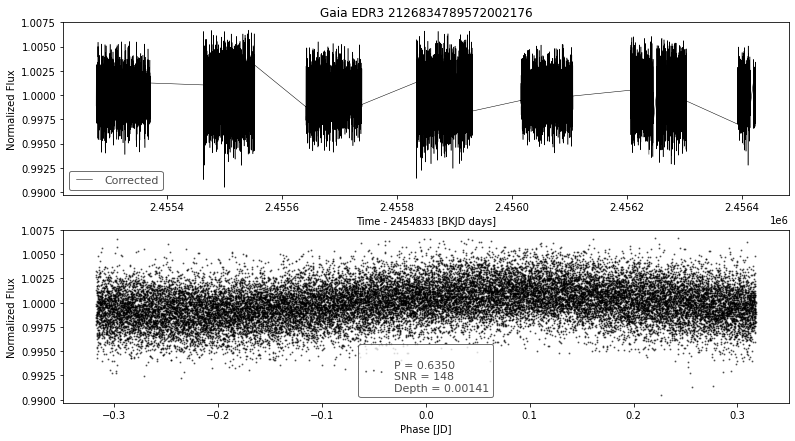

__________________________________________
index                                          19
designation         Gaia EDR3 2126834789572002432
BLS_period                               0.635016
BLS_period_SNR                        1919.205598
BLS_duration                                 0.45
BLS_depth                                0.001731
BLS_transit_time                   2455276.901283
batch                                          25
Name: 2419, dtype: object
ra                            290.387732
ra_error                        0.012222
dec                            43.745293
dec_error                       0.012437
pmra                            4.552852
pmdec                           5.725726
parallax                        0.498219
parallax_error                  0.013724
phot_g_n_obs                  324.000000
phot_g_mean_flux           246333.263114
phot_g_mean_flux_error         65.223076
phot_g_mean_mag                12.208559
phot_bp_n_obs                  38.00000

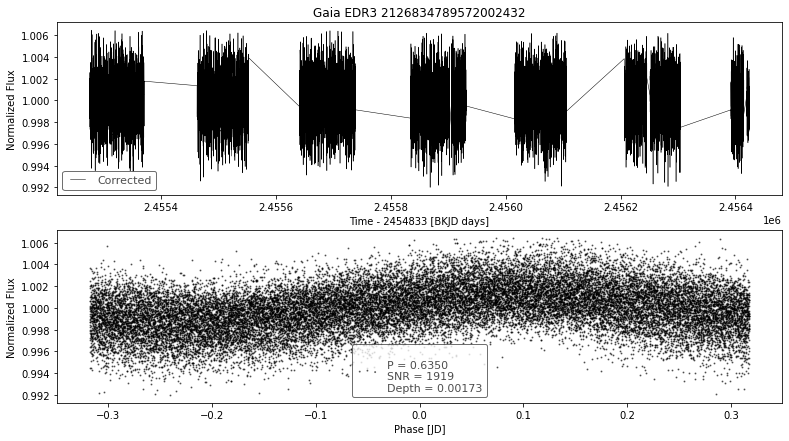

__________________________________________
index                                          30
designation         Gaia EDR3 2126835511126495360
BLS_period                               28.97421
BLS_period_SNR                          57.654215
BLS_duration                                 0.45
BLS_depth                                0.000183
BLS_transit_time                   2455286.009283
batch                                          25
Name: 2430, dtype: object
ra                            290.361082
ra_error                        0.010216
dec                            43.742636
dec_error                       0.010169
pmra                           -1.943102
pmdec                          -4.032390
parallax                        0.286732
parallax_error                  0.011323
phot_g_n_obs                  371.000000
phot_g_mean_flux           450540.424384
phot_g_mean_flux_error        137.482250
phot_g_mean_mag                11.553033
phot_bp_n_obs                  42.00000

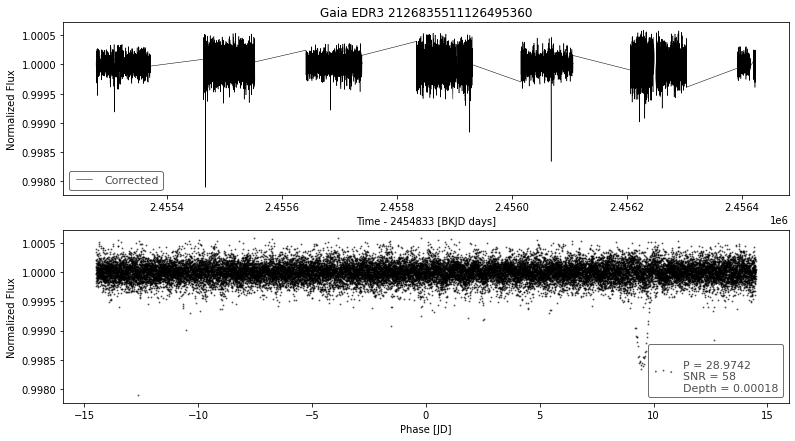

__________________________________________
index                                          46
designation         Gaia EDR3 2127398048763649920
BLS_period                               0.622346
BLS_period_SNR                          255.12245
BLS_duration                                 0.45
BLS_depth                                0.016162
BLS_transit_time                   2455276.910295
batch                                          26
Name: 2546, dtype: object
ra                         290.973066
ra_error                     0.093842
dec                         45.282409
dec_error                    0.099332
pmra                        -2.235416
pmdec                       -2.766489
parallax                     0.020107
parallax_error               0.105283
phot_g_n_obs               360.000000
phot_g_mean_flux           894.790901
phot_g_mean_flux_error       1.884488
phot_g_mean_mag             18.308064
phot_bp_n_obs               43.000000
phot_bp_mean_flux          395.259334

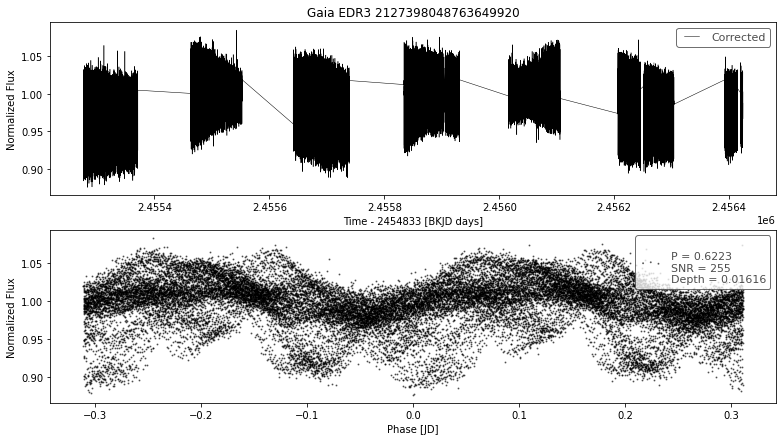

__________________________________________
index                                          78
designation         Gaia EDR3 2101752588579265280
BLS_period                               0.632881
BLS_period_SNR                         725.475517
BLS_duration                                 0.45
BLS_depth                                0.001947
BLS_transit_time                   2455276.748162
batch                                          26
Name: 2578, dtype: object
ra                          291.719121
ra_error                      0.055306
dec                          42.226387
dec_error                     0.066934
pmra                         -4.110800
pmdec                        -7.145696
parallax                      1.028032
parallax_error                0.066195
phot_g_n_obs                334.000000
phot_g_mean_flux           5879.935628
phot_g_mean_flux_error       10.659460
phot_g_mean_mag              16.263935
phot_bp_n_obs                37.000000
phot_bp_mean_flux       

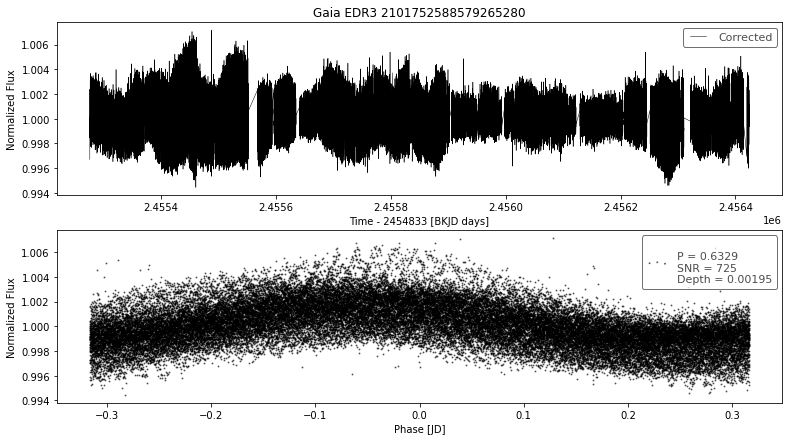

__________________________________________
index                                          87
designation         Gaia EDR3 2101752592882626560
BLS_period                               0.632881
BLS_period_SNR                        5026.410752
BLS_duration                                 0.45
BLS_depth                                0.002712
BLS_transit_time                   2455276.748162
batch                                          26
Name: 2587, dtype: object
ra                            291.715070
ra_error                        0.017745
dec                            42.226864
dec_error                       0.020117
pmra                           -6.924699
pmdec                          -4.183720
parallax                        1.345742
parallax_error                  0.020989
phot_g_n_obs                  341.000000
phot_g_mean_flux           314464.882460
phot_g_mean_flux_error         92.132870
phot_g_mean_mag                11.943437
phot_bp_n_obs                  40.00000

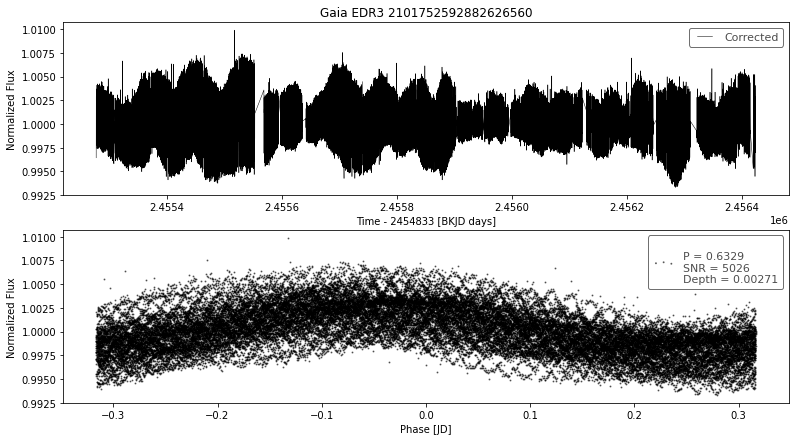

__________________________________________
index                                          99
designation         Gaia EDR3 2101752932176893696
BLS_period                               0.552366
BLS_period_SNR                        2588.508105
BLS_duration                                0.051
BLS_depth                                0.084221
BLS_transit_time                   2455277.028662
batch                                          26
Name: 2599, dtype: object
ra                         291.689885
ra_error                     0.320295
dec                         42.218074
dec_error                    0.391818
pmra                        -1.162877
pmdec                       -4.469629
parallax                    -0.366371
parallax_error               0.413869
phot_g_n_obs               305.000000
phot_g_mean_flux           200.112166
phot_g_mean_flux_error       0.891288
phot_g_mean_mag             19.934183
phot_bp_n_obs               34.000000
phot_bp_mean_flux           97.564938

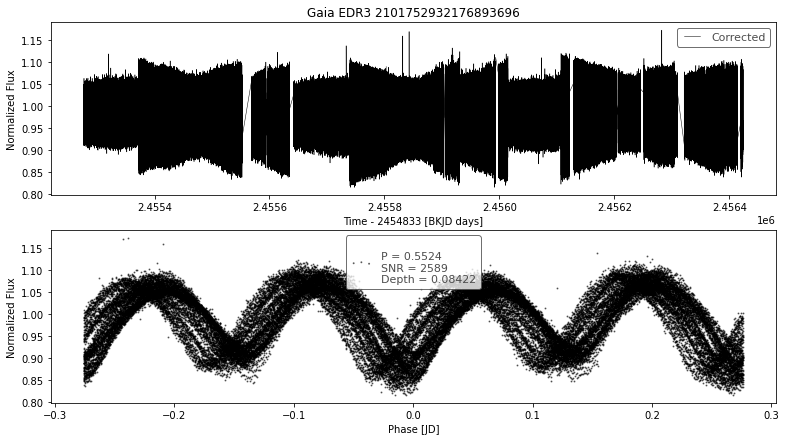

__________________________________________
index                                           4
designation         Gaia EDR3 2101752936479788544
BLS_period                               0.552366
BLS_period_SNR                        7114.184055
BLS_duration                                0.051
BLS_depth                                0.094137
BLS_transit_time                   2455276.755662
batch                                          27
Name: 2604, dtype: object
ra                          291.690330
ra_error                      0.031226
dec                          42.216780
dec_error                     0.035794
pmra                          1.548453
pmdec                        -5.555811
parallax                      0.567219
parallax_error                0.037796
phot_g_n_obs                331.000000
phot_g_mean_flux           5585.659534
phot_g_mean_flux_error       24.144344
phot_g_mean_mag              16.319681
phot_bp_n_obs                38.000000
phot_bp_mean_flux       

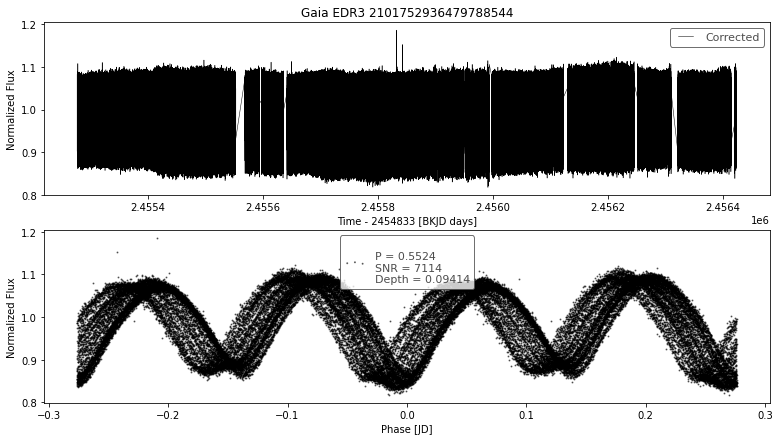

__________________________________________
index                                          46
designation         Gaia EDR3 2101753516292218624
BLS_period                               0.530687
BLS_period_SNR                         2158.72519
BLS_duration                                 0.45
BLS_depth                                0.079781
BLS_transit_time                   2455276.817162
batch                                          27
Name: 2646, dtype: object
ra                          291.700455
ra_error                      0.064441
dec                          42.258314
dec_error                     0.076618
pmra                         -2.101931
pmdec                        -5.689771
parallax                      0.193153
parallax_error                0.079093
phot_g_n_obs                342.000000
phot_g_mean_flux           1555.163463
phot_g_mean_flux_error       10.834753
phot_g_mean_mag              17.707928
phot_bp_n_obs                40.000000
phot_bp_mean_flux       

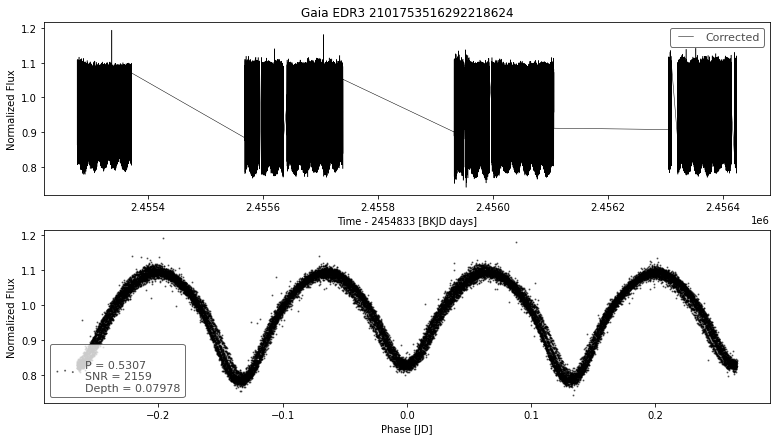

__________________________________________
index                                          49
designation         Gaia EDR3 2101753520591885568
BLS_period                               0.530687
BLS_period_SNR                        1791.842481
BLS_duration                                 0.45
BLS_depth                                0.070949
BLS_transit_time                   2455276.817162
batch                                          27
Name: 2649, dtype: object
ra                         291.699368
ra_error                     0.159580
dec                         42.258016
dec_error                    0.191234
pmra                        -8.286308
pmdec                        1.472541
parallax                     0.162175
parallax_error               0.200136
phot_g_n_obs               329.000000
phot_g_mean_flux           454.317031
phot_g_mean_flux_error       1.201191
phot_g_mean_mag             19.043970
phot_bp_n_obs               10.000000
phot_bp_mean_flux          188.214407

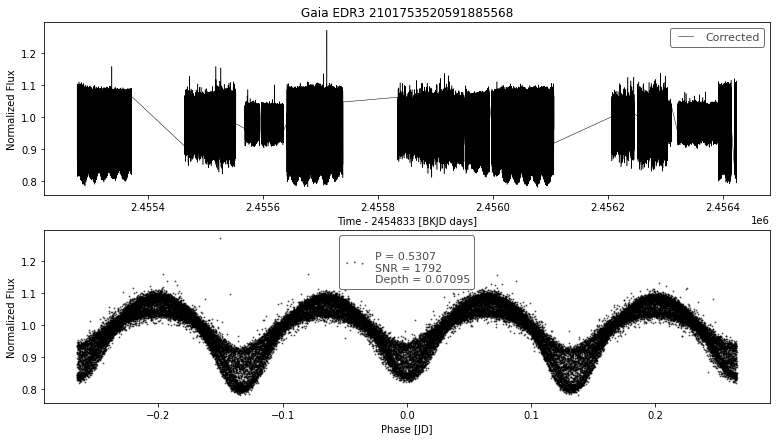

__________________________________________
index                                          70
designation         Gaia EDR3 2101753619371695872
BLS_period                               0.885682
BLS_period_SNR                         599.345553
BLS_duration                                0.099
BLS_depth                                 0.04122
BLS_transit_time                   2455277.205662
batch                                          27
Name: 2670, dtype: object
ra                          291.667992
ra_error                      0.086283
dec                          42.259972
dec_error                     0.102757
pmra                         -1.761399
pmdec                        -1.941937
parallax                      0.194339
parallax_error                0.107516
phot_g_n_obs                337.000000
phot_g_mean_flux           1045.530194
phot_g_mean_flux_error        2.179830
phot_g_mean_mag              18.139025
phot_bp_n_obs                41.000000
phot_bp_mean_flux       

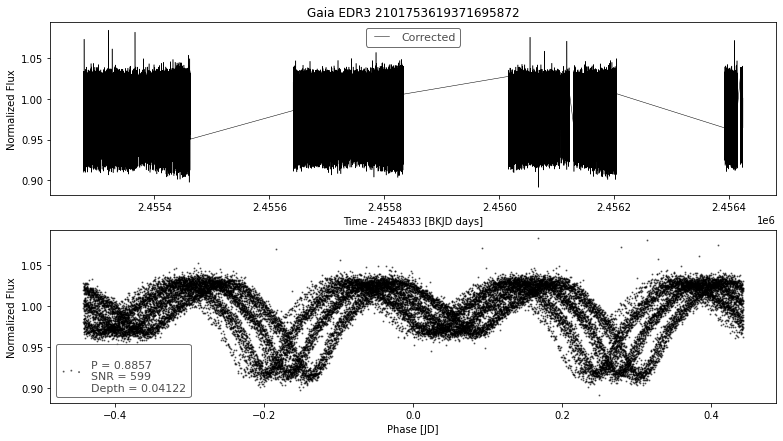

__________________________________________
index                                          91
designation         Gaia EDR3 2077708846259791616
BLS_period                               0.571104
BLS_period_SNR                          42.125838
BLS_duration                                 0.45
BLS_depth                                0.000026
BLS_transit_time                   2455276.715005
batch                                          28
Name: 2791, dtype: object
ra                            293.823701
ra_error                        0.009192
dec                            41.916408
dec_error                       0.011856
pmra                           -1.033747
pmdec                         -10.805417
parallax                        0.455476
parallax_error                  0.012744
phot_g_n_obs                  308.000000
phot_g_mean_flux           175380.454985
phot_g_mean_flux_error         28.222250
phot_g_mean_mag                12.577414
phot_bp_n_obs                  36.00000

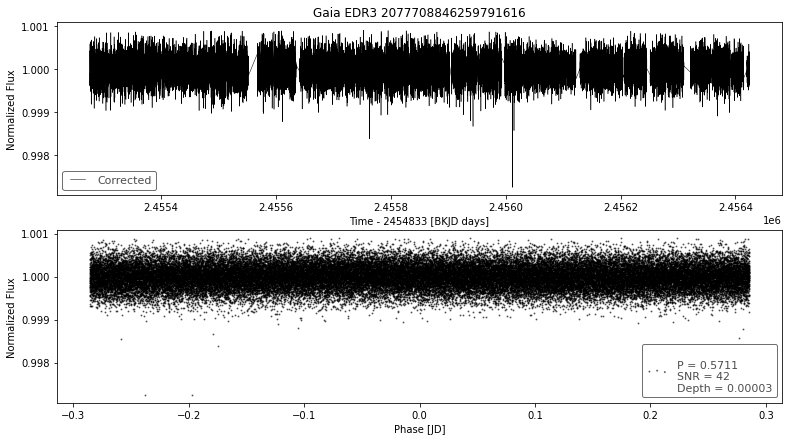

__________________________________________
index                                          11
designation         Gaia EDR3 2077709052418221696
BLS_period                               0.548197
BLS_period_SNR                          94.957318
BLS_duration                                 0.45
BLS_depth                                0.000025
BLS_transit_time                   2455276.715005
batch                                          29
Name: 2811, dtype: object
ra                         2.938100e+02
ra_error                   1.128572e-02
dec                        4.192297e+01
dec_error                  1.242087e-02
pmra                       3.793231e+00
pmdec                     -2.061399e+00
parallax                   1.223523e+00
parallax_error             1.397342e-02
phot_g_n_obs               3.190000e+02
phot_g_mean_flux           1.832121e+06
phot_g_mean_flux_error     2.131171e+02
phot_g_mean_mag            1.002998e+01
phot_bp_n_obs              3.600000e+01
phot_bp_mea

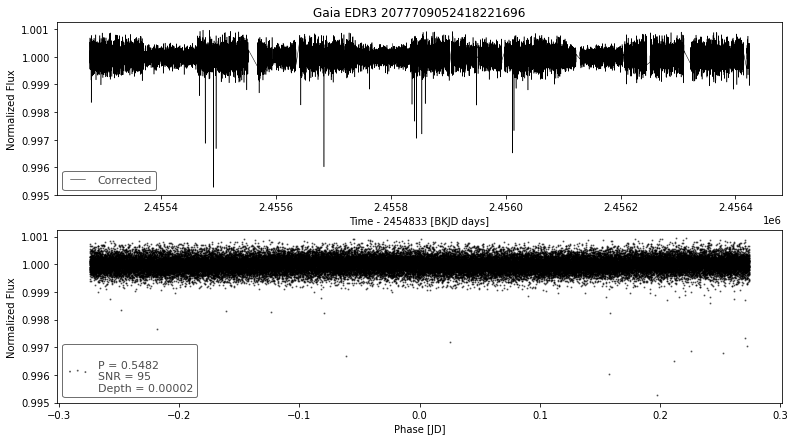

__________________________________________
index                                          15
designation         Gaia EDR3 2077709056713350400
BLS_period                                0.54796
BLS_period_SNR                           65.13788
BLS_duration                                 0.45
BLS_depth                                0.000019
BLS_transit_time                   2455276.787005
batch                                          29
Name: 2815, dtype: object
ra                         2.938107e+02
ra_error                   1.807525e-01
dec                        4.192324e+01
dec_error                  2.300616e-01
pmra                      -3.552999e+00
pmdec                     -6.579808e+00
parallax                   8.145447e-01
parallax_error             1.662952e-01
phot_g_n_obs               1.090000e+02
phot_g_mean_flux           4.010170e+03
phot_g_mean_flux_error     9.952749e+00
phot_g_mean_mag            1.667946e+01
phot_bp_n_obs              0.000000e+00
phot_bp_mea

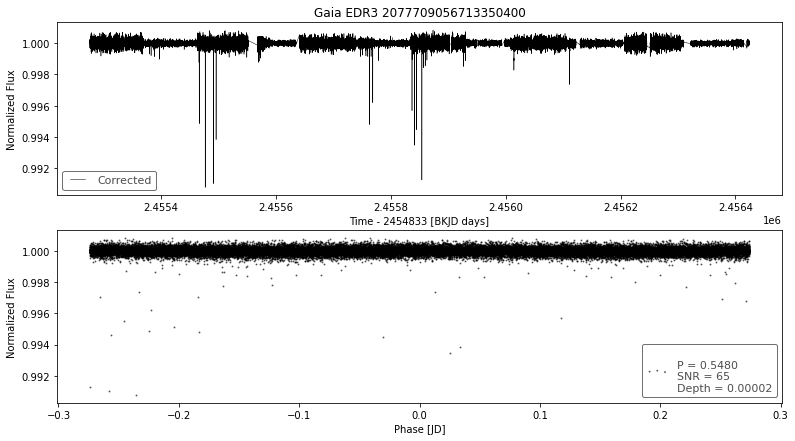

__________________________________________
index                                          43
designation         Gaia EDR3 2077709258576651776
BLS_period                               0.520367
BLS_period_SNR                          79.830569
BLS_duration                                 0.45
BLS_depth                                 0.00006
BLS_transit_time                   2455276.748005
batch                                          29
Name: 2843, dtype: object
ra                            293.842658
ra_error                        0.010519
dec                            41.938386
dec_error                       0.012619
pmra                           -3.078749
pmdec                         -14.270632
parallax                        0.515823
parallax_error                  0.013701
phot_g_n_obs                  321.000000
phot_g_mean_flux           301548.145256
phot_g_mean_flux_error         43.524136
phot_g_mean_mag                11.988976
phot_bp_n_obs                  37.00000

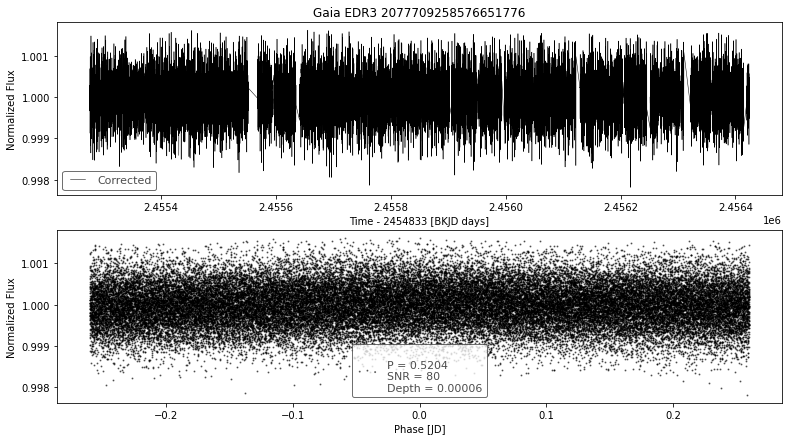

__________________________________________
index                                           3
designation         Gaia EDR3 2053614114092990592
BLS_period                               0.532076
BLS_period_SNR                          85.114389
BLS_duration                                0.399
BLS_depth                                  0.0081
BLS_transit_time                   2455276.851578
batch                                          30
Name: 2903, dtype: object
ra                         292.490004
ra_error                     0.232349
dec                         41.318844
dec_error                    0.284339
pmra                        -2.167951
pmdec                      -14.787509
parallax                     3.306609
parallax_error               0.284864
phot_g_n_obs               388.000000
phot_g_mean_flux           526.619955
phot_g_mean_flux_error       2.589405
phot_g_mean_mag             18.883623
phot_bp_n_obs               43.000000
phot_bp_mean_flux          181.262187

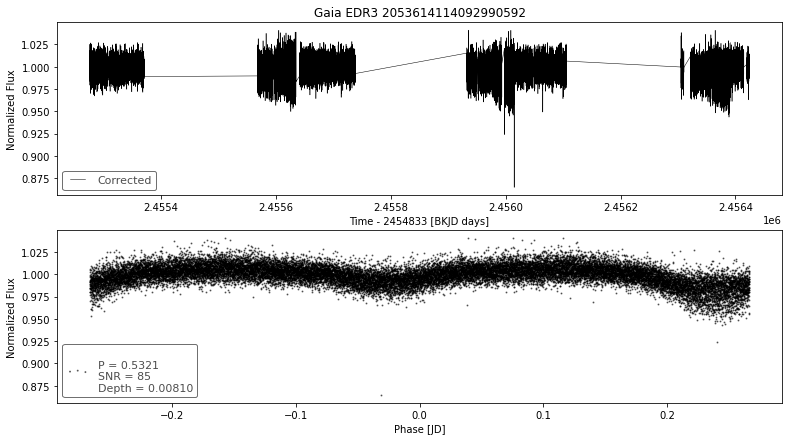

__________________________________________
index                                           5
designation         Gaia EDR3 2053614118389135232
BLS_period                               0.532076
BLS_period_SNR                       72437.939927
BLS_duration                                0.099
BLS_depth                                0.186273
BLS_transit_time                   2455276.725578
batch                                          30
Name: 2905, dtype: object
ra                         292.483461
ra_error                     0.240447
dec                         41.315273
dec_error                    0.351070
pmra                        -3.705624
pmdec                       -5.847000
parallax                     0.277555
parallax_error               0.314216
phot_g_n_obs               287.000000
phot_g_mean_flux           241.328140
phot_g_mean_flux_error       1.102294
phot_g_mean_mag             19.730846
phot_bp_n_obs               27.000000
phot_bp_mean_flux          190.524193

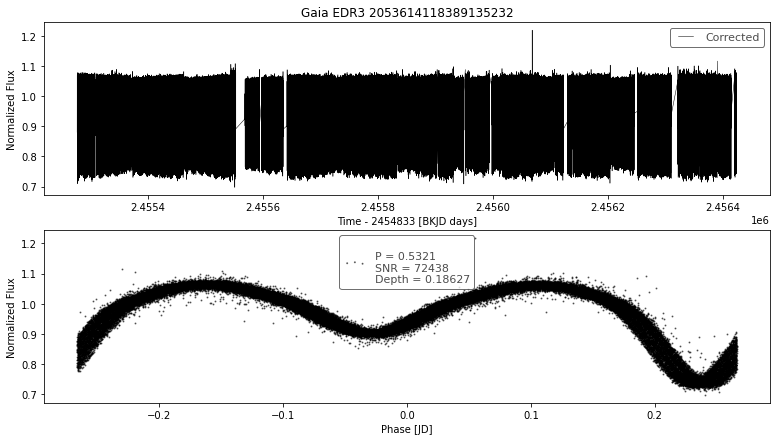

__________________________________________
index                                           7
designation         Gaia EDR3 2053614118393504512
BLS_period                               0.532076
BLS_period_SNR                         245.098018
BLS_duration                                0.099
BLS_depth                                0.001216
BLS_transit_time                   2455276.725578
batch                                          30
Name: 2907, dtype: object
ra                           292.487021
ra_error                       0.019374
dec                           41.311061
dec_error                      0.022268
pmra                          -3.802910
pmdec                        -12.047214
parallax                       1.228029
parallax_error                 0.023539
phot_g_n_obs                 354.000000
phot_g_mean_flux           13439.642732
phot_g_mean_flux_error         4.275727
phot_g_mean_mag               15.366398
phot_bp_n_obs                 40.000000
phot_bp_mea

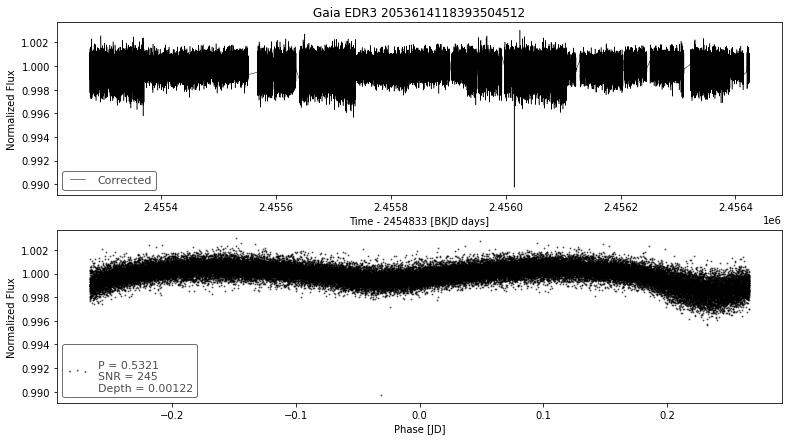

__________________________________________
index                                           8
designation         Gaia EDR3 2053614118393505152
BLS_period                               0.532076
BLS_period_SNR                       12670.188394
BLS_duration                                0.099
BLS_depth                                0.077118
BLS_transit_time                   2455276.725578
batch                                          30
Name: 2908, dtype: object
ra                          292.485942
ra_error                      0.034022
dec                          41.312797
dec_error                     0.039489
pmra                         -4.868680
pmdec                        -5.867219
parallax                      0.323817
parallax_error                0.040853
phot_g_n_obs                368.000000
phot_g_mean_flux           4388.012467
phot_g_mean_flux_error        2.375774
phot_g_mean_mag              16.581697
phot_bp_n_obs                41.000000
phot_bp_mean_flux       

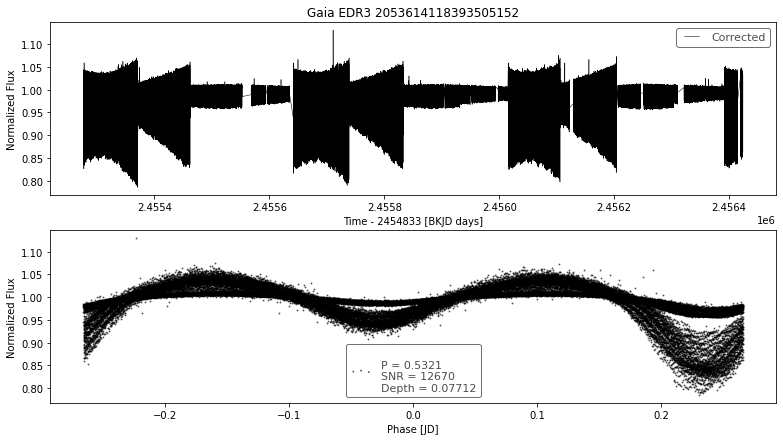

__________________________________________
index                                           9
designation         Gaia EDR3 2053614118393506176
BLS_period                               0.532076
BLS_period_SNR                      110356.063126
BLS_duration                                0.099
BLS_depth                                 0.18843
BLS_transit_time                   2455276.725578
batch                                          30
Name: 2909, dtype: object
ra                           292.485022
ra_error                       0.010011
dec                           41.315586
dec_error                      0.012127
pmra                           4.482389
pmdec                         10.166450
parallax                       0.630692
parallax_error                 0.012340
phot_g_n_obs                 364.000000
phot_g_mean_flux           62896.729759
phot_g_mean_flux_error       199.899750
phot_g_mean_mag               13.690797
phot_bp_n_obs                 43.000000
phot_bp_mea

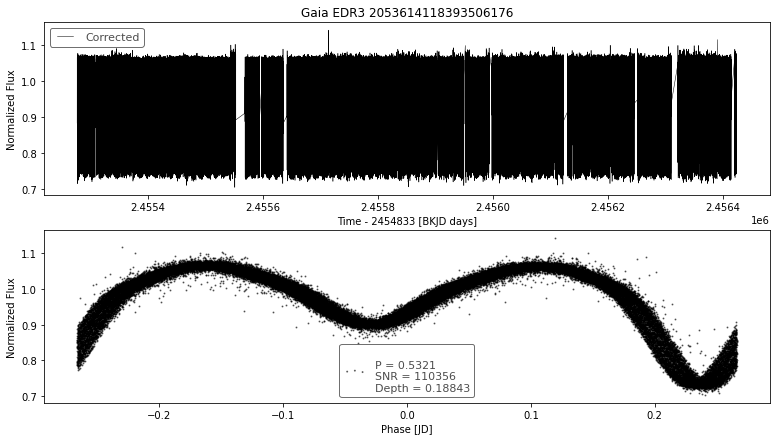

__________________________________________
index                                          22
designation         Gaia EDR3 2053614182812468480
BLS_period                               0.532076
BLS_period_SNR                         129.870732
BLS_duration                                0.099
BLS_depth                                0.009978
BLS_transit_time                   2455276.725578
batch                                          30
Name: 2922, dtype: object
ra                         292.481728
ra_error                     0.126479
dec                         41.319419
dec_error                    0.164565
pmra                        -0.045792
pmdec                      -15.091348
parallax                     0.742923
parallax_error               0.163077
phot_g_n_obs               377.000000
phot_g_mean_flux           510.539535
phot_g_mean_flux_error       1.066804
phot_g_mean_mag             18.917294
phot_bp_n_obs               39.000000
phot_bp_mean_flux           92.010626

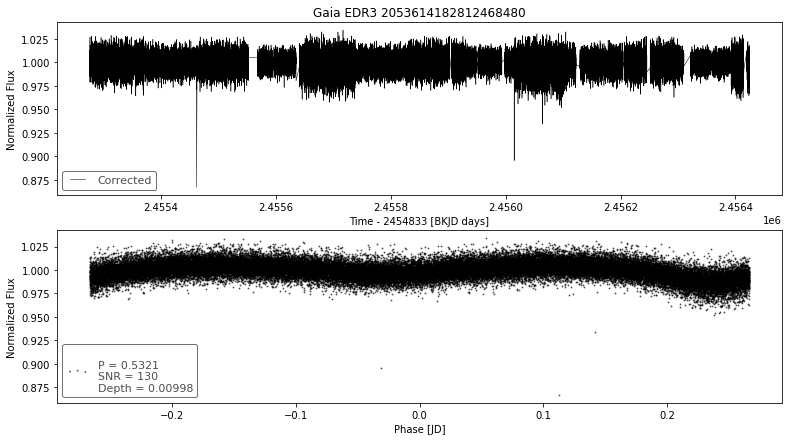

__________________________________________
index                                          23
designation         Gaia EDR3 2053614182812471552
BLS_period                               0.532076
BLS_period_SNR                          50.228135
BLS_duration                                0.099
BLS_depth                                0.003618
BLS_transit_time                   2455276.728578
batch                                          30
Name: 2923, dtype: object
ra                         292.486094
ra_error                     0.082739
dec                         41.321235
dec_error                    0.101888
pmra                        -2.714314
pmdec                       -5.136504
parallax                     0.132835
parallax_error               0.103702
phot_g_n_obs               383.000000
phot_g_mean_flux           912.745269
phot_g_mean_flux_error       1.193607
phot_g_mean_mag             18.286493
phot_bp_n_obs               47.000000
phot_bp_mean_flux          452.743971

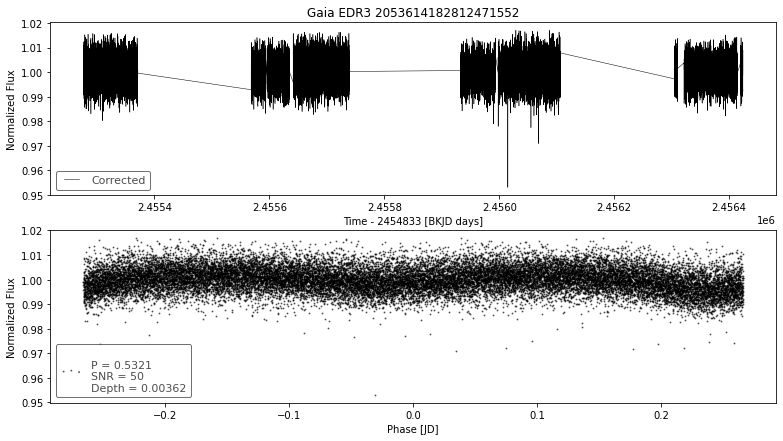

__________________________________________
index                                          30
designation         Gaia EDR3 2053614187112978176
BLS_period                                0.92265
BLS_period_SNR                          56.657672
BLS_duration                                0.399
BLS_depth                                0.000735
BLS_transit_time                   2455276.710578
batch                                          30
Name: 2930, dtype: object
ra                          292.473426
ra_error                      0.041260
dec                          41.320060
dec_error                     0.049583
pmra                          1.407214
pmdec                       -11.008769
parallax                      0.579579
parallax_error                0.049601
phot_g_n_obs                373.000000
phot_g_mean_flux           2990.986537
phot_g_mean_flux_error        1.933297
phot_g_mean_mag              16.997831
phot_bp_n_obs                43.000000
phot_bp_mean_flux       

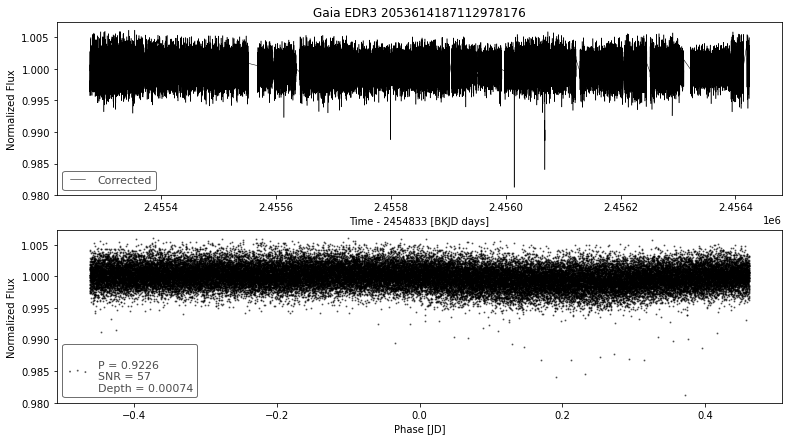

__________________________________________
index                                          47
designation         Gaia EDR3 2052502512141800960
BLS_period                               0.507689
BLS_period_SNR                          14.411889
BLS_duration                                 0.45
BLS_depth                                0.000044
BLS_transit_time                   2455276.804923
batch                                          31
Name: 3047, dtype: object
ra                           293.675342
ra_error                       0.012161
dec                           39.788365
dec_error                      0.013209
pmra                          -0.752185
pmdec                         -4.283671
parallax                       0.302318
parallax_error                 0.014331
phot_g_n_obs                 338.000000
phot_g_mean_flux           48160.655939
phot_g_mean_flux_error         7.264557
phot_g_mean_mag               13.980636
phot_bp_n_obs                 38.000000
phot_bp_mea

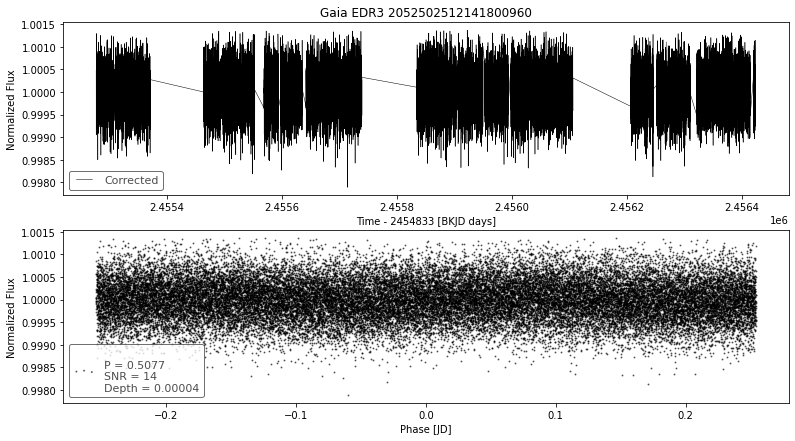

__________________________________________
index                                          19
designation         Gaia EDR3 2052503164977145088
BLS_period                               0.551766
BLS_period_SNR                         102.587956
BLS_duration                                 0.45
BLS_depth                                0.001047
BLS_transit_time                   2455276.795923
batch                                          32
Name: 3119, dtype: object
ra                          293.666509
ra_error                      0.026472
dec                          39.820121
dec_error                     0.028605
pmra                         -1.638737
pmdec                        -3.962043
parallax                      0.029686
parallax_error                0.032867
phot_g_n_obs                368.000000
phot_g_mean_flux           7583.076414
phot_g_mean_flux_error        2.878633
phot_g_mean_mag              15.987753
phot_bp_n_obs                39.000000
phot_bp_mean_flux       

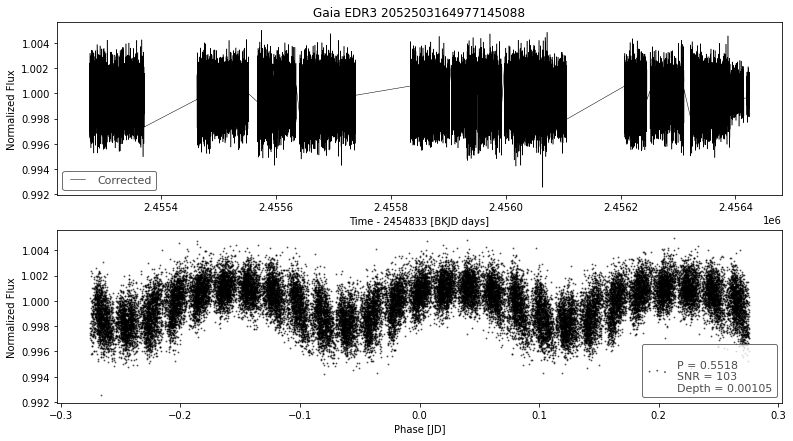

__________________________________________
index                                          20
designation         Gaia EDR3 2052503164977145472
BLS_period                               0.551766
BLS_period_SNR                        4784.072179
BLS_duration                                 0.45
BLS_depth                                0.126613
BLS_transit_time                   2455276.795923
batch                                          32
Name: 3120, dtype: object
ra                          293.667141
ra_error                      0.053841
dec                          39.823443
dec_error                     0.059350
pmra                         -0.463807
pmdec                        -1.293223
parallax                      0.393033
parallax_error                0.068401
phot_g_n_obs                379.000000
phot_g_mean_flux           1941.661980
phot_g_mean_flux_error       19.395030
phot_g_mean_mag              17.466932
phot_bp_n_obs                40.000000
phot_bp_mean_flux       

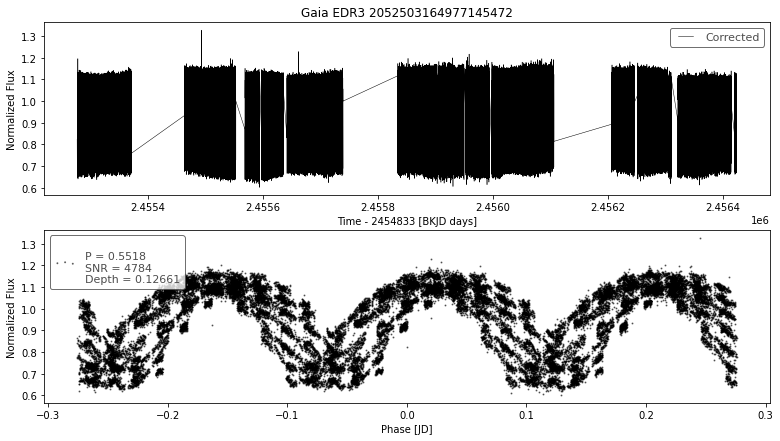

__________________________________________
index                                          35
designation         Gaia EDR3 2076505018468886784
BLS_period                               0.542118
BLS_period_SNR                          56.009973
BLS_duration                                 0.45
BLS_depth                                0.007073
BLS_transit_time                   2455276.714849
batch                                          32
Name: 3135, dtype: object
ra                         295.018824
ra_error                     0.160517
dec                         40.368156
dec_error                    0.199078
pmra                        -2.186354
pmdec                       -4.704497
parallax                    -0.032008
parallax_error               0.208433
phot_g_n_obs               364.000000
phot_g_mean_flux           338.638976
phot_g_mean_flux_error       0.847138
phot_g_mean_mag             19.363024
phot_bp_n_obs               41.000000
phot_bp_mean_flux          148.086819

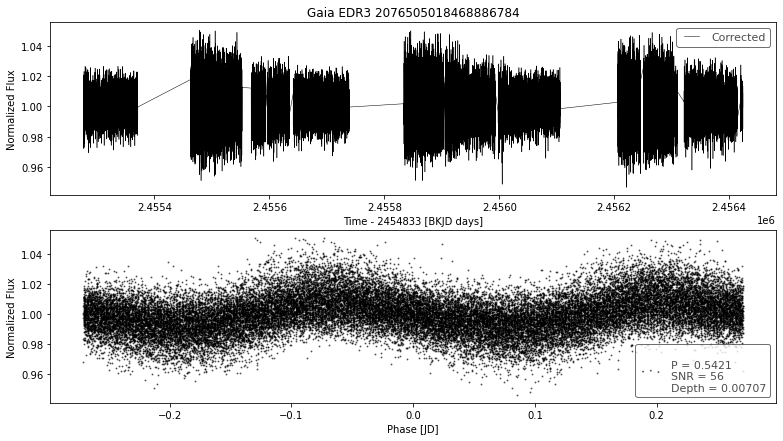

__________________________________________
index                                          36
designation         Gaia EDR3 2076505018468891392
BLS_period                               0.542118
BLS_period_SNR                        1722.774954
BLS_duration                                 0.45
BLS_depth                                0.097921
BLS_transit_time                   2455276.714849
batch                                          32
Name: 3136, dtype: object
ra                         295.015836
ra_error                     0.077858
dec                         40.369592
dec_error                    0.091747
pmra                        -0.223008
pmdec                        0.121125
parallax                     0.096398
parallax_error               0.099985
phot_g_n_obs               370.000000
phot_g_mean_flux           971.256590
phot_g_mean_flux_error       4.797936
phot_g_mean_mag             18.219032
phot_bp_n_obs               44.000000
phot_bp_mean_flux          564.601492

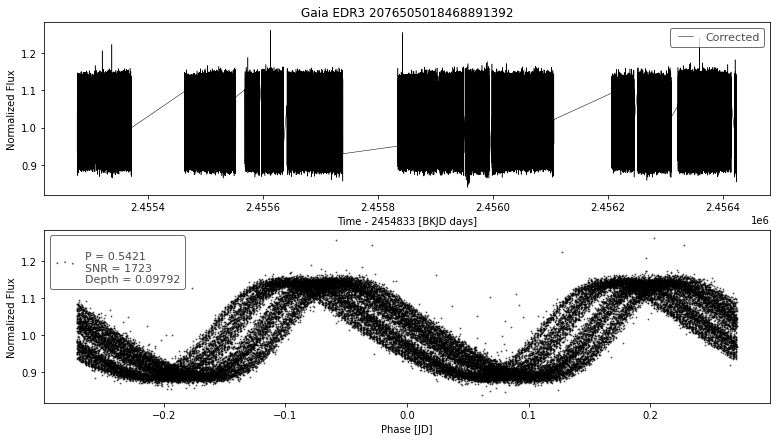

__________________________________________
index                                          75
designation         Gaia EDR3 2076505155907907712
BLS_period                               0.679577
BLS_period_SNR                         216.470323
BLS_duration                                0.399
BLS_depth                                0.004949
BLS_transit_time                   2455276.689349
batch                                          32
Name: 3175, dtype: object
ra                          295.040520
ra_error                      0.048411
dec                          40.395662
dec_error                     0.061163
pmra                          1.060257
pmdec                        -3.817447
parallax                      0.662331
parallax_error                0.064845
phot_g_n_obs                399.000000
phot_g_mean_flux           1953.077304
phot_g_mean_flux_error        2.954363
phot_g_mean_mag              17.460567
phot_bp_n_obs                43.000000
phot_bp_mean_flux       

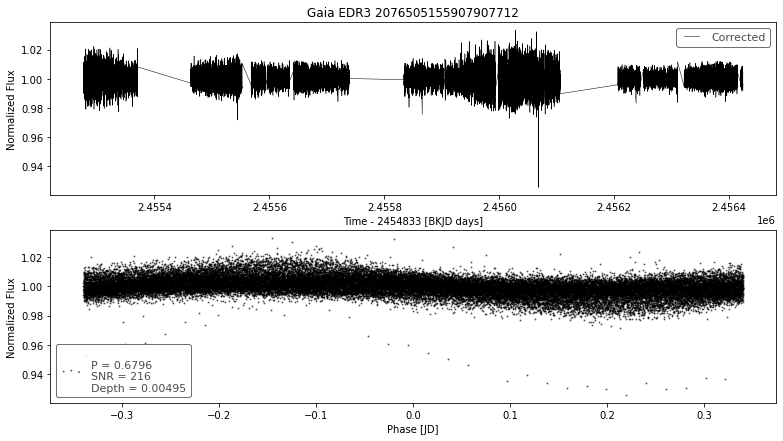

__________________________________________
index                                          81
designation         Gaia EDR3 2076505160214824320
BLS_period                               0.679577
BLS_period_SNR                          89.745003
BLS_duration                                0.399
BLS_depth                                0.001845
BLS_transit_time                   2455276.689349
batch                                          32
Name: 3181, dtype: object
ra                          295.041994
ra_error                      0.297387
dec                          40.393776
dec_error                     0.381776
pmra                         -1.969916
pmdec                         1.797610
parallax                      0.741791
parallax_error                0.398053
phot_g_n_obs                324.000000
phot_g_mean_flux           1194.573088
phot_g_mean_flux_error        3.627600
phot_g_mean_mag              17.994335
phot_bp_n_obs                41.000000
phot_bp_mean_flux       

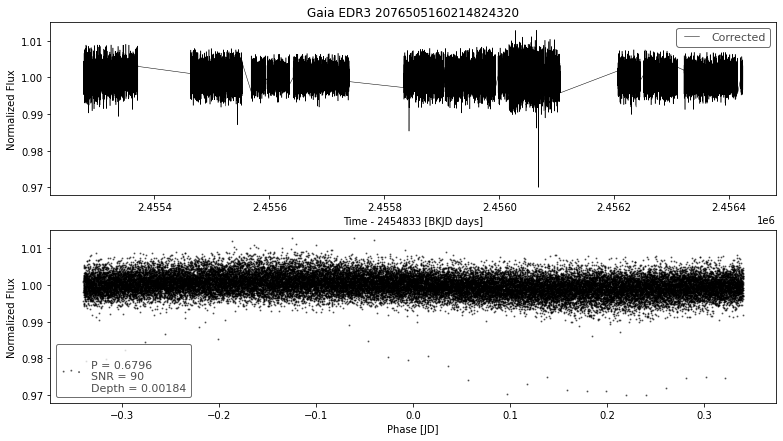

__________________________________________
index                                          19
designation         Gaia EDR3 2076505881767051392
BLS_period                               0.520901
BLS_period_SNR                         589.711334
BLS_duration                                 0.45
BLS_depth                                0.003044
BLS_transit_time                   2455276.714849
batch                                          33
Name: 3219, dtype: object
ra                           295.006163
ra_error                       0.013745
dec                           40.404027
dec_error                      0.016172
pmra                          -0.278839
pmdec                         -3.075624
parallax                       0.233688
parallax_error                 0.017118
phot_g_n_obs                 388.000000
phot_g_mean_flux           23265.115485
phot_g_mean_flux_error         9.033920
phot_g_mean_mag               14.770604
phot_bp_n_obs                 46.000000
phot_bp_mea

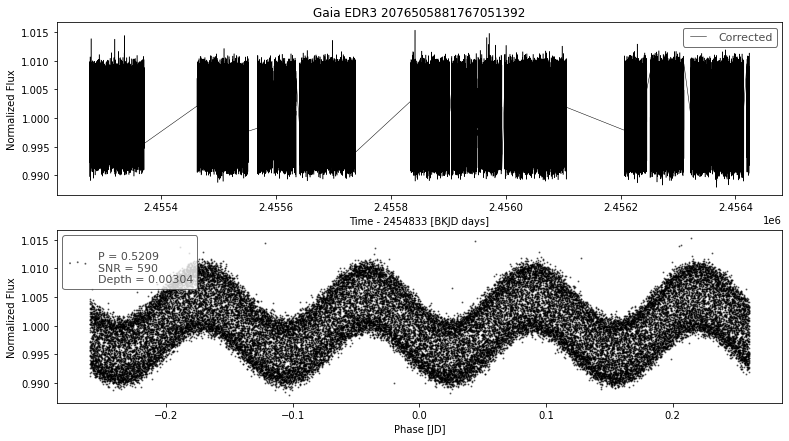

__________________________________________
index                                          89
designation         Gaia EDR3 2076208287770570752
BLS_period                               0.646481
BLS_period_SNR                          69.949402
BLS_duration                                0.399
BLS_depth                                0.002287
BLS_transit_time                   2455276.890268
batch                                          33
Name: 3289, dtype: object
ra                          295.744401
ra_error                      0.067204
dec                          39.428591
dec_error                     0.077457
pmra                         -6.384155
pmdec                       -13.960071
parallax                      2.445994
parallax_error                0.084294
phot_g_n_obs                364.000000
phot_g_mean_flux           1512.484923
phot_g_mean_flux_error        1.580656
phot_g_mean_mag              17.738140
phot_bp_n_obs                42.000000
phot_bp_mean_flux       

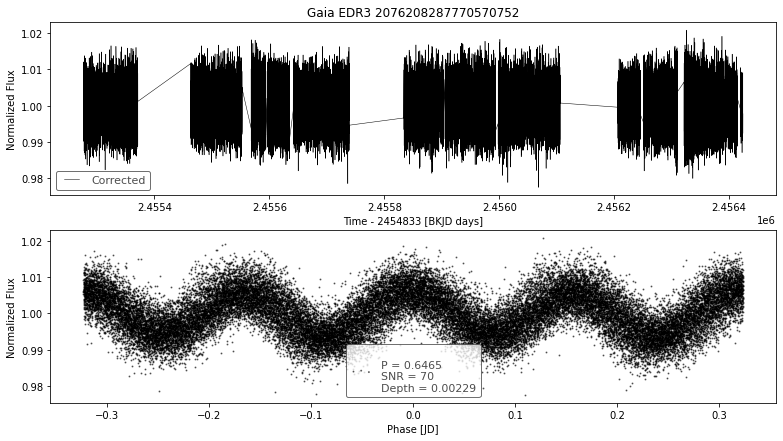

__________________________________________
index                                          90
designation         Gaia EDR3 2076208287770570880
BLS_period                               0.646481
BLS_period_SNR                          65.981887
BLS_duration                                0.399
BLS_depth                                0.002446
BLS_transit_time                   2455276.887268
batch                                          33
Name: 3290, dtype: object
ra                         295.740271
ra_error                     0.086022
dec                         39.429618
dec_error                    0.103693
pmra                        -2.301599
pmdec                       -5.059648
parallax                     0.241336
parallax_error               0.108707
phot_g_n_obs               333.000000
phot_g_mean_flux           981.805158
phot_g_mean_flux_error       1.302728
phot_g_mean_mag             18.207304
phot_bp_n_obs               43.000000
phot_bp_mean_flux          435.127781

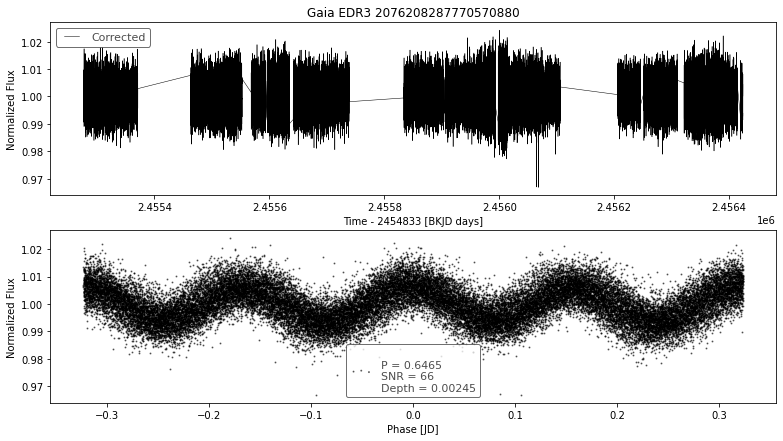

__________________________________________
index                                          98
designation         Gaia EDR3 2076208292075451136
BLS_period                               0.646481
BLS_period_SNR                         216.548294
BLS_duration                                0.399
BLS_depth                                0.008298
BLS_transit_time                   2455276.890268
batch                                          33
Name: 3298, dtype: object
ra                         295.742467
ra_error                     0.116781
dec                         39.429310
dec_error                    0.137793
pmra                        -1.881265
pmdec                       -3.178565
parallax                     0.233404
parallax_error               0.146748
phot_g_n_obs               335.000000
phot_g_mean_flux           611.749099
phot_g_mean_flux_error       1.642646
phot_g_mean_mag             18.720934
phot_bp_n_obs               44.000000
phot_bp_mean_flux          260.937707

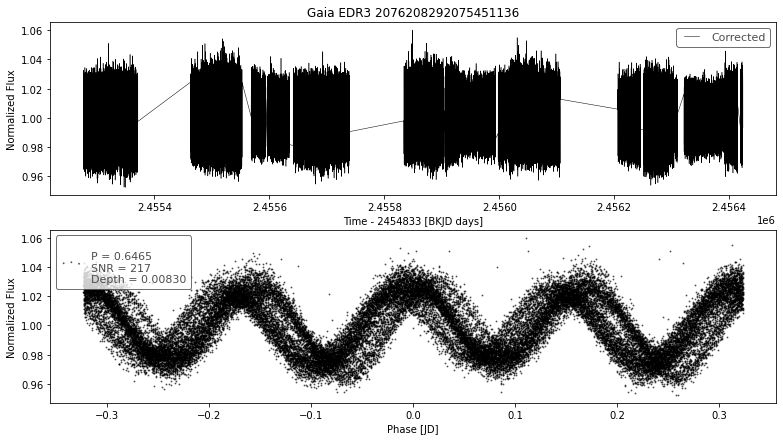

__________________________________________
index                                           4
designation         Gaia EDR3 2076209357217808384
BLS_period                               0.618034
BLS_period_SNR                         249.241304
BLS_duration                                0.399
BLS_depth                                0.055361
BLS_transit_time                   2455276.722268
batch                                          35
Name: 3404, dtype: object
ra                         295.725484
ra_error                     0.216998
dec                         39.476992
dec_error                    0.230873
pmra                        -4.352368
pmdec                       -7.189803
parallax                     0.251248
parallax_error               0.264538
phot_g_n_obs               321.000000
phot_g_mean_flux           273.357084
phot_g_mean_flux_error       1.707129
phot_g_mean_mag             19.595541
phot_bp_n_obs               39.000000
phot_bp_mean_flux           98.447888

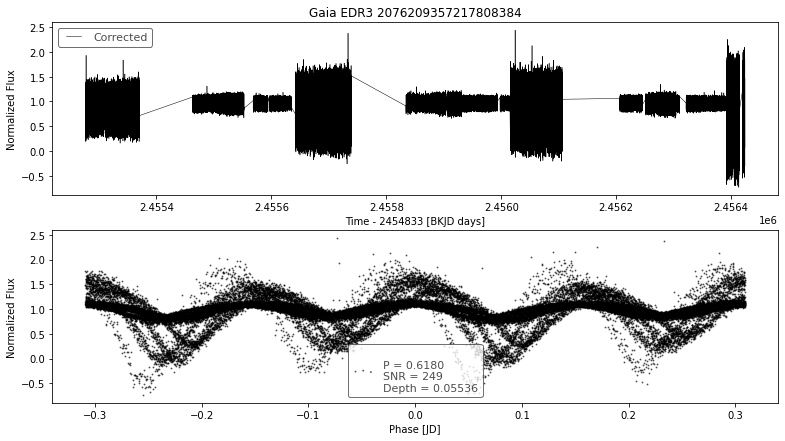

__________________________________________
index                                          33
designation         Gaia EDR3 2076209425946827904
BLS_period                                  0.916
BLS_period_SNR                          51.780878
BLS_duration                                 0.45
BLS_depth                                0.001458
BLS_transit_time                   2455277.173768
batch                                          35
Name: 3433, dtype: object
ra                          295.708623
ra_error                      0.063620
dec                          39.478408
dec_error                     0.065279
pmra                         -3.700439
pmdec                       -12.296354
parallax                      0.441194
parallax_error                0.077230
phot_g_n_obs                346.000000
phot_g_mean_flux           1611.222304
phot_g_mean_flux_error        2.348130
phot_g_mean_mag              17.669477
phot_bp_n_obs                45.000000
phot_bp_mean_flux       

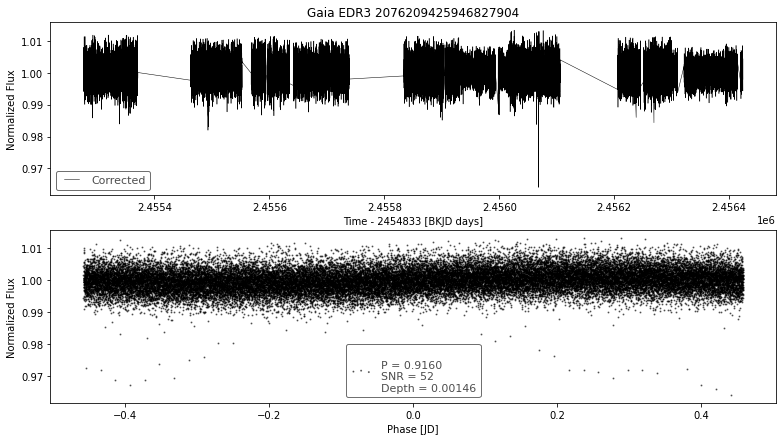

__________________________________________
index                                          35
designation         Gaia EDR3 2076209456001789056
BLS_period                               6.810999
BLS_period_SNR                         205.881085
BLS_duration                                 0.15
BLS_depth                                0.010279
BLS_transit_time                   2455278.073768
batch                                          35
Name: 3435, dtype: object
ra                          295.750317
ra_error                      0.058765
dec                          39.459486
dec_error                     0.064583
pmra                         -3.491848
pmdec                        -4.958719
parallax                      0.331256
parallax_error                0.072769
phot_g_n_obs                351.000000
phot_g_mean_flux           2041.252041
phot_g_mean_flux_error        1.644656
phot_g_mean_mag              17.412624
phot_bp_n_obs                23.000000
phot_bp_mean_flux       

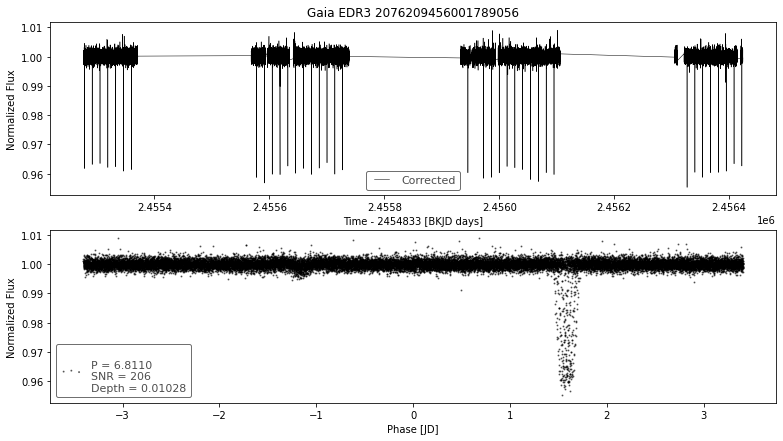

__________________________________________
index                                          38
designation         Gaia EDR3 2076209460306591744
BLS_period                               6.810999
BLS_period_SNR                         220.858914
BLS_duration                                 0.15
BLS_depth                                0.009308
BLS_transit_time                   2455278.073768
batch                                          35
Name: 3438, dtype: object
ra                          295.750477
ra_error                      0.067144
dec                          39.460341
dec_error                     0.072642
pmra                         -1.197083
pmdec                        -2.815009
parallax                      0.066803
parallax_error                0.082797
phot_g_n_obs                355.000000
phot_g_mean_flux           2454.959996
phot_g_mean_flux_error        3.321068
phot_g_mean_mag              17.212255
phot_bp_n_obs                42.000000
phot_bp_mean_flux       

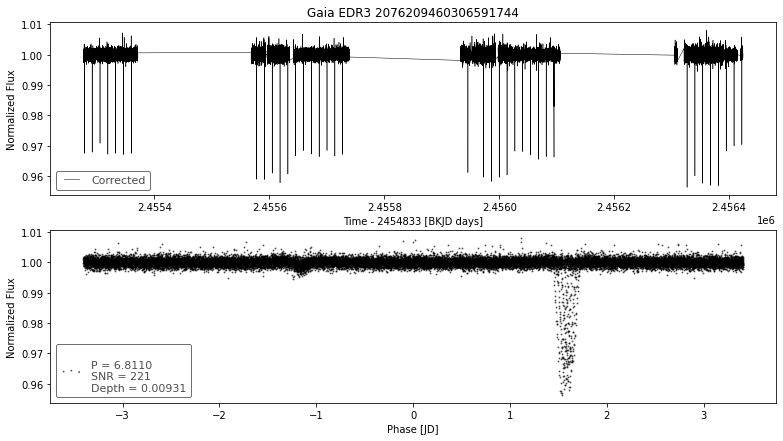

__________________________________________
index                                          40
designation         Gaia EDR3 2076209460306595328
BLS_period                               6.810999
BLS_period_SNR                          59.256934
BLS_duration                                 0.15
BLS_depth                                0.001343
BLS_transit_time                   2455278.082768
batch                                          35
Name: 3440, dtype: object
ra                           295.752461
ra_error                       0.019373
dec                           39.462321
dec_error                      0.019968
pmra                          -3.720484
pmdec                         -4.819555
parallax                       0.095109
parallax_error                 0.023232
phot_g_n_obs                 373.000000
phot_g_mean_flux           13895.241146
phot_g_mean_flux_error         3.971369
phot_g_mean_mag               15.330202
phot_bp_n_obs                 42.000000
phot_bp_mea

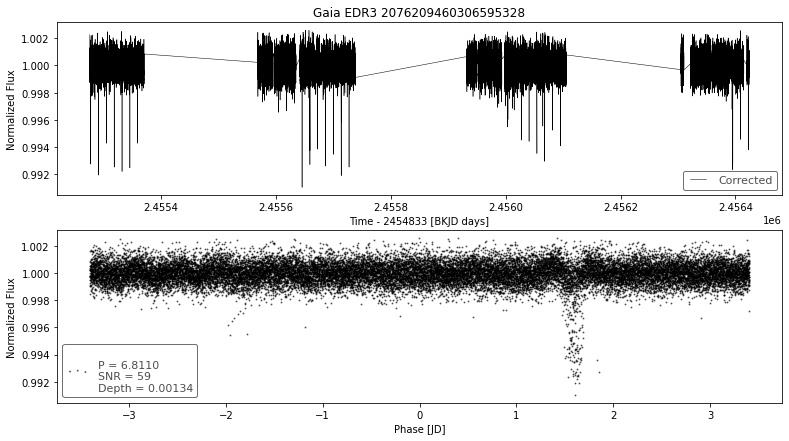

__________________________________________
index                                          96
designation         Gaia EDR3 2052181214229976832
BLS_period                               0.585238
BLS_period_SNR                          68.752254
BLS_duration                                 0.33
BLS_depth                                0.000035
BLS_transit_time                   2455276.660842
batch                                          35
Name: 3496, dtype: object
ra                            294.425566
ra_error                        0.012735
dec                            38.855656
dec_error                       0.014471
pmra                            1.697925
pmdec                          -2.853756
parallax                        2.430908
parallax_error                  0.015875
phot_g_n_obs                  344.000000
phot_g_mean_flux           506973.302071
phot_g_mean_flux_error        127.048530
phot_g_mean_mag                11.424904
phot_bp_n_obs                  44.00000

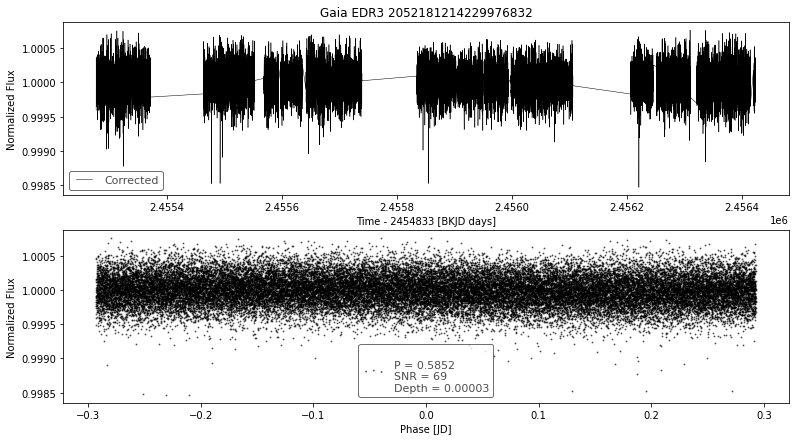

__________________________________________
index                                          13
designation         Gaia EDR3 2052192857877520640
BLS_period                               0.674707
BLS_period_SNR                          55.771864
BLS_duration                                 0.45
BLS_depth                                0.000412
BLS_transit_time                   2455276.825842
batch                                          36
Name: 3513, dtype: object
ra                         294.397451
ra_error                     0.093584
dec                         38.846437
dec_error                    0.109601
pmra                        -3.171297
pmdec                       -9.274881
parallax                     0.526750
parallax_error               0.121240
phot_g_n_obs               339.000000
phot_g_mean_flux           941.460791
phot_g_mean_flux_error       1.327188
phot_g_mean_mag             18.252861
phot_bp_n_obs               37.000000
phot_bp_mean_flux          369.661068

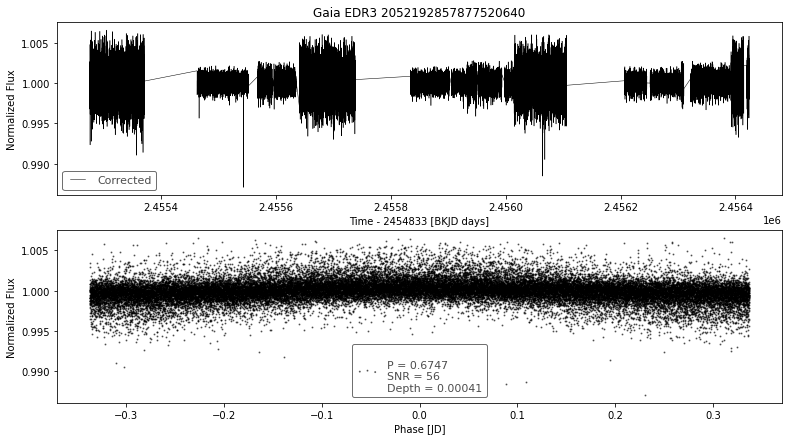

__________________________________________
index                                          20
designation         Gaia EDR3 2052192862181262720
BLS_period                               0.674707
BLS_period_SNR                         111.575523
BLS_duration                                 0.45
BLS_depth                                0.000121
BLS_transit_time                   2455276.825842
batch                                          36
Name: 3520, dtype: object
ra                            294.397165
ra_error                        0.008557
dec                            38.848784
dec_error                       0.010018
pmra                           -2.345019
pmdec                          -2.658747
parallax                        0.447893
parallax_error                  0.010571
phot_g_n_obs                  362.000000
phot_g_mean_flux           149913.619133
phot_g_mean_flux_error         24.768948
phot_g_mean_mag                12.747765
phot_bp_n_obs                  40.00000

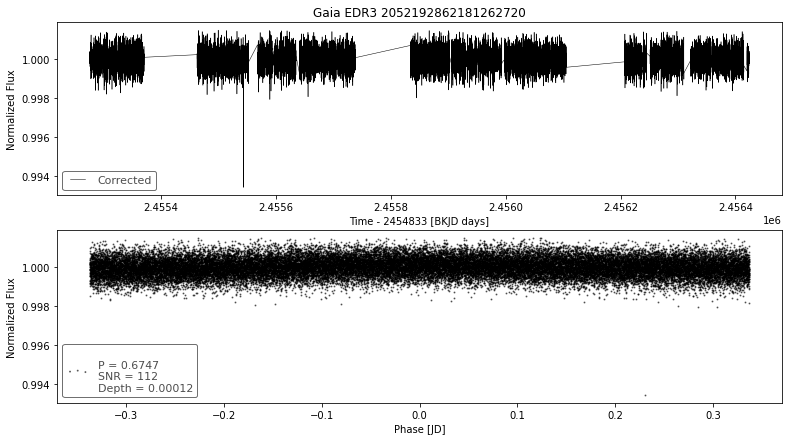

__________________________________________
index                                          21
designation         Gaia EDR3 2052192862181263872
BLS_period                               0.674707
BLS_period_SNR                         242.431003
BLS_duration                                 0.45
BLS_depth                                0.000631
BLS_transit_time                   2455276.828842
batch                                          36
Name: 3521, dtype: object
ra                          294.399299
ra_error                      0.189913
dec                          38.847699
dec_error                     0.240144
pmra                         -2.278110
pmdec                        -3.100725
parallax                      0.264724
parallax_error                0.250978
phot_g_n_obs                296.000000
phot_g_mean_flux           1989.443057
phot_g_mean_flux_error        5.575922
phot_g_mean_mag              17.440538
phot_bp_n_obs                40.000000
phot_bp_mean_flux       

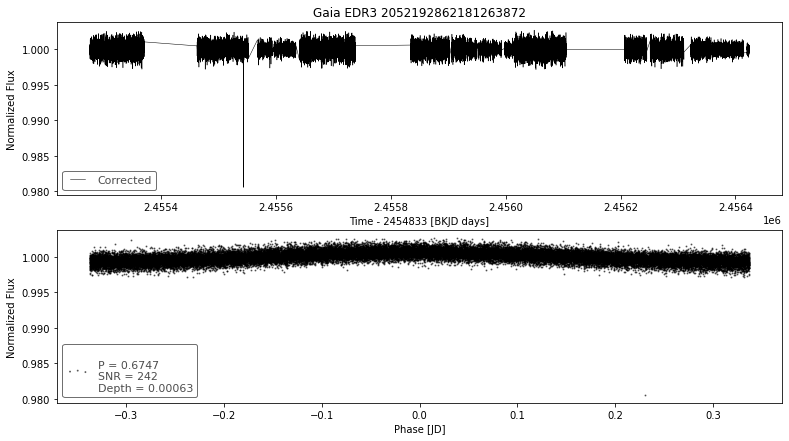

__________________________________________
index                                          99
designation         Gaia EDR3 2132712950531684480
BLS_period                               0.624639
BLS_period_SNR                        2209.443417
BLS_duration                                0.249
BLS_depth                                0.003325
BLS_transit_time                   2455276.663081
batch                                          37
Name: 3699, dtype: object
ra                           289.231170
ra_error                       0.010079
dec                           50.079785
dec_error                      0.010715
pmra                          -1.542743
pmdec                         -2.269867
parallax                       0.947793
parallax_error                 0.010855
phot_g_n_obs                 385.000000
phot_g_mean_flux           62098.991330
phot_g_mean_flux_error        45.705520
phot_g_mean_mag               13.704656
phot_bp_n_obs                 46.000000
phot_bp_mea

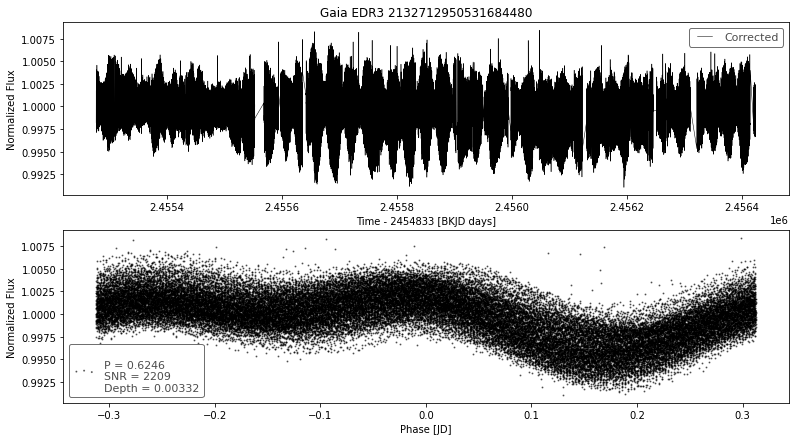

__________________________________________
index                                           2
designation         Gaia EDR3 2132712984891423616
BLS_period                               0.624639
BLS_period_SNR                         287.545779
BLS_duration                                0.249
BLS_depth                                 0.00187
BLS_transit_time                   2455276.669081
batch                                          38
Name: 3702, dtype: object
ra                          289.229802
ra_error                      0.036559
dec                          50.082755
dec_error                     0.039261
pmra                          1.549840
pmdec                        20.395002
parallax                      1.200474
parallax_error                0.039790
phot_g_n_obs                391.000000
phot_g_mean_flux           3855.307046
phot_g_mean_flux_error        2.052643
phot_g_mean_mag              16.722220
phot_bp_n_obs                43.000000
phot_bp_mean_flux       

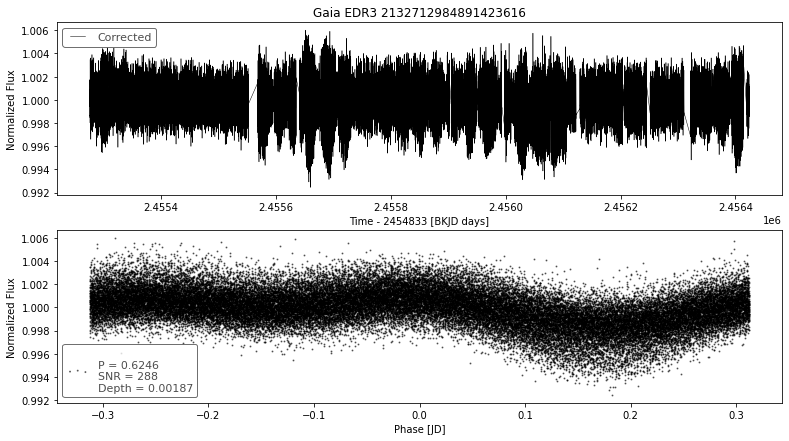

__________________________________________
index                                          45
designation         Gaia EDR3 2133329673475272960
BLS_period                                0.59769
BLS_period_SNR                          66.579811
BLS_duration                                 0.45
BLS_depth                                0.000172
BLS_transit_time                   2455276.805666
batch                                          38
Name: 3745, dtype: object
ra                           288.252076
ra_error                       0.012177
dec                           50.988984
dec_error                      0.012825
pmra                          -3.147253
pmdec                         -2.823499
parallax                       0.178274
parallax_error                 0.013119
phot_g_n_obs                 322.000000
phot_g_mean_flux           56319.726501
phot_g_mean_flux_error        10.752193
phot_g_mean_mag               13.810716
phot_bp_n_obs                 34.000000
phot_bp_mea

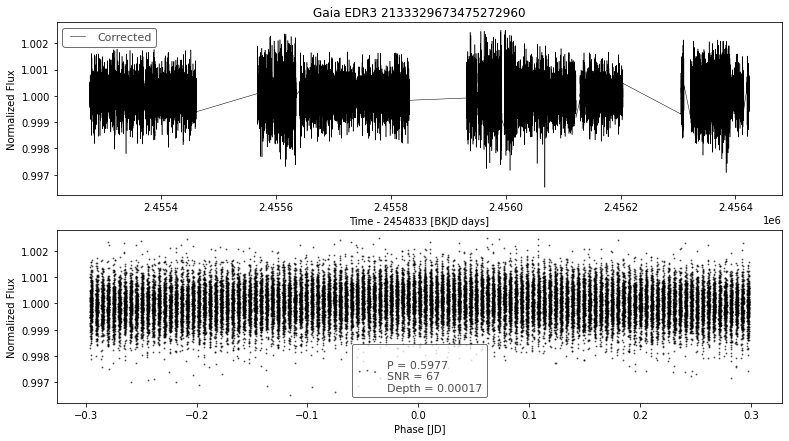

__________________________________________
index                                          50
designation         Gaia EDR3 2128906028960820992
BLS_period                               0.607837
BLS_period_SNR                          34.908178
BLS_duration                                 0.45
BLS_depth                                0.000029
BLS_transit_time                    2455276.87126
batch                                          39
Name: 3850, dtype: object
ra                            293.131733
ra_error                        0.009288
dec                            48.321996
dec_error                       0.010066
pmra                           -2.192675
pmdec                          -8.871500
parallax                        0.747118
parallax_error                  0.010550
phot_g_n_obs                  365.000000
phot_g_mean_flux           292848.108098
phot_g_mean_flux_error         49.962643
phot_g_mean_mag                12.020761
phot_bp_n_obs                  43.00000

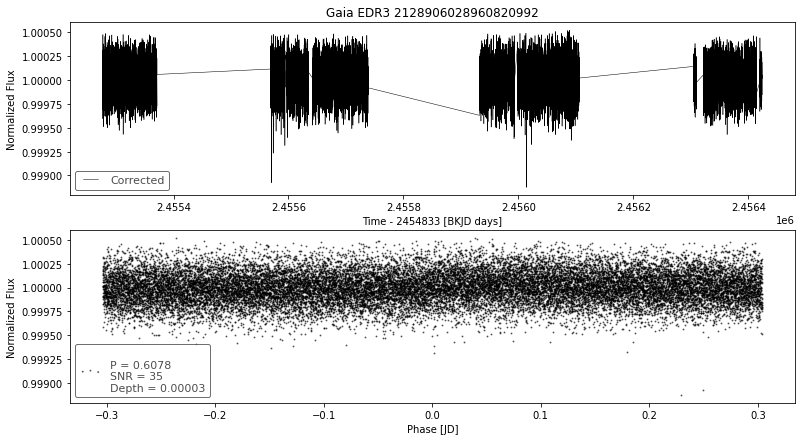

__________________________________________
index                                          43
designation         Gaia EDR3 2129514093249096832
BLS_period                               0.875163
BLS_period_SNR                        2212.474617
BLS_duration                                 0.45
BLS_depth                                0.015545
BLS_transit_time                   2455277.168417
batch                                          40
Name: 3943, dtype: object
ra                          290.737037
ra_error                      0.031519
dec                          48.583173
dec_error                     0.030275
pmra                         -1.169422
pmdec                        -6.218980
parallax                      0.197280
parallax_error                0.031227
phot_g_n_obs                336.000000
phot_g_mean_flux           6684.887459
phot_g_mean_flux_error       20.480555
phot_g_mean_mag              16.124632
phot_bp_n_obs                37.000000
phot_bp_mean_flux       

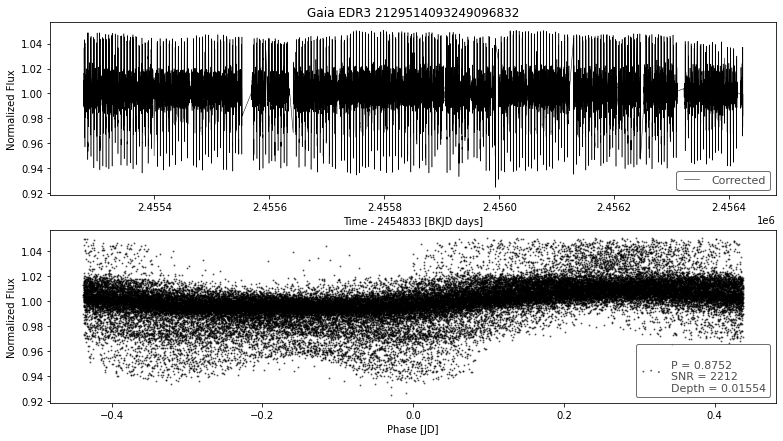

__________________________________________
index                                          98
designation         Gaia EDR3 2127957631462760064
BLS_period                               0.637085
BLS_period_SNR                          28.917265
BLS_duration                                 0.45
BLS_depth                                0.000052
BLS_transit_time                   2455276.865113
batch                                          41
Name: 4098, dtype: object
ra                           293.901356
ra_error                       0.010820
dec                           45.241855
dec_error                      0.012302
pmra                          -3.489341
pmdec                         -4.078003
parallax                       0.215658
parallax_error                 0.012521
phot_g_n_obs                 401.000000
phot_g_mean_flux           43670.025914
phot_g_mean_flux_error         8.973936
phot_g_mean_mag               14.086908
phot_bp_n_obs                 46.000000
phot_bp_mea

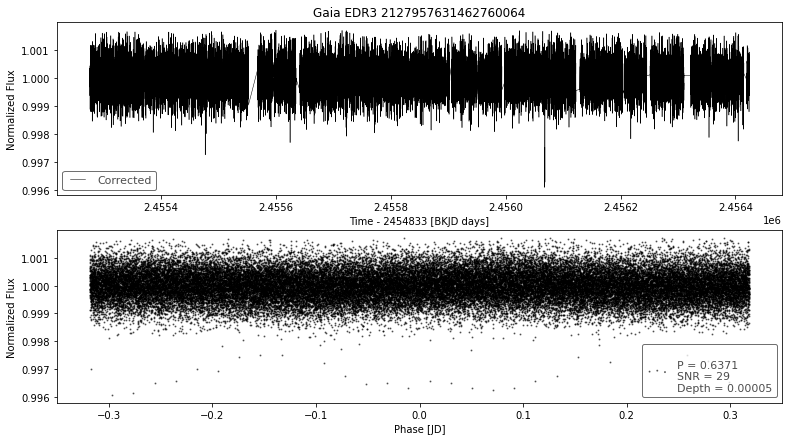

__________________________________________
index                                           6
designation         Gaia EDR3 2127957700182224256
BLS_period                               0.703654
BLS_period_SNR                         870.363228
BLS_duration                                 0.33
BLS_depth                                0.009893
BLS_transit_time                   2455276.655113
batch                                          42
Name: 4106, dtype: object
ra                          293.874203
ra_error                      0.035765
dec                          45.223999
dec_error                     0.041420
pmra                          4.431260
pmdec                         1.116559
parallax                      5.953327
parallax_error                0.041449
phot_g_n_obs                393.000000
phot_g_mean_flux           4178.306347
phot_g_mean_flux_error        5.066970
phot_g_mean_mag              16.634867
phot_bp_n_obs                45.000000
phot_bp_mean_flux       

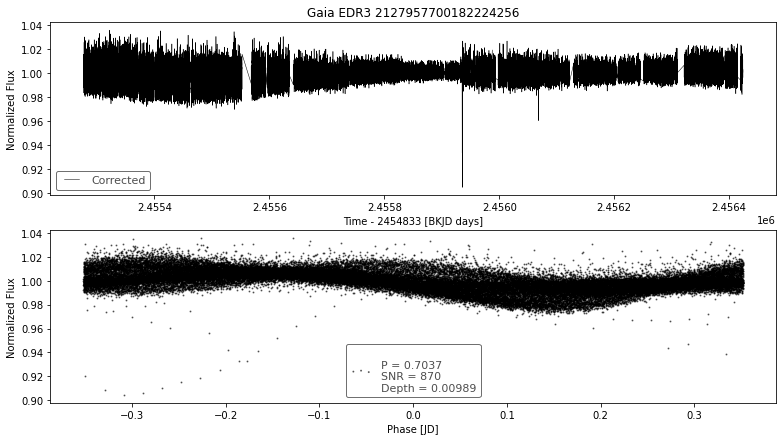

__________________________________________
index                                           9
designation         Gaia EDR3 2127957734541969152
BLS_period                               0.658113
BLS_period_SNR                        2247.628501
BLS_duration                                0.051
BLS_depth                                0.108678
BLS_transit_time                   2455276.884613
batch                                          42
Name: 4109, dtype: object
ra                          293.883011
ra_error                      0.054601
dec                          45.238419
dec_error                     0.063834
pmra                         -2.710177
pmdec                        -4.346311
parallax                      0.175244
parallax_error                0.065254
phot_g_n_obs                406.000000
phot_g_mean_flux           1752.898586
phot_g_mean_flux_error        7.407860
phot_g_mean_mag              17.577974
phot_bp_n_obs                48.000000
phot_bp_mean_flux       

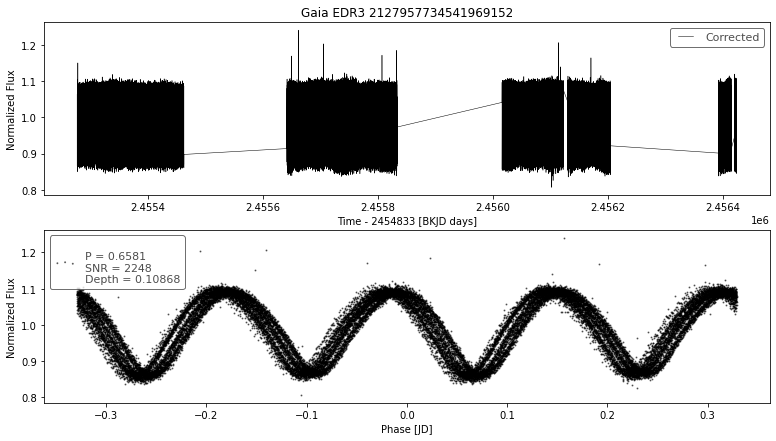

__________________________________________
index                                          69
designation         Gaia EDR3 2128267968619535872
BLS_period                               0.515723
BLS_period_SNR                         108.851796
BLS_duration                                0.051
BLS_depth                                0.002313
BLS_transit_time                   2455276.959706
batch                                          42
Name: 4169, dtype: object
ra                          293.020015
ra_error                      0.043365
dec                          46.250924
dec_error                     0.044593
pmra                         -1.910311
pmdec                        -3.451615
parallax                      0.365845
parallax_error                0.046168
phot_g_n_obs                384.000000
phot_g_mean_flux           3287.360871
phot_g_mean_flux_error        1.778910
phot_g_mean_mag              16.895248
phot_bp_n_obs                43.000000
phot_bp_mean_flux       

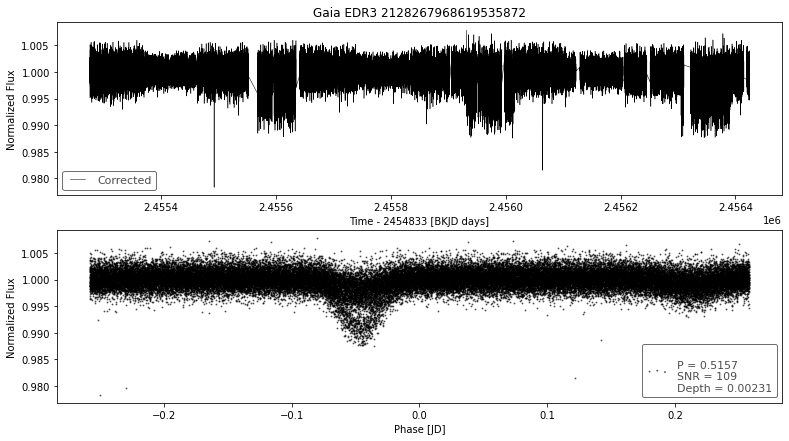

__________________________________________
index                                          70
designation         Gaia EDR3 2128267968619540736
BLS_period                               0.662142
BLS_period_SNR                          54.636532
BLS_duration                                 0.45
BLS_depth                                0.000059
BLS_transit_time                   2455276.727206
batch                                          42
Name: 4170, dtype: object
ra                          293.023342
ra_error                      0.026278
dec                          46.261724
dec_error                     0.026953
pmra                         -2.757253
pmdec                       -12.899527
parallax                      0.355762
parallax_error                0.028040
phot_g_n_obs                382.000000
phot_g_mean_flux           9711.813706
phot_g_mean_flux_error        3.470456
phot_g_mean_mag              15.719116
phot_bp_n_obs                40.000000
phot_bp_mean_flux       

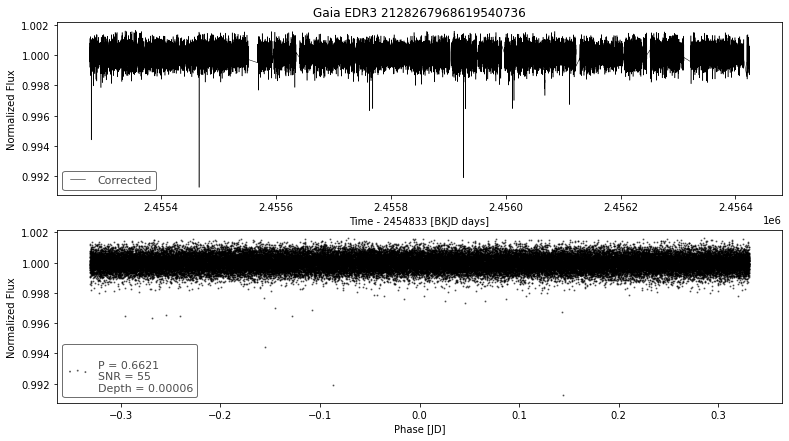

__________________________________________
index                                          72
designation         Gaia EDR3 2128267998677532928
BLS_period                               0.639649
BLS_period_SNR                          76.117078
BLS_duration                                 0.45
BLS_depth                                0.000053
BLS_transit_time                   2455276.931206
batch                                          42
Name: 4172, dtype: object
ra                            293.024129
ra_error                        0.007990
dec                            46.263857
dec_error                       0.008059
pmra                           -1.987459
pmdec                         -12.371086
parallax                        0.520980
parallax_error                  0.008582
phot_g_n_obs                  375.000000
phot_g_mean_flux           271927.718370
phot_g_mean_flux_error         39.140800
phot_g_mean_mag                12.101233
phot_bp_n_obs                  41.00000

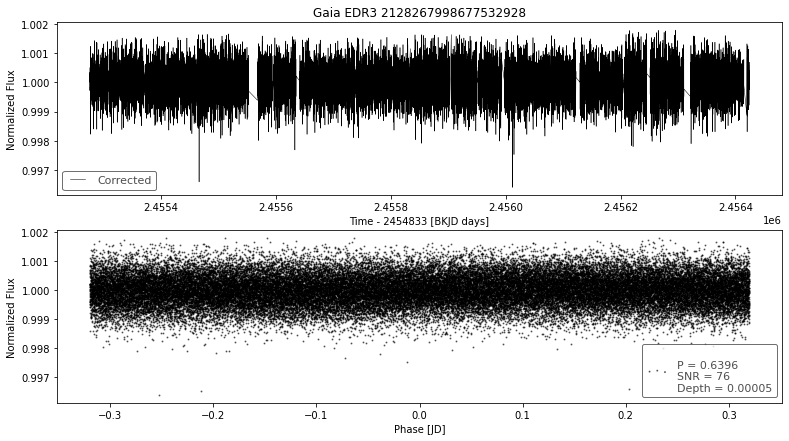

__________________________________________
index                                          81
designation         Gaia EDR3 2128268587094813056
BLS_period                               0.585238
BLS_period_SNR                        1278.572683
BLS_duration                                 0.45
BLS_depth                                0.014116
BLS_transit_time                   2455276.715206
batch                                          42
Name: 4181, dtype: object
ra                          293.007847
ra_error                      0.031604
dec                          46.238073
dec_error                     0.034654
pmra                         -0.893044
pmdec                        -5.154255
parallax                      0.199515
parallax_error                0.034405
phot_g_n_obs                384.000000
phot_g_mean_flux           5463.247111
phot_g_mean_flux_error        9.595496
phot_g_mean_mag              16.343740
phot_bp_n_obs                44.000000
phot_bp_mean_flux       

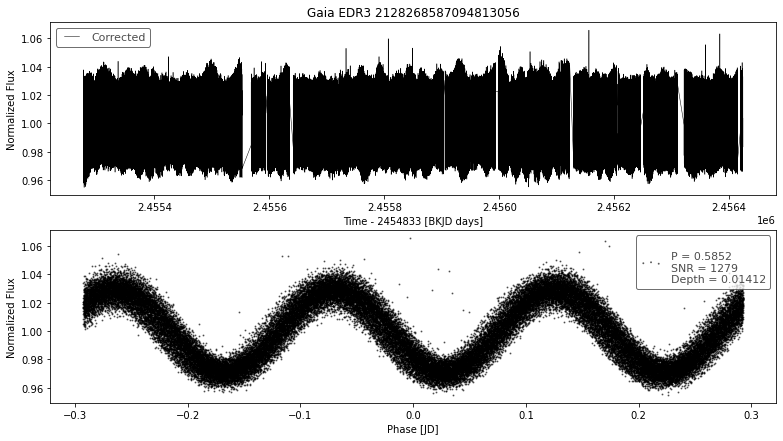

__________________________________________
index                                          36
designation         Gaia EDR3 2128157325963751680
BLS_period                               0.562013
BLS_period_SNR                         157.593762
BLS_duration                                 0.45
BLS_depth                                 0.01166
BLS_transit_time                   2455276.844143
batch                                          43
Name: 4236, dtype: object
ra                         294.382229
ra_error                     0.199472
dec                         46.820192
dec_error                    0.222204
pmra                        -1.170858
pmdec                       -8.211088
parallax                     0.239647
parallax_error               0.231126
phot_g_n_obs               315.000000
phot_g_mean_flux           376.000396
phot_g_mean_flux_error       1.052903
phot_g_mean_mag             19.249395
phot_bp_n_obs               31.000000
phot_bp_mean_flux          121.438469

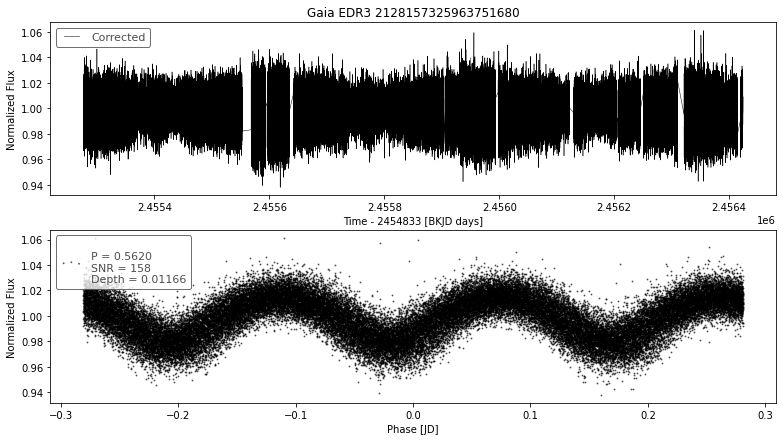

__________________________________________
index                                          37
designation         Gaia EDR3 2128157330263387264
BLS_period                               0.562013
BLS_period_SNR                          73.217755
BLS_duration                                 0.45
BLS_depth                                0.006685
BLS_transit_time                   2455276.847143
batch                                          43
Name: 4237, dtype: object
ra                         294.381912
ra_error                     0.157436
dec                         46.822351
dec_error                    0.172085
pmra                        -2.243877
pmdec                       -8.299907
parallax                     0.708627
parallax_error               0.177570
phot_g_n_obs               319.000000
phot_g_mean_flux           484.360677
phot_g_mean_flux_error       1.049334
phot_g_mean_mag             18.974445
phot_bp_n_obs               33.000000
phot_bp_mean_flux          245.847466

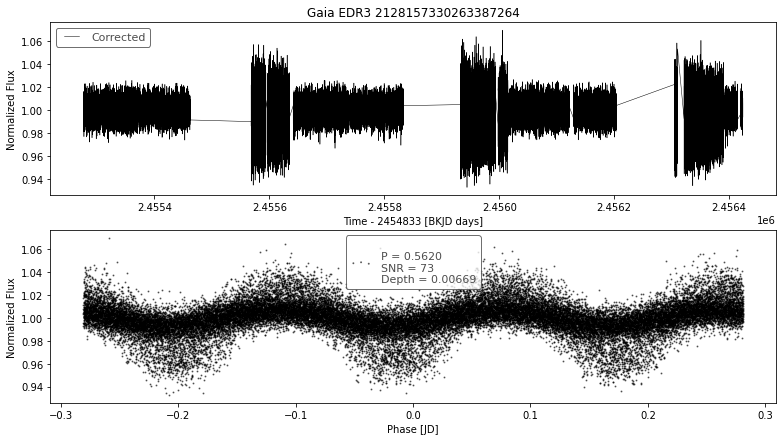

__________________________________________
index                                          75
designation         Gaia EDR3 2128160280901253248
BLS_period                               0.562013
BLS_period_SNR                          98.616886
BLS_duration                                 0.45
BLS_depth                                0.008374
BLS_transit_time                   2455276.835143
batch                                          43
Name: 4275, dtype: object
ra                         294.374261
ra_error                     0.155843
dec                         46.822449
dec_error                    0.177431
pmra                        -3.535307
pmdec                       -2.667813
parallax                     0.932931
parallax_error               0.175918
phot_g_n_obs               310.000000
phot_g_mean_flux           537.441219
phot_g_mean_flux_error       1.225284
phot_g_mean_mag             18.861540
phot_bp_n_obs               33.000000
phot_bp_mean_flux          178.230543

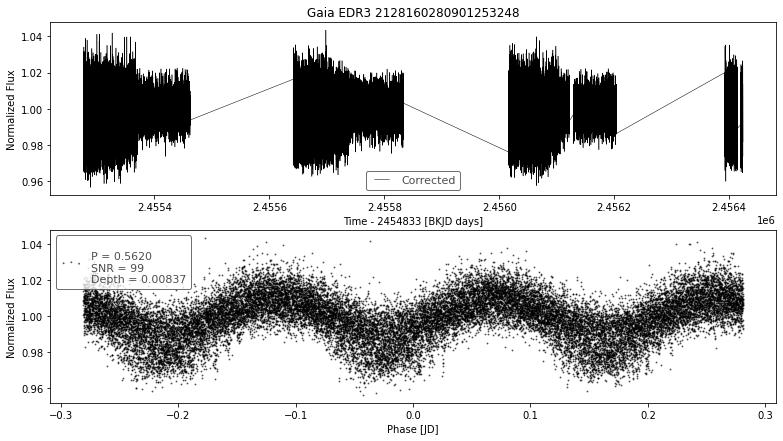

__________________________________________
index                                          76
designation         Gaia EDR3 2128160285200885888
BLS_period                               0.562013
BLS_period_SNR                        10627.81418
BLS_duration                                 0.45
BLS_depth                                0.052248
BLS_transit_time                   2455276.844143
batch                                          43
Name: 4276, dtype: object
ra                           294.378356
ra_error                       0.326499
dec                           46.820462
dec_error                      0.339379
pmra                          -7.433014
pmdec                        -12.279168
parallax                      -0.538841
parallax_error                 0.350908
phot_g_n_obs                 348.000000
phot_g_mean_flux           16363.025036
phot_g_mean_flux_error        76.914750
phot_g_mean_mag               15.152708
phot_bp_n_obs                 38.000000
phot_bp_mea

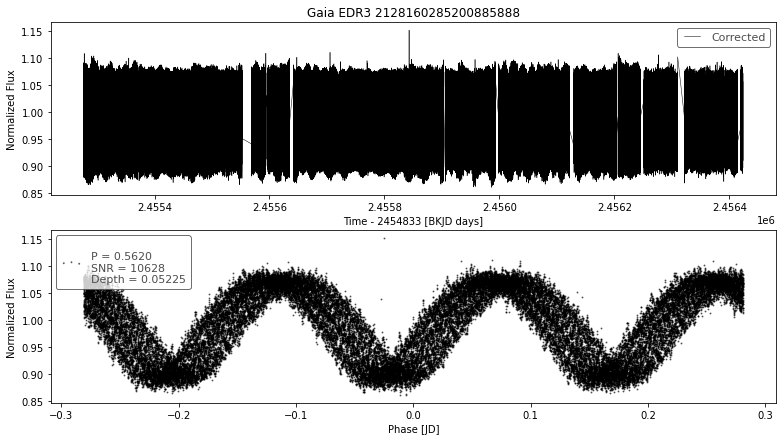

__________________________________________
index                                          91
designation         Gaia EDR3 2080017648879407616
BLS_period                               0.677765
BLS_period_SNR                         361.748532
BLS_duration                                0.201
BLS_depth                                0.000295
BLS_transit_time                   2455276.662548
batch                                          43
Name: 4291, dtype: object
ra                            295.247324
ra_error                        0.017627
dec                            45.757386
dec_error                       0.016768
pmra                           -4.000793
pmdec                          -6.660429
parallax                        0.968438
parallax_error                  0.018760
phot_g_n_obs                  314.000000
phot_g_mean_flux           165008.210824
phot_g_mean_flux_error         51.050970
phot_g_mean_mag                12.643603
phot_bp_n_obs                  36.00000

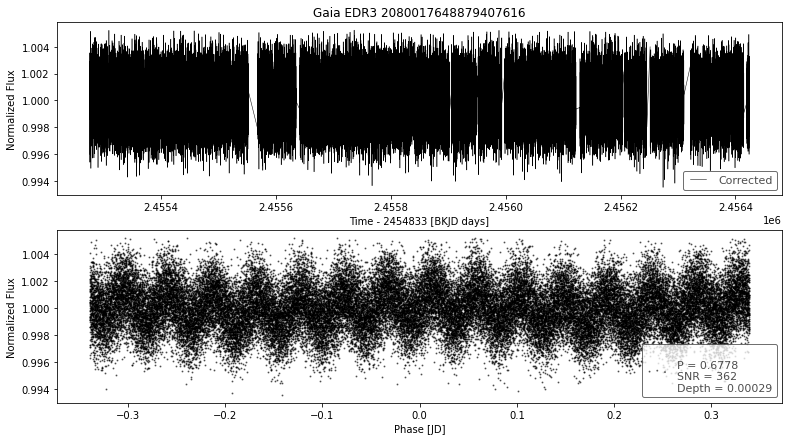

__________________________________________
index                                          97
designation         Gaia EDR3 2080017653182617600
BLS_period                               0.902665
BLS_period_SNR                         130.631141
BLS_duration                                 0.45
BLS_depth                                 0.01329
BLS_transit_time                   2455276.715048
batch                                          43
Name: 4297, dtype: object
ra                         295.232416
ra_error                     0.273136
dec                         45.765395
dec_error                    0.269824
pmra                        -4.263960
pmdec                       -4.786696
parallax                     0.210701
parallax_error               0.313227
phot_g_n_obs               232.000000
phot_g_mean_flux           312.184055
phot_g_mean_flux_error       1.232285
phot_g_mean_mag             19.451340
phot_bp_n_obs               24.000000
phot_bp_mean_flux           88.731471

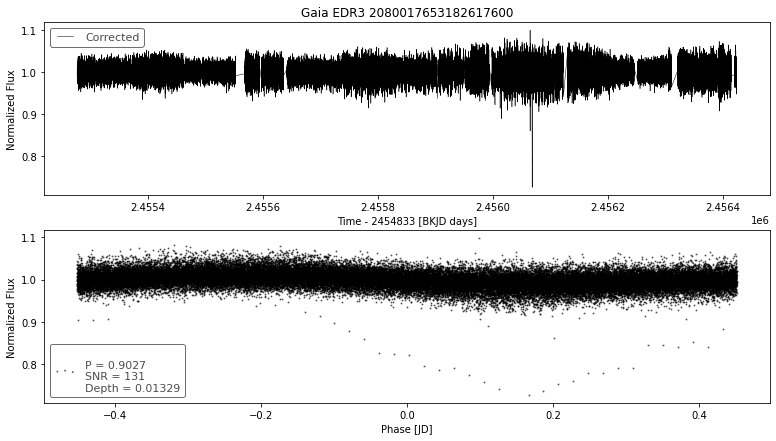

__________________________________________
index                                          98
designation         Gaia EDR3 2080017653183613952
BLS_period                               0.677765
BLS_period_SNR                         319.650384
BLS_duration                                0.201
BLS_depth                                0.000299
BLS_transit_time                   2455276.662548
batch                                          43
Name: 4298, dtype: object
ra                          295.246867
ra_error                      0.262791
dec                          45.758017
dec_error                     0.276203
pmra                        -17.955687
pmdec                       -25.512394
parallax                      0.189376
parallax_error                0.294362
phot_g_n_obs                178.000000
phot_g_mean_flux            498.445083
phot_g_mean_flux_error        3.890272
phot_g_mean_mag              18.943323
phot_bp_n_obs                 7.000000
phot_bp_mean_flux       

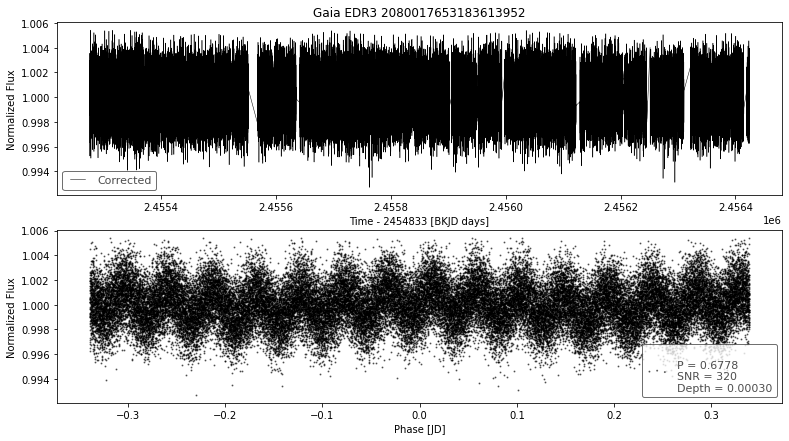

__________________________________________
index                                          61
designation         Gaia EDR3 2079994181178267776
BLS_period                               0.576871
BLS_period_SNR                          90.339108
BLS_duration                                 0.45
BLS_depth                                0.003843
BLS_transit_time                   2455276.841048
batch                                          44
Name: 4361, dtype: object
ra                          295.201494
ra_error                      0.205403
dec                          45.736029
dec_error                     0.191221
pmra                          6.343434
pmdec                        -0.039935
parallax                      1.473312
parallax_error                0.218370
phot_g_n_obs                263.000000
phot_g_mean_flux            586.849081
phot_g_mean_flux_error        1.964115
phot_g_mean_mag              18.766050
phot_bp_n_obs                32.000000
phot_bp_mean_flux       

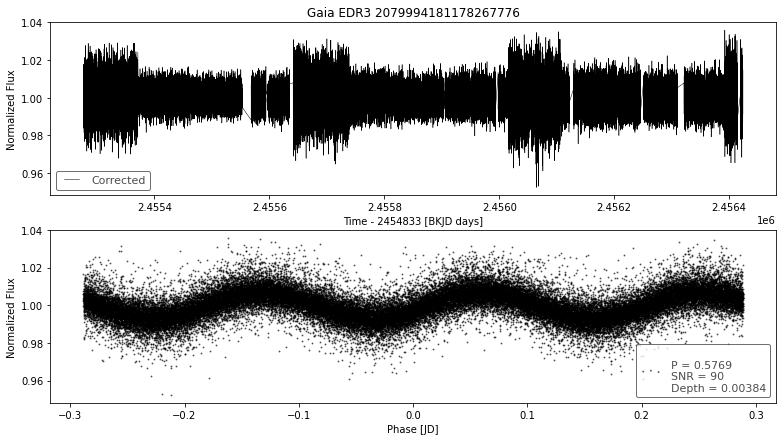

__________________________________________
index                                          47
designation         Gaia EDR3 2077240900988331264
BLS_period                               0.847447
BLS_period_SNR                          61.089181
BLS_duration                                 0.45
BLS_depth                                0.000022
BLS_transit_time                   2455277.134872
batch                                          45
Name: 4447, dtype: object
ra                            295.844172
ra_error                        0.013739
dec                            42.742808
dec_error                       0.013255
pmra                           -3.348117
pmdec                          -3.926361
parallax                        0.432870
parallax_error                  0.015141
phot_g_n_obs                  373.000000
phot_g_mean_flux           557402.443733
phot_g_mean_flux_error        196.343580
phot_g_mean_mag                11.321944
phot_bp_n_obs                  45.00000

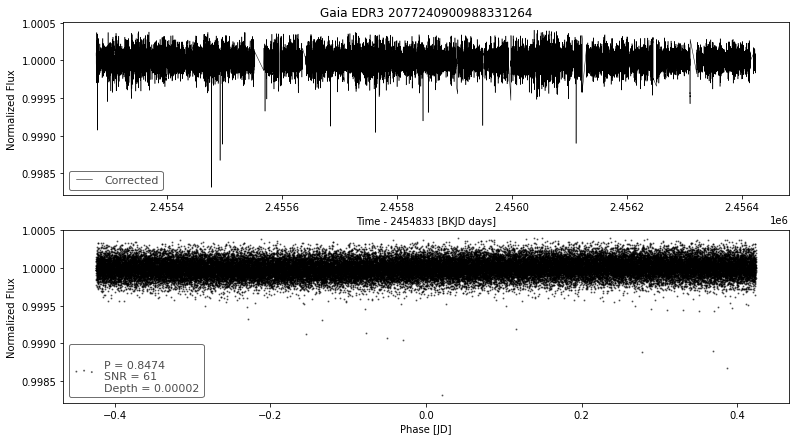

__________________________________________
index                                           3
designation         Gaia EDR3 2077246024892437120
BLS_period                              12.062975
BLS_period_SNR                          265.02482
BLS_duration                                 0.45
BLS_depth                                0.008314
BLS_transit_time                   2455278.235872
batch                                          46
Name: 4503, dtype: object
ra                         2.959042e+02
ra_error                   4.970892e+00
dec                        4.274681e+01
dec_error                  5.207295e+00
pmra                       1.000000e+20
pmdec                      1.000000e+20
parallax                   1.000000e+20
parallax_error             1.000000e+20
phot_g_n_obs               3.700000e+02
phot_g_mean_flux           2.151647e+03
phot_g_mean_flux_error     3.137214e+01
phot_g_mean_mag            1.735544e+01
phot_bp_n_obs              4.100000e+01
phot_bp_mea

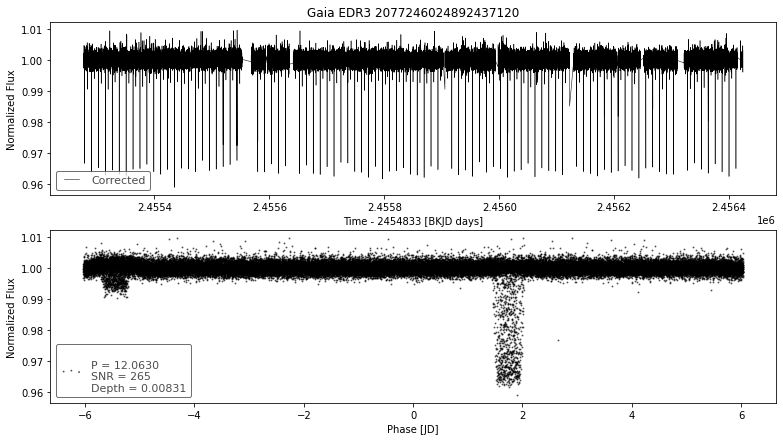

__________________________________________
index                                          39
designation         Gaia EDR3 2078114158039040768
BLS_period                                   30.0
BLS_period_SNR                          59.723204
BLS_duration                                 0.15
BLS_depth                                0.000113
BLS_transit_time                   2455296.697964
batch                                          46
Name: 4539, dtype: object
ra                         2.950434e+02
ra_error                   1.126397e-02
dec                        4.376087e+01
dec_error                  1.139801e-02
pmra                      -1.277612e+00
pmdec                     -3.061851e+00
parallax                   3.825642e-01
parallax_error             1.245502e-02
phot_g_n_obs               3.300000e+02
phot_g_mean_flux           1.022082e+06
phot_g_mean_flux_error     4.111810e+02
phot_g_mean_mag            1.066365e+01
phot_bp_n_obs              3.900000e+01
phot_bp_mea

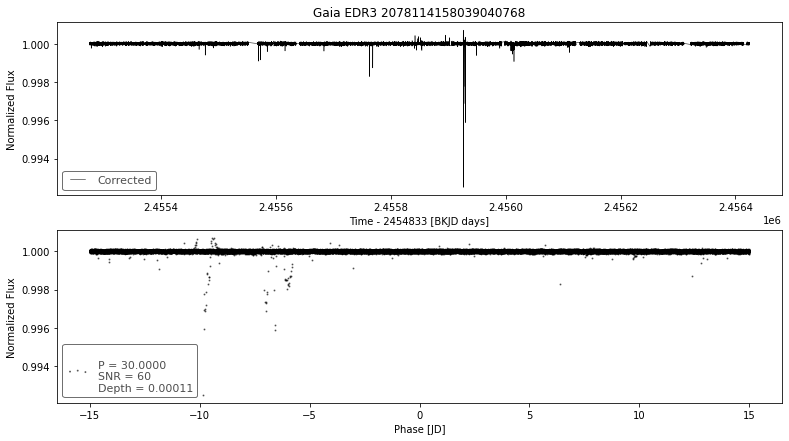

__________________________________________
index                                          50
designation         Gaia EDR3 2078114226753833344
BLS_period                               0.596708
BLS_period_SNR                          60.570149
BLS_duration                                 0.45
BLS_depth                                0.000184
BLS_transit_time                   2455276.831964
batch                                          46
Name: 4550, dtype: object
ra                         295.079334
ra_error                     0.207794
dec                         43.772999
dec_error                    0.232684
pmra                        -1.698385
pmdec                       -5.591656
parallax                     0.340337
parallax_error               0.293491
phot_g_n_obs               248.000000
phot_g_mean_flux           434.388399
phot_g_mean_flux_error       1.581317
phot_g_mean_mag             19.092670
phot_bp_n_obs                2.000000
phot_bp_mean_flux          509.163593

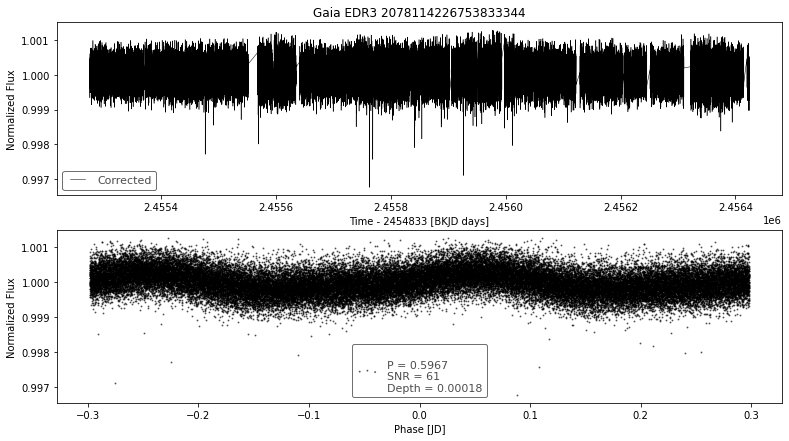

__________________________________________
index                                          51
designation         Gaia EDR3 2078114226758541184
BLS_period                               0.596708
BLS_period_SNR                          54.774612
BLS_duration                                 0.45
BLS_depth                                0.000189
BLS_transit_time                   2455276.837964
batch                                          46
Name: 4551, dtype: object
ra                           295.079294
ra_error                       0.028006
dec                           43.772429
dec_error                      0.028306
pmra                           6.366773
pmdec                         -0.343890
parallax                       0.945832
parallax_error                 0.031218
phot_g_n_obs                 359.000000
phot_g_mean_flux           20895.933884
phot_g_mean_flux_error         8.858290
phot_g_mean_mag               14.887213
phot_bp_n_obs                 38.000000
phot_bp_mea

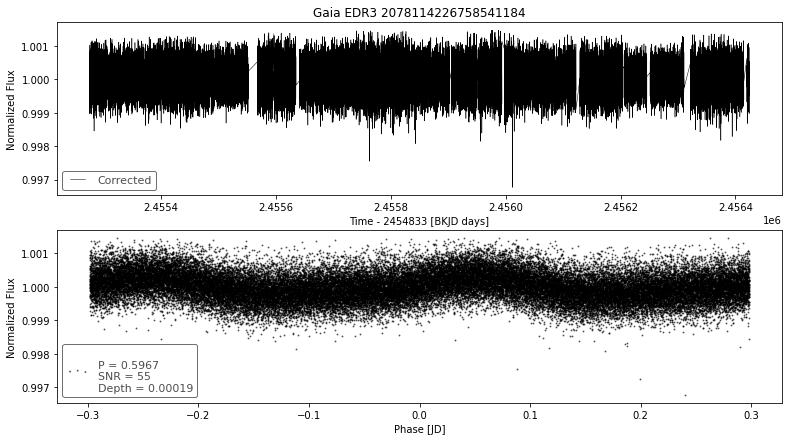

__________________________________________
index                                          31
designation         Gaia EDR3 2078117181696007296
BLS_period                               0.983511
BLS_period_SNR                        20997.42878
BLS_duration                                0.099
BLS_depth                                0.112806
BLS_transit_time                   2455277.397464
batch                                          47
Name: 4631, dtype: object
ra                           295.012986
ra_error                       0.018671
dec                           43.773057
dec_error                      0.018549
pmra                          -2.239000
pmdec                         -3.953531
parallax                       0.372984
parallax_error                 0.021254
phot_g_n_obs                 351.000000
phot_g_mean_flux           17261.719339
phot_g_mean_flux_error        78.782440
phot_g_mean_mag               15.094657
phot_bp_n_obs                 39.000000
phot_bp_mea

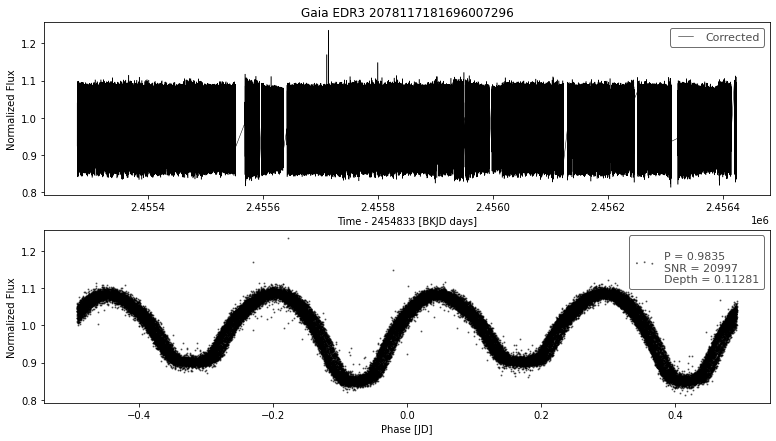

__________________________________________
index                                          42
designation         Gaia EDR3 2079682577014557056
BLS_period                               0.515252
BLS_period_SNR                          11.286846
BLS_duration                                 0.45
BLS_depth                                0.000104
BLS_transit_time                   2455276.786901
batch                                          48
Name: 4742, dtype: object
ra                          296.401617
ra_error                      0.024526
dec                          44.341953
dec_error                     0.028196
pmra                         -0.021741
pmdec                        -2.732936
parallax                      0.385632
parallax_error                0.028750
phot_g_n_obs                351.000000
phot_g_mean_flux           8299.638427
phot_g_mean_flux_error        3.131614
phot_g_mean_mag              15.889719
phot_bp_n_obs                41.000000
phot_bp_mean_flux       

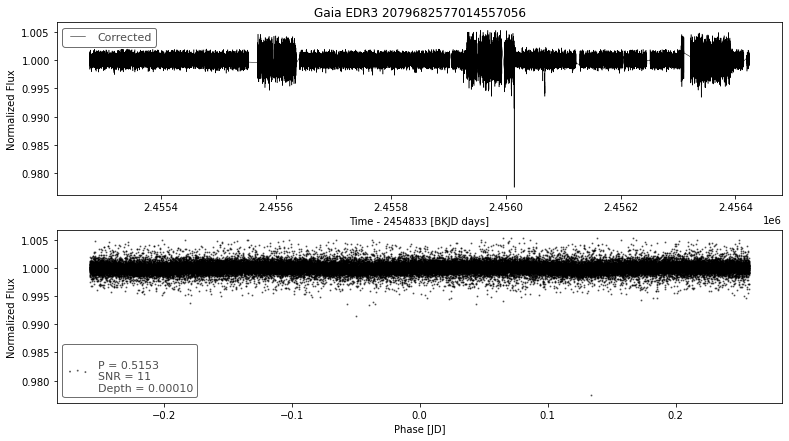

__________________________________________
index                                          46
designation         Gaia EDR3 2078734140854330112
BLS_period                               0.525477
BLS_period_SNR                          11.409901
BLS_duration                                 0.45
BLS_depth                                0.001495
BLS_transit_time                   2455276.720808
batch                                          48
Name: 4746, dtype: object
ra                         297.186975
ra_error                     0.148804
dec                         43.255382
dec_error                    0.192721
pmra                        -2.574630
pmdec                       -0.810300
parallax                     0.583514
parallax_error               0.186442
phot_g_n_obs               351.000000
phot_g_mean_flux           441.571982
phot_g_mean_flux_error       1.045601
phot_g_mean_mag             19.074863
phot_bp_n_obs               39.000000
phot_bp_mean_flux          149.915746

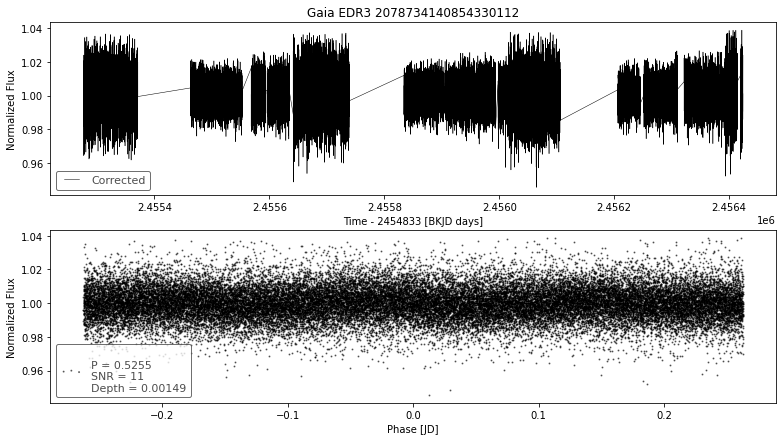

__________________________________________
index                                          82
designation         Gaia EDR3 2078734248237281664
BLS_period                               0.678942
BLS_period_SNR                          16.060139
BLS_duration                                 0.45
BLS_depth                                0.000023
BLS_transit_time                   2455276.762808
batch                                          48
Name: 4782, dtype: object
ra                           297.172960
ra_error                       0.019393
dec                           43.257141
dec_error                      0.023022
pmra                          -4.755943
pmdec                        -11.519371
parallax                       0.652127
parallax_error                 0.022878
phot_g_n_obs                 398.000000
phot_g_mean_flux           12367.180531
phot_g_mean_flux_error         4.071491
phot_g_mean_mag               15.456690
phot_bp_n_obs                 47.000000
phot_bp_mea

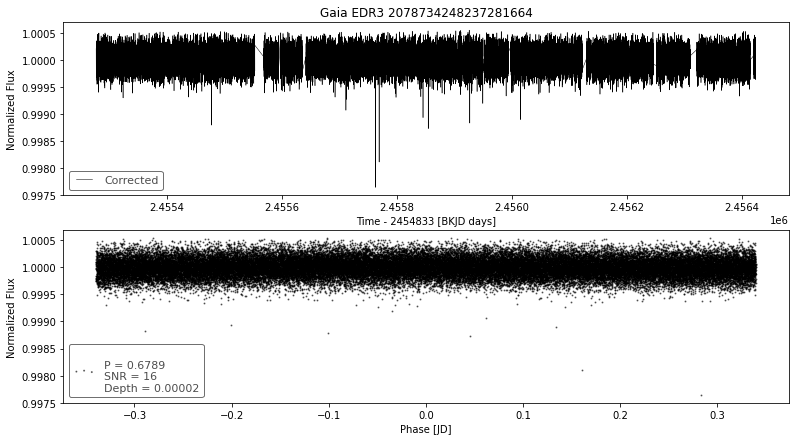

__________________________________________
index                                          83
designation         Gaia EDR3 2078734248237282432
BLS_period                               0.678942
BLS_period_SNR                          17.219906
BLS_duration                                 0.45
BLS_depth                                0.000024
BLS_transit_time                   2455276.762808
batch                                          48
Name: 4783, dtype: object
ra                           297.173501
ra_error                       0.010780
dec                           43.258305
dec_error                      0.012709
pmra                          -0.581858
pmdec                         -9.317968
parallax                       0.893943
parallax_error                 0.012898
phot_g_n_obs                 379.000000
phot_g_mean_flux           55069.506479
phot_g_mean_flux_error        11.277792
phot_g_mean_mag               13.835089
phot_bp_n_obs                 45.000000
phot_bp_mea

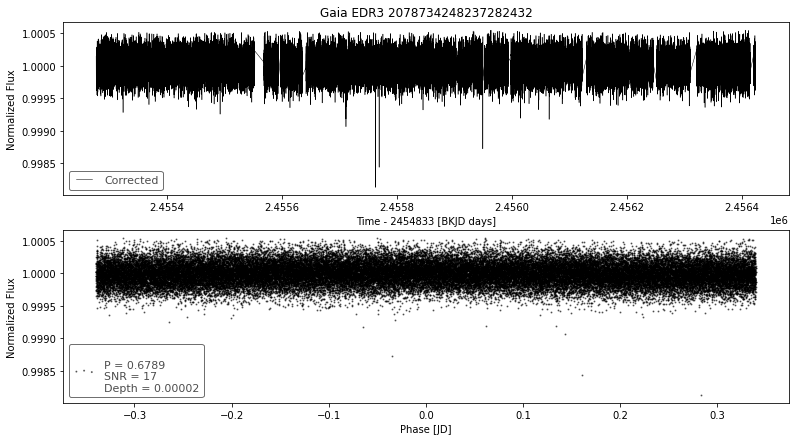

__________________________________________
index                                          59
designation         Gaia EDR3 2078735858841858816
BLS_period                                2.41477
BLS_period_SNR                         206.695522
BLS_duration                                0.174
BLS_depth                                0.016721
BLS_transit_time                   2455278.490808
batch                                          49
Name: 4859, dtype: object
ra                         297.191294
ra_error                     0.099944
dec                         43.290412
dec_error                    0.121274
pmra                        -2.620205
pmdec                       -3.518845
parallax                     0.147843
parallax_error               0.121798
phot_g_n_obs               375.000000
phot_g_mean_flux           757.332829
phot_g_mean_flux_error       1.113284
phot_g_mean_mag             18.489150
phot_bp_n_obs               43.000000
phot_bp_mean_flux          341.200359

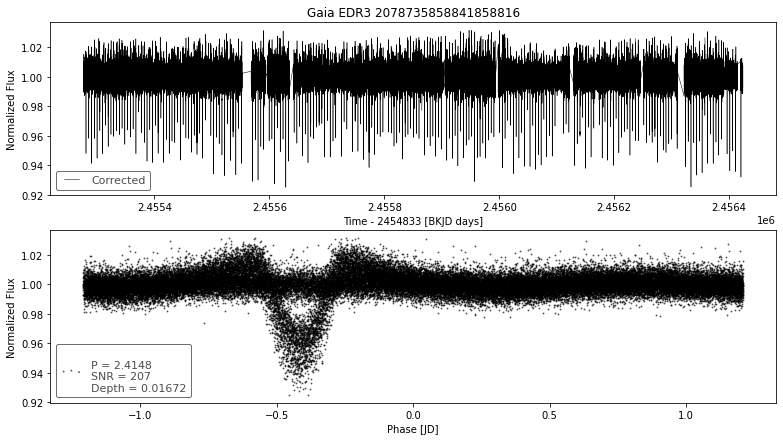

__________________________________________
index                                          32
designation         Gaia EDR3 2076789723264283008
BLS_period                              13.362883
BLS_period_SNR                         202.175239
BLS_duration                                 0.45
BLS_depth                                0.015031
BLS_transit_time                   2455279.483764
batch                                          50
Name: 4932, dtype: object
ra                          296.921321
ra_error                      0.082010
dec                          41.205258
dec_error                     0.094853
pmra                         -3.602138
pmdec                        -5.251992
parallax                      0.203913
parallax_error                0.100966
phot_g_n_obs                415.000000
phot_g_mean_flux           1001.236382
phot_g_mean_flux_error        1.133073
phot_g_mean_mag              18.186026
phot_bp_n_obs                48.000000
phot_bp_mean_flux       

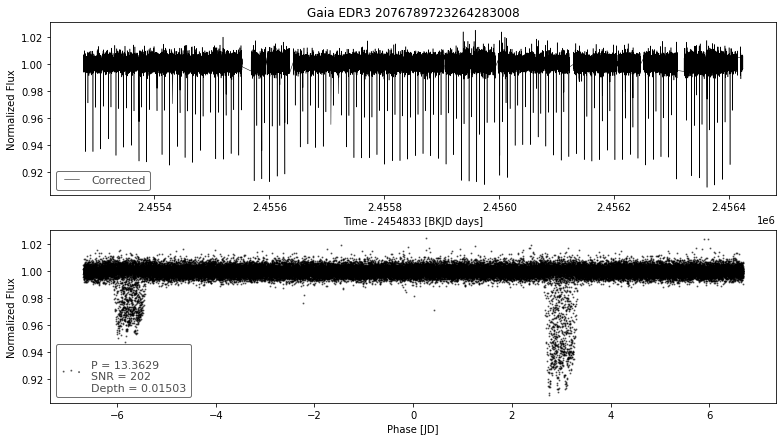

__________________________________________
index                                          38
designation         Gaia EDR3 2076789727566520192
BLS_period                               3.524663
BLS_period_SNR                         302.201131
BLS_duration                                 0.45
BLS_depth                                0.008008
BLS_transit_time                   2455278.685764
batch                                          50
Name: 4938, dtype: object
ra                          296.914190
ra_error                      0.042113
dec                          41.206797
dec_error                     0.049510
pmra                         -2.146678
pmdec                        -5.677354
parallax                      0.262355
parallax_error                0.052285
phot_g_n_obs                410.000000
phot_g_mean_flux           2629.039538
phot_g_mean_flux_error        4.639497
phot_g_mean_mag              17.137875
phot_bp_n_obs                51.000000
phot_bp_mean_flux       

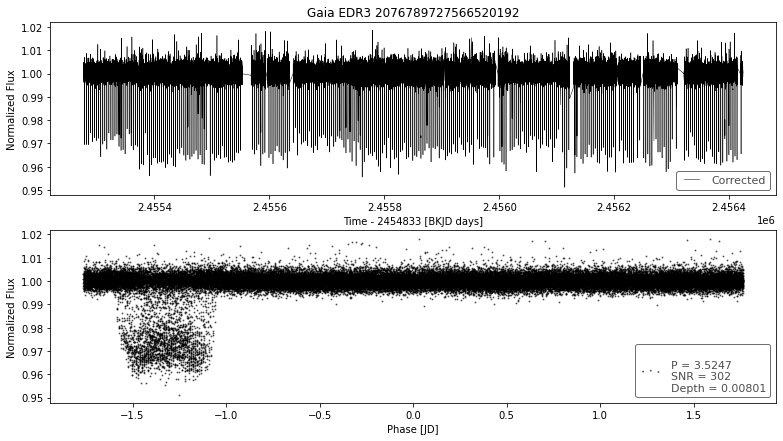

__________________________________________
index                                          39
designation         Gaia EDR3 2076836864825475456
BLS_period                               0.707867
BLS_period_SNR                          87.711263
BLS_duration                                0.126
BLS_depth                                0.011744
BLS_transit_time                   2455276.663764
batch                                          51
Name: 5039, dtype: object
ra                         296.913263
ra_error                     0.191093
dec                         41.250006
dec_error                    0.218744
pmra                        -2.887396
pmdec                       -5.599451
parallax                     0.125204
parallax_error               0.240956
phot_g_n_obs               370.000000
phot_g_mean_flux           323.717783
phot_g_mean_flux_error       0.863809
phot_g_mean_mag             19.411951
phot_bp_n_obs               41.000000
phot_bp_mean_flux          166.776068

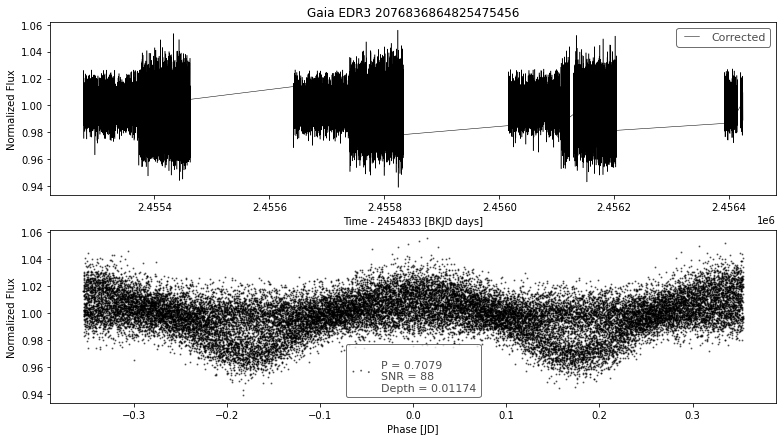

__________________________________________
index                                          65
designation         Gaia EDR3 2075404785289028992
BLS_period                              24.271381
BLS_period_SNR                         113.937327
BLS_duration                                 0.15
BLS_depth                                0.014135
BLS_transit_time                   2455287.088691
batch                                          51
Name: 5065, dtype: object
ra                         298.337454
ra_error                     0.098587
dec                         41.760876
dec_error                    0.109919
pmra                         3.748415
pmdec                        4.071209
parallax                     1.251449
parallax_error               0.118020
phot_g_n_obs               424.000000
phot_g_mean_flux           745.264240
phot_g_mean_flux_error       1.029563
phot_g_mean_mag             18.506592
phot_bp_n_obs               45.000000
phot_bp_mean_flux          182.193939

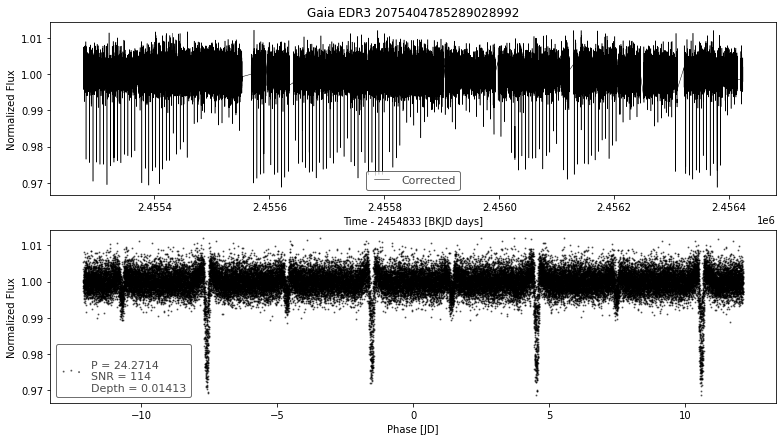

__________________________________________
index                                          88
designation         Gaia EDR3 2075404789599593088
BLS_period                               3.034506
BLS_period_SNR                         338.971138
BLS_duration                                 0.33
BLS_depth                                0.022041
BLS_transit_time                   2455277.869691
batch                                          51
Name: 5088, dtype: object
ra                         298.338781
ra_error                     0.389071
dec                         41.761658
dec_error                    0.438059
pmra                        -2.067092
pmdec                       -3.009304
parallax                    -0.289086
parallax_error               0.474933
phot_g_n_obs               390.000000
phot_g_mean_flux           376.734092
phot_g_mean_flux_error       2.028759
phot_g_mean_mag             19.247280
phot_bp_n_obs               42.000000
phot_bp_mean_flux          199.017955

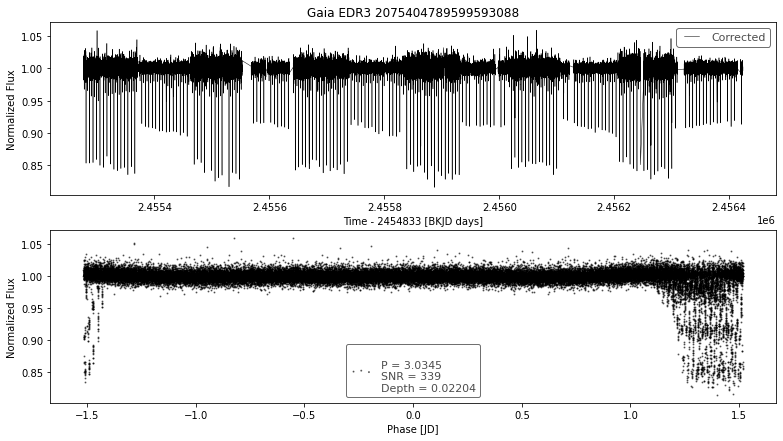

__________________________________________
index                                          33
designation         Gaia EDR3 2075405064475465856
BLS_period                               0.630683
BLS_period_SNR                         110.703443
BLS_duration                                 0.45
BLS_depth                                0.000513
BLS_transit_time                   2455276.774691
batch                                          52
Name: 5133, dtype: object
ra                          298.314647
ra_error                      0.028175
dec                          41.793403
dec_error                     0.033105
pmra                         -2.048577
pmdec                       -13.771999
parallax                      0.649342
parallax_error                0.034695
phot_g_n_obs                393.000000
phot_g_mean_flux           6005.402883
phot_g_mean_flux_error        2.446461
phot_g_mean_mag              16.241010
phot_bp_n_obs                44.000000
phot_bp_mean_flux       

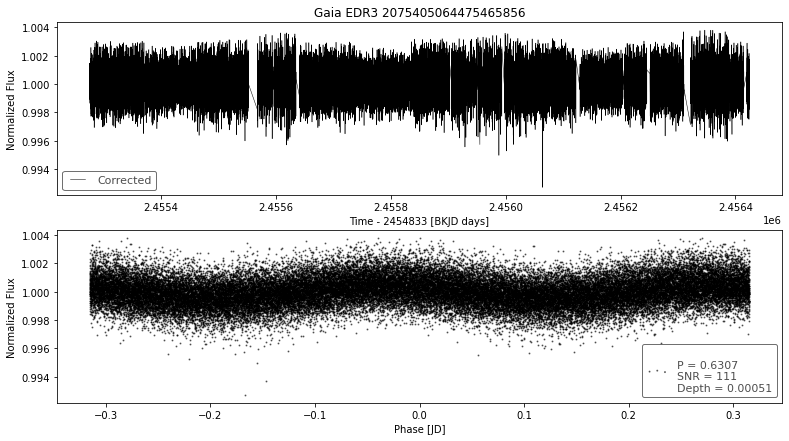

__________________________________________
index                                          39
designation         Gaia EDR3 2075405133185880704
BLS_period                               0.541367
BLS_period_SNR                        1448.510918
BLS_duration                                 0.45
BLS_depth                                0.008216
BLS_transit_time                   2455276.837691
batch                                          52
Name: 5139, dtype: object
ra                           298.298188
ra_error                       0.029417
dec                           41.797214
dec_error                      0.035361
pmra                           2.437504
pmdec                          1.746028
parallax                       0.620543
parallax_error                 0.036817
phot_g_n_obs                 400.000000
phot_g_mean_flux           12861.948917
phot_g_mean_flux_error         5.373654
phot_g_mean_mag               15.414100
phot_bp_n_obs                 48.000000
phot_bp_mea

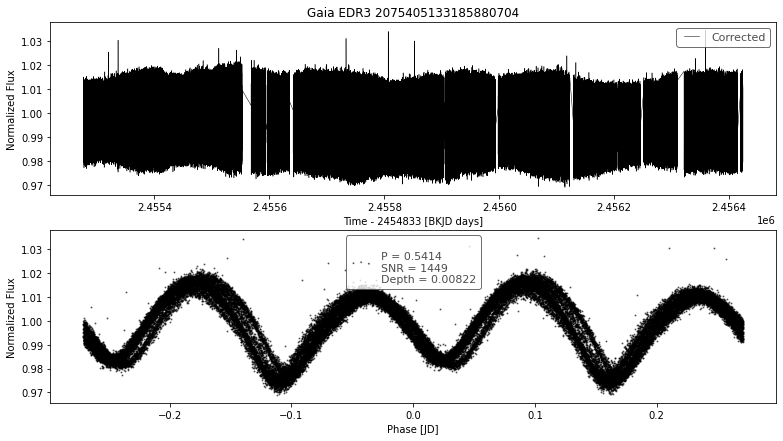

__________________________________________
index                                          40
designation         Gaia EDR3 2075405133185894656
BLS_period                               0.541367
BLS_period_SNR                          58.998601
BLS_duration                                 0.45
BLS_depth                                0.002306
BLS_transit_time                   2455276.837691
batch                                          52
Name: 5140, dtype: object
ra                         298.302259
ra_error                     0.119347
dec                         41.796421
dec_error                    0.126370
pmra                         0.369938
pmdec                       -5.820723
parallax                     0.384516
parallax_error               0.136528
phot_g_n_obs               411.000000
phot_g_mean_flux           604.997749
phot_g_mean_flux_error       1.028050
phot_g_mean_mag             18.732983
phot_bp_n_obs               19.000000
phot_bp_mean_flux          213.526615

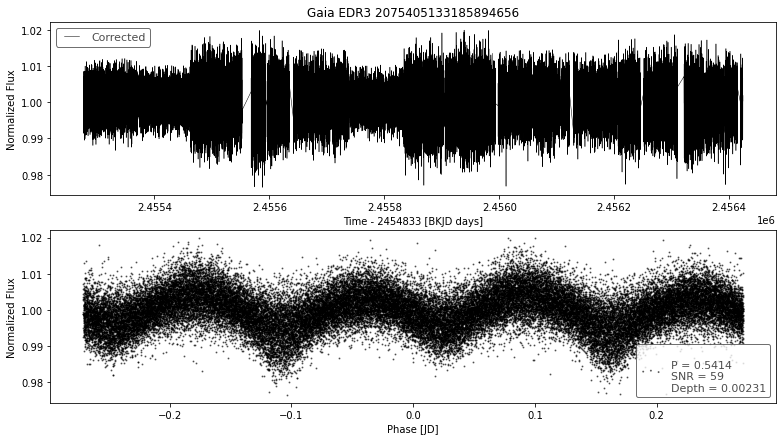

__________________________________________
index                                          41
designation         Gaia EDR3 2075405133185896960
BLS_period                               0.707867
BLS_period_SNR                         153.053664
BLS_duration                                0.174
BLS_depth                                0.002144
BLS_transit_time                   2455276.837691
batch                                          52
Name: 5141, dtype: object
ra                         298.296025
ra_error                     0.092049
dec                         41.804426
dec_error                    0.101537
pmra                        -1.241426
pmdec                       -4.536844
parallax                     0.123613
parallax_error               0.107739
phot_g_n_obs               412.000000
phot_g_mean_flux           843.675548
phot_g_mean_flux_error       1.108298
phot_g_mean_mag             18.371927
phot_bp_n_obs               43.000000
phot_bp_mean_flux          394.112324

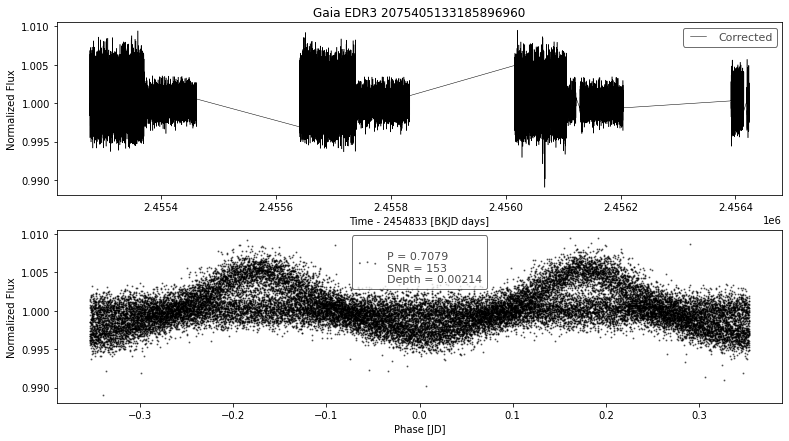

__________________________________________
index                                          22
designation         Gaia EDR3 2075406541944219520
BLS_period                               0.630683
BLS_period_SNR                         333.261238
BLS_duration                                 0.45
BLS_depth                                0.000728
BLS_transit_time                   2455276.765691
batch                                          53
Name: 5222, dtype: object
ra                           298.318810
ra_error                       0.011597
dec                           41.793122
dec_error                      0.013634
pmra                          -0.575051
pmdec                         -3.408497
parallax                       0.461697
parallax_error                 0.014402
phot_g_n_obs                 398.000000
phot_g_mean_flux           39379.458735
phot_g_mean_flux_error         7.672082
phot_g_mean_mag               14.199192
phot_bp_n_obs                 45.000000
phot_bp_mea

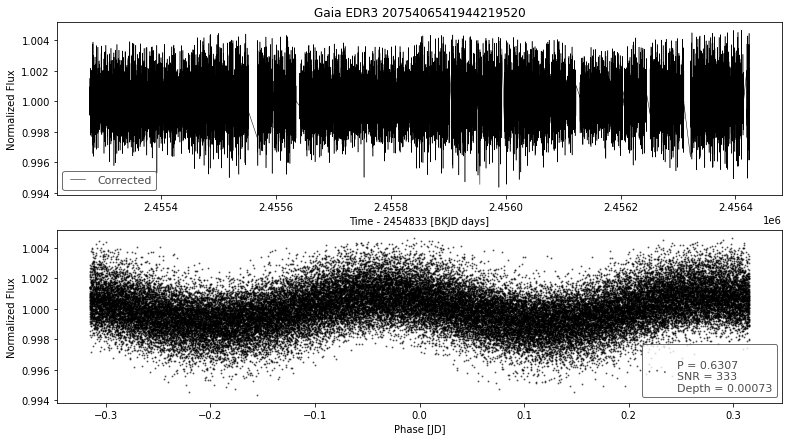

__________________________________________
index                                          52
designation         Gaia EDR3 2075408049464387584
BLS_period                               0.707867
BLS_period_SNR                          94.560054
BLS_duration                                0.174
BLS_depth                                0.006313
BLS_transit_time                   2455276.840691
batch                                          53
Name: 5252, dtype: object
ra                         298.280795
ra_error                     0.091288
dec                         41.802825
dec_error                    0.102111
pmra                        -2.106434
pmdec                       -5.238650
parallax                     0.385246
parallax_error               0.108641
phot_g_n_obs               382.000000
phot_g_mean_flux           910.913545
phot_g_mean_flux_error       1.322021
phot_g_mean_mag             18.288673
phot_bp_n_obs               46.000000
phot_bp_mean_flux          349.572105

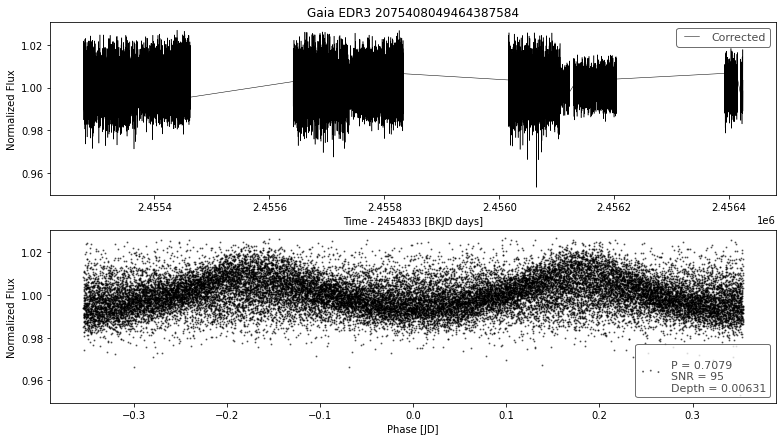

__________________________________________
index                                          56
designation         Gaia EDR3 2075408053772676736
BLS_period                               0.707867
BLS_period_SNR                          62.616843
BLS_duration                                 0.15
BLS_depth                                0.002453
BLS_transit_time                   2455276.834691
batch                                          53
Name: 5256, dtype: object
ra                          298.281166
ra_error                      0.063416
dec                          41.800819
dec_error                     0.073756
pmra                         -2.521716
pmdec                        -7.687822
parallax                      0.245085
parallax_error                0.077247
phot_g_n_obs                378.000000
phot_g_mean_flux           1566.047155
phot_g_mean_flux_error        1.496237
phot_g_mean_mag              17.700356
phot_bp_n_obs                43.000000
phot_bp_mean_flux       

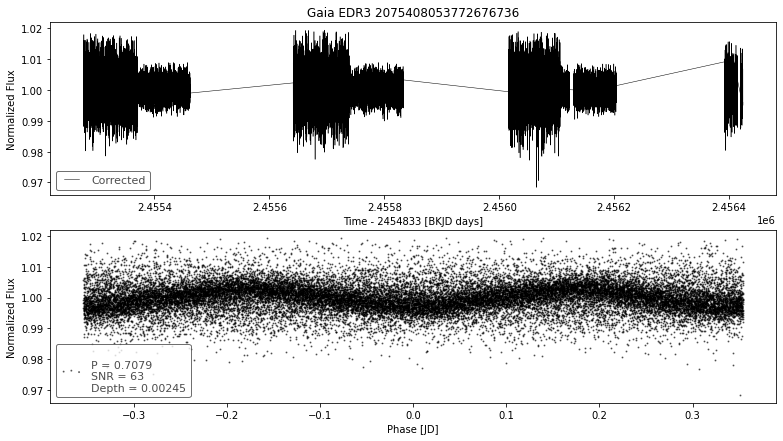

__________________________________________
index                                          59
designation         Gaia EDR3 2075408088132432000
BLS_period                               0.707867
BLS_period_SNR                         119.486997
BLS_duration                                0.174
BLS_depth                                0.001517
BLS_transit_time                   2455276.837691
batch                                          53
Name: 5259, dtype: object
ra                          298.295859
ra_error                      0.030162
dec                          41.805480
dec_error                     0.035955
pmra                         -1.450553
pmdec                        -0.399245
parallax                      0.479929
parallax_error                0.036832
phot_g_n_obs                376.000000
phot_g_mean_flux           5274.358069
phot_g_mean_flux_error        2.492395
phot_g_mean_mag              16.381943
phot_bp_n_obs                47.000000
phot_bp_mean_flux       

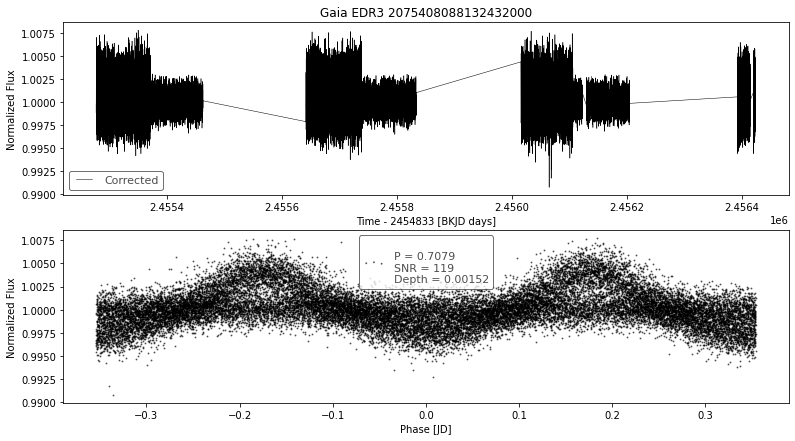

__________________________________________
index                                          64
designation         Gaia EDR3 2073608325044647296
BLS_period                               0.707867
BLS_period_SNR                         122.260276
BLS_duration                                0.126
BLS_depth                                0.002042
BLS_transit_time                   2455276.663609
batch                                          53
Name: 5264, dtype: object
ra                          298.992316
ra_error                      0.031154
dec                          40.778276
dec_error                     0.035289
pmra                         -3.733225
pmdec                        -9.183802
parallax                      0.318766
parallax_error                0.039304
phot_g_n_obs                351.000000
phot_g_mean_flux           5221.975591
phot_g_mean_flux_error        2.519259
phot_g_mean_mag              16.392780
phot_bp_n_obs                41.000000
phot_bp_mean_flux       

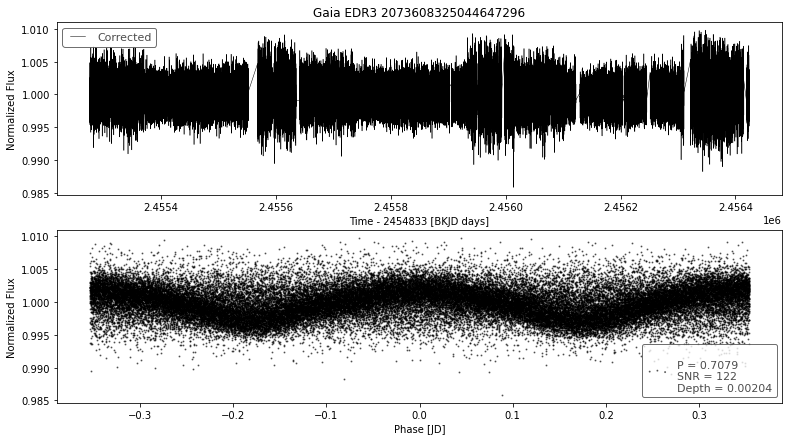

__________________________________________
index                                          66
designation         Gaia EDR3 2073608393764125568
BLS_period                               0.707867
BLS_period_SNR                           64.07063
BLS_duration                                0.126
BLS_depth                                0.002194
BLS_transit_time                   2455276.666609
batch                                          53
Name: 5266, dtype: object
ra                         298.992445
ra_error                     0.104943
dec                         40.780024
dec_error                    0.118837
pmra                        -2.064575
pmdec                       -2.565875
parallax                    -0.090120
parallax_error               0.131820
phot_g_n_obs               366.000000
phot_g_mean_flux           670.163673
phot_g_mean_flux_error       1.160380
phot_g_mean_mag             18.621914
phot_bp_n_obs               39.000000
phot_bp_mean_flux          268.530371

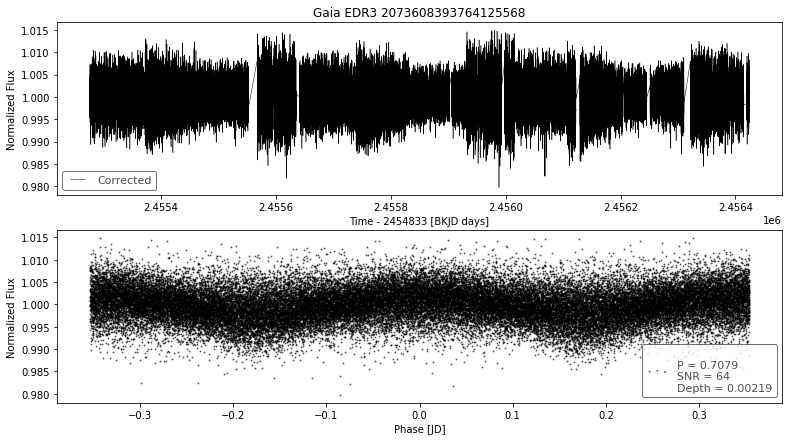

__________________________________________
index                                          70
designation         Gaia EDR3 2073608423810301824
BLS_period                               0.738615
BLS_period_SNR                          61.408562
BLS_duration                                 0.45
BLS_depth                                0.001126
BLS_transit_time                   2455276.990609
batch                                          53
Name: 5270, dtype: object
ra                          298.996593
ra_error                      0.048153
dec                          40.780773
dec_error                     0.055365
pmra                         -1.608119
pmdec                        -4.237040
parallax                      0.286764
parallax_error                0.062530
phot_g_n_obs                348.000000
phot_g_mean_flux           2435.448830
phot_g_mean_flux_error        1.679276
phot_g_mean_mag              17.220919
phot_bp_n_obs                41.000000
phot_bp_mean_flux       

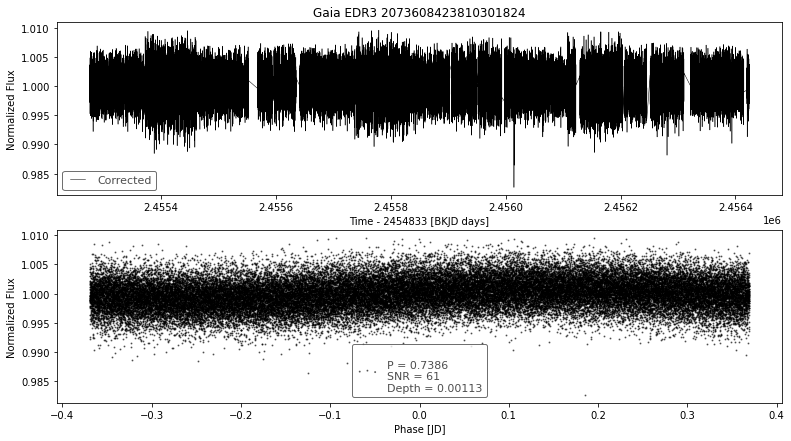

__________________________________________
index                                          75
designation         Gaia EDR3 2073608428118285440
BLS_period                               0.738615
BLS_period_SNR                          91.453932
BLS_duration                                 0.45
BLS_depth                                0.002019
BLS_transit_time                   2455276.990609
batch                                          53
Name: 5275, dtype: object
ra                         298.997363
ra_error                     0.160777
dec                         40.781527
dec_error                    0.184530
pmra                        -1.489999
pmdec                        1.459071
parallax                     0.845398
parallax_error               0.203107
phot_g_n_obs               355.000000
phot_g_mean_flux           370.471759
phot_g_mean_flux_error       1.070249
phot_g_mean_mag             19.265480
phot_bp_n_obs               27.000000
phot_bp_mean_flux          123.708357

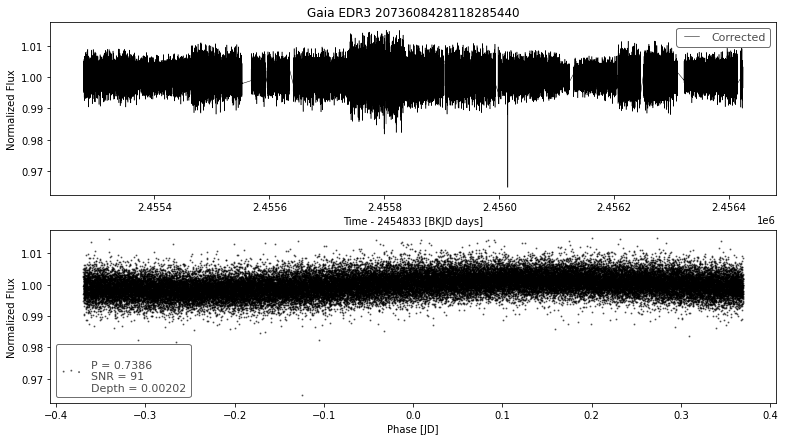

__________________________________________
index                                          81
designation         Gaia EDR3 2073608428123884416
BLS_period                               0.707867
BLS_period_SNR                          67.272624
BLS_duration                                 0.15
BLS_depth                                0.000967
BLS_transit_time                   2455276.657609
batch                                          53
Name: 5281, dtype: object
ra                          299.006112
ra_error                      0.048945
dec                          40.785654
dec_error                     0.055564
pmra                          1.733796
pmdec                        -1.261725
parallax                      0.412995
parallax_error                0.061280
phot_g_n_obs                344.000000
phot_g_mean_flux           2420.195106
phot_g_mean_flux_error        1.785948
phot_g_mean_mag              17.227741
phot_bp_n_obs                37.000000
phot_bp_mean_flux       

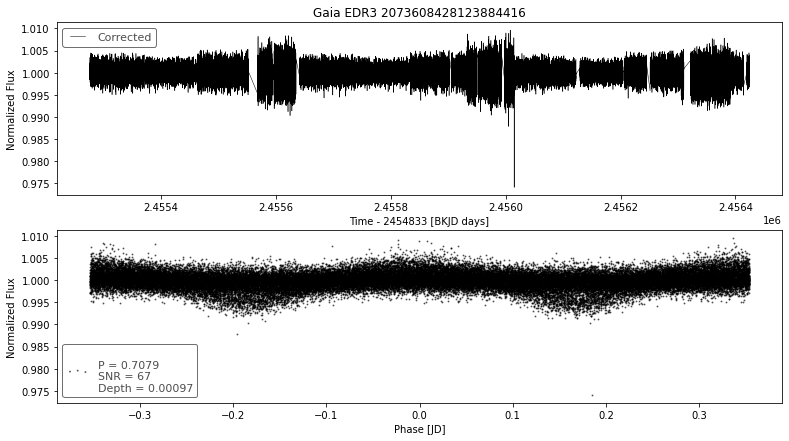

__________________________________________
index                                          88
designation         Gaia EDR3 2073608462478158848
BLS_period                               2.006032
BLS_period_SNR                         402.244547
BLS_duration                                0.099
BLS_depth                                0.001984
BLS_transit_time                   2455278.105109
batch                                          53
Name: 5288, dtype: object
ra                           299.017520
ra_error                       0.017211
dec                           40.786567
dec_error                      0.019354
pmra                          -3.630422
pmdec                        -12.371369
parallax                       0.623285
parallax_error                 0.020522
phot_g_n_obs                 374.000000
phot_g_mean_flux           22615.297291
phot_g_mean_flux_error         6.869354
phot_g_mean_mag               14.801361
phot_bp_n_obs                 29.000000
phot_bp_mea

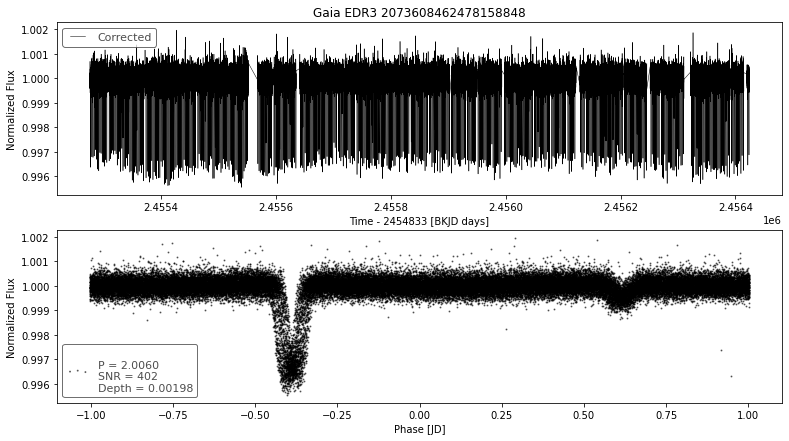

__________________________________________
index                                          94
designation         Gaia EDR3 2073608462483635968
BLS_period                               2.006032
BLS_period_SNR                         421.131856
BLS_duration                                0.099
BLS_depth                                0.002051
BLS_transit_time                   2455278.105109
batch                                          53
Name: 5294, dtype: object
ra                           299.016788
ra_error                       0.067609
dec                           40.786358
dec_error                      0.074286
pmra                          -3.385169
pmdec                        -12.739628
parallax                       0.873213
parallax_error                 0.080893
phot_g_n_obs                 370.000000
phot_g_mean_flux           18128.995673
phot_g_mean_flux_error        15.205032
phot_g_mean_mag               15.041432
phot_bp_n_obs                 10.000000
phot_bp_mea

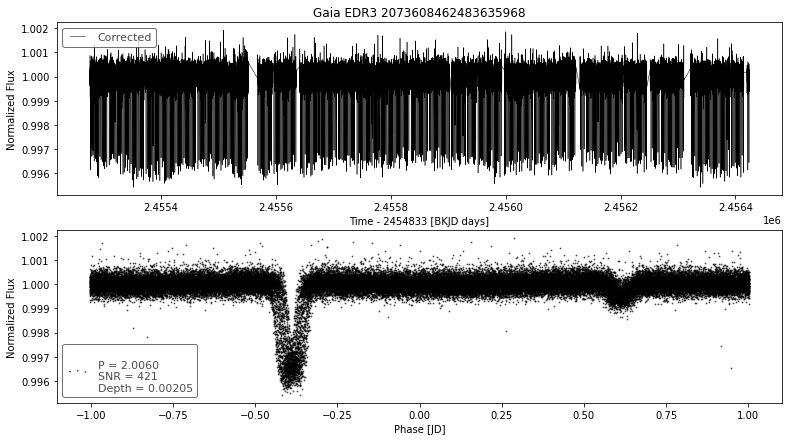

__________________________________________
index                                          85
designation         Gaia EDR3 2073620346640709504
BLS_period                               0.958481
BLS_period_SNR                          54.982305
BLS_duration                                 0.45
BLS_depth                                 0.00017
BLS_transit_time                   2455276.831609
batch                                          54
Name: 5385, dtype: object
ra                          298.978679
ra_error                      0.043831
dec                          40.829486
dec_error                     0.050659
pmra                         -1.140186
pmdec                        -5.905956
parallax                      0.715291
parallax_error                0.056172
phot_g_n_obs                311.000000
phot_g_mean_flux           3117.836333
phot_g_mean_flux_error        2.209705
phot_g_mean_mag              16.952734
phot_bp_n_obs                34.000000
phot_bp_mean_flux       

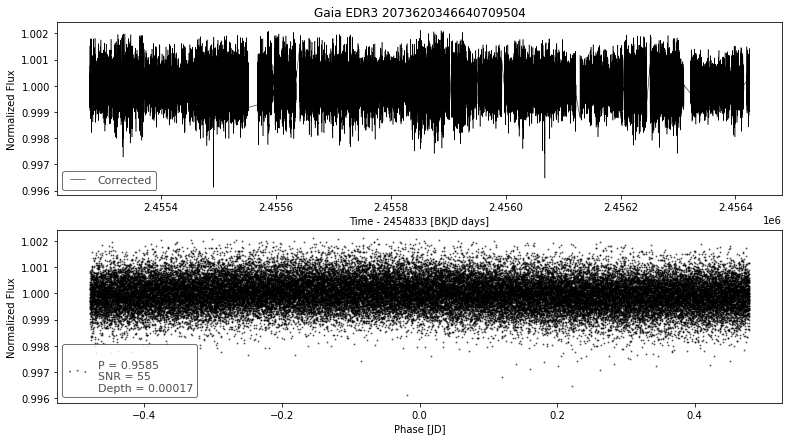

__________________________________________
index                                           0
designation         Gaia EDR3 2073620350953105152
BLS_period                               0.958481
BLS_period_SNR                          77.887547
BLS_duration                                 0.45
BLS_depth                                0.000186
BLS_transit_time                   2455276.831609
batch                                          55
Name: 5400, dtype: object
ra                           298.977103
ra_error                       0.014016
dec                           40.828413
dec_error                      0.014965
pmra                          -1.008453
pmdec                         -6.137906
parallax                       0.158292
parallax_error                 0.017065
phot_g_n_obs                 337.000000
phot_g_mean_flux           33038.482542
phot_g_mean_flux_error         8.146993
phot_g_mean_mag               14.389816
phot_bp_n_obs                 37.000000
phot_bp_mea

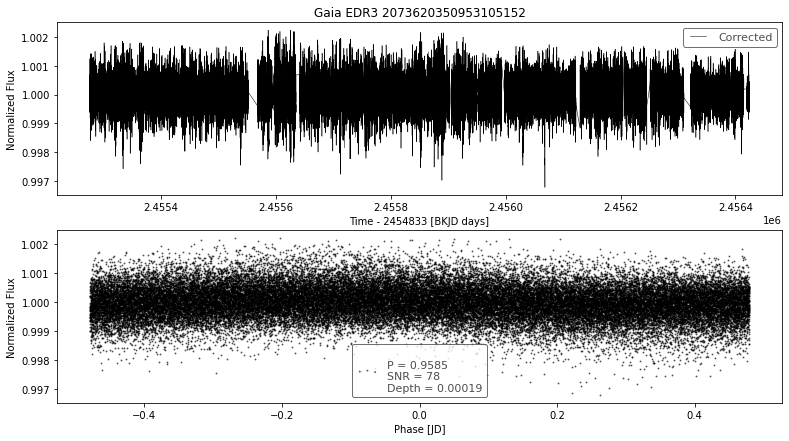

__________________________________________
index                                          12
designation         Gaia EDR3 2073620522746202880
BLS_period                               0.593712
BLS_period_SNR                         122.269233
BLS_duration                                 0.45
BLS_depth                                0.021803
BLS_transit_time                   2455276.843609
batch                                          55
Name: 5412, dtype: object
ra                         298.961295
ra_error                     0.227143
dec                         40.827137
dec_error                    0.260739
pmra                        -3.664710
pmdec                       -7.651694
parallax                     0.865690
parallax_error               0.295059
phot_g_n_obs               314.000000
phot_g_mean_flux           252.158346
phot_g_mean_flux_error       0.939226
phot_g_mean_mag             19.683184
phot_bp_n_obs               33.000000
phot_bp_mean_flux           69.113530

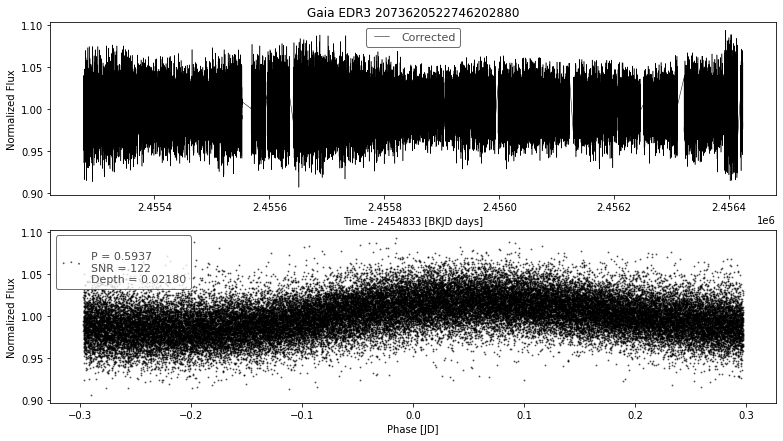

__________________________________________
index                                           0
designation         Gaia EDR3 2073682438989499392
BLS_period                               0.707867
BLS_period_SNR                          71.093934
BLS_duration                                0.126
BLS_depth                                0.000563
BLS_transit_time                   2455276.660681
batch                                          56
Name: 5500, dtype: object
ra                          297.651519
ra_error                      0.022799
dec                          40.237800
dec_error                     0.026695
pmra                         -2.477084
pmdec                        -5.023764
parallax                      0.300229
parallax_error                0.029183
phot_g_n_obs                381.000000
phot_g_mean_flux           8658.657305
phot_g_mean_flux_error        2.986493
phot_g_mean_mag              15.843740
phot_bp_n_obs                46.000000
phot_bp_mean_flux       

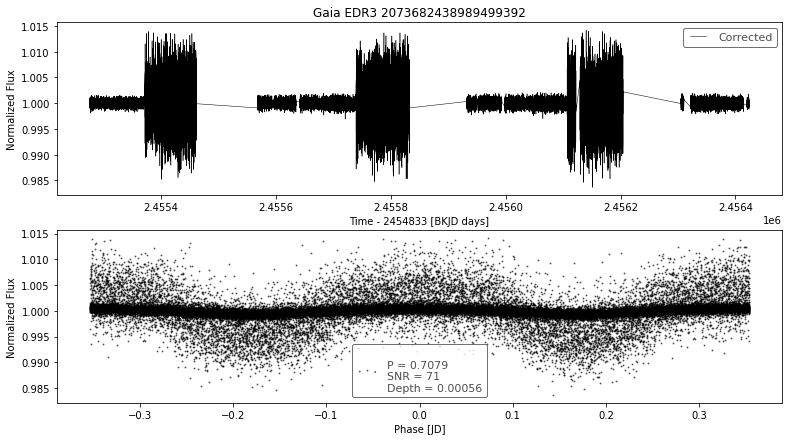

__________________________________________
index                                           1
designation         Gaia EDR3 2073682438989966592
BLS_period                               0.707867
BLS_period_SNR                           53.66811
BLS_duration                                0.126
BLS_depth                                0.000426
BLS_transit_time                   2455276.660681
batch                                          56
Name: 5501, dtype: object
ra                          297.652590
ra_error                      0.026270
dec                          40.238272
dec_error                     0.030298
pmra                         -2.031415
pmdec                        -3.997324
parallax                      0.323921
parallax_error                0.033372
phot_g_n_obs                397.000000
phot_g_mean_flux           7159.109876
phot_g_mean_flux_error        2.850908
phot_g_mean_mag              16.050219
phot_bp_n_obs                23.000000
phot_bp_mean_flux       

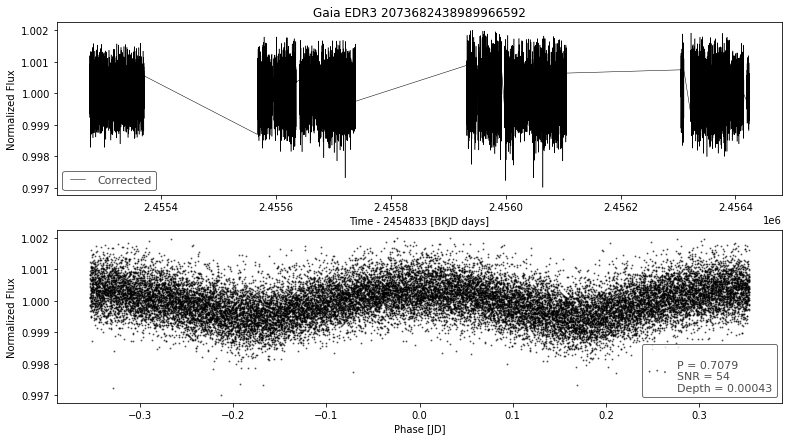

__________________________________________
index                                           6
designation         Gaia EDR3 2073682537763335040
BLS_period                              28.647694
BLS_period_SNR                          58.513888
BLS_duration                                 0.03
BLS_depth                                0.049241
BLS_transit_time                   2455294.048681
batch                                          56
Name: 5506, dtype: object
ra                         297.628902
ra_error                     0.130415
dec                         40.229050
dec_error                    0.147568
pmra                        -2.592898
pmdec                       -4.446498
parallax                     0.116572
parallax_error               0.165610
phot_g_n_obs               360.000000
phot_g_mean_flux           549.255307
phot_g_mean_flux_error       1.023918
phot_g_mean_mag             18.837930
phot_bp_n_obs               43.000000
phot_bp_mean_flux          249.738797

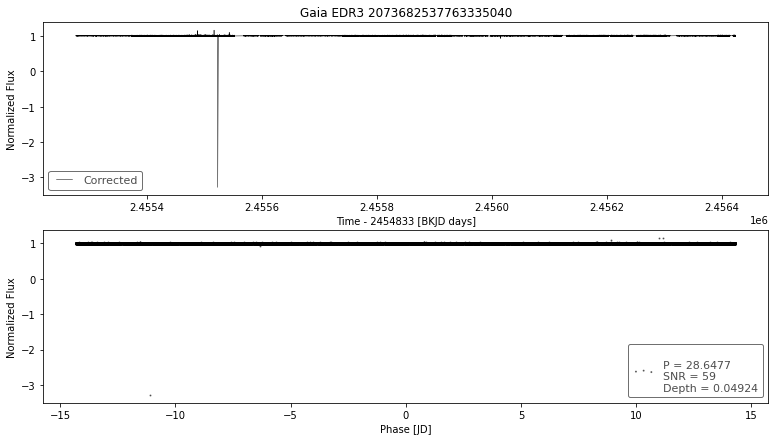

__________________________________________
index                                           8
designation         Gaia EDR3 2073682537763354880
BLS_period                              28.647694
BLS_period_SNR                           54.63376
BLS_duration                                 0.03
BLS_depth                                0.045862
BLS_transit_time                   2455294.048681
batch                                          56
Name: 5508, dtype: object
ra                         297.625066
ra_error                     0.131253
dec                         40.233928
dec_error                    0.148122
pmra                        -2.344397
pmdec                       -3.081173
parallax                    -0.032169
parallax_error               0.169113
phot_g_n_obs               388.000000
phot_g_mean_flux           503.646938
phot_g_mean_flux_error       1.014001
phot_g_mean_mag             18.932050
phot_bp_n_obs               45.000000
phot_bp_mean_flux          185.865986

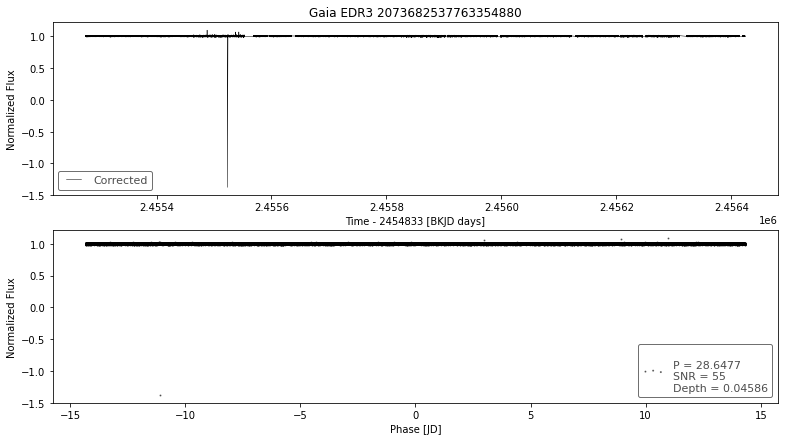

__________________________________________
index                                          10
designation         Gaia EDR3 2073682537763365376
BLS_period                               0.707867
BLS_period_SNR                         189.152047
BLS_duration                                0.126
BLS_depth                                0.002976
BLS_transit_time                   2455276.663681
batch                                          56
Name: 5510, dtype: object
ra                          297.628981
ra_error                      0.043964
dec                          40.237732
dec_error                     0.048942
pmra                         -1.498933
pmdec                        -1.724225
parallax                      0.040084
parallax_error                0.055266
phot_g_n_obs                390.000000
phot_g_mean_flux           2918.915191
phot_g_mean_flux_error        1.979935
phot_g_mean_mag              17.024313
phot_bp_n_obs                48.000000
phot_bp_mean_flux       

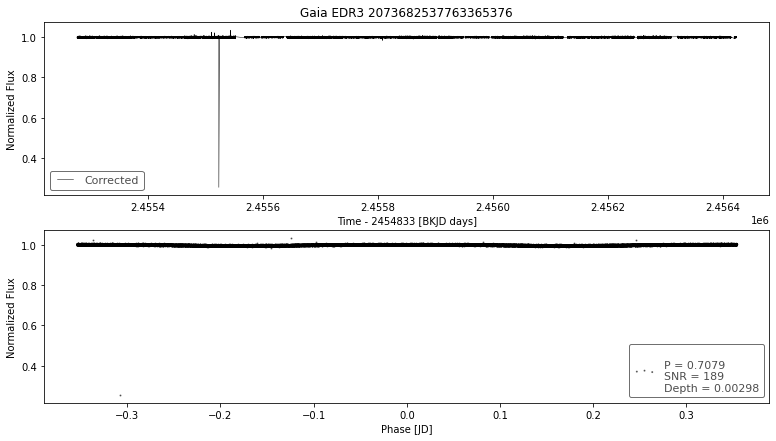

__________________________________________
index                                          11
designation         Gaia EDR3 2073682542058306816
BLS_period                               0.707867
BLS_period_SNR                         663.954485
BLS_duration                                0.126
BLS_depth                                0.068433
BLS_transit_time                   2455276.660681
batch                                          56
Name: 5511, dtype: object
ra                         297.636747
ra_error                     0.331737
dec                         40.233504
dec_error                    0.417692
pmra                        -2.092239
pmdec                       -4.065271
parallax                     1.241501
parallax_error               0.440588
phot_g_n_obs               357.000000
phot_g_mean_flux           207.276845
phot_g_mean_flux_error       1.438322
phot_g_mean_mag             19.895990
phot_bp_n_obs               39.000000
phot_bp_mean_flux           85.660771

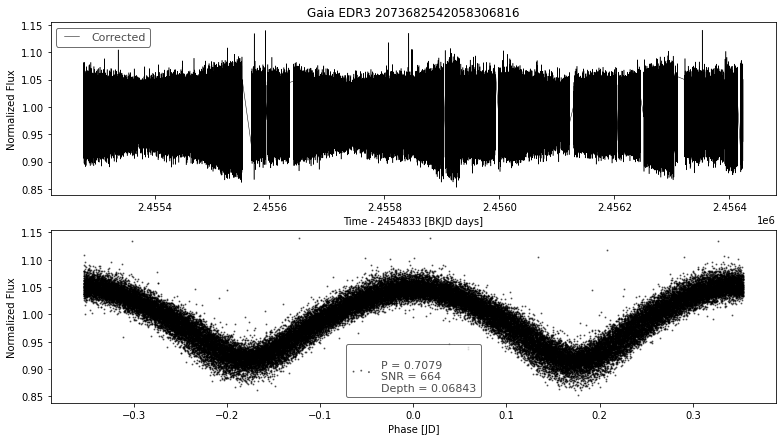

__________________________________________
index                                          12
designation         Gaia EDR3 2073682542068698496
BLS_period                               0.707867
BLS_period_SNR                          98.681603
BLS_duration                                0.126
BLS_depth                                0.011913
BLS_transit_time                   2455276.660681
batch                                          56
Name: 5512, dtype: object
ra                         297.635276
ra_error                     0.141904
dec                         40.230857
dec_error                    0.160205
pmra                        -3.816611
pmdec                       -1.114109
parallax                     0.479098
parallax_error               0.179901
phot_g_n_obs               389.000000
phot_g_mean_flux           450.544166
phot_g_mean_flux_error       0.955252
phot_g_mean_mag             19.053024
phot_bp_n_obs               42.000000
phot_bp_mean_flux          194.092560

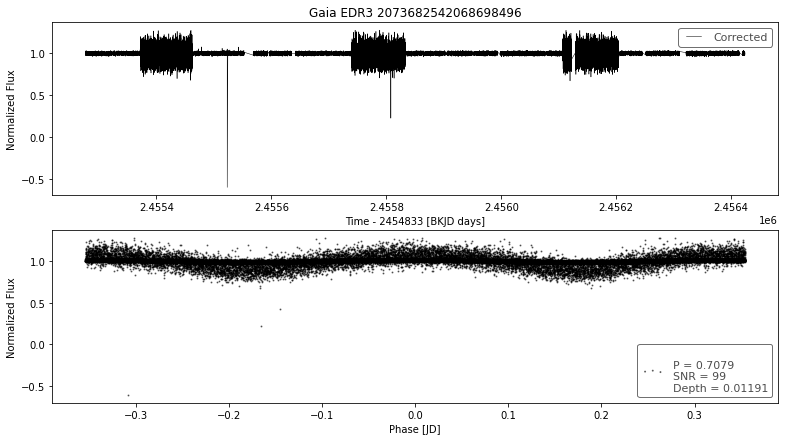

__________________________________________
index                                          21
designation         Gaia EDR3 2073682576428419968
BLS_period                               0.707867
BLS_period_SNR                          55.220785
BLS_duration                                 0.15
BLS_depth                                0.000413
BLS_transit_time                   2455277.023681
batch                                          56
Name: 5521, dtype: object
ra                          297.617389
ra_error                      0.022456
dec                          40.226080
dec_error                     0.022727
pmra                          1.882132
pmdec                        -4.674755
parallax                      0.583744
parallax_error                0.026801
phot_g_n_obs                399.000000
phot_g_mean_flux           9730.937526
phot_g_mean_flux_error        3.392800
phot_g_mean_mag              15.716980
phot_bp_n_obs                45.000000
phot_bp_mean_flux       

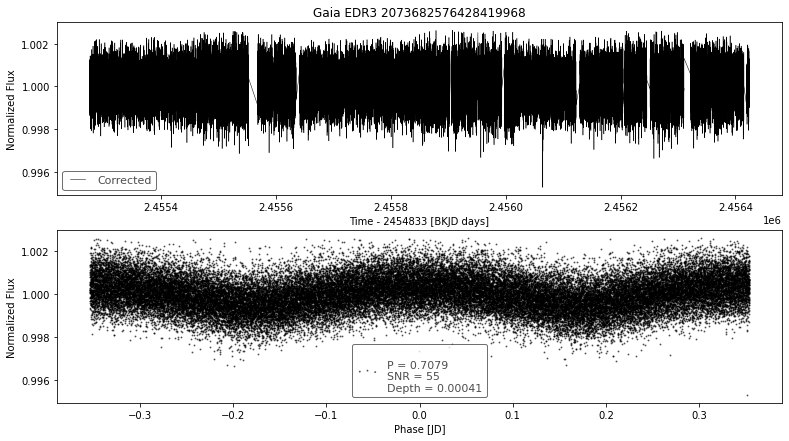

__________________________________________
index                                          22
designation         Gaia EDR3 2073682606482817408
BLS_period                               0.707867
BLS_period_SNR                          52.478391
BLS_duration                                 0.15
BLS_depth                                0.001034
BLS_transit_time                   2455277.020681
batch                                          56
Name: 5522, dtype: object
ra                          297.618913
ra_error                      0.039075
dec                          40.230270
dec_error                     0.042833
pmra                         -2.280423
pmdec                        -2.287317
parallax                      0.248123
parallax_error                0.049476
phot_g_n_obs                396.000000
phot_g_mean_flux           3347.116600
phot_g_mean_flux_error        2.072787
phot_g_mean_mag              16.875690
phot_bp_n_obs                47.000000
phot_bp_mean_flux       

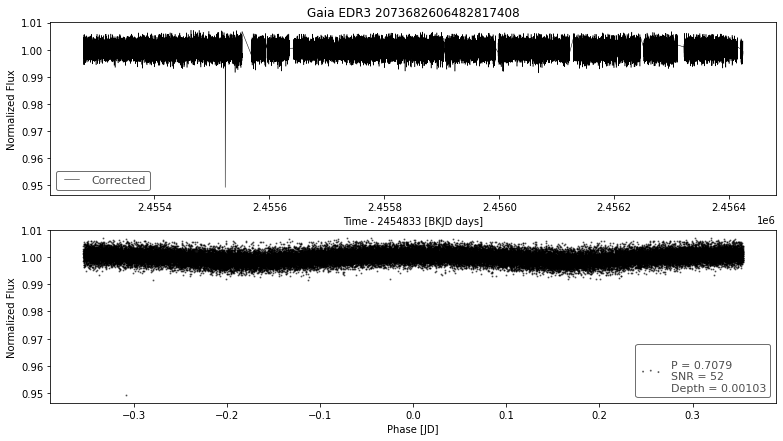

__________________________________________
index                                          23
designation         Gaia EDR3 2073682606482841216
BLS_period                              28.647694
BLS_period_SNR                          66.257988
BLS_duration                                 0.03
BLS_depth                                0.043731
BLS_transit_time                   2455294.048681
batch                                          56
Name: 5523, dtype: object
ra                          297.619940
ra_error                      0.074491
dec                          40.237210
dec_error                     0.080818
pmra                         -2.079739
pmdec                        -4.277231
parallax                      0.112609
parallax_error                0.093583
phot_g_n_obs                408.000000
phot_g_mean_flux           1160.725716
phot_g_mean_flux_error        1.265484
phot_g_mean_mag              18.025543
phot_bp_n_obs                47.000000
phot_bp_mean_flux       

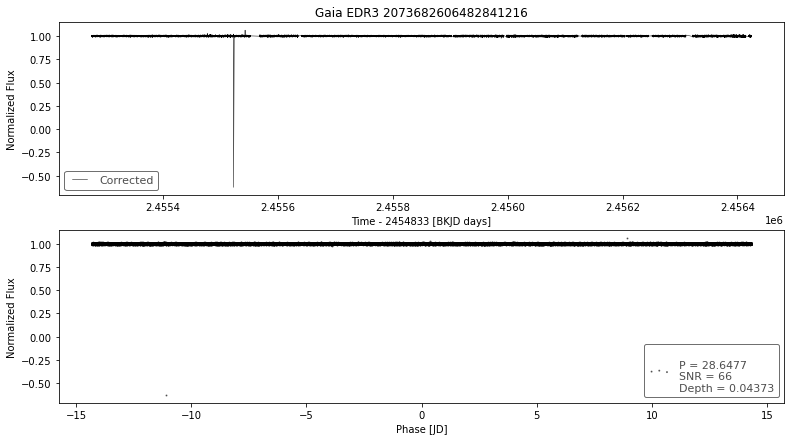

__________________________________________
index                                          24
designation         Gaia EDR3 2073682606482842240
BLS_period                              28.647694
BLS_period_SNR                           86.69638
BLS_duration                                 0.03
BLS_depth                                0.039166
BLS_transit_time                   2455294.048681
batch                                          56
Name: 5524, dtype: object
ra                          297.624750
ra_error                      0.080133
dec                          40.237738
dec_error                     0.090007
pmra                         -2.448060
pmdec                        -2.944596
parallax                      0.054887
parallax_error                0.102045
phot_g_n_obs                407.000000
phot_g_mean_flux           1024.404204
phot_g_mean_flux_error        1.149827
phot_g_mean_mag              18.161188
phot_bp_n_obs                46.000000
phot_bp_mean_flux       

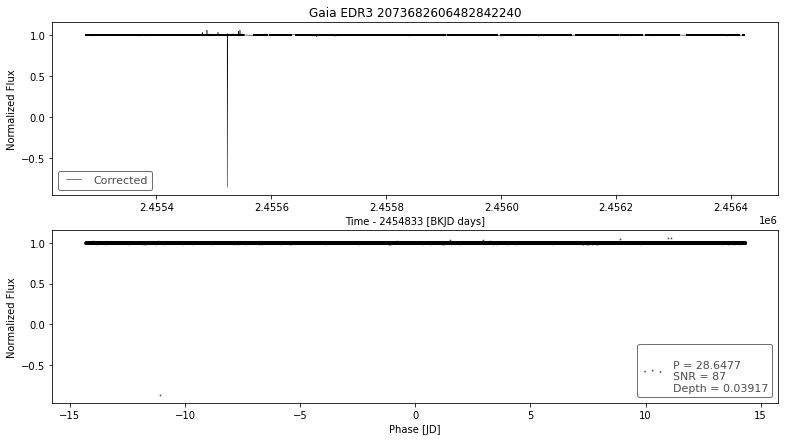

__________________________________________
index                                          28
designation         Gaia EDR3 2073682606482849152
BLS_period                              28.647694
BLS_period_SNR                          50.611618
BLS_duration                                 0.03
BLS_depth                                0.072859
BLS_transit_time                   2455294.048681
batch                                          56
Name: 5528, dtype: object
ra                         297.619365
ra_error                     0.143367
dec                         40.239688
dec_error                    0.152817
pmra                        -2.150427
pmdec                       -4.744194
parallax                     0.253288
parallax_error               0.176662
phot_g_n_obs               388.000000
phot_g_mean_flux           472.254026
phot_g_mean_flux_error       0.923678
phot_g_mean_mag             19.001928
phot_bp_n_obs               47.000000
phot_bp_mean_flux          187.252290

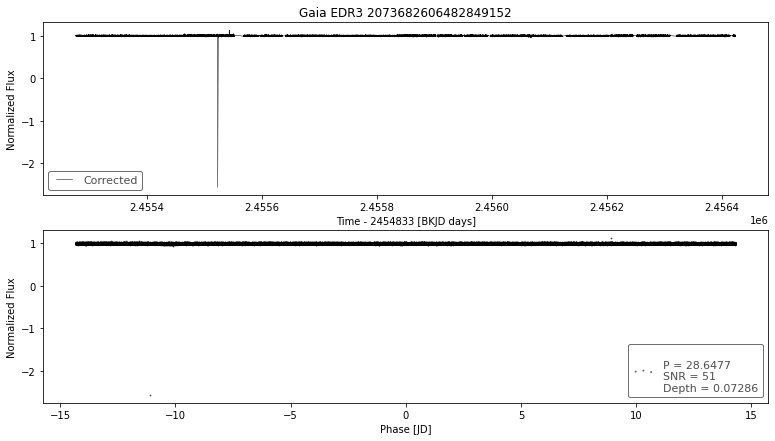

__________________________________________
index                                          29
designation         Gaia EDR3 2073682606482850048
BLS_period                               0.707867
BLS_period_SNR                          94.515645
BLS_duration                                 0.15
BLS_depth                                0.004164
BLS_transit_time                   2455276.660681
batch                                          56
Name: 5529, dtype: object
ra                         297.627656
ra_error                     0.100456
dec                         40.239665
dec_error                    0.114610
pmra                        -0.376927
pmdec                       -1.894851
parallax                     0.184024
parallax_error               0.128249
phot_g_n_obs               389.000000
phot_g_mean_flux           739.329613
phot_g_mean_flux_error       1.100877
phot_g_mean_mag             18.515272
phot_bp_n_obs               43.000000
phot_bp_mean_flux          321.908148

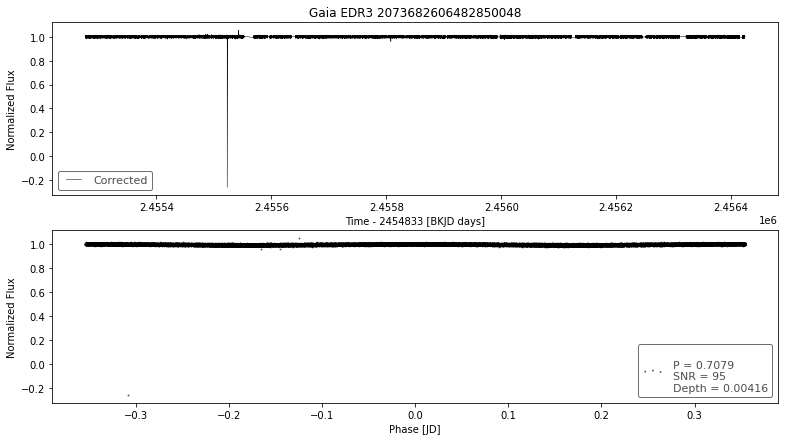

__________________________________________
index                                          34
designation         Gaia EDR3 2073682610777760640
BLS_period                              28.647694
BLS_period_SNR                         104.356732
BLS_duration                                 0.03
BLS_depth                                0.020455
BLS_transit_time                   2455294.048681
batch                                          56
Name: 5534, dtype: object
ra                          297.626996
ra_error                      0.040583
dec                          40.236587
dec_error                     0.046402
pmra                         -3.907147
pmdec                        -0.601569
parallax                      0.489693
parallax_error                0.051519
phot_g_n_obs                400.000000
phot_g_mean_flux           3016.759688
phot_g_mean_flux_error        1.941408
phot_g_mean_mag              16.988516
phot_bp_n_obs                47.000000
phot_bp_mean_flux       

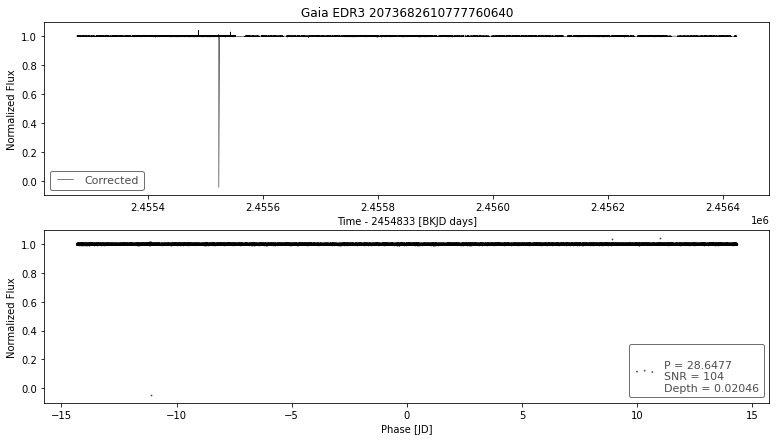

__________________________________________
index                                          35
designation         Gaia EDR3 2073682610788169984
BLS_period                              28.647694
BLS_period_SNR                          70.688285
BLS_duration                                 0.03
BLS_depth                                0.070269
BLS_transit_time                   2455294.048681
batch                                          56
Name: 5535, dtype: object
ra                         297.625512
ra_error                     0.163025
dec                         40.234838
dec_error                    0.186751
pmra                        -4.966231
pmdec                       -5.496135
parallax                     0.572684
parallax_error               0.209259
phot_g_n_obs               371.000000
phot_g_mean_flux           396.200411
phot_g_mean_flux_error       0.969344
phot_g_mean_mag             19.192580
phot_bp_n_obs               31.000000
phot_bp_mean_flux          144.939176

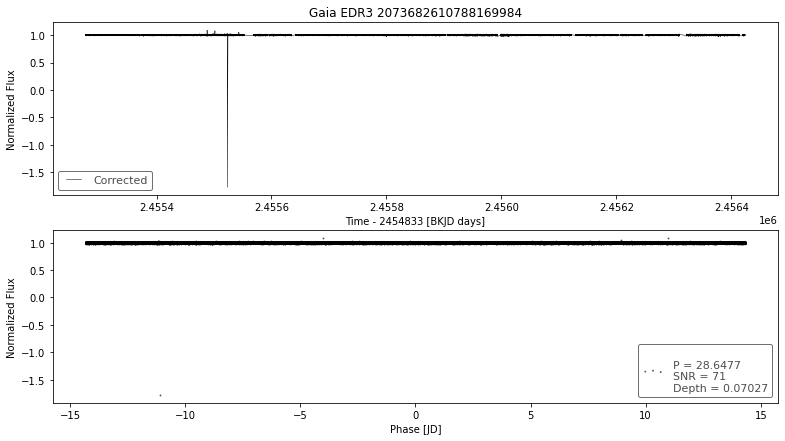

__________________________________________
index                                          36
designation         Gaia EDR3 2073682610788173824
BLS_period                              28.647694
BLS_period_SNR                         120.963912
BLS_duration                                 0.03
BLS_depth                                0.059051
BLS_transit_time                   2455294.048681
batch                                          56
Name: 5536, dtype: object
ra                          297.618173
ra_error                      0.311125
dec                          40.247907
dec_error                     0.347125
pmra                         -2.017265
pmdec                        -3.921186
parallax                      0.899096
parallax_error                0.391746
phot_g_n_obs                395.000000
phot_g_mean_flux           1610.385537
phot_g_mean_flux_error        7.774100
phot_g_mean_mag              17.670042
phot_bp_n_obs                44.000000
phot_bp_mean_flux       

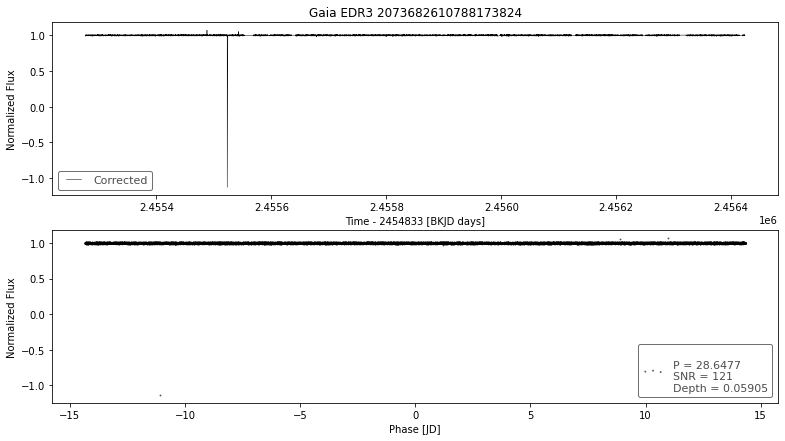

__________________________________________
index                                          37
designation         Gaia EDR3 2073682610788175360
BLS_period                               0.707867
BLS_period_SNR                           73.47704
BLS_duration                                0.126
BLS_depth                                0.002105
BLS_transit_time                   2455276.663681
batch                                          56
Name: 5537, dtype: object
ra                          297.626113
ra_error                      0.168753
dec                          40.242249
dec_error                     0.187192
pmra                        -21.716942
pmdec                       -15.350632
parallax                      4.957048
parallax_error                0.210100
phot_g_n_obs                393.000000
phot_g_mean_flux           2304.180284
phot_g_mean_flux_error       10.792838
phot_g_mean_mag              17.281076
phot_bp_n_obs                45.000000
phot_bp_mean_flux       

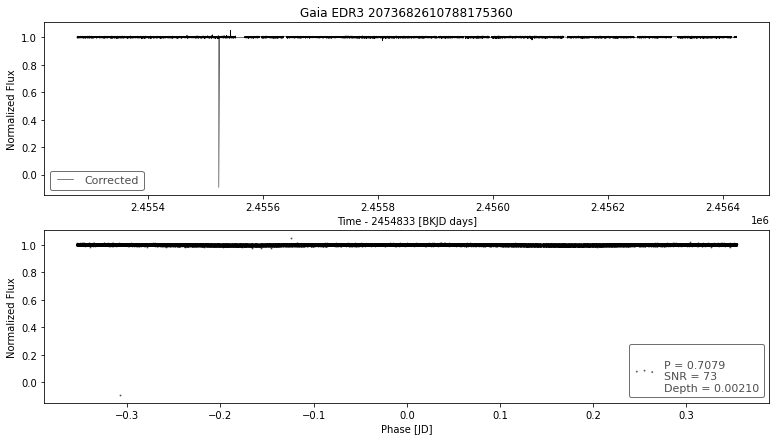

__________________________________________
index                                          38
designation         Gaia EDR3 2073682640842586368
BLS_period                               0.707867
BLS_period_SNR                         972.146159
BLS_duration                                0.126
BLS_depth                                0.016137
BLS_transit_time                   2455276.660681
batch                                          56
Name: 5538, dtype: object
ra                          297.646184
ra_error                      0.037215
dec                          40.239192
dec_error                     0.042999
pmra                          3.790537
pmdec                        -1.115233
parallax                      1.864157
parallax_error                0.048459
phot_g_n_obs                375.000000
phot_g_mean_flux           3731.459924
phot_g_mean_flux_error        2.113530
phot_g_mean_mag              16.757670
phot_bp_n_obs                48.000000
phot_bp_mean_flux       

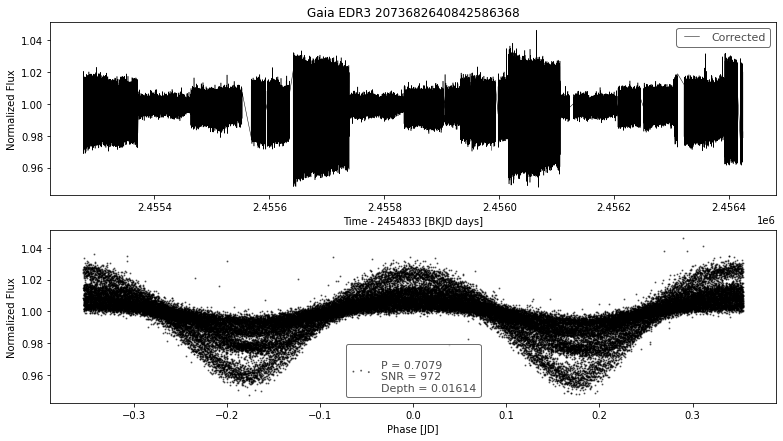

__________________________________________
index                                          39
designation         Gaia EDR3 2073682640842595968
BLS_period                               0.707867
BLS_period_SNR                         104.029862
BLS_duration                                0.126
BLS_depth                                0.002466
BLS_transit_time                   2455276.660681
batch                                          56
Name: 5539, dtype: object
ra                          297.646256
ra_error                      0.051359
dec                          40.241866
dec_error                     0.059749
pmra                         -5.725938
pmdec                        -8.524964
parallax                      0.374271
parallax_error                0.065971
phot_g_n_obs                389.000000
phot_g_mean_flux           2047.167845
phot_g_mean_flux_error        1.768883
phot_g_mean_mag              17.409483
phot_bp_n_obs                43.000000
phot_bp_mean_flux       

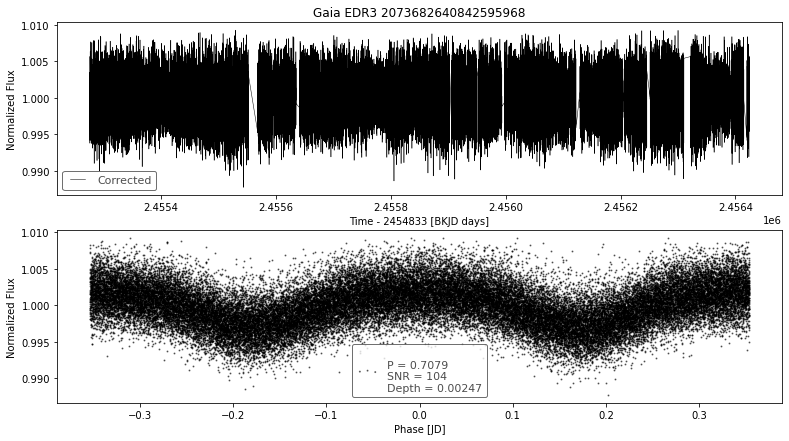

__________________________________________
index                                          41
designation         Gaia EDR3 2073682645137588992
BLS_period                               0.707867
BLS_period_SNR                          52.634456
BLS_duration                                0.174
BLS_depth                                0.001308
BLS_transit_time                   2455277.020681
batch                                          56
Name: 5541, dtype: object
ra                         297.647245
ra_error                     0.134736
dec                         40.242187
dec_error                    0.158103
pmra                        -0.780127
pmdec                       -6.368555
parallax                     0.193988
parallax_error               0.174612
phot_g_n_obs               388.000000
phot_g_mean_flux           485.568412
phot_g_mean_flux_error       1.033113
phot_g_mean_mag             18.971740
phot_bp_n_obs               15.000000
phot_bp_mean_flux          196.906376

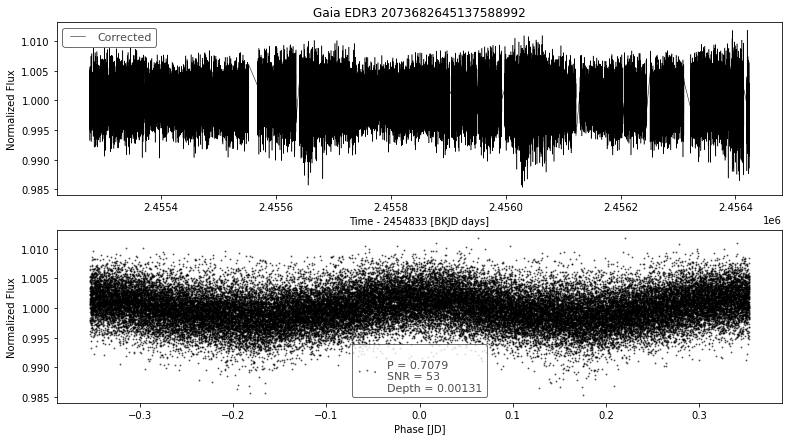

__________________________________________
index                                          43
designation         Gaia EDR3 2073682645147919104
BLS_period                               0.707867
BLS_period_SNR                      170372.101534
BLS_duration                                 0.45
BLS_depth                                0.075242
BLS_transit_time                   2455276.840681
batch                                          56
Name: 5543, dtype: object
ra                           297.638902
ra_error                       0.017516
dec                           40.236398
dec_error                      0.019735
pmra                          -2.663372
pmdec                         -6.132508
parallax                       0.427393
parallax_error                 0.021972
phot_g_n_obs                 375.000000
phot_g_mean_flux           16100.603597
phot_g_mean_flux_error         5.504622
phot_g_mean_mag               15.170261
phot_bp_n_obs                 34.000000
phot_bp_mea

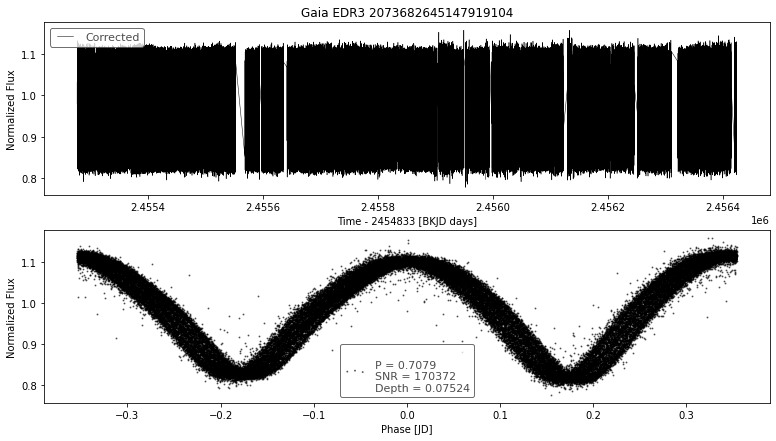

__________________________________________
index                                          44
designation         Gaia EDR3 2073682645147919616
BLS_period                               0.707867
BLS_period_SNR                      173535.280877
BLS_duration                                 0.45
BLS_depth                                0.075587
BLS_transit_time                   2455276.840681
batch                                          56
Name: 5544, dtype: object
ra                            297.640068
ra_error                        0.010282
dec                            40.236063
dec_error                       0.010969
pmra                           -3.730202
pmdec                          -7.869544
parallax                        1.256220
parallax_error                  0.012478
phot_g_n_obs                  437.000000
phot_g_mean_flux           481638.560593
phot_g_mean_flux_error       2468.658400
phot_g_mean_mag                11.480564
phot_bp_n_obs                  51.00000

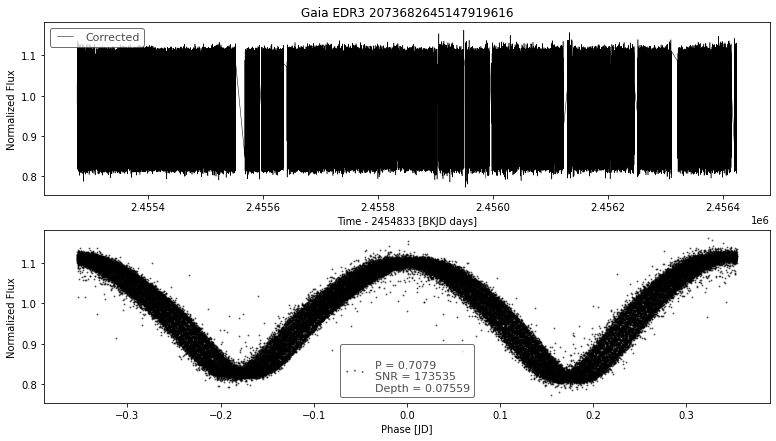

__________________________________________
index                                          45
designation         Gaia EDR3 2073682645147922688
BLS_period                               0.707867
BLS_period_SNR                        2283.421921
BLS_duration                                0.126
BLS_depth                                0.040115
BLS_transit_time                   2455276.660681
batch                                          56
Name: 5545, dtype: object
ra                          297.640639
ra_error                      0.042465
dec                          40.240539
dec_error                     0.046284
pmra                         -1.065017
pmdec                        -7.212282
parallax                      0.239668
parallax_error                0.051906
phot_g_n_obs                370.000000
phot_g_mean_flux           3038.819401
phot_g_mean_flux_error        1.895849
phot_g_mean_mag              16.980604
phot_bp_n_obs                47.000000
phot_bp_mean_flux       

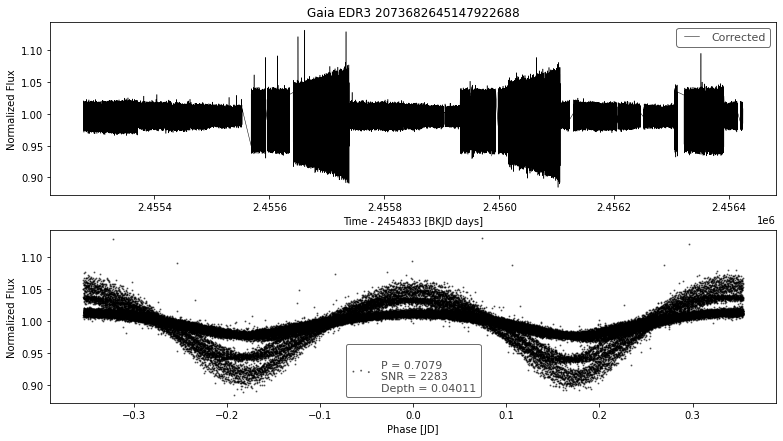

__________________________________________
index                                          46
designation         Gaia EDR3 2073682645147926016
BLS_period                               0.707867
BLS_period_SNR                          87.730675
BLS_duration                                0.126
BLS_depth                                  0.0009
BLS_transit_time                   2455276.657681
batch                                          56
Name: 5546, dtype: object
ra                          297.638987
ra_error                      0.026282
dec                          40.247393
dec_error                     0.028942
pmra                         -0.909351
pmdec                        -1.180338
parallax                      0.353969
parallax_error                0.032228
phot_g_n_obs                393.000000
phot_g_mean_flux           7081.034725
phot_g_mean_flux_error        2.965667
phot_g_mean_mag              16.062124
phot_bp_n_obs                48.000000
phot_bp_mean_flux       

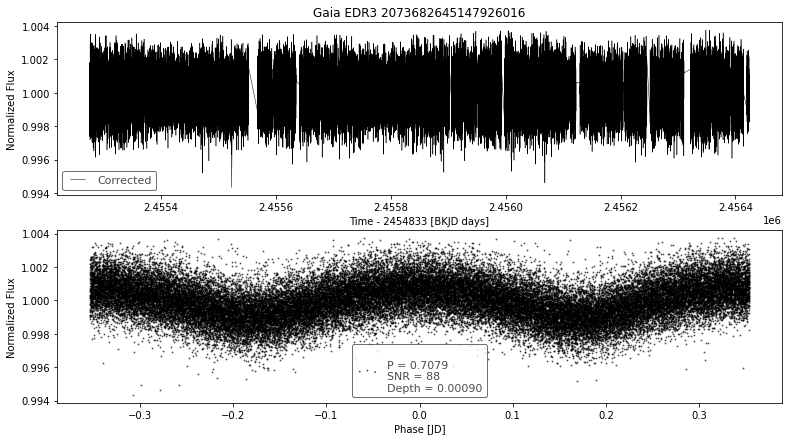

__________________________________________
index                                          47
designation         Gaia EDR3 2073682645147930496
BLS_period                               0.707867
BLS_period_SNR                          63.346645
BLS_duration                                0.126
BLS_depth                                0.002244
BLS_transit_time                   2455276.657116
batch                                          56
Name: 5547, dtype: object
ra                          297.645762
ra_error                      0.057238
dec                          40.245987
dec_error                     0.066107
pmra                         -0.890899
pmdec                        -3.788273
parallax                      0.527496
parallax_error                0.072804
phot_g_n_obs                376.000000
phot_g_mean_flux           1756.290577
phot_g_mean_flux_error        1.515140
phot_g_mean_mag              17.575876
phot_bp_n_obs                48.000000
phot_bp_mean_flux       

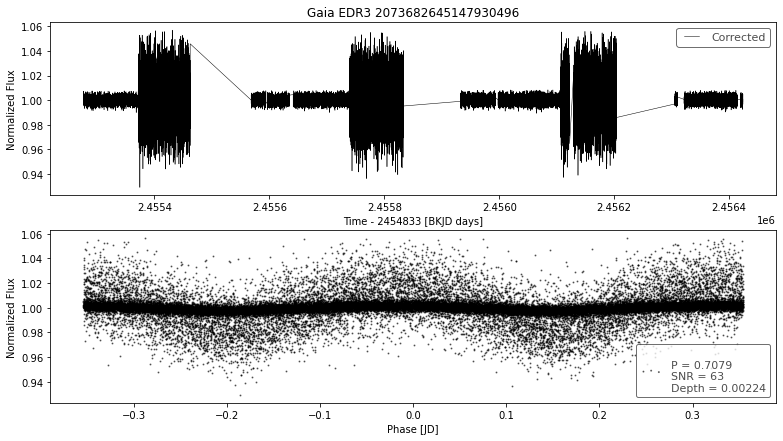

__________________________________________
index                                          53
designation         Gaia EDR3 2073682709562067712
BLS_period                               0.707867
BLS_period_SNR                         269.650599
BLS_duration                                0.126
BLS_depth                                0.007737
BLS_transit_time                   2455276.663681
batch                                          56
Name: 5553, dtype: object
ra                          297.630642
ra_error                      0.049656
dec                          40.240718
dec_error                     0.055627
pmra                         -3.369246
pmdec                        -8.352567
parallax                      0.272918
parallax_error                0.063284
phot_g_n_obs                381.000000
phot_g_mean_flux           2266.151655
phot_g_mean_flux_error        1.603718
phot_g_mean_mag              17.299145
phot_bp_n_obs                43.000000
phot_bp_mean_flux       

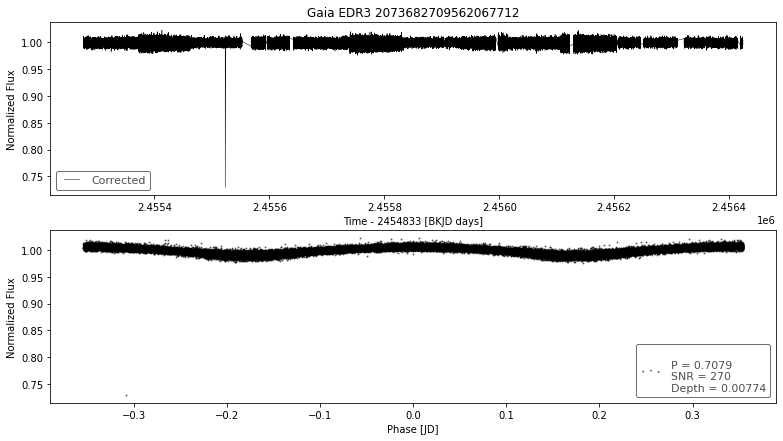

__________________________________________
index                                          60
designation         Gaia EDR3 2073682713857067520
BLS_period                                0.56065
BLS_period_SNR                         306.798854
BLS_duration                                 0.45
BLS_depth                                0.000226
BLS_transit_time                   2455276.846681
batch                                          56
Name: 5560, dtype: object
ra                           297.631005
ra_error                       0.024641
dec                           40.262759
dec_error                      0.027433
pmra                          -5.787825
pmdec                         -8.908061
parallax                       0.533259
parallax_error                 0.030375
phot_g_n_obs                 336.000000
phot_g_mean_flux            9997.305713
phot_g_mean_flux_error         8.831718
phot_g_mean_mag               15.687659
phot_bp_n_obs                 19.000000
phot_bp_mea

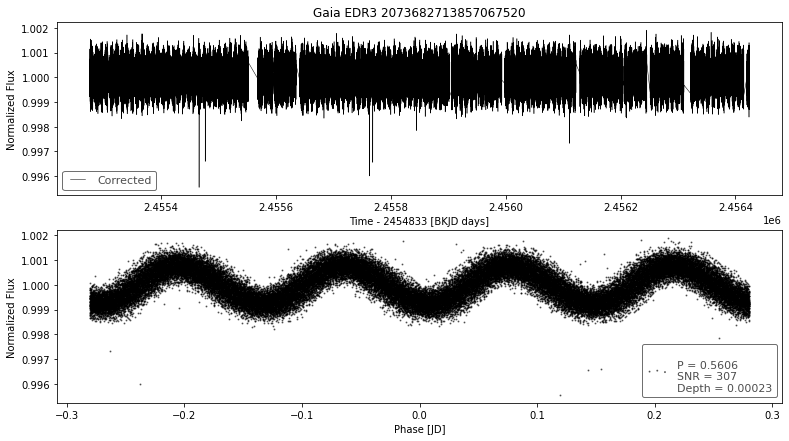

__________________________________________
index                                          61
designation         Gaia EDR3 2073682713857067648
BLS_period                                0.56065
BLS_period_SNR                         123.969814
BLS_duration                                0.051
BLS_depth                                0.000522
BLS_transit_time                   2455276.635181
batch                                          56
Name: 5561, dtype: object
ra                          297.630379
ra_error                      0.297188
dec                          40.262316
dec_error                     0.342145
pmra                         -2.349704
pmdec                        -4.045048
parallax                      0.304738
parallax_error                0.373766
phot_g_n_obs                317.000000
phot_g_mean_flux            195.854942
phot_g_mean_flux_error        1.156591
phot_g_mean_mag              19.957531
phot_bp_n_obs                 2.000000
phot_bp_mean_flux       

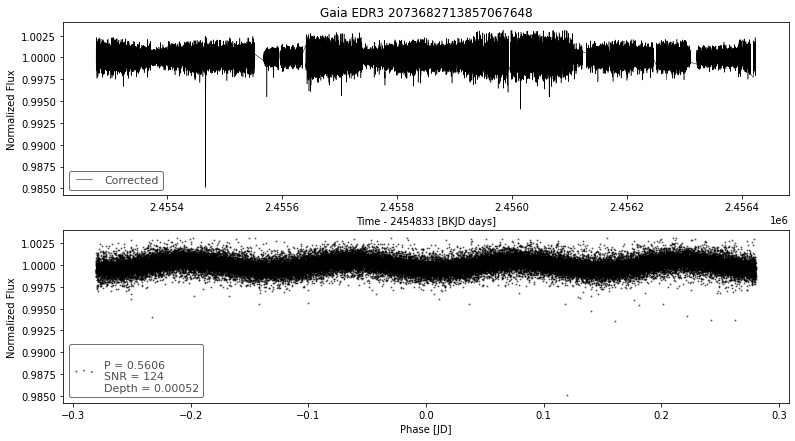

__________________________________________
index                                          62
designation         Gaia EDR3 2073682713857077888
BLS_period                                0.56065
BLS_period_SNR                         320.606851
BLS_duration                                 0.45
BLS_depth                                0.000233
BLS_transit_time                   2455276.846681
batch                                          56
Name: 5562, dtype: object
ra                            297.631733
ra_error                        0.447007
dec                            40.263243
dec_error                       0.453080
pmra                           -1.483977
pmdec                         -25.224131
parallax                       -0.192306
parallax_error                  0.526253
phot_g_n_obs                  376.000000
phot_g_mean_flux           231873.348905
phot_g_mean_flux_error       2475.606700
phot_g_mean_mag                12.274240
phot_bp_n_obs                  41.00000

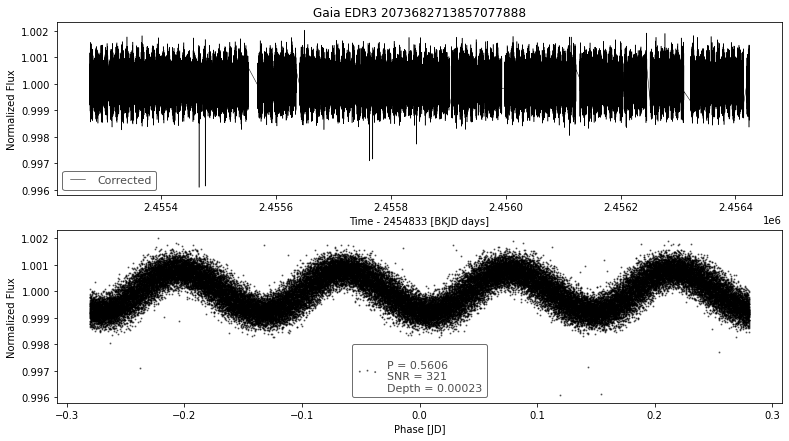

__________________________________________
index                                          63
designation         Gaia EDR3 2073682713867399552
BLS_period                               0.707867
BLS_period_SNR                          92.235086
BLS_duration                                 0.15
BLS_depth                                0.001066
BLS_transit_time                   2455276.660681
batch                                          56
Name: 5563, dtype: object
ra                          297.635068
ra_error                      0.027686
dec                          40.247670
dec_error                     0.030929
pmra                         -3.183460
pmdec                        -7.210478
parallax                      0.293339
parallax_error                0.034541
phot_g_n_obs                399.000000
phot_g_mean_flux           6063.800162
phot_g_mean_flux_error        2.583657
phot_g_mean_mag              16.230505
phot_bp_n_obs                46.000000
phot_bp_mean_flux       

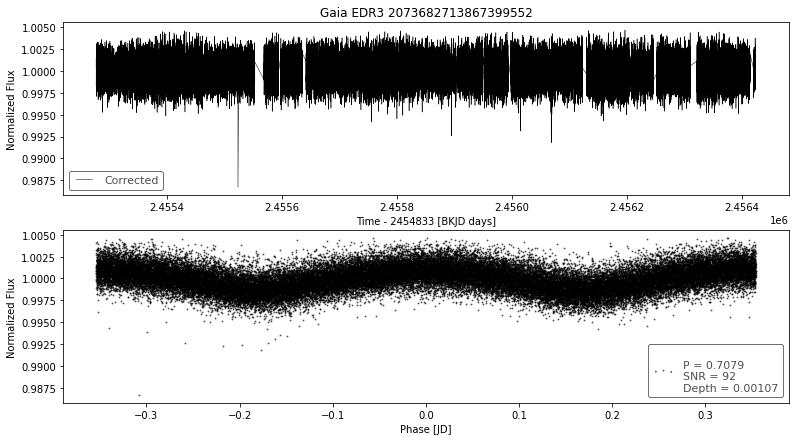

__________________________________________
index                                          65
designation         Gaia EDR3 2073682713870552064
BLS_period                                0.56065
BLS_period_SNR                          209.59948
BLS_duration                                 0.45
BLS_depth                                0.000221
BLS_transit_time                   2455276.846681
batch                                          56
Name: 5565, dtype: object
ra                          297.631842
ra_error                      0.114476
dec                          40.262170
dec_error                     0.122971
pmra                         -2.556233
pmdec                        -4.365791
parallax                      0.239270
parallax_error                0.148786
phot_g_n_obs                303.000000
phot_g_mean_flux            938.575258
phot_g_mean_flux_error        2.368250
phot_g_mean_mag              18.256193
phot_bp_n_obs                15.000000
phot_bp_mean_flux       

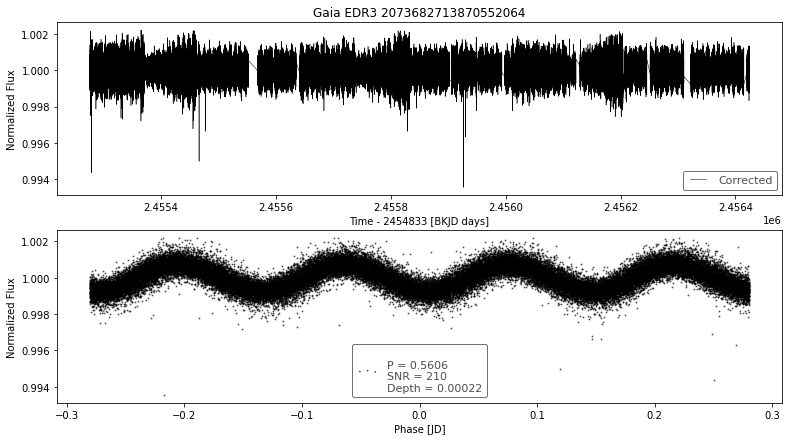

__________________________________________
index                                          84
designation         Gaia EDR3 2073685561420384000
BLS_period                              28.647694
BLS_period_SNR                          61.989417
BLS_duration                                 0.03
BLS_depth                                0.095185
BLS_transit_time                   2455294.048681
batch                                          56
Name: 5584, dtype: object
ra                         297.612582
ra_error                     0.138498
dec                         40.249916
dec_error                    0.150660
pmra                        -8.556186
pmdec                       -7.395509
parallax                     0.512301
parallax_error               0.174443
phot_g_n_obs               391.000000
phot_g_mean_flux           476.970590
phot_g_mean_flux_error       0.969172
phot_g_mean_mag             18.991138
phot_bp_n_obs               46.000000
phot_bp_mean_flux          201.932787

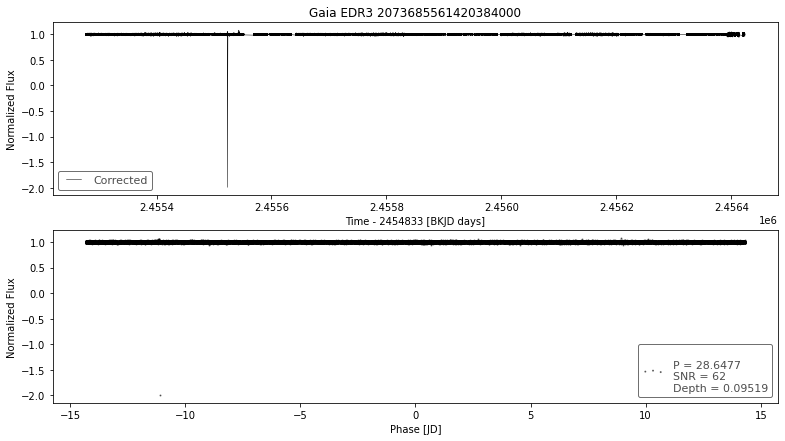

__________________________________________
index                                          87
designation         Gaia EDR3 2073685561420406656
BLS_period                                0.52396
BLS_period_SNR                         171.019816
BLS_duration                                 0.45
BLS_depth                                0.007024
BLS_transit_time                   2455276.714681
batch                                          56
Name: 5587, dtype: object
ra                          297.602277
ra_error                      0.079592
dec                          40.255147
dec_error                     0.086590
pmra                         -2.940749
pmdec                        -4.121219
parallax                      0.286291
parallax_error                0.098126
phot_g_n_obs                408.000000
phot_g_mean_flux           1070.570846
phot_g_mean_flux_error        1.544703
phot_g_mean_mag              18.113329
phot_bp_n_obs                45.000000
phot_bp_mean_flux       

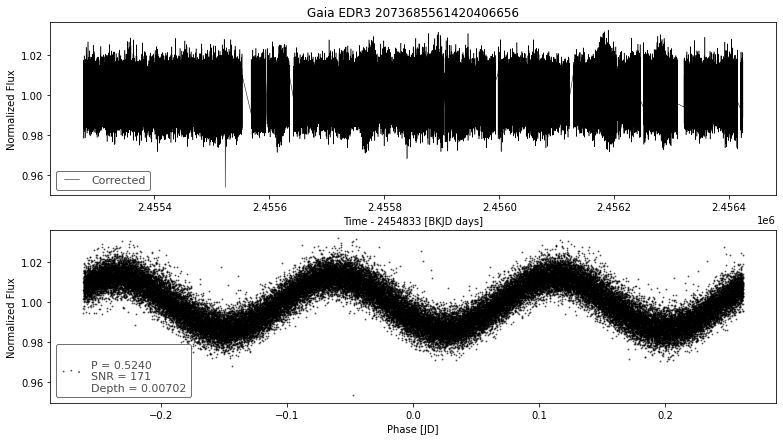

__________________________________________
index                                          90
designation         Gaia EDR3 2073685565715220608
BLS_period                                0.52396
BLS_period_SNR                         102.571978
BLS_duration                                 0.45
BLS_depth                                0.006238
BLS_transit_time                   2455276.714681
batch                                          56
Name: 5590, dtype: object
ra                         297.602207
ra_error                     0.148897
dec                         40.254041
dec_error                    0.159061
pmra                        -1.504707
pmdec                       -4.967360
parallax                     0.110305
parallax_error               0.186842
phot_g_n_obs               394.000000
phot_g_mean_flux           426.139531
phot_g_mean_flux_error       0.858695
phot_g_mean_mag             19.113487
phot_bp_n_obs               46.000000
phot_bp_mean_flux          176.088735

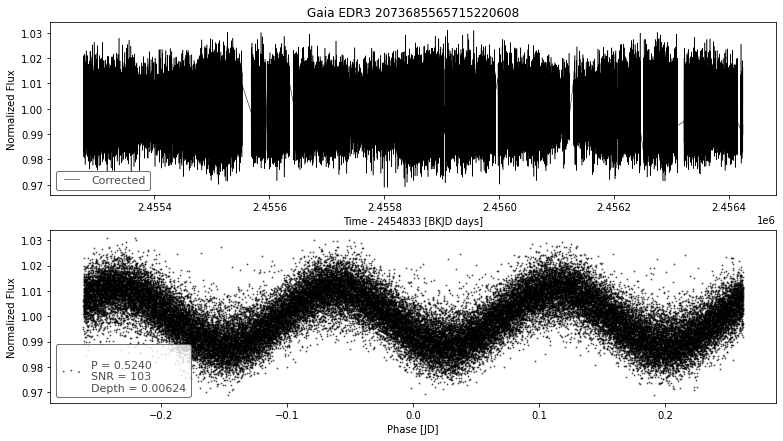

__________________________________________
index                                          91
designation         Gaia EDR3 2073685565715223808
BLS_period                                0.52396
BLS_period_SNR                         114.589811
BLS_duration                                 0.45
BLS_depth                                 0.00799
BLS_transit_time                   2455276.714681
batch                                          56
Name: 5591, dtype: object
ra                         297.601611
ra_error                     0.230881
dec                         40.255577
dec_error                    0.249163
pmra                        -0.667860
pmdec                       -3.067511
parallax                     0.605890
parallax_error               0.291243
phot_g_n_obs               384.000000
phot_g_mean_flux           238.010531
phot_g_mean_flux_error       0.812196
phot_g_mean_mag             19.745876
phot_bp_n_obs               14.000000
phot_bp_mean_flux           76.338210

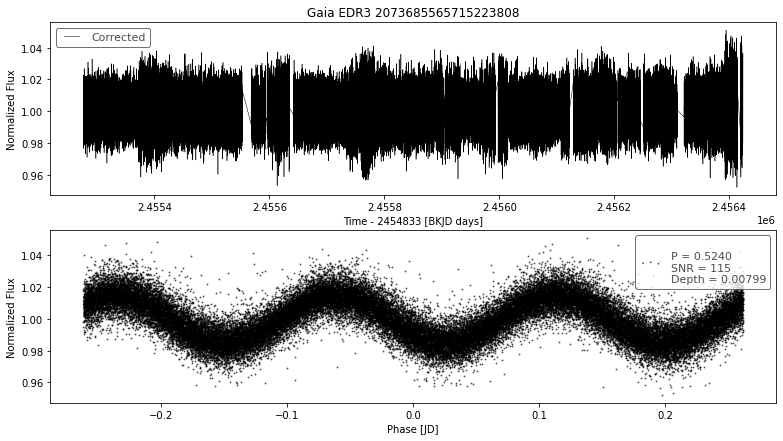

__________________________________________
index                                          92
designation         Gaia EDR3 2073685565715229312
BLS_period                                0.52396
BLS_period_SNR                         125.455349
BLS_duration                                 0.45
BLS_depth                                0.008166
BLS_transit_time                   2455276.714681
batch                                          56
Name: 5592, dtype: object
ra                         297.603138
ra_error                     0.275789
dec                         40.255296
dec_error                    0.301555
pmra                        -2.133736
pmdec                       -3.488690
parallax                    -0.037795
parallax_error               0.347257
phot_g_n_obs               372.000000
phot_g_mean_flux           206.646808
phot_g_mean_flux_error       0.747712
phot_g_mean_mag             19.899296
phot_bp_n_obs               13.000000
phot_bp_mean_flux           91.796351

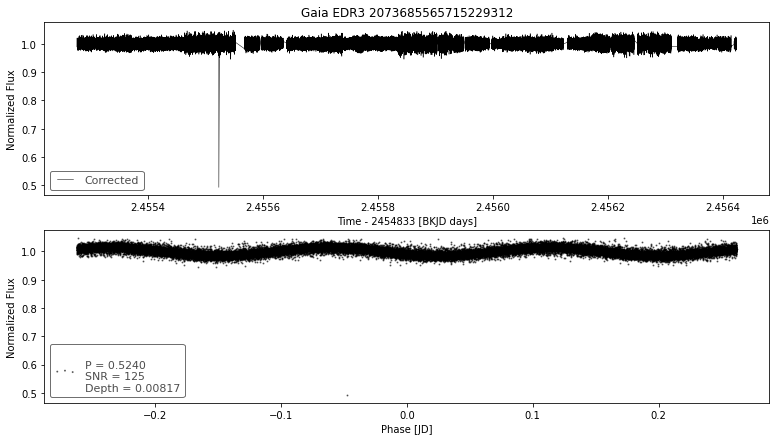

__________________________________________
index                                          96
designation         Gaia EDR3 2073685565725667456
BLS_period                              28.647694
BLS_period_SNR                           72.50537
BLS_duration                                 0.03
BLS_depth                                0.005538
BLS_transit_time                   2455294.048681
batch                                          56
Name: 5596, dtype: object
ra                          297.608695
ra_error                      0.030367
dec                          40.252261
dec_error                     0.032528
pmra                         -1.489213
pmdec                        -2.766188
parallax                      0.207336
parallax_error                0.037901
phot_g_n_obs                405.000000
phot_g_mean_flux           5292.814773
phot_g_mean_flux_error        2.512579
phot_g_mean_mag              16.378150
phot_bp_n_obs                47.000000
phot_bp_mean_flux       

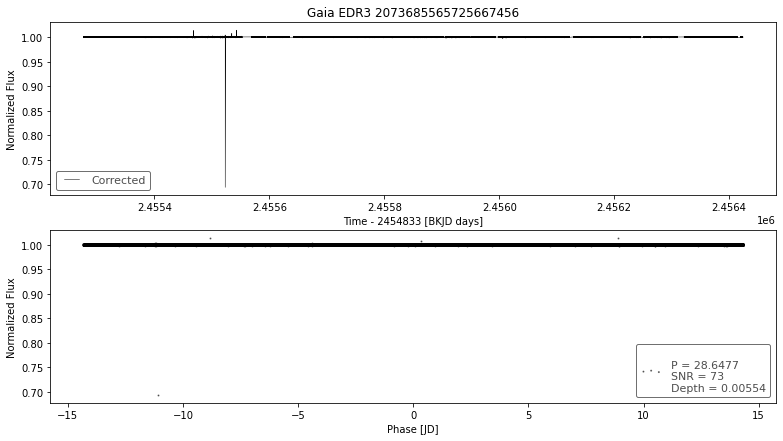

__________________________________________
index                                          97
designation         Gaia EDR3 2073685565725669504
BLS_period                              28.647694
BLS_period_SNR                         137.326028
BLS_duration                                 0.03
BLS_depth                                0.009619
BLS_transit_time                   2455294.048681
batch                                          56
Name: 5597, dtype: object
ra                           297.609586
ra_error                       0.018326
dec                           40.254126
dec_error                      0.019290
pmra                          -3.828652
pmdec                         -6.029987
parallax                       0.502260
parallax_error                 0.022138
phot_g_n_obs                 410.000000
phot_g_mean_flux           13735.797328
phot_g_mean_flux_error         3.506624
phot_g_mean_mag               15.342732
phot_bp_n_obs                 46.000000
phot_bp_mea

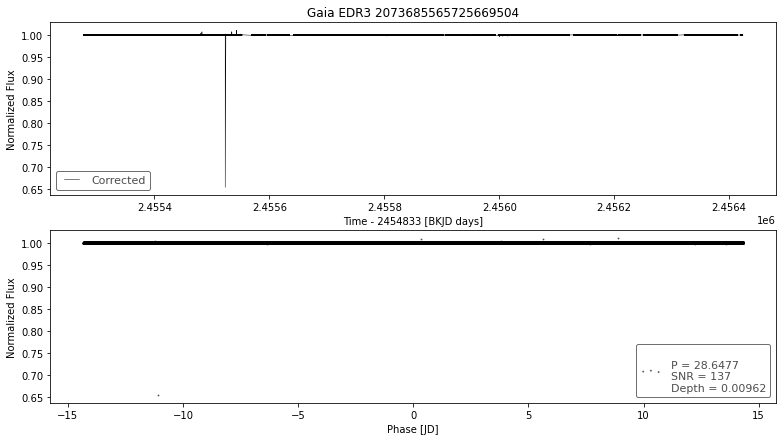

__________________________________________
index                                          98
designation         Gaia EDR3 2073685565725671808
BLS_period                              28.647694
BLS_period_SNR                          95.762427
BLS_duration                                 0.03
BLS_depth                                0.007537
BLS_transit_time                   2455294.048681
batch                                          56
Name: 5598, dtype: object
ra                          297.610097
ra_error                      0.063072
dec                          40.254952
dec_error                     0.068410
pmra                         -2.099445
pmdec                        -2.707138
parallax                      0.147646
parallax_error                0.078175
phot_g_n_obs                402.000000
phot_g_mean_flux           1954.171782
phot_g_mean_flux_error        1.761353
phot_g_mean_mag              17.459960
phot_bp_n_obs                25.000000
phot_bp_mean_flux       

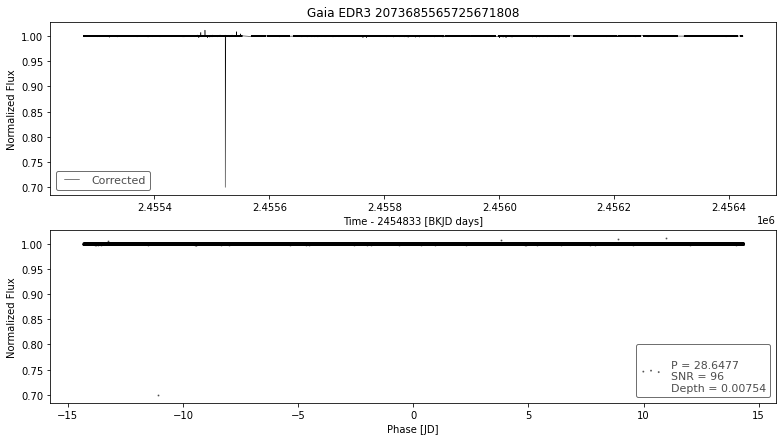

__________________________________________
index                                           6
designation         Gaia EDR3 2073685630139903360
BLS_period                              28.647694
BLS_period_SNR                           82.92321
BLS_duration                                 0.03
BLS_depth                                0.097856
BLS_transit_time                   2455294.048681
batch                                          57
Name: 5606, dtype: object
ra                         297.605599
ra_error                     0.114204
dec                         40.261441
dec_error                    0.118172
pmra                        -1.302130
pmdec                       -3.350324
parallax                     0.273023
parallax_error               0.138350
phot_g_n_obs               378.000000
phot_g_mean_flux           678.513398
phot_g_mean_flux_error       1.207744
phot_g_mean_mag             18.608470
phot_bp_n_obs               38.000000
phot_bp_mean_flux          292.855489

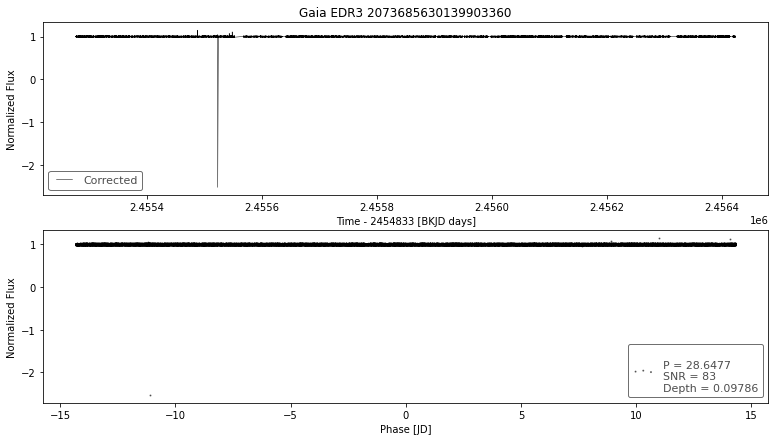

__________________________________________
index                                           9
designation         Gaia EDR3 2073685630139920512
BLS_period                              28.647694
BLS_period_SNR                            77.0111
BLS_duration                                 0.03
BLS_depth                                0.059305
BLS_transit_time                   2455294.048681
batch                                          57
Name: 5609, dtype: object
ra                         297.605803
ra_error                     0.088010
dec                         40.266908
dec_error                    0.092323
pmra                        -3.829868
pmdec                       -5.936549
parallax                     0.103377
parallax_error               0.106107
phot_g_n_obs               387.000000
phot_g_mean_flux           968.731880
phot_g_mean_flux_error       1.263116
phot_g_mean_mag             18.221857
phot_bp_n_obs               44.000000
phot_bp_mean_flux          430.928091

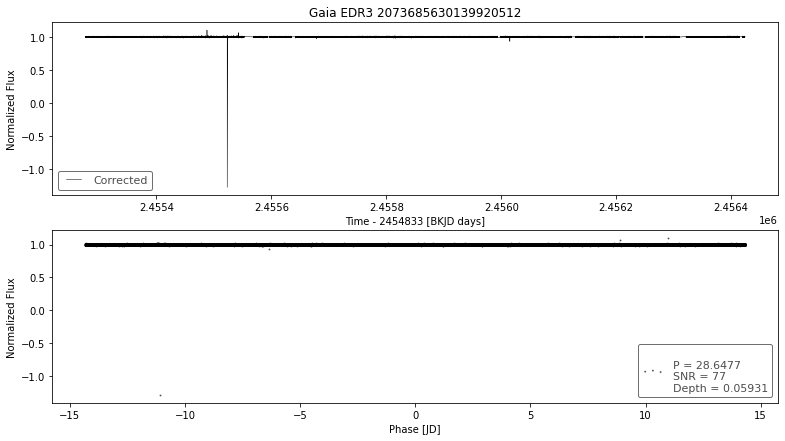

__________________________________________
index                                          33
designation         Gaia EDR3 2073685668794567808
BLS_period                                0.56065
BLS_period_SNR                          75.640092
BLS_duration                                 0.45
BLS_depth                                0.000185
BLS_transit_time                   2455276.846681
batch                                          57
Name: 5633, dtype: object
ra                          297.628932
ra_error                      0.072473
dec                          40.264380
dec_error                     0.080279
pmra                         -3.687252
pmdec                        -7.768435
parallax                      0.119347
parallax_error                0.089772
phot_g_n_obs                384.000000
phot_g_mean_flux           1255.659696
phot_g_mean_flux_error        1.307586
phot_g_mean_mag              17.940187
phot_bp_n_obs                41.000000
phot_bp_mean_flux       

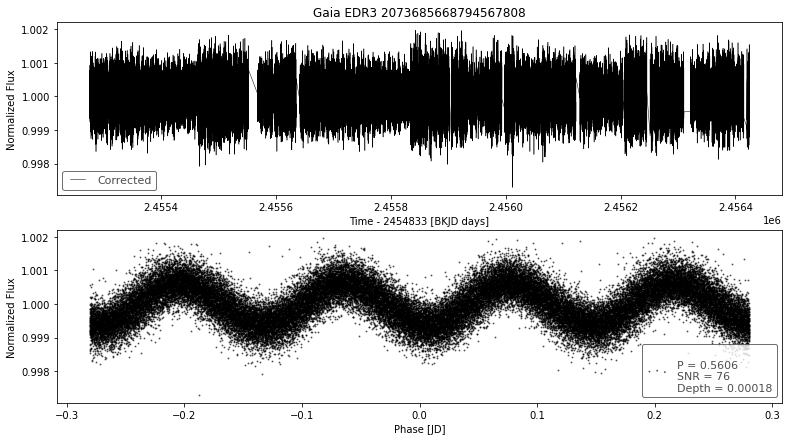

__________________________________________
index                                          35
designation         Gaia EDR3 2073685668804904064
BLS_period                                0.56065
BLS_period_SNR                         142.865529
BLS_duration                                 0.45
BLS_depth                                 0.00019
BLS_transit_time                   2455276.846681
batch                                          57
Name: 5635, dtype: object
ra                           297.628352
ra_error                       0.018104
dec                           40.263156
dec_error                      0.019199
pmra                           2.371492
pmdec                         -6.726234
parallax                       0.433146
parallax_error                 0.021477
phot_g_n_obs                 406.000000
phot_g_mean_flux           14564.853098
phot_g_mean_flux_error         4.333042
phot_g_mean_mag               15.279101
phot_bp_n_obs                 46.000000
phot_bp_mea

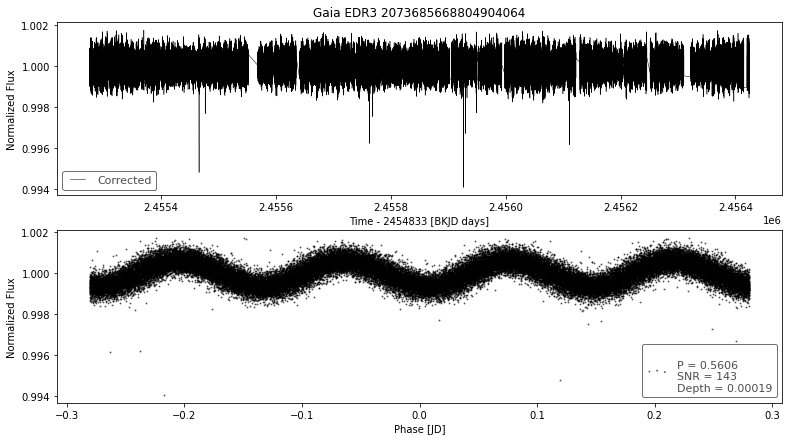

__________________________________________
index                                          63
designation         Gaia EDR3 2073685771876090112
BLS_period                               0.881536
BLS_period_SNR                         421.771252
BLS_duration                                 0.45
BLS_depth                                0.000301
BLS_transit_time                   2455276.981681
batch                                          57
Name: 5663, dtype: object
ra                          297.622168
ra_error                      0.094200
dec                          40.283799
dec_error                     0.099575
pmra                         -2.551078
pmdec                        -7.324605
parallax                      0.426873
parallax_error                0.118366
phot_g_n_obs                312.000000
phot_g_mean_flux            999.891278
phot_g_mean_flux_error        2.787323
phot_g_mean_mag              18.187485
phot_bp_n_obs                34.000000
phot_bp_mean_flux       

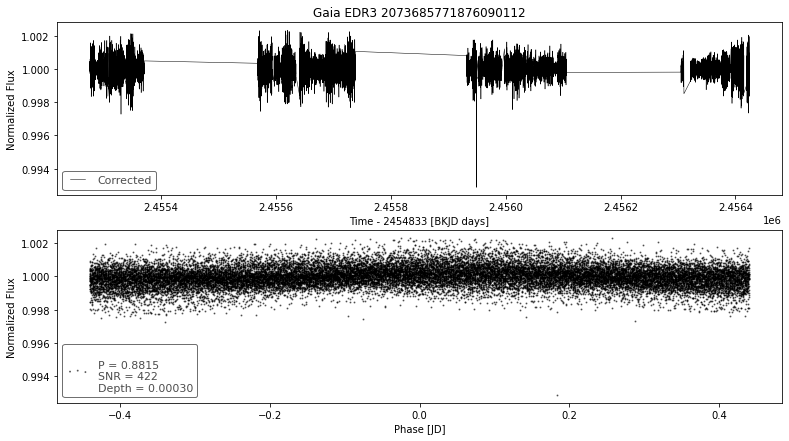

__________________________________________
index                                          67
designation         Gaia EDR3 2073685771884129024
BLS_period                               0.881536
BLS_period_SNR                         292.861717
BLS_duration                                 0.45
BLS_depth                                0.000355
BLS_transit_time                   2455276.981681
batch                                          57
Name: 5667, dtype: object
ra                          297.623325
ra_error                      0.043985
dec                          40.282540
dec_error                     0.042917
pmra                         -2.092130
pmdec                        -3.066723
parallax                     -0.070013
parallax_error                0.050672
phot_g_n_obs                332.000000
phot_g_mean_flux           3748.177833
phot_g_mean_flux_error        2.417173
phot_g_mean_mag              16.752817
phot_bp_n_obs                41.000000
phot_bp_mean_flux       

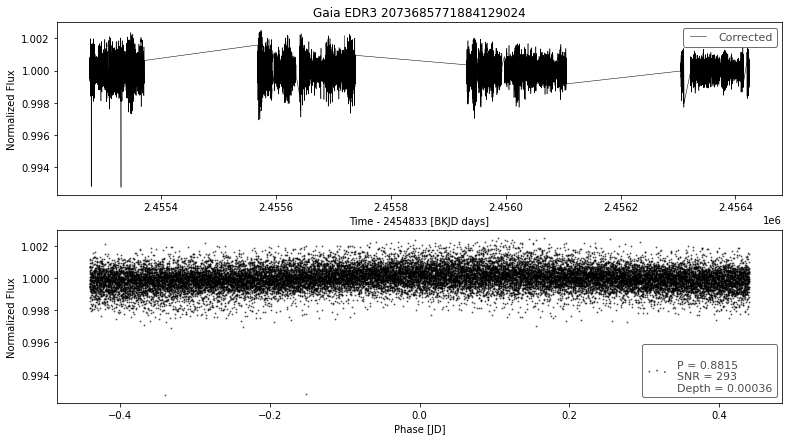

__________________________________________
index                                          69
designation         Gaia EDR3 2073685771884589440
BLS_period                               0.881536
BLS_period_SNR                         524.056279
BLS_duration                                 0.45
BLS_depth                                0.000301
BLS_transit_time                   2455276.960681
batch                                          57
Name: 5669, dtype: object
ra                            297.623363
ra_error                        0.019131
dec                            40.284735
dec_error                       0.021040
pmra                            1.645476
pmdec                          -0.423788
parallax                        2.966581
parallax_error                  0.023390
phot_g_n_obs                  385.000000
phot_g_mean_flux           570809.482257
phot_g_mean_flux_error        223.488130
phot_g_mean_mag                11.296139
phot_bp_n_obs                  42.00000

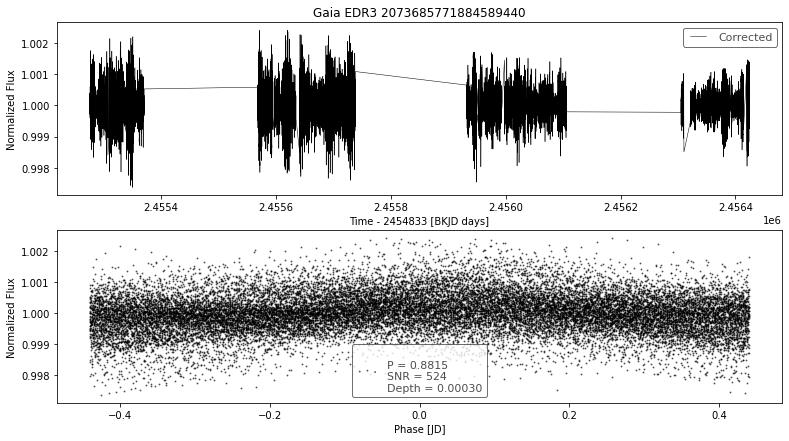

__________________________________________
index                                          70
designation         Gaia EDR3 2073685771884589568
BLS_period                               0.881689
BLS_period_SNR                          54.677688
BLS_duration                                 0.45
BLS_depth                                0.000302
BLS_transit_time                   2455276.882681
batch                                          57
Name: 5670, dtype: object
ra                          297.618805
ra_error                      0.071788
dec                          40.285701
dec_error                     0.076585
pmra                         -2.541000
pmdec                        -3.817279
parallax                     -0.035079
parallax_error                0.088852
phot_g_n_obs                359.000000
phot_g_mean_flux           1456.217427
phot_g_mean_flux_error        1.602053
phot_g_mean_mag              17.779300
phot_bp_n_obs                39.000000
phot_bp_mean_flux       

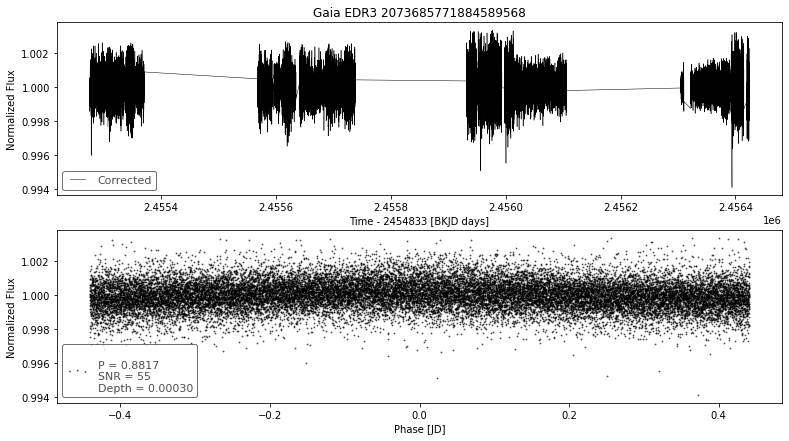

__________________________________________
index                                          88
designation         Gaia EDR3 2073685840603582080
BLS_period                              28.647694
BLS_period_SNR                         107.782896
BLS_duration                                 0.03
BLS_depth                                0.021691
BLS_transit_time                   2455294.048681
batch                                          57
Name: 5688, dtype: object
ra                          297.592458
ra_error                      0.033674
dec                          40.282153
dec_error                     0.038019
pmra                         -6.619923
pmdec                       -14.384037
parallax                      1.112252
parallax_error                0.042370
phot_g_n_obs                378.000000
phot_g_mean_flux           4449.808036
phot_g_mean_flux_error        2.485698
phot_g_mean_mag              16.566513
phot_bp_n_obs                42.000000
phot_bp_mean_flux       

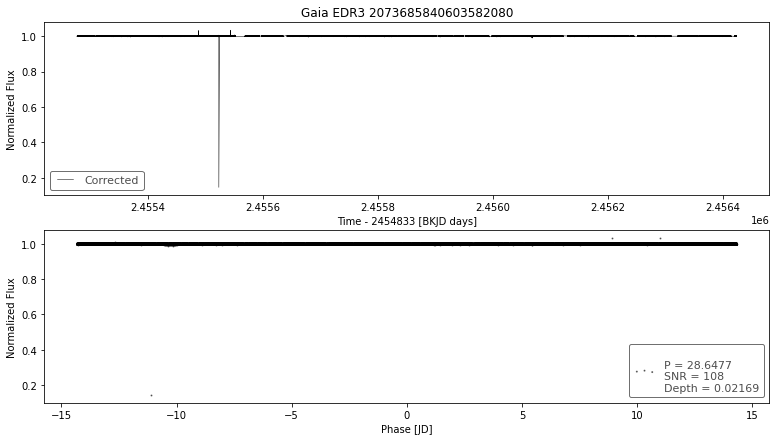

__________________________________________
index                                          94
designation         Gaia EDR3 2073685943672398464
BLS_period                              28.647694
BLS_period_SNR                          52.636142
BLS_duration                                 0.03
BLS_depth                                0.010875
BLS_transit_time                   2455294.048681
batch                                          57
Name: 5694, dtype: object
ra                         297.592966
ra_error                     0.089270
dec                         40.282809
dec_error                    0.096649
pmra                        -1.851527
pmdec                       -7.104192
parallax                     0.132996
parallax_error               0.110350
phot_g_n_obs               378.000000
phot_g_mean_flux           915.059241
phot_g_mean_flux_error       1.236365
phot_g_mean_mag             18.283743
phot_bp_n_obs               24.000000
phot_bp_mean_flux          396.935606

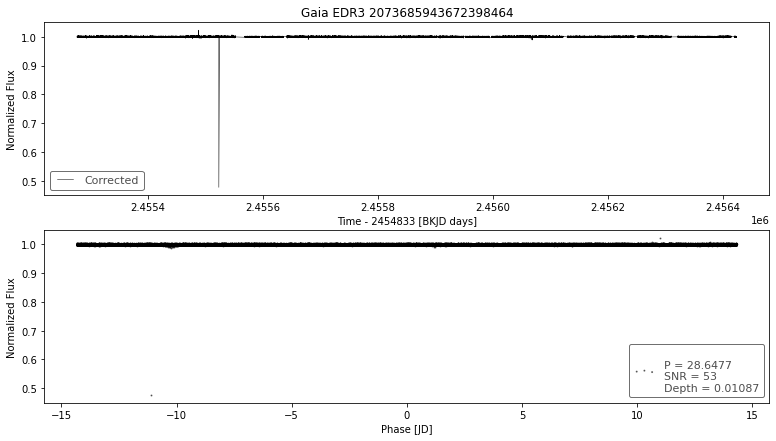

__________________________________________
index                                          39
designation         Gaia EDR3 2134814804448660608
BLS_period                               0.707178
BLS_period_SNR                       14641.590663
BLS_duration                                 0.15
BLS_depth                                0.108988
BLS_transit_time                   2455277.006163
batch                                          58
Name: 5739, dtype: object
ra                          295.419108
ra_error                      0.026029
dec                          49.106279
dec_error                     0.026932
pmra                         -1.781303
pmdec                        -3.819286
parallax                      0.143454
parallax_error                0.028598
phot_g_n_obs                368.000000
phot_g_mean_flux           8522.427145
phot_g_mean_flux_error       35.579987
phot_g_mean_mag              15.860959
phot_bp_n_obs                43.000000
phot_bp_mean_flux       

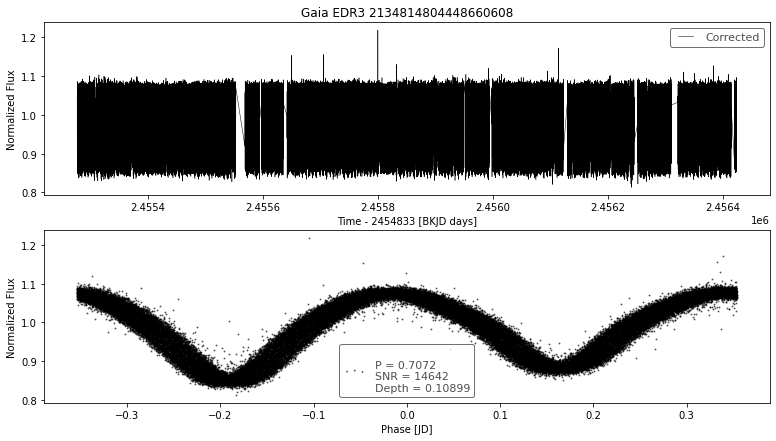

__________________________________________
index                                          57
designation         Gaia EDR3 2134814941887629312
BLS_period                                0.62395
BLS_period_SNR                         105.124525
BLS_duration                                 0.45
BLS_depth                                0.000046
BLS_transit_time                   2455276.814163
batch                                          58
Name: 5757, dtype: object
ra                            295.431682
ra_error                        0.010551
dec                            49.128922
dec_error                       0.011699
pmra                           -2.315058
pmdec                          -3.409883
parallax                        0.603012
parallax_error                  0.011883
phot_g_n_obs                  339.000000
phot_g_mean_flux           519851.156045
phot_g_mean_flux_error         77.889450
phot_g_mean_mag                11.397670
phot_bp_n_obs                  40.00000

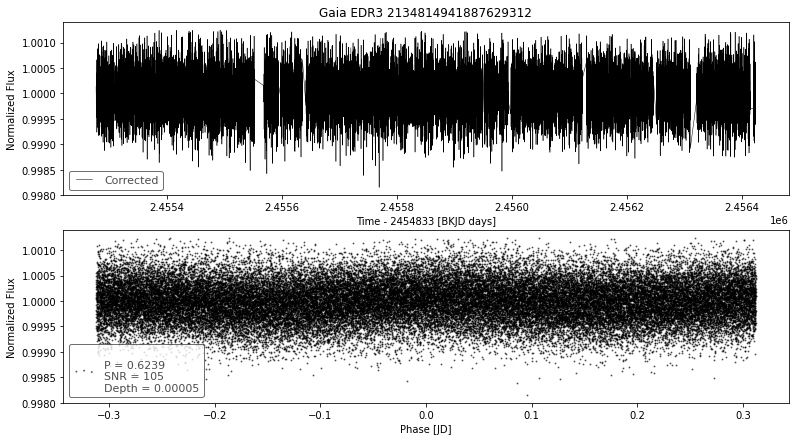

__________________________________________
index                                          50
designation         Gaia EDR3 2135153827685414272
BLS_period                               0.509316
BLS_period_SNR                          16.050498
BLS_duration                                0.399
BLS_depth                                0.000562
BLS_transit_time                    2455276.69276
batch                                          59
Name: 5850, dtype: object
ra                          294.512141
ra_error                      0.522542
dec                          50.173501
dec_error                     0.555858
pmra                          6.931056
pmdec                       -19.551954
parallax                      4.484590
parallax_error                0.565050
phot_g_n_obs                261.000000
phot_g_mean_flux           1088.688988
phot_g_mean_flux_error       12.253829
phot_g_mean_mag              18.095108
phot_bp_n_obs                36.000000
phot_bp_mean_flux       

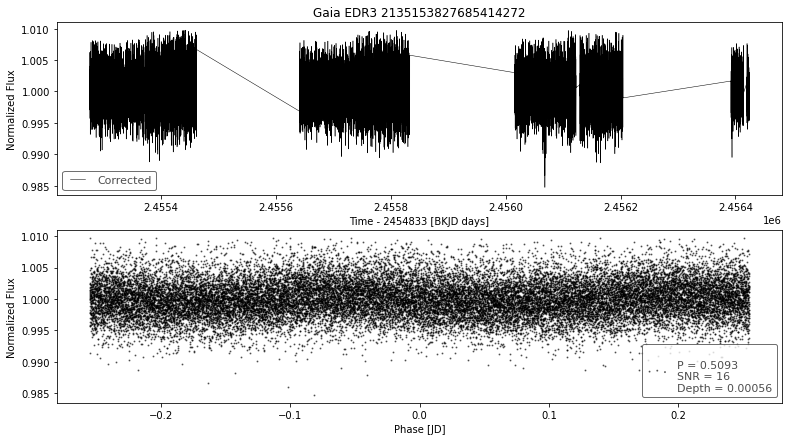

__________________________________________
index                                           3
designation         Gaia EDR3 2135392352989960576
BLS_period                               0.536851
BLS_period_SNR                         132.849212
BLS_duration                                 0.45
BLS_depth                                0.000095
BLS_transit_time                   2455276.799199
batch                                          60
Name: 5903, dtype: object
ra                            296.025765
ra_error                        0.008472
dec                            50.700695
dec_error                       0.009104
pmra                            2.965878
pmdec                           9.368243
parallax                        0.808406
parallax_error                  0.009409
phot_g_n_obs                  315.000000
phot_g_mean_flux           395328.356924
phot_g_mean_flux_error         54.639656
phot_g_mean_mag                11.694972
phot_bp_n_obs                  37.00000

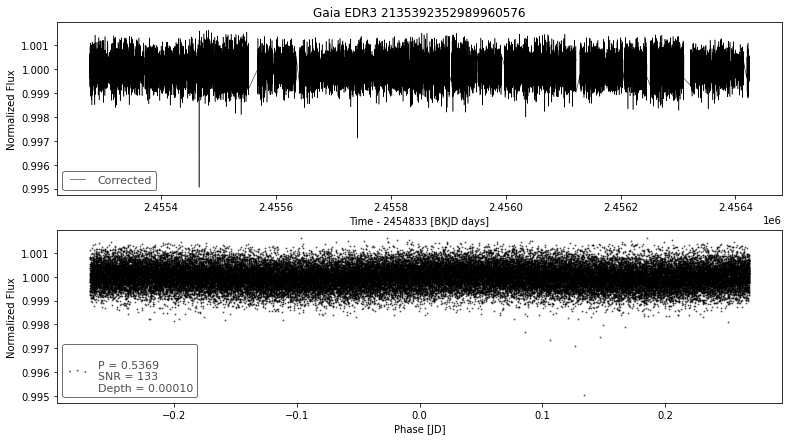

__________________________________________
index                                          10
designation         Gaia EDR3 2135392357287470208
BLS_period                               0.536851
BLS_period_SNR                          57.408597
BLS_duration                                 0.45
BLS_depth                                0.000112
BLS_transit_time                   2455276.808199
batch                                          60
Name: 5910, dtype: object
ra                          296.027279
ra_error                      0.090511
dec                          50.702286
dec_error                     0.098066
pmra                         -4.643712
pmdec                        -6.145264
parallax                      0.302745
parallax_error                0.105095
phot_g_n_obs                241.000000
phot_g_mean_flux           1260.665087
phot_g_mean_flux_error        1.708269
phot_g_mean_mag              17.935867
phot_bp_n_obs                30.000000
phot_bp_mean_flux       

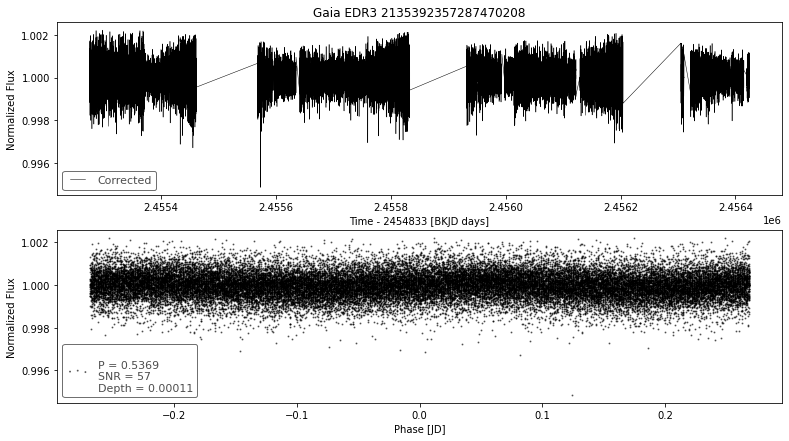

__________________________________________
index                                          25
designation         Gaia EDR3 2080297543308948480
BLS_period                                0.57407
BLS_period_SNR                         166.169127
BLS_duration                                0.051
BLS_depth                                0.024589
BLS_transit_time                   2455276.764454
batch                                          61
Name: 6025, dtype: object
ra                         297.429867
ra_error                     0.178417
dec                         46.602909
dec_error                    0.168650
pmra                        -2.390536
pmdec                       -6.344136
parallax                     0.162686
parallax_error               0.200260
phot_g_n_obs               344.000000
phot_g_mean_flux           355.781018
phot_g_mean_flux_error       1.002308
phot_g_mean_mag             19.309410
phot_bp_n_obs               38.000000
phot_bp_mean_flux          135.153242

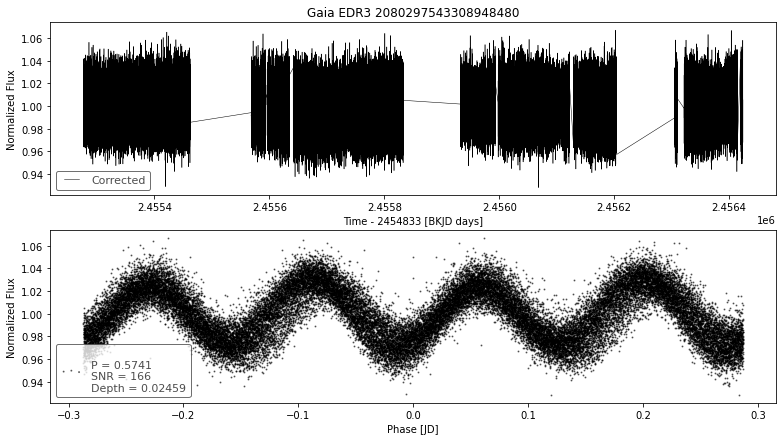

__________________________________________
index                                          65
designation         Gaia EDR3 2080297753765423744
BLS_period                               2.170456
BLS_period_SNR                           290.0701
BLS_duration                                0.126
BLS_depth                                0.014945
BLS_transit_time                   2455276.921954
batch                                          61
Name: 6065, dtype: object
ra                         297.416069
ra_error                     0.291124
dec                         46.622287
dec_error                    0.273578
pmra                        -1.925730
pmdec                       -1.622342
parallax                    -0.070851
parallax_error               0.318923
phot_g_n_obs               333.000000
phot_g_mean_flux           196.818873
phot_g_mean_flux_error       0.978384
phot_g_mean_mag             19.952200
phot_bp_n_obs                2.000000
phot_bp_mean_flux          127.673163

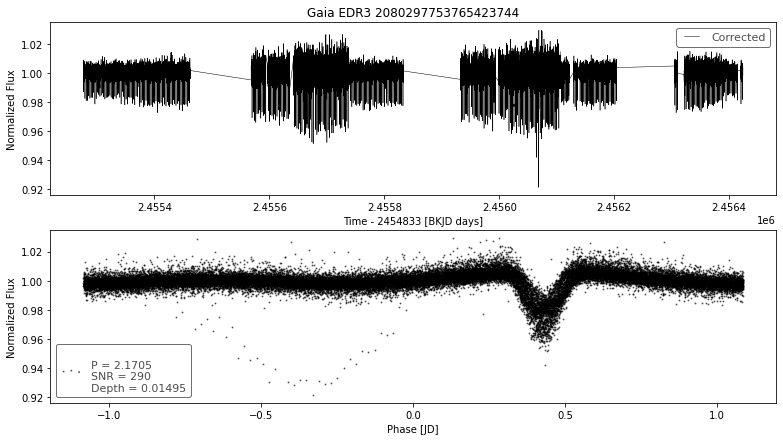

__________________________________________
index                                          66
designation         Gaia EDR3 2080297753765434496
BLS_period                               0.827853
BLS_period_SNR                         543.618369
BLS_duration                                0.051
BLS_depth                                0.022654
BLS_transit_time                   2455276.806454
batch                                          61
Name: 6066, dtype: object
ra                          297.416558
ra_error                      0.077305
dec                          46.626683
dec_error                     0.075891
pmra                         -2.327354
pmdec                        -8.656441
parallax                      0.159834
parallax_error                0.086219
phot_g_n_obs                360.000000
phot_g_mean_flux           1161.445103
phot_g_mean_flux_error        1.284479
phot_g_mean_mag              18.024870
phot_bp_n_obs                41.000000
phot_bp_mean_flux       

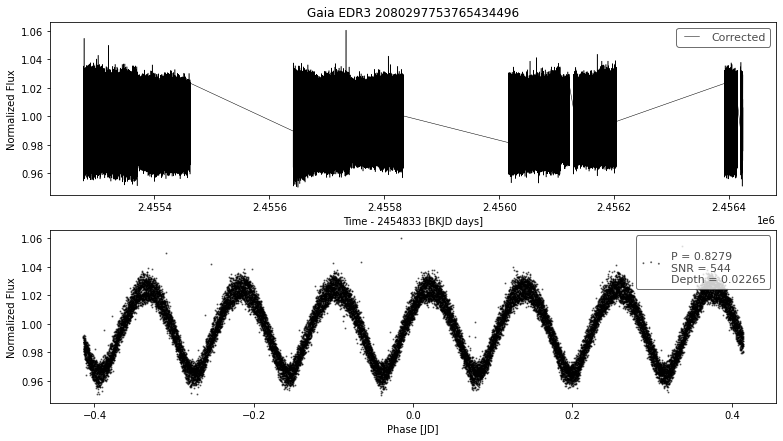

__________________________________________
index                                          68
designation         Gaia EDR3 2080297753770786944
BLS_period                               2.170456
BLS_period_SNR                         265.374664
BLS_duration                                0.126
BLS_depth                                0.010893
BLS_transit_time                   2455276.921954
batch                                          61
Name: 6068, dtype: object
ra                          297.416178
ra_error                      0.065119
dec                          46.622853
dec_error                     0.061993
pmra                         -4.625668
pmdec                        -5.366603
parallax                      0.257714
parallax_error                0.073858
phot_g_n_obs                337.000000
phot_g_mean_flux           1637.696521
phot_g_mean_flux_error        1.603411
phot_g_mean_mag              17.651783
phot_bp_n_obs                38.000000
phot_bp_mean_flux       

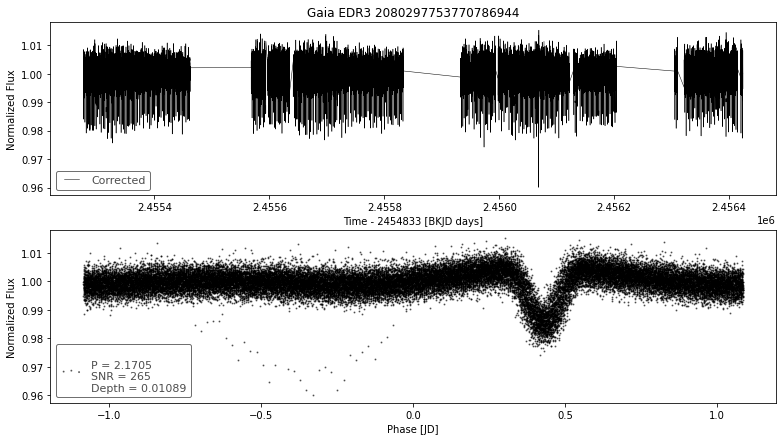

__________________________________________
index                                          70
designation         Gaia EDR3 2080297753770788864
BLS_period                               0.827853
BLS_period_SNR                        1825.631793
BLS_duration                                0.051
BLS_depth                                0.048621
BLS_transit_time                   2455277.160454
batch                                          61
Name: 6070, dtype: object
ra                          297.416181
ra_error                      0.049023
dec                          46.625380
dec_error                     0.050086
pmra                          3.843415
pmdec                       -10.556638
parallax                      0.599422
parallax_error                0.055495
phot_g_n_obs                374.000000
phot_g_mean_flux           2382.390459
phot_g_mean_flux_error       11.414193
phot_g_mean_mag              17.244835
phot_bp_n_obs                44.000000
phot_bp_mean_flux       

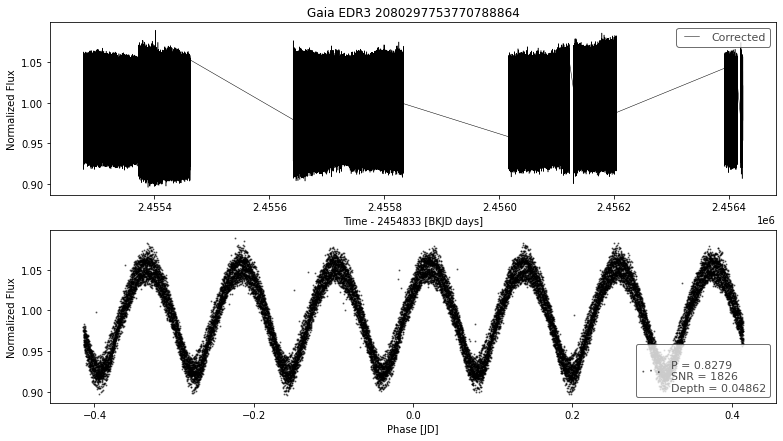

__________________________________________
index                                          99
designation         Gaia EDR3 2086592350456692864
BLS_period                               6.359473
BLS_period_SNR                         271.688817
BLS_duration                                0.399
BLS_depth                                0.014536
BLS_transit_time                   2455277.435983
batch                                          62
Name: 6199, dtype: object
ra                         296.591359
ra_error                     0.112192
dec                         47.648079
dec_error                    0.110208
pmra                        -3.217573
pmdec                       -5.258531
parallax                    -0.030694
parallax_error               0.118239
phot_g_n_obs               344.000000
phot_g_mean_flux           796.099351
phot_g_mean_flux_error       1.250683
phot_g_mean_mag             18.434948
phot_bp_n_obs               27.000000
phot_bp_mean_flux          402.002522

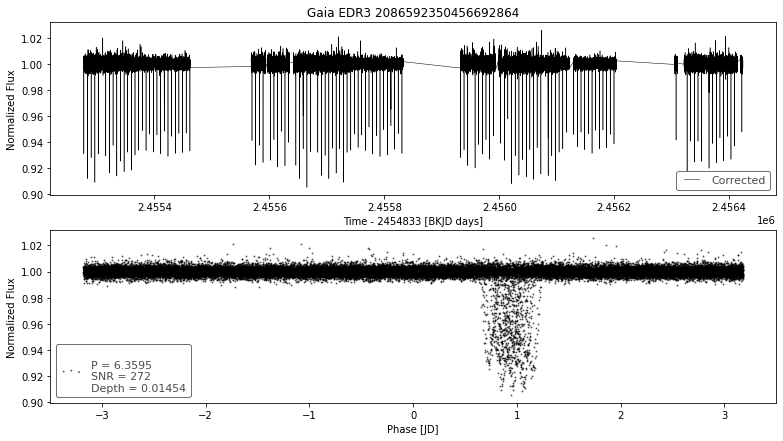

__________________________________________
index                                           0
designation         Gaia EDR3 2086592354751514624
BLS_period                               6.359473
BLS_period_SNR                         184.213342
BLS_duration                                0.399
BLS_depth                                0.014075
BLS_transit_time                   2455277.445549
batch                                          63
Name: 6200, dtype: object
ra                         296.591172
ra_error                     0.230378
dec                         47.648774
dec_error                    0.236403
pmra                        -1.183823
pmdec                       -2.840791
parallax                    -0.067606
parallax_error               0.248336
phot_g_n_obs               324.000000
phot_g_mean_flux           312.236955
phot_g_mean_flux_error       0.947375
phot_g_mean_mag             19.451157
phot_bp_n_obs               14.000000
phot_bp_mean_flux          173.749174

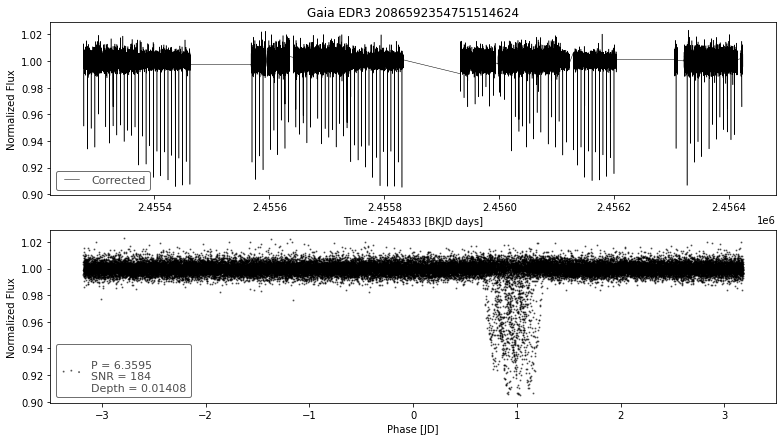

__________________________________________
index                                           1
designation         Gaia EDR3 2086592354758573568
BLS_period                               6.359473
BLS_period_SNR                         239.530135
BLS_duration                                0.399
BLS_depth                                 0.01277
BLS_transit_time                   2455277.454549
batch                                          63
Name: 6201, dtype: object
ra                         296.590021
ra_error                     0.106882
dec                         47.648133
dec_error                    0.105121
pmra                        -3.105424
pmdec                       -5.458909
parallax                     0.164015
parallax_error               0.112873
phot_g_n_obs               343.000000
phot_g_mean_flux           855.000117
phot_g_mean_flux_error       1.284049
phot_g_mean_mag             18.357450
phot_bp_n_obs               35.000000
phot_bp_mean_flux          429.902784

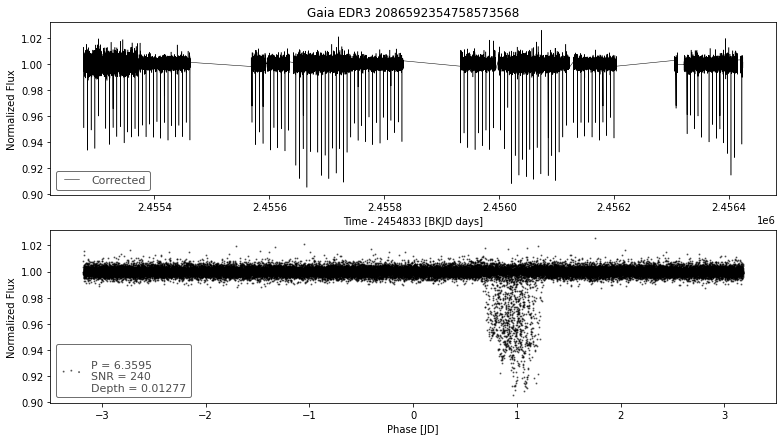

__________________________________________
index                                          80
designation         Gaia EDR3 2086516449796423936
BLS_period                               2.632309
BLS_period_SNR                         2526.14506
BLS_duration                                0.174
BLS_depth                                0.181552
BLS_transit_time                   2455276.777988
batch                                          63
Name: 6280, dtype: object
ra                          298.044553
ra_error                      0.079175
dec                          48.181582
dec_error                     0.085953
pmra                         -2.738687
pmdec                        -2.309139
parallax                      0.090182
parallax_error                0.092529
phot_g_n_obs                329.000000
phot_g_mean_flux           1318.559335
phot_g_mean_flux_error        2.331670
phot_g_mean_mag              17.887117
phot_bp_n_obs                38.000000
phot_bp_mean_flux       

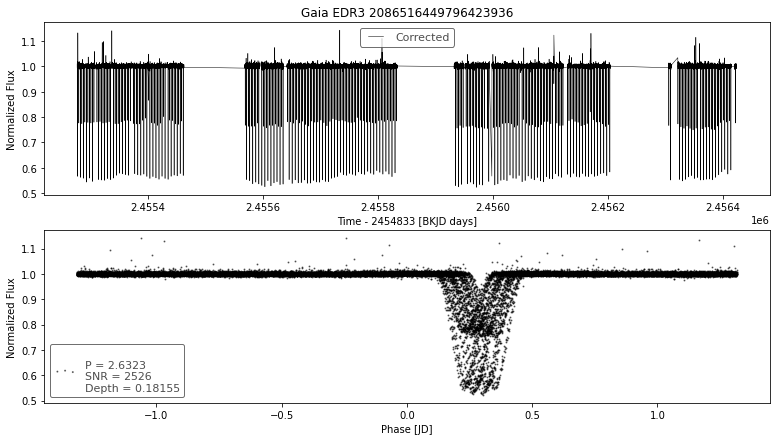

__________________________________________
index                                          84
designation         Gaia EDR3 2086516454092861184
BLS_period                               0.926855
BLS_period_SNR                         341.570122
BLS_duration                                 0.45
BLS_depth                                0.000157
BLS_transit_time                   2455276.990988
batch                                          63
Name: 6284, dtype: object
ra                            298.047091
ra_error                        0.010872
dec                            48.193165
dec_error                       0.011475
pmra                           -0.390569
pmdec                          -6.527844
parallax                        0.520581
parallax_error                  0.012227
phot_g_n_obs                  379.000000
phot_g_mean_flux           553191.588957
phot_g_mean_flux_error        123.578710
phot_g_mean_mag                11.330178
phot_bp_n_obs                  44.00000

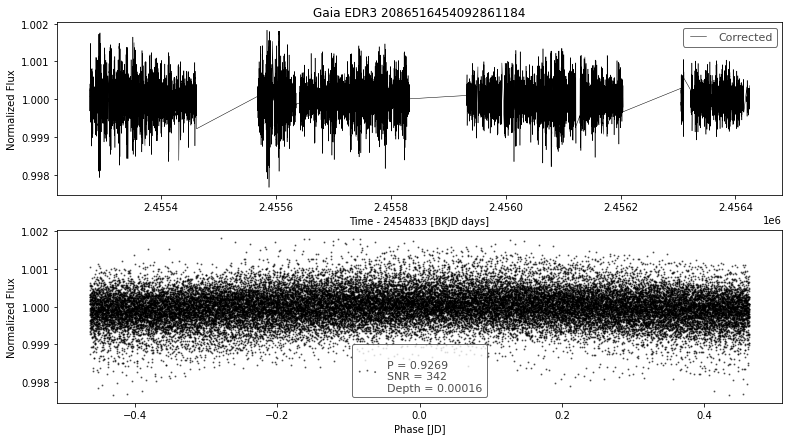

__________________________________________
index                                          85
designation         Gaia EDR3 2086516454096774656
BLS_period                               0.926855
BLS_period_SNR                          58.132919
BLS_duration                                 0.45
BLS_depth                                0.000153
BLS_transit_time                   2455277.005988
batch                                          63
Name: 6285, dtype: object
ra                         298.046144
ra_error                     0.300182
dec                         48.195093
dec_error                    0.374136
pmra                        -2.524984
pmdec                       -3.584467
parallax                     0.507586
parallax_error               0.379152
phot_g_n_obs               303.000000
phot_g_mean_flux           222.900287
phot_g_mean_flux_error       0.921336
phot_g_mean_mag             19.817091
phot_bp_n_obs               33.000000
phot_bp_mean_flux          198.419674

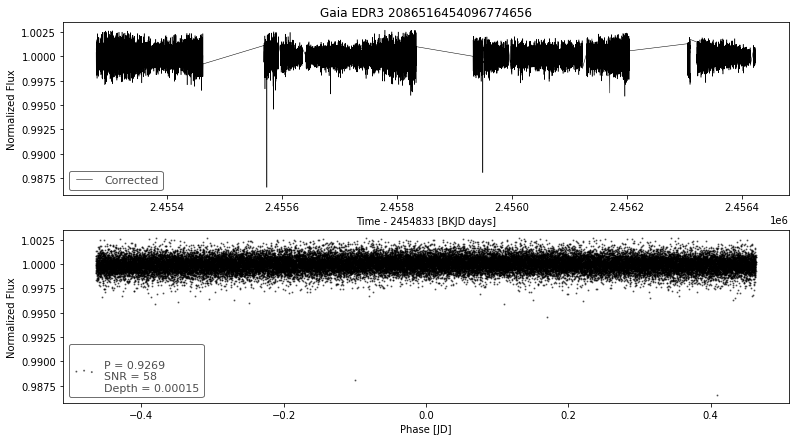

__________________________________________
index                                          87
designation         Gaia EDR3 2086516454099067776
BLS_period                               2.632309
BLS_period_SNR                          52.172494
BLS_duration                                0.126
BLS_depth                                0.001917
BLS_transit_time                   2455276.780988
batch                                          63
Name: 6287, dtype: object
ra                          298.047664
ra_error                      0.038504
dec                          48.179616
dec_error                     0.044943
pmra                         -2.403281
pmdec                        -3.767158
parallax                      0.211063
parallax_error                0.046050
phot_g_n_obs                369.000000
phot_g_mean_flux           3586.243255
phot_g_mean_flux_error        2.067790
phot_g_mean_mag              16.800768
phot_bp_n_obs                44.000000
phot_bp_mean_flux       

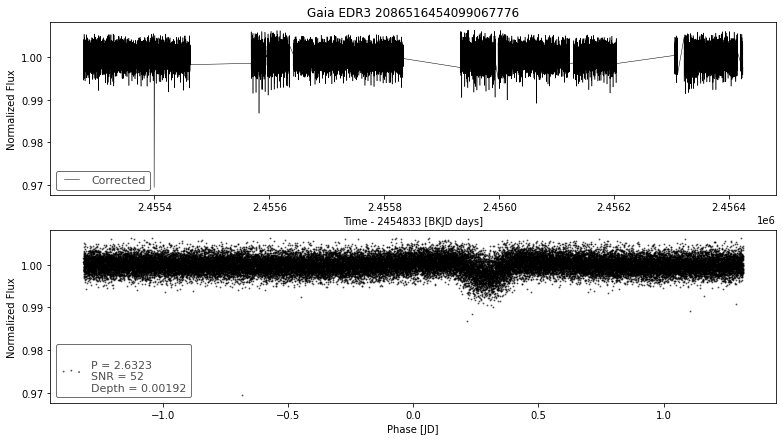

__________________________________________
index                                          88
designation         Gaia EDR3 2085661343283179520
BLS_period                               0.857307
BLS_period_SNR                           61.25231
BLS_duration                                 0.45
BLS_depth                                0.000307
BLS_transit_time                   2455276.903892
batch                                          64
Name: 6388, dtype: object
ra                         298.876526
ra_error                     0.104453
dec                         47.142032
dec_error                    0.117193
pmra                        -0.750193
pmdec                       -3.923691
parallax                     0.090888
parallax_error               0.125919
phot_g_n_obs               347.000000
phot_g_mean_flux           737.179675
phot_g_mean_flux_error       1.203062
phot_g_mean_mag             18.518433
phot_bp_n_obs               39.000000
phot_bp_mean_flux          393.410013

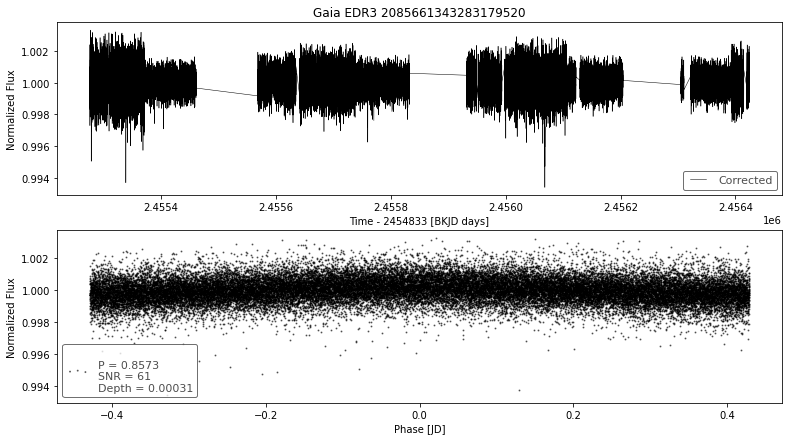

__________________________________________
index                                          92
designation         Gaia EDR3 2085661343290509056
BLS_period                               0.857307
BLS_period_SNR                         319.153956
BLS_duration                                 0.45
BLS_depth                                0.000342
BLS_transit_time                   2455276.900892
batch                                          64
Name: 6392, dtype: object
ra                            298.875661
ra_error                        0.009895
dec                            47.143581
dec_error                       0.010807
pmra                           -0.469737
pmdec                          -7.123973
parallax                        0.723649
parallax_error                  0.011441
phot_g_n_obs                  374.000000
phot_g_mean_flux           139876.449534
phot_g_mean_flux_error         27.109953
phot_g_mean_mag                12.823006
phot_bp_n_obs                  41.00000

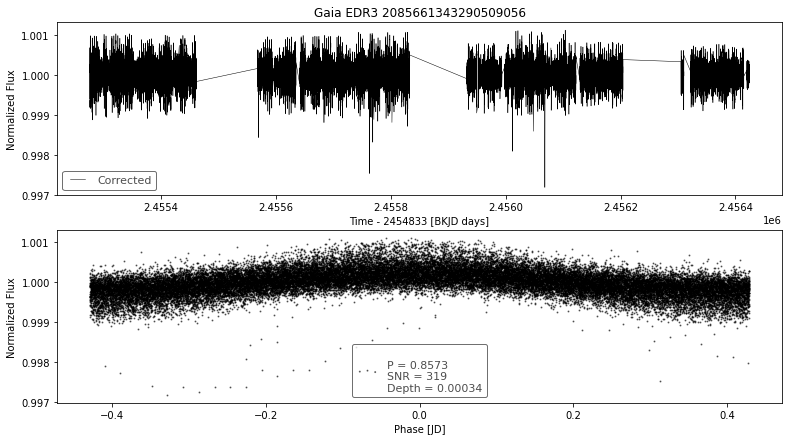

__________________________________________
index                                          61
designation         Gaia EDR3 2079018987390162688
BLS_period                               0.786611
BLS_period_SNR                          45.665254
BLS_duration                                 0.45
BLS_depth                                0.000225
BLS_transit_time                   2455276.960714
batch                                          65
Name: 6461, dtype: object
ra                           299.379882
ra_error                       0.016531
dec                           44.093093
dec_error                      0.017288
pmra                          -1.543957
pmdec                         -3.951352
parallax                       0.173110
parallax_error                 0.018578
phot_g_n_obs                 368.000000
phot_g_mean_flux           23268.564330
phot_g_mean_flux_error         7.348640
phot_g_mean_mag               14.770443
phot_bp_n_obs                 40.000000
phot_bp_mea

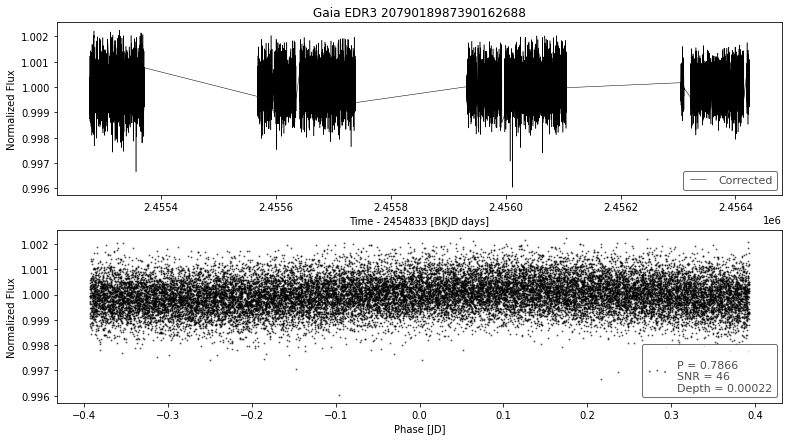

__________________________________________
index                                          78
designation         Gaia EDR3 2079019292324040704
BLS_period                                 0.6285
BLS_period_SNR                          84.823531
BLS_duration                                0.051
BLS_depth                                0.018494
BLS_transit_time                   2455276.743214
batch                                          65
Name: 6478, dtype: object
ra                         299.335102
ra_error                     0.255986
dec                         44.079733
dec_error                    0.256717
pmra                        -1.398736
pmdec                       -3.633687
parallax                     0.211034
parallax_error               0.286868
phot_g_n_obs               330.000000
phot_g_mean_flux           291.065218
phot_g_mean_flux_error       1.177062
phot_g_mean_mag             19.527391
phot_bp_n_obs               35.000000
phot_bp_mean_flux          131.930618

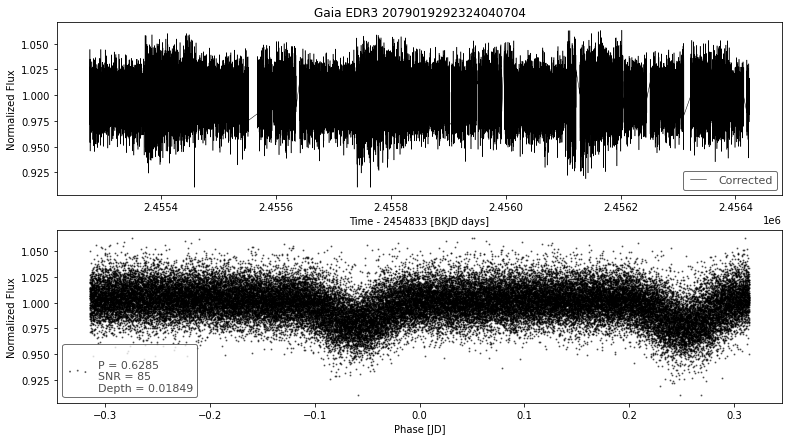

__________________________________________
index                                          79
designation         Gaia EDR3 2079019807723929088
BLS_period                               0.515566
BLS_period_SNR                          38.513417
BLS_duration                                 0.45
BLS_depth                                0.000035
BLS_transit_time                   2455276.795148
batch                                          66
Name: 6579, dtype: object
ra                          299.355641
ra_error                      0.039104
dec                          44.112566
dec_error                     0.041553
pmra                          2.686325
pmdec                        -3.121136
parallax                      0.571506
parallax_error                0.044792
phot_g_n_obs                364.000000
phot_g_mean_flux           3835.002358
phot_g_mean_flux_error        2.403667
phot_g_mean_mag              16.727953
phot_bp_n_obs                41.000000
phot_bp_mean_flux       

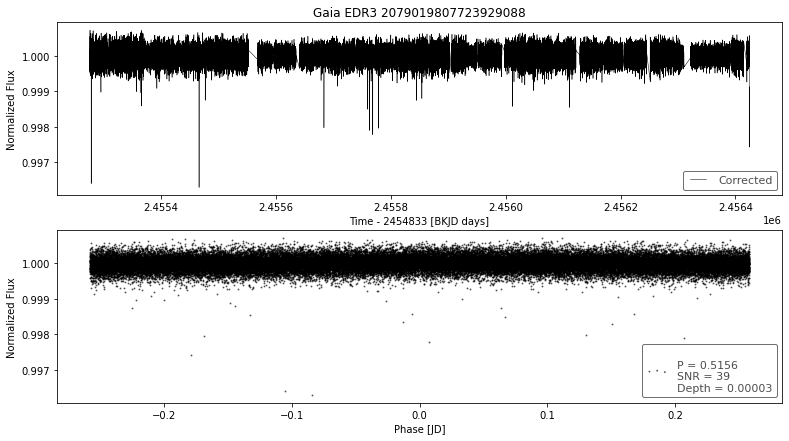

__________________________________________
index                                          84
designation         Gaia EDR3 2079019812023882880
BLS_period                               0.515566
BLS_period_SNR                          48.447873
BLS_duration                                 0.45
BLS_depth                                0.000031
BLS_transit_time                   2455276.786714
batch                                          66
Name: 6584, dtype: object
ra                            299.357652
ra_error                        0.010402
dec                            44.113763
dec_error                       0.010408
pmra                            4.714835
pmdec                          -5.016083
parallax                        1.233789
parallax_error                  0.011344
phot_g_n_obs                  373.000000
phot_g_mean_flux           476441.720923
phot_g_mean_flux_error         89.280090
phot_g_mean_mag                11.492342
phot_bp_n_obs                  42.00000

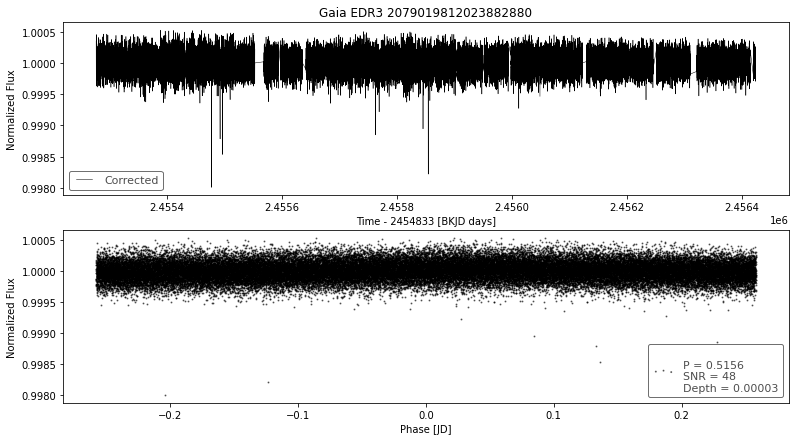

__________________________________________
index                                          20
designation         Gaia EDR3 2079398830002411648
BLS_period                               0.719691
BLS_period_SNR                          53.638132
BLS_duration                                 0.45
BLS_depth                                0.004512
BLS_transit_time                   2455276.837241
batch                                          67
Name: 6620, dtype: object
ra                         298.560962
ra_error                     0.143367
dec                         45.146545
dec_error                    0.141618
pmra                        -2.714520
pmdec                       -4.373180
parallax                     0.020243
parallax_error               0.162409
phot_g_n_obs               341.000000
phot_g_mean_flux           481.328096
phot_g_mean_flux_error       0.994502
phot_g_mean_mag             18.981264
phot_bp_n_obs               38.000000
phot_bp_mean_flux          187.063221

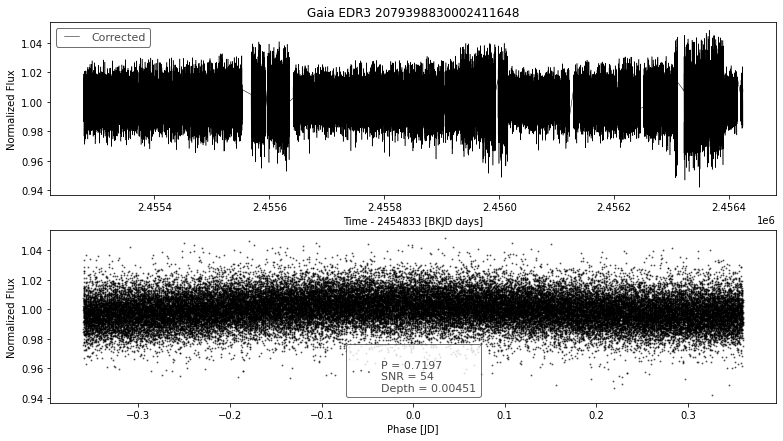

__________________________________________
index                                          32
designation         Gaia EDR3 2079398903014925440
BLS_period                               0.728873
BLS_period_SNR                          28.365849
BLS_duration                                 0.33
BLS_depth                                0.003402
BLS_transit_time                   2455277.083807
batch                                          67
Name: 6632, dtype: object
ra                         298.523768
ra_error                     0.229965
dec                         45.146853
dec_error                    0.248500
pmra                        -1.032897
pmdec                       -7.441999
parallax                     0.948007
parallax_error               0.274288
phot_g_n_obs               361.000000
phot_g_mean_flux           336.768322
phot_g_mean_flux_error       1.566763
phot_g_mean_mag             19.369040
phot_bp_n_obs               37.000000
phot_bp_mean_flux          120.093388

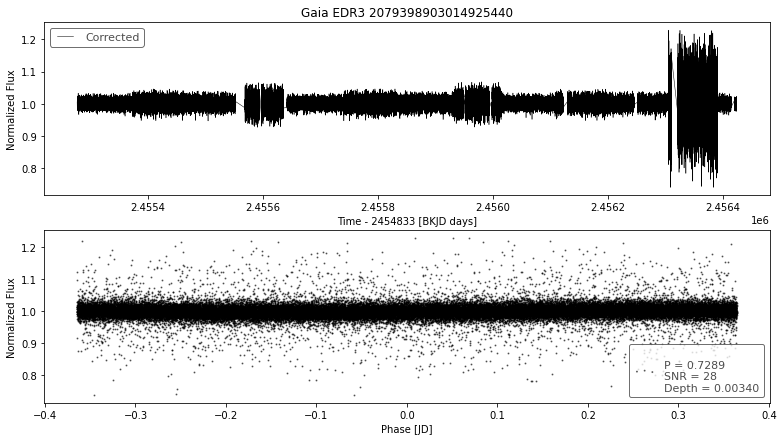

__________________________________________
index                                          46
designation         Gaia EDR3 2079399006085883008
BLS_period                              11.236515
BLS_period_SNR                          84.195991
BLS_duration                                0.099
BLS_depth                                0.013195
BLS_transit_time                   2455279.155307
batch                                          67
Name: 6646, dtype: object
ra                         2.985338e+02
ra_error                   3.963367e-01
dec                        4.514959e+01
dec_error                  2.780169e-01
pmra                      -9.836919e+00
pmdec                     -8.365289e+00
parallax                   1.200379e+00
parallax_error             3.744781e-01
phot_g_n_obs               2.930000e+02
phot_g_mean_flux           4.485363e+02
phot_g_mean_flux_error     1.948050e+00
phot_g_mean_mag            1.905787e+01
phot_bp_n_obs              0.000000e+00
phot_bp_mea

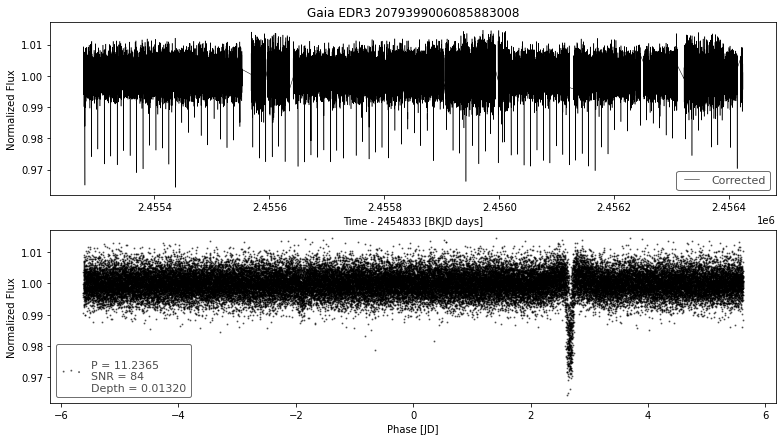

__________________________________________
index                                          49
designation         Gaia EDR3 2079399006094147840
BLS_period                              11.236515
BLS_period_SNR                          77.377268
BLS_duration                                0.099
BLS_depth                                0.010425
BLS_transit_time                   2455279.155307
batch                                          67
Name: 6649, dtype: object
ra                         298.533738
ra_error                     0.231009
dec                         45.149958
dec_error                    0.233908
pmra                        -2.382727
pmdec                       -4.556883
parallax                    -0.440488
parallax_error               0.258557
phot_g_n_obs               386.000000
phot_g_mean_flux           547.274802
phot_g_mean_flux_error       1.916271
phot_g_mean_mag             18.841854
phot_bp_n_obs               43.000000
phot_bp_mean_flux          325.167224

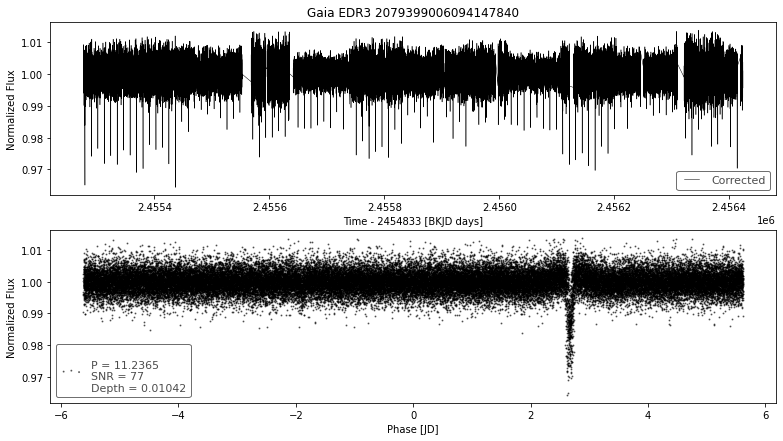

__________________________________________
index                                          63
designation         Gaia EDR3 2085219751933103360
BLS_period                               0.532857
BLS_period_SNR                          31.191508
BLS_duration                                 0.45
BLS_depth                                0.000045
BLS_transit_time                   2455276.792746
batch                                          68
Name: 6763, dtype: object
ra                            299.949022
ra_error                        0.008495
dec                            45.629822
dec_error                       0.009835
pmra                           -2.660955
pmdec                          -7.959546
parallax                        0.457021
parallax_error                  0.009838
phot_g_n_obs                  413.000000
phot_g_mean_flux           117864.420185
phot_g_mean_flux_error         22.254210
phot_g_mean_mag                13.008910
phot_bp_n_obs                  45.00000

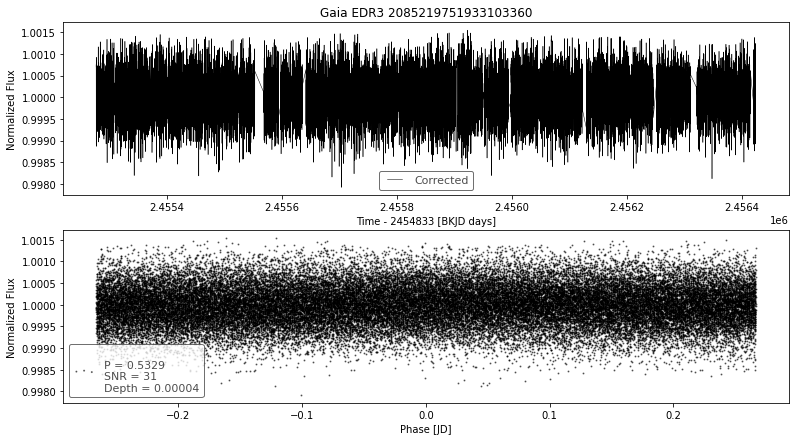

__________________________________________
index                                          37
designation         Gaia EDR3 2085220537906639872
BLS_period                               0.663265
BLS_period_SNR                          29.218872
BLS_duration                                 0.45
BLS_depth                                0.002105
BLS_transit_time                   2455276.828746
batch                                          69
Name: 6837, dtype: object
ra                         299.942411
ra_error                     0.110815
dec                         45.660446
dec_error                    0.130572
pmra                         4.818280
pmdec                       12.030782
parallax                     2.840611
parallax_error               0.132903
phot_g_n_obs               398.000000
phot_g_mean_flux           730.864040
phot_g_mean_flux_error       1.270133
phot_g_mean_mag             18.527775
phot_bp_n_obs               44.000000
phot_bp_mean_flux          108.699833

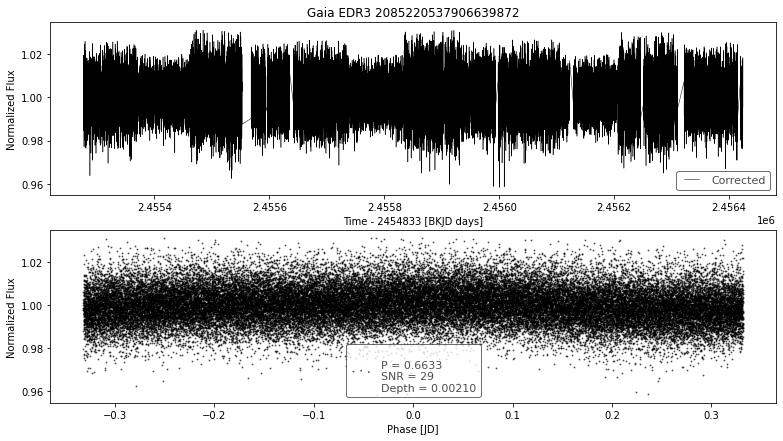

__________________________________________
index                                          75
designation         Gaia EDR3 2085197108865359360
BLS_period                               0.598112
BLS_period_SNR                          56.345121
BLS_duration                                 0.33
BLS_depth                                0.002029
BLS_transit_time                   2455276.663746
batch                                          69
Name: 6875, dtype: object
ra                          299.911600
ra_error                      0.084289
dec                          45.637694
dec_error                     0.092335
pmra                         -2.921600
pmdec                        -8.693344
parallax                      0.461956
parallax_error                0.096305
phot_g_n_obs                377.000000
phot_g_mean_flux           1200.082123
phot_g_mean_flux_error        1.883940
phot_g_mean_mag              17.989340
phot_bp_n_obs                40.000000
phot_bp_mean_flux       

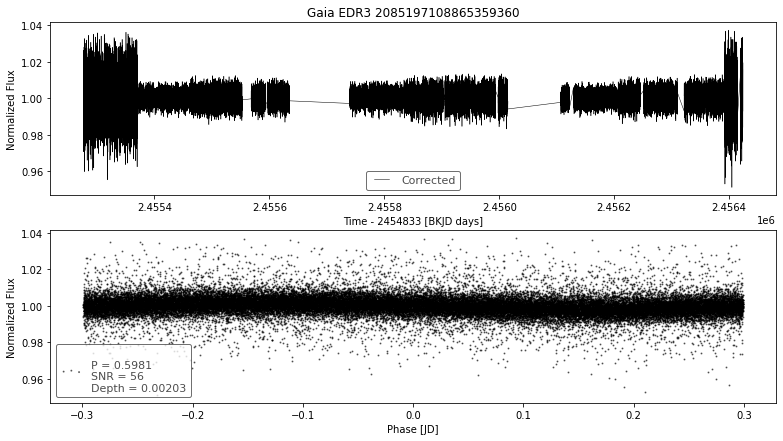

__________________________________________
index                                          93
designation         Gaia EDR3 2082090056500465536
BLS_period                               0.608856
BLS_period_SNR                           27.67195
BLS_duration                                0.399
BLS_depth                                0.001419
BLS_transit_time                   2455276.800152
batch                                          69
Name: 6893, dtype: object
ra                         300.693819
ra_error                     0.234400
dec                         44.559391
dec_error                    0.237022
pmra                        -1.813600
pmdec                       -2.814762
parallax                     0.146608
parallax_error               0.264806
phot_g_n_obs               312.000000
phot_g_mean_flux           344.606433
phot_g_mean_flux_error       0.958657
phot_g_mean_mag             19.344059
phot_bp_n_obs               33.000000
phot_bp_mean_flux          136.983411

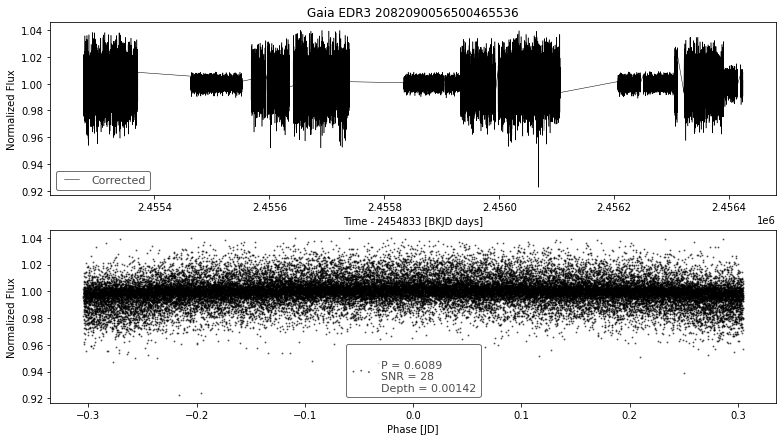

__________________________________________
index                                          68
designation         Gaia EDR3 2082091568328182528
BLS_period                               0.701906
BLS_period_SNR                          201.14987
BLS_duration                                0.051
BLS_depth                                0.024865
BLS_transit_time                   2455276.740152
batch                                          70
Name: 6968, dtype: object
ra                         300.706337
ra_error                     0.536262
dec                         44.588175
dec_error                    0.536333
pmra                        -1.007749
pmdec                       -4.137242
parallax                     1.010692
parallax_error               0.605260
phot_g_n_obs               358.000000
phot_g_mean_flux           721.000781
phot_g_mean_flux_error       5.391713
phot_g_mean_mag             18.542528
phot_bp_n_obs               42.000000
phot_bp_mean_flux          342.239988

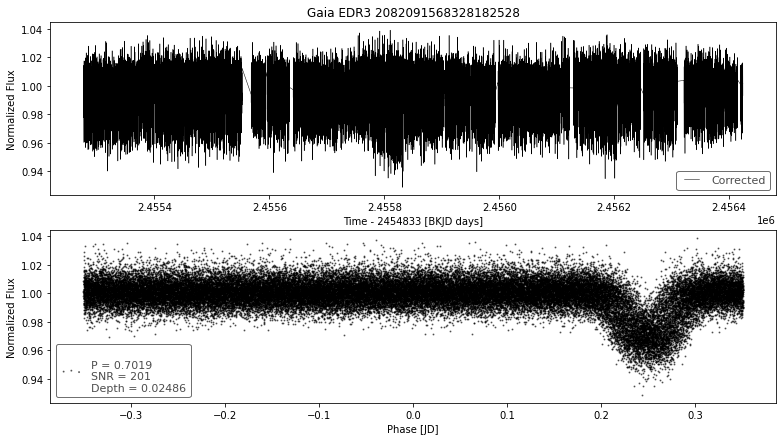

__________________________________________
index                                          15
designation         Gaia EDR3 2082093084451831296
BLS_period                               0.500098
BLS_period_SNR                         152.798602
BLS_duration                                 0.45
BLS_depth                                0.000572
BLS_transit_time                   2455276.729652
batch                                          71
Name: 7015, dtype: object
ra                         300.652212
ra_error                     0.252553
dec                         44.587094
dec_error                    0.245050
pmra                        -2.437265
pmdec                       -6.981744
parallax                     0.592690
parallax_error               0.282505
phot_g_n_obs               293.000000
phot_g_mean_flux           330.031164
phot_g_mean_flux_error       1.076875
phot_g_mean_mag             19.390980
phot_bp_n_obs               30.000000
phot_bp_mean_flux          172.164447

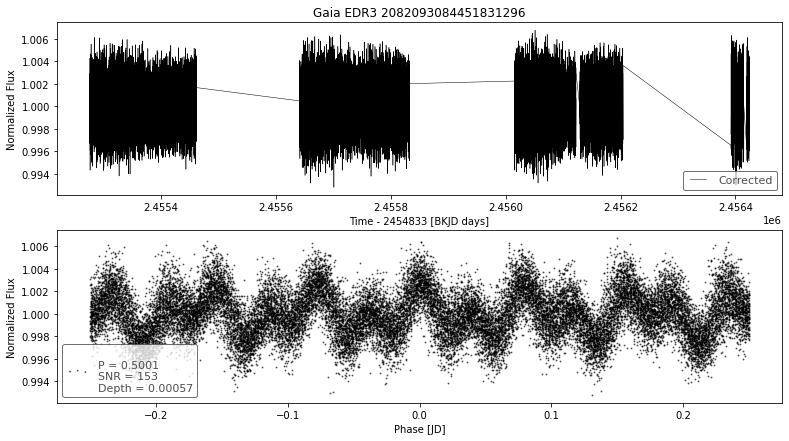

__________________________________________
index                                          16
designation         Gaia EDR3 2082093084451836672
BLS_period                               0.500098
BLS_period_SNR                         182.110816
BLS_duration                                 0.45
BLS_depth                                0.000341
BLS_transit_time                   2455276.753652
batch                                          71
Name: 7016, dtype: object
ra                           300.653004
ra_error                       0.061514
dec                           44.588119
dec_error                      0.065605
pmra                          -0.235085
pmdec                         -3.564849
parallax                       0.907278
parallax_error                 0.070094
phot_g_n_obs                 402.000000
phot_g_mean_flux           79312.529063
phot_g_mean_flux_error        44.755436
phot_g_mean_mag               13.439013
phot_bp_n_obs                 18.000000
phot_bp_mea

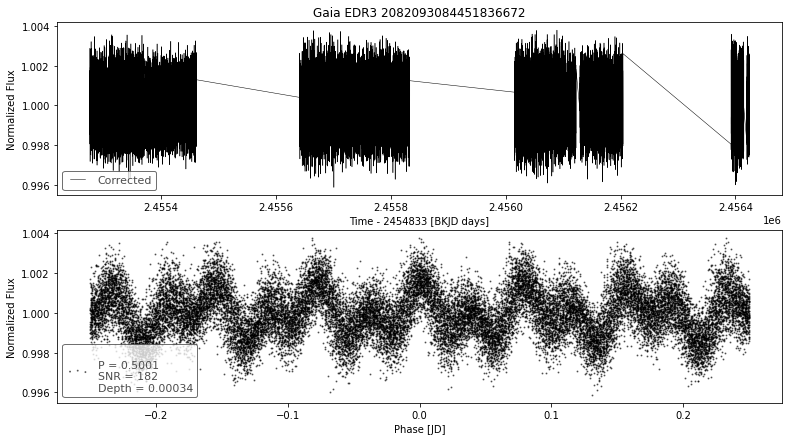

__________________________________________
index                                          17
designation         Gaia EDR3 2082093084461923328
BLS_period                               0.500098
BLS_period_SNR                         180.292005
BLS_duration                                 0.45
BLS_depth                                0.000336
BLS_transit_time                   2455276.753652
batch                                          71
Name: 7017, dtype: object
ra                            300.653054
ra_error                        0.009019
dec                            44.588811
dec_error                       0.009152
pmra                           -0.248913
pmdec                          -3.515599
parallax                        0.483296
parallax_error                  0.010030
phot_g_n_obs                  386.000000
phot_g_mean_flux           107033.665955
phot_g_mean_flux_error         17.483944
phot_g_mean_mag                13.113565
phot_bp_n_obs                  36.00000

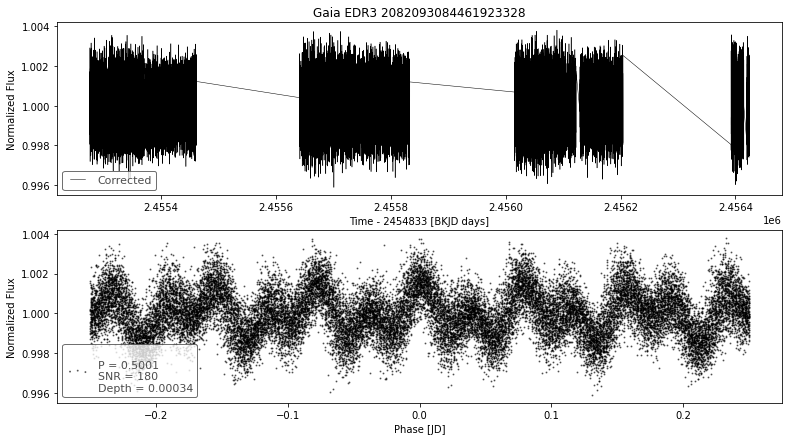

__________________________________________
index                                          20
designation         Gaia EDR3 2082093153171303040
BLS_period                               0.500197
BLS_period_SNR                          52.786693
BLS_duration                                 0.45
BLS_depth                                0.000614
BLS_transit_time                   2455276.732652
batch                                          71
Name: 7020, dtype: object
ra                         300.650182
ra_error                     0.106959
dec                         44.587182
dec_error                    0.113470
pmra                        -2.541626
pmdec                       -3.201920
parallax                    -0.126855
parallax_error               0.118237
phot_g_n_obs               341.000000
phot_g_mean_flux           772.595335
phot_g_mean_flux_error       1.122536
phot_g_mean_mag             18.467487
phot_bp_n_obs               41.000000
phot_bp_mean_flux          287.585176

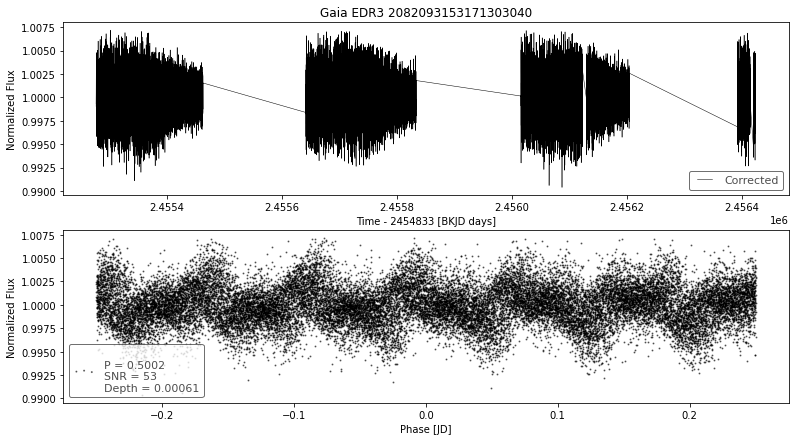

__________________________________________
index                                          99
designation         Gaia EDR3 2052524429346526464
BLS_period                               0.969631
BLS_period_SNR                         149.263857
BLS_duration                                0.099
BLS_depth                                0.094486
BLS_transit_time                   2455373.414513
batch                                          71
Name: 7099, dtype: object
ra                         291.273429
ra_error                     0.169152
dec                         37.388683
dec_error                    0.204361
pmra                        -3.097881
pmdec                       -3.532390
parallax                     0.311712
parallax_error               0.227979
phot_g_n_obs               357.000000
phot_g_mean_flux           398.478517
phot_g_mean_flux_error       1.516204
phot_g_mean_mag             19.186354
phot_bp_n_obs               38.000000
phot_bp_mean_flux          175.956391

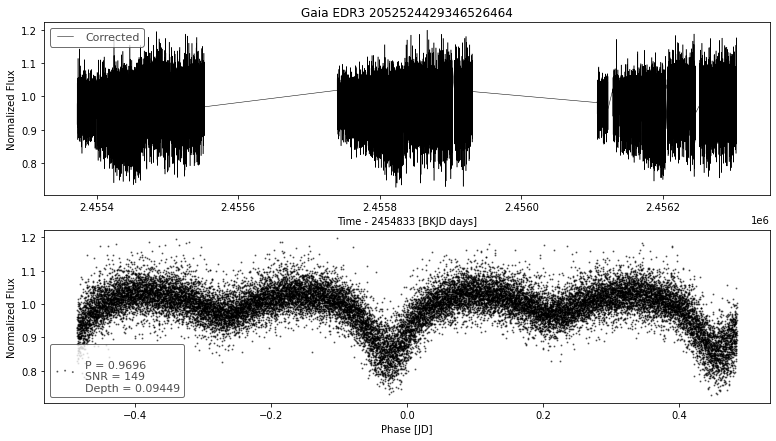

__________________________________________
index                                          25
designation         Gaia EDR3 2076836727386435072
BLS_period                               3.554231
BLS_period_SNR                         571.112082
BLS_duration                                0.201
BLS_depth                                  0.0349
BLS_transit_time                   2455375.876966
batch                                          72
Name: 7125, dtype: object
ra                          296.888942
ra_error                      0.064862
dec                          41.223229
dec_error                     0.075042
pmra                         -3.215282
pmdec                        -5.794213
parallax                      0.313638
parallax_error                0.081175
phot_g_n_obs                402.000000
phot_g_mean_flux           1300.020099
phot_g_mean_flux_error        1.544260
phot_g_mean_mag              17.902493
phot_bp_n_obs                43.000000
phot_bp_mean_flux       

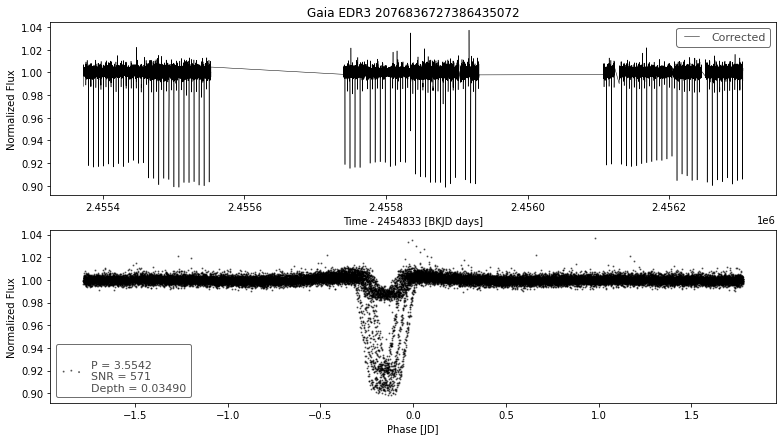

__________________________________________
index                                          26
designation         Gaia EDR3 2076836727386435200
BLS_period                               3.554231
BLS_period_SNR                         138.881106
BLS_duration                                0.201
BLS_depth                                  0.0165
BLS_transit_time                   2455375.873966
batch                                          72
Name: 7126, dtype: object
ra                         296.889082
ra_error                     0.119844
dec                         41.224726
dec_error                    0.152248
pmra                        -2.772403
pmdec                       -7.909413
parallax                    -0.071014
parallax_error               0.157443
phot_g_n_obs               396.000000
phot_g_mean_flux           546.572192
phot_g_mean_flux_error       0.942910
phot_g_mean_mag             18.843248
phot_bp_n_obs               42.000000
phot_bp_mean_flux          239.378774

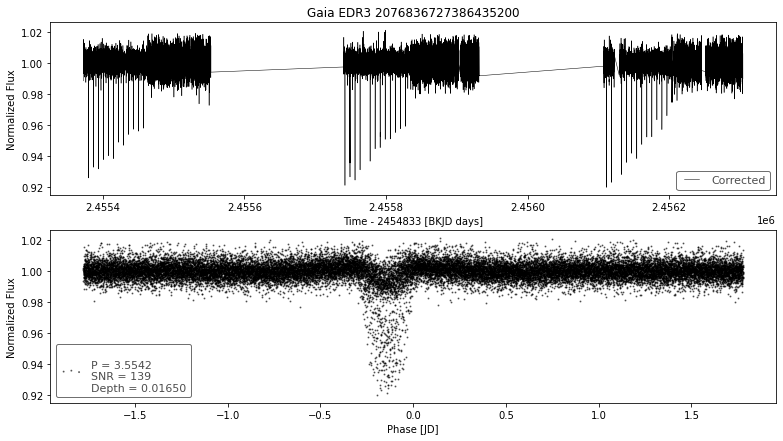

__________________________________________
index                                          27
designation         Gaia EDR3 2076836727387736576
BLS_period                               3.554231
BLS_period_SNR                         414.532266
BLS_duration                                0.201
BLS_depth                                0.028139
BLS_transit_time                   2455375.873966
batch                                          72
Name: 7127, dtype: object
ra                         296.890013
ra_error                     0.117698
dec                         41.223384
dec_error                    0.146366
pmra                        -1.623022
pmdec                       -6.272839
parallax                     0.172361
parallax_error               0.151392
phot_g_n_obs               387.000000
phot_g_mean_flux           554.830234
phot_g_mean_flux_error       0.976194
phot_g_mean_mag             18.826967
phot_bp_n_obs               14.000000
phot_bp_mean_flux          225.302931

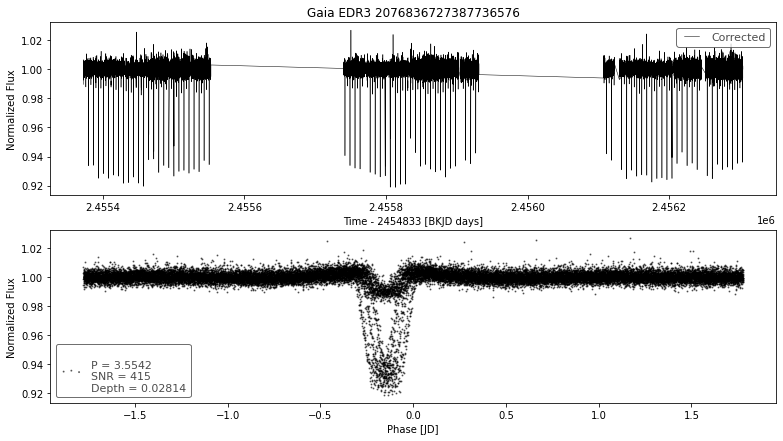

__________________________________________
index                                          62
designation         Gaia EDR3 2075408053772675840
BLS_period                               0.587401
BLS_period_SNR                          50.082977
BLS_duration                                0.399
BLS_depth                                0.000066
BLS_transit_time                   2455372.669861
batch                                          72
Name: 7162, dtype: object
ra                            298.284065
ra_error                        0.008422
dec                            41.795565
dec_error                       0.009734
pmra                           -0.030970
pmdec                          -4.265546
parallax                        0.341244
parallax_error                  0.010326
phot_g_n_obs                  396.000000
phot_g_mean_flux           116325.234817
phot_g_mean_flux_error         20.050468
phot_g_mean_mag                13.023182
phot_bp_n_obs                  44.00000

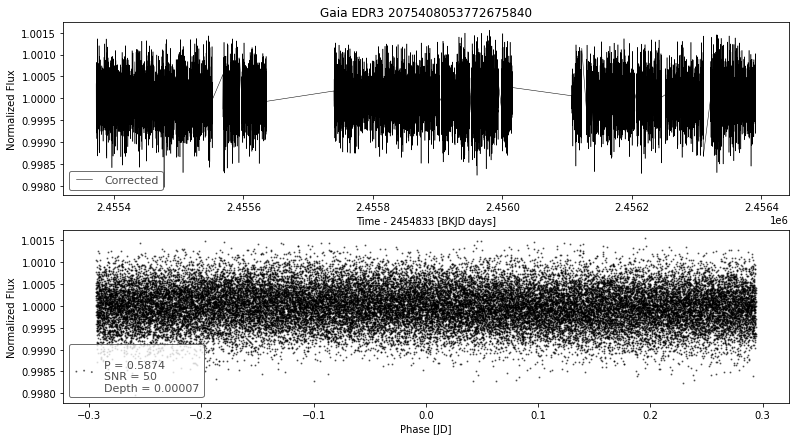

__________________________________________
index                                          69
designation         Gaia EDR3 2073608393758502016
BLS_period                               0.519835
BLS_period_SNR                         426.737201
BLS_duration                                 0.45
BLS_depth                                0.002304
BLS_transit_time                   2455372.776413
batch                                          72
Name: 7169, dtype: object
ra                          298.981815
ra_error                      0.106594
dec                          40.790050
dec_error                     0.119205
pmra                         -2.606087
pmdec                        -2.979699
parallax                      0.978959
parallax_error                0.140281
phot_g_n_obs                274.000000
phot_g_mean_flux            964.355586
phot_g_mean_flux_error        1.835308
phot_g_mean_mag              18.226774
phot_bp_n_obs                 4.000000
phot_bp_mean_flux       

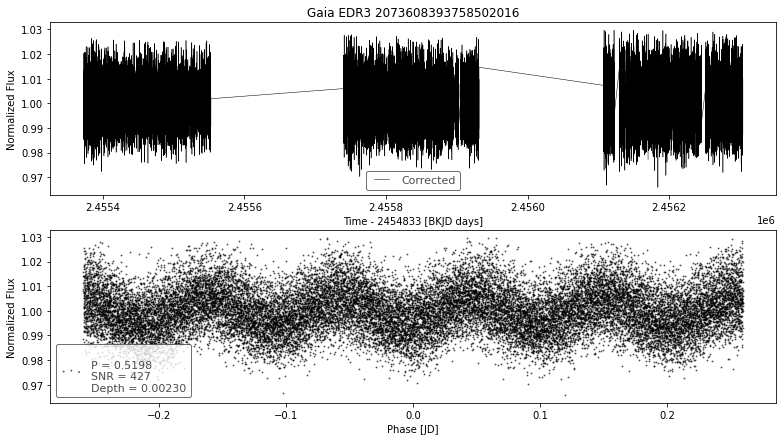

__________________________________________
index                                          73
designation         Gaia EDR3 2073608393764122240
BLS_period                               0.540561
BLS_period_SNR                         320.885828
BLS_duration                                 0.45
BLS_depth                                0.000764
BLS_transit_time                   2455372.815413
batch                                          72
Name: 7173, dtype: object
ra                           298.982380
ra_error                       0.015249
dec                           40.789643
dec_error                      0.017518
pmra                          -2.525193
pmdec                         -4.150618
parallax                       0.198284
parallax_error                 0.018970
phot_g_n_obs                 339.000000
phot_g_mean_flux           25004.558346
phot_g_mean_flux_error        17.753294
phot_g_mean_mag               14.692319
phot_bp_n_obs                 39.000000
phot_bp_mea

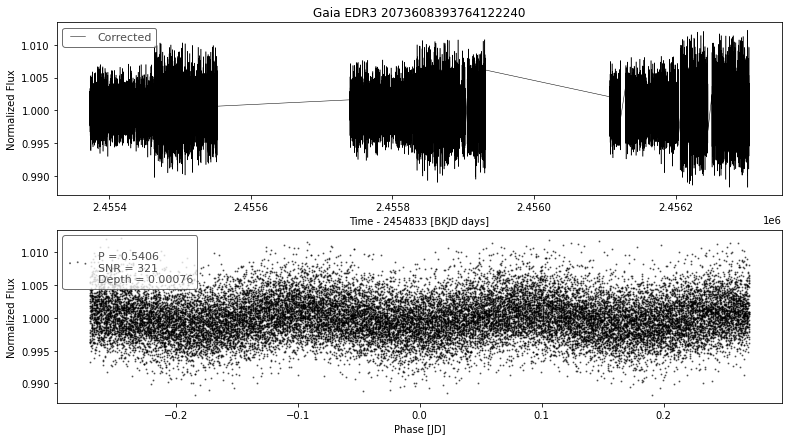

__________________________________________
index                                          20
designation         Gaia EDR3 2073685806243822720
BLS_period                               0.639489
BLS_period_SNR                          13.729032
BLS_duration                                 0.45
BLS_depth                                0.000044
BLS_transit_time                   2455372.902519
batch                                          73
Name: 7220, dtype: object
ra                           297.576133
ra_error                       0.013729
dec                           40.267700
dec_error                      0.014419
pmra                          -1.308729
pmdec                         -4.579023
parallax                       0.225115
parallax_error                 0.016478
phot_g_n_obs                 399.000000
phot_g_mean_flux           27730.890817
phot_g_mean_flux_error         7.541220
phot_g_mean_mag               14.579957
phot_bp_n_obs                 46.000000
phot_bp_mea

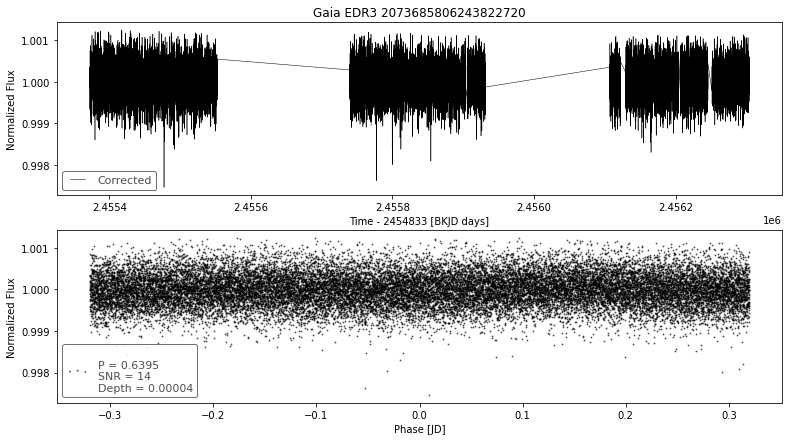

__________________________________________
index                                           9
designation         Gaia EDR3 2077810555389602176
BLS_period                                 0.6048
BLS_period_SNR                          219.36654
BLS_duration                                0.399
BLS_depth                                 0.02754
BLS_transit_time                    2455372.75396
batch                                          74
Name: 7309, dtype: object
ra                         293.024384
ra_error                     0.117731
dec                         42.863203
dec_error                    0.130901
pmra                        -5.791079
pmdec                       -4.659041
parallax                    -0.225306
parallax_error               0.145675
phot_g_n_obs               303.000000
phot_g_mean_flux           771.342625
phot_g_mean_flux_error       2.502257
phot_g_mean_mag             18.469248
phot_bp_n_obs               33.000000
phot_bp_mean_flux          356.115700

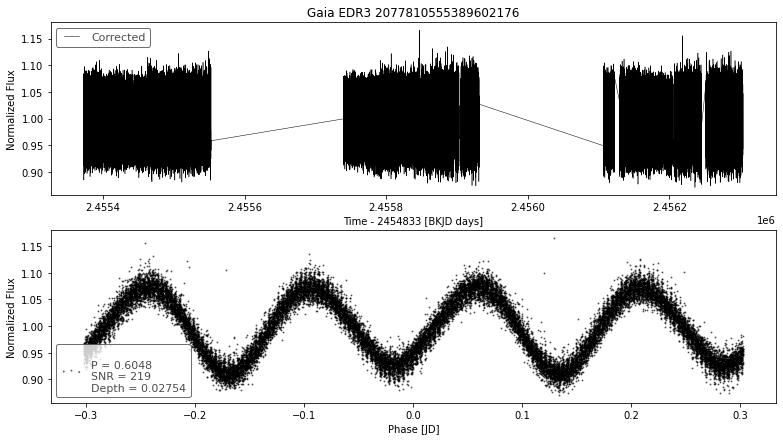

__________________________________________
index                                          37
designation         Gaia EDR3 2053613190676007424
BLS_period                                0.90572
BLS_period_SNR                           73.30815
BLS_duration                                 0.45
BLS_depth                                0.011327
BLS_transit_time                    2455373.17862
batch                                          74
Name: 7337, dtype: object
ra                         292.466507
ra_error                     0.208758
dec                         41.270080
dec_error                    0.266116
pmra                        -2.346113
pmdec                        1.935036
parallax                     2.711320
parallax_error               0.264483
phot_g_n_obs               355.000000
phot_g_mean_flux           294.841762
phot_g_mean_flux_error       0.916148
phot_g_mean_mag             19.513395
phot_bp_n_obs               33.000000
phot_bp_mean_flux           48.500246

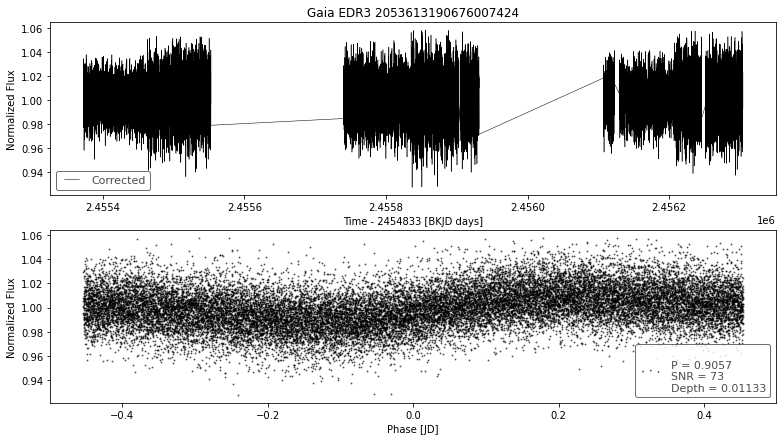

__________________________________________
index                                          93
designation         Gaia EDR3 2104125540830031872
BLS_period                               0.594267
BLS_period_SNR                           96.51761
BLS_duration                                 0.45
BLS_depth                                0.000055
BLS_transit_time                   2455372.812814
batch                                          75
Name: 7493, dtype: object
ra                            284.370644
ra_error                        0.010634
dec                            41.987750
dec_error                       0.011748
pmra                           10.527435
pmdec                           4.157587
parallax                        0.609070
parallax_error                  0.012243
phot_g_n_obs                  363.000000
phot_g_mean_flux           478046.857854
phot_g_mean_flux_error         70.479004
phot_g_mean_mag                11.488690
phot_bp_n_obs                  46.00000

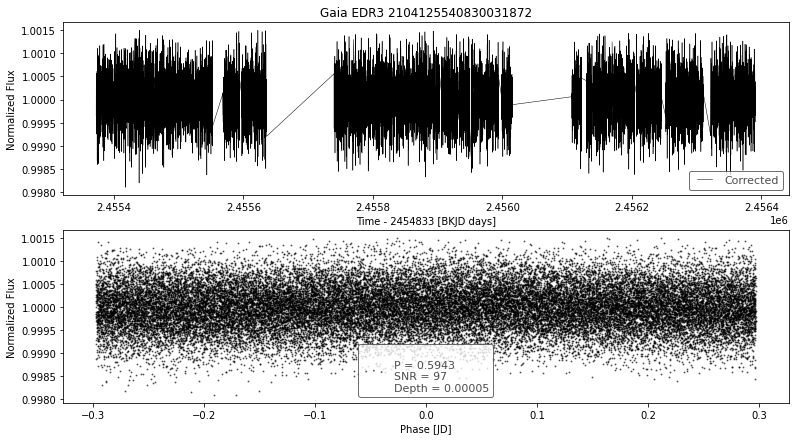

__________________________________________
index                                          94
designation         Gaia EDR3 2104125545128307072
BLS_period                               0.594267
BLS_period_SNR                          54.734494
BLS_duration                                 0.45
BLS_depth                                0.000069
BLS_transit_time                   2455372.794814
batch                                          75
Name: 7494, dtype: object
ra                         284.371352
ra_error                     0.162753
dec                         41.986557
dec_error                    0.176953
pmra                        -2.595575
pmdec                       -2.974250
parallax                    -0.312242
parallax_error               0.185761
phot_g_n_obs               345.000000
phot_g_mean_flux           454.661934
phot_g_mean_flux_error       1.486811
phot_g_mean_mag             19.043146
phot_bp_n_obs               26.000000
phot_bp_mean_flux          602.888361

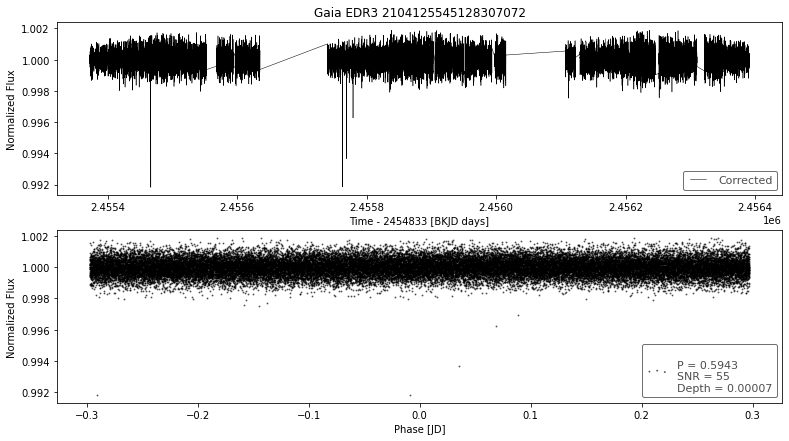

__________________________________________
index                                          38
designation         Gaia EDR3 2103827298302304128
BLS_period                               0.533752
BLS_period_SNR                         105.624281
BLS_duration                                 0.45
BLS_depth                                0.011014
BLS_transit_time                   2455372.746877
batch                                          76
Name: 7538, dtype: object
ra                         285.371971
ra_error                     0.126048
dec                         41.071075
dec_error                    0.138217
pmra                         1.179208
pmdec                       -1.582498
parallax                     3.195938
parallax_error               0.144633
phot_g_n_obs               418.000000
phot_g_mean_flux           606.697553
phot_g_mean_flux_error       1.245174
phot_g_mean_mag             18.729937
phot_bp_n_obs               38.000000
phot_bp_mean_flux           65.685934

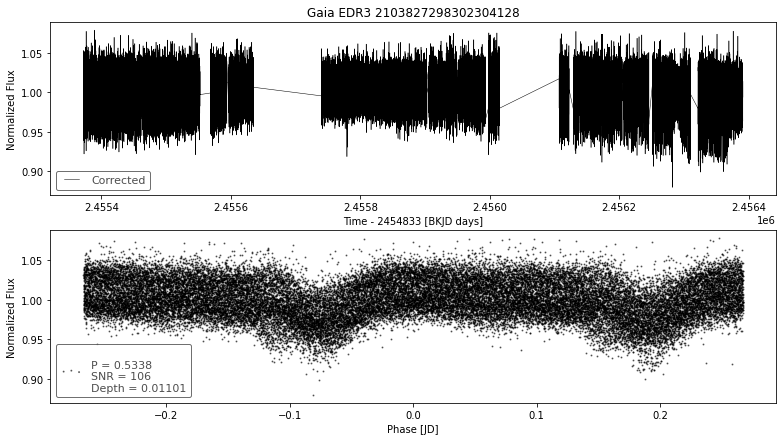

__________________________________________
index                                          32
designation         Gaia EDR3 2104466221934886784
BLS_period                              24.743875
BLS_period_SNR                           66.23504
BLS_duration                                 0.03
BLS_depth                                0.005264
BLS_transit_time                   2455382.259905
batch                                          77
Name: 7632, dtype: object
ra                           283.223596
ra_error                       0.013854
dec                           41.317849
dec_error                      0.015348
pmra                          -5.242005
pmdec                          9.847298
parallax                       0.938756
parallax_error                 0.016203
phot_g_n_obs                 396.000000
phot_g_mean_flux           23939.230545
phot_g_mean_flux_error         4.854199
phot_g_mean_mag               14.739592
phot_bp_n_obs                 45.000000
phot_bp_mea

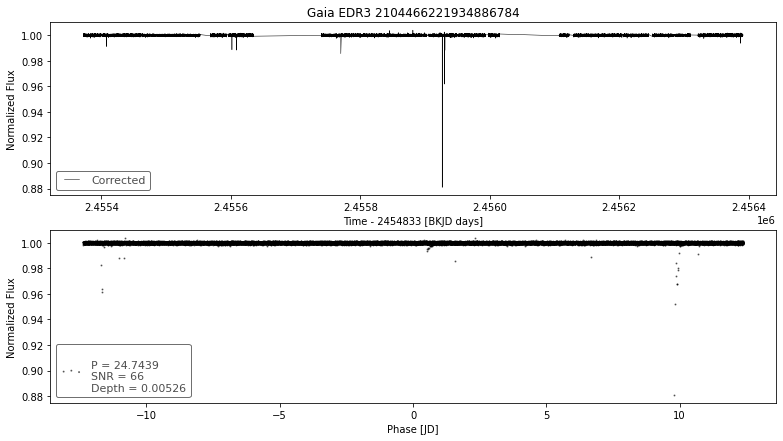

__________________________________________
index                                          52
designation         Gaia EDR3 2104467527604953216
BLS_period                                   30.0
BLS_period_SNR                         202.338974
BLS_duration                                0.126
BLS_depth                                0.051825
BLS_transit_time                   2455386.687905
batch                                          77
Name: 7652, dtype: object
ra                          283.266611
ra_error                      0.041736
dec                          41.339651
dec_error                     0.046410
pmra                          0.588530
pmdec                        -3.541538
parallax                      0.256425
parallax_error                0.049484
phot_g_n_obs                385.000000
phot_g_mean_flux           3163.011907
phot_g_mean_flux_error        2.016751
phot_g_mean_mag              16.937115
phot_bp_n_obs                39.000000
phot_bp_mean_flux       

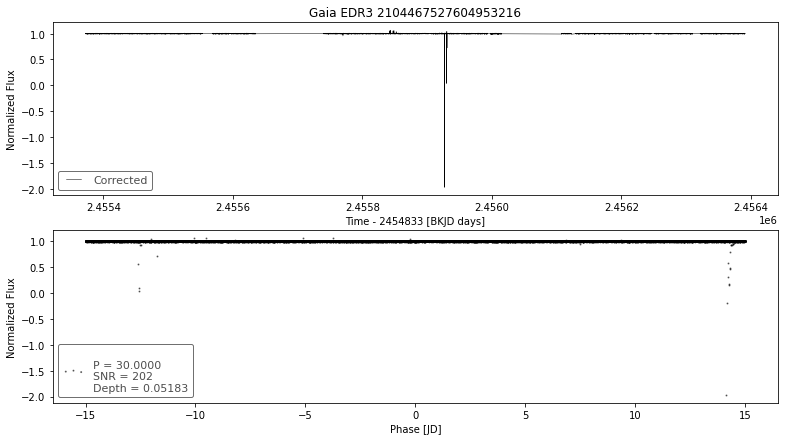

__________________________________________
index                                          53
designation         Gaia EDR3 2104467557667978752
BLS_period                                   30.0
BLS_period_SNR                         202.959311
BLS_duration                                0.126
BLS_depth                                0.192744
BLS_transit_time                   2455386.687905
batch                                          77
Name: 7653, dtype: object
ra                         283.271350
ra_error                     0.211685
dec                         41.343253
dec_error                    0.224580
pmra                       -10.261521
pmdec                       -3.700554
parallax                    -0.468255
parallax_error               0.247771
phot_g_n_obs               377.000000
phot_g_mean_flux           763.754353
phot_g_mean_flux_error       2.527585
phot_g_mean_mag             18.479982
phot_bp_n_obs               42.000000
phot_bp_mean_flux          400.121610

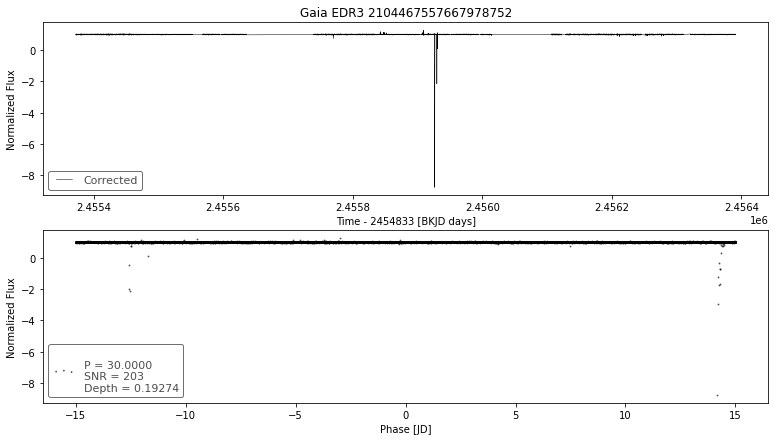

__________________________________________
index                                          64
designation         Gaia EDR3 2126183255912226688
BLS_period                               0.506273
BLS_period_SNR                          22.937513
BLS_duration                                 0.45
BLS_depth                                 0.01265
BLS_transit_time                   2455372.782387
batch                                          78
Name: 7764, dtype: object
ra                         291.736432
ra_error                     0.282671
dec                         44.278746
dec_error                    0.350033
pmra                        -0.876103
pmdec                        3.916670
parallax                     2.502501
parallax_error               0.340115
phot_g_n_obs               366.000000
phot_g_mean_flux           198.949368
phot_g_mean_flux_error       0.773540
phot_g_mean_mag             19.940510
phot_bp_n_obs               31.000000
phot_bp_mean_flux           45.512891

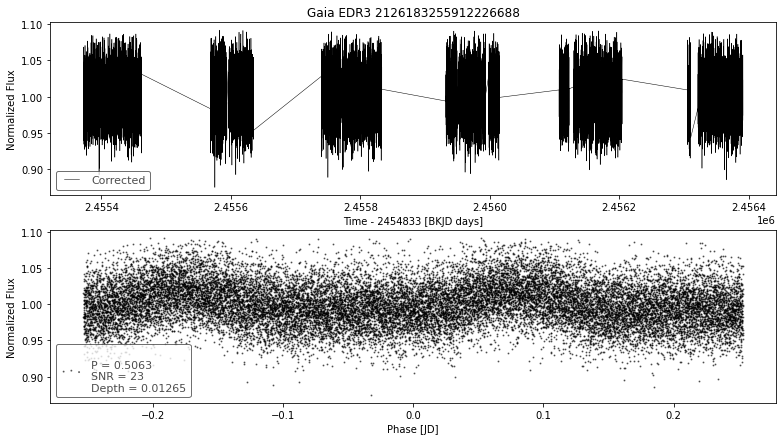

__________________________________________
index                                          78
designation         Gaia EDR3 2126183324633918976
BLS_period                               0.780333
BLS_period_SNR                           26.40977
BLS_duration                                 0.45
BLS_depth                                0.000614
BLS_transit_time                   2455372.716387
batch                                          78
Name: 7778, dtype: object
ra                          291.721735
ra_error                      0.077137
dec                          44.284350
dec_error                     0.092026
pmra                         -1.992363
pmdec                        -8.243196
parallax                      0.479576
parallax_error                0.091297
phot_g_n_obs                379.000000
phot_g_mean_flux           1104.922426
phot_g_mean_flux_error        1.405863
phot_g_mean_mag              18.079037
phot_bp_n_obs                40.000000
phot_bp_mean_flux       

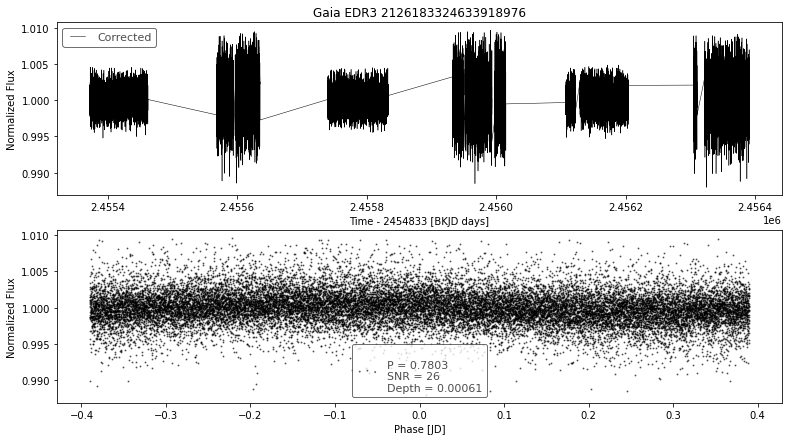

__________________________________________
index                                           2
designation         Gaia EDR3 2126183530792428288
BLS_period                               0.608346
BLS_period_SNR                          21.604486
BLS_duration                                 0.45
BLS_depth                                 0.00137
BLS_transit_time                   2455372.854387
batch                                          79
Name: 7802, dtype: object
ra                          291.794417
ra_error                      0.082530
dec                          44.305509
dec_error                     0.104572
pmra                         -2.145175
pmdec                        -4.516876
parallax                      0.236430
parallax_error                0.093856
phot_g_n_obs                365.000000
phot_g_mean_flux           1076.992154
phot_g_mean_flux_error        1.253976
phot_g_mean_mag              18.106836
phot_bp_n_obs                40.000000
phot_bp_mean_flux       

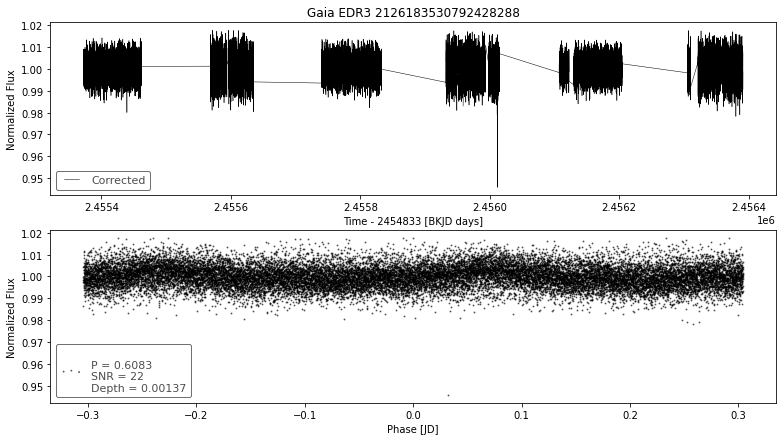

__________________________________________
index                                          69
designation         Gaia EDR3 2126083788772171648
BLS_period                               0.608346
BLS_period_SNR                            48.4847
BLS_duration                                 0.45
BLS_depth                                0.000211
BLS_transit_time                   2455372.695481
batch                                          79
Name: 7869, dtype: object
ra                           290.454976
ra_error                       0.016310
dec                           43.680582
dec_error                      0.015712
pmra                          -6.839389
pmdec                         -6.761601
parallax                       0.620999
parallax_error                 0.017637
phot_g_n_obs                 335.000000
phot_g_mean_flux           25200.313285
phot_g_mean_flux_error         5.262181
phot_g_mean_mag               14.683852
phot_bp_n_obs                 34.000000
phot_bp_mea

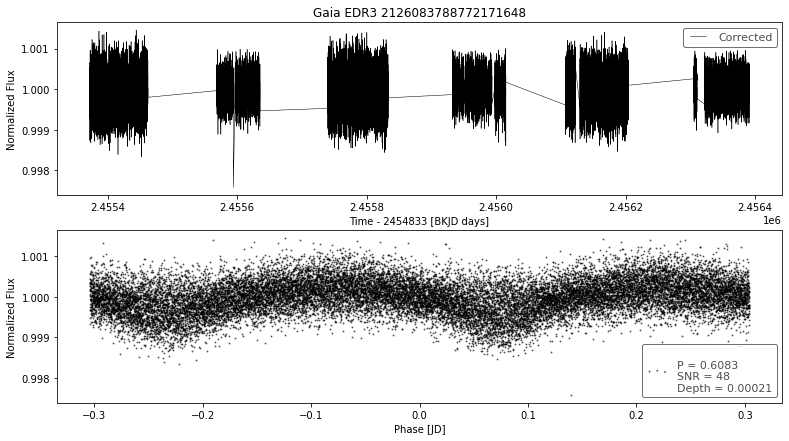

__________________________________________
index                                          74
designation         Gaia EDR3 2126083823131910656
BLS_period                               0.645989
BLS_period_SNR                          20.836518
BLS_duration                                 0.45
BLS_depth                                0.000969
BLS_transit_time                   2455372.761481
batch                                          79
Name: 7874, dtype: object
ra                          290.456717
ra_error                      0.144239
dec                          43.684459
dec_error                     0.129283
pmra                          1.370062
pmdec                        -3.974653
parallax                      0.418415
parallax_error                0.152782
phot_g_n_obs                314.000000
phot_g_mean_flux           1050.268310
phot_g_mean_flux_error        2.489969
phot_g_mean_mag              18.134117
phot_bp_n_obs                32.000000
phot_bp_mean_flux       

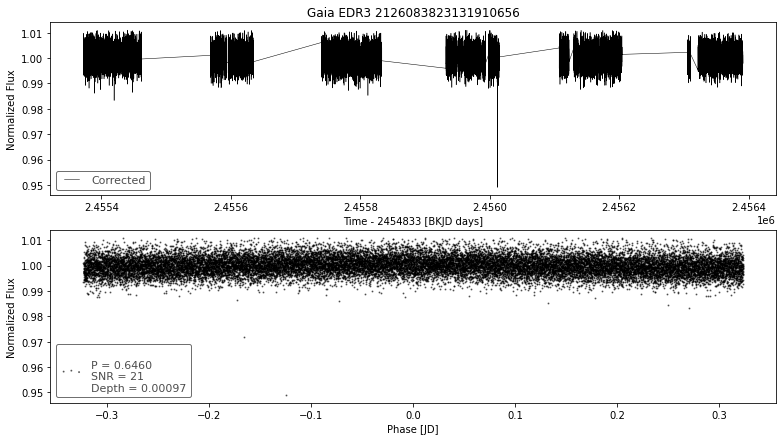

__________________________________________
index                                          22
designation         Gaia EDR3 2126085365021210240
BLS_period                               0.601366
BLS_period_SNR                         116.844322
BLS_duration                                0.399
BLS_depth                                0.015961
BLS_transit_time                   2455372.876981
batch                                          80
Name: 7922, dtype: object
ra                         290.475169
ra_error                     0.290964
dec                         43.716478
dec_error                    0.291582
pmra                        -1.103086
pmdec                       -2.129752
parallax                     0.331805
parallax_error               0.332642
phot_g_n_obs               313.000000
phot_g_mean_flux           235.635151
phot_g_mean_flux_error       0.917172
phot_g_mean_mag             19.756767
phot_bp_n_obs               30.000000
phot_bp_mean_flux          102.212387

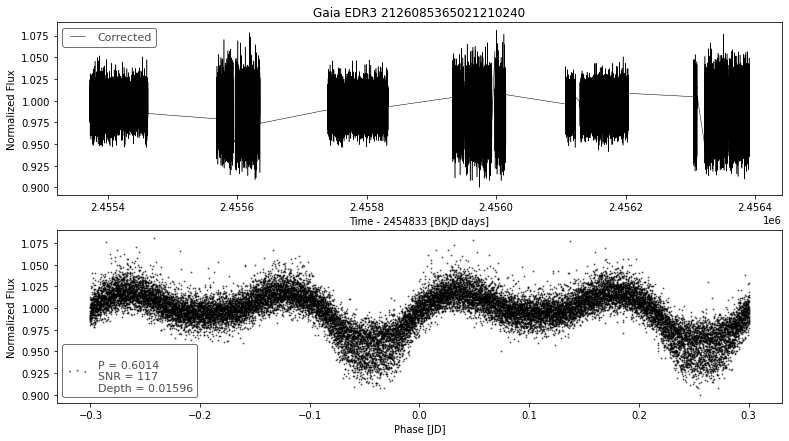

__________________________________________
index                                          23
designation         Gaia EDR3 2126085369316699648
BLS_period                               0.601366
BLS_period_SNR                         189.301109
BLS_duration                                0.399
BLS_depth                                0.022339
BLS_transit_time                   2455372.876981
batch                                          80
Name: 7923, dtype: object
ra                         290.476160
ra_error                     0.345479
dec                         43.716587
dec_error                    0.339196
pmra                        -0.899953
pmdec                       -3.306187
parallax                     0.628685
parallax_error               0.390124
phot_g_n_obs               286.000000
phot_g_mean_flux           197.842892
phot_g_mean_flux_error       0.982571
phot_g_mean_mag             19.946566
phot_bp_n_obs               14.000000
phot_bp_mean_flux           98.974971

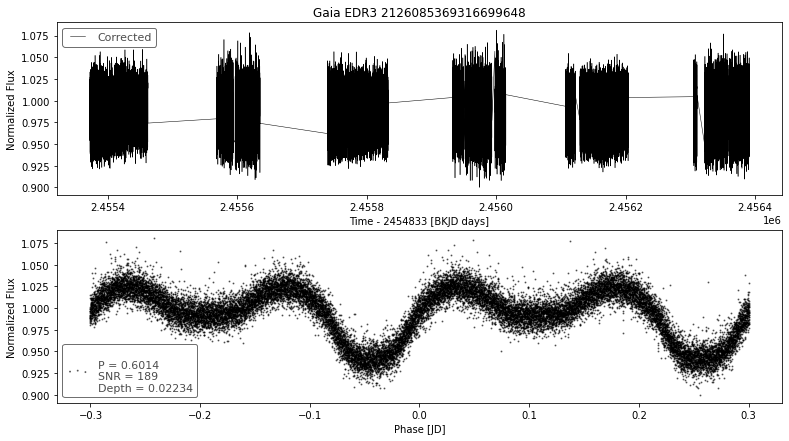

__________________________________________
index                                          25
designation         Gaia EDR3 2126085369320144640
BLS_period                               0.841974
BLS_period_SNR                         762.087688
BLS_duration                                0.051
BLS_depth                                 0.03655
BLS_transit_time                   2455372.699981
batch                                          80
Name: 7925, dtype: object
ra                          290.495510
ra_error                      0.053709
dec                          43.718340
dec_error                     0.054137
pmra                         -3.556179
pmdec                        -4.277651
parallax                      0.402708
parallax_error                0.061894
phot_g_n_obs                312.000000
phot_g_mean_flux           2555.500172
phot_g_mean_flux_error        5.118424
phot_g_mean_mag              17.168676
phot_bp_n_obs                32.000000
phot_bp_mean_flux       

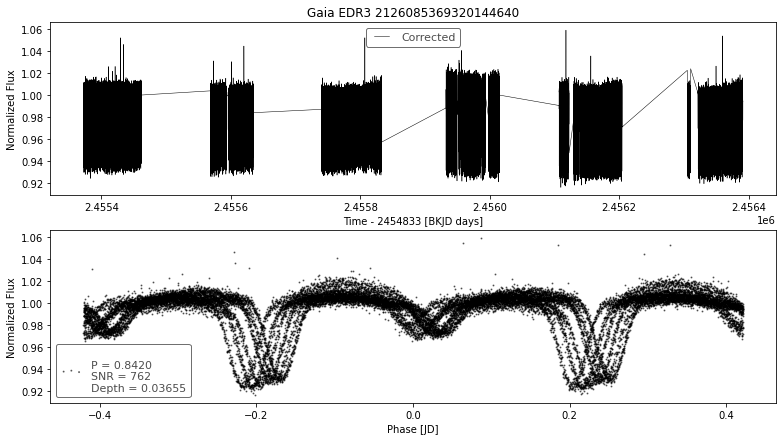

__________________________________________
index                                          50
designation         Gaia EDR3 2126955319233534592
BLS_period                               0.608346
BLS_period_SNR                          99.426895
BLS_duration                                 0.45
BLS_depth                                0.021158
BLS_transit_time                   2455372.698419
batch                                          80
Name: 7950, dtype: object
ra                         289.524520
ra_error                     0.165695
dec                         44.682836
dec_error                    0.177779
pmra                        -4.280003
pmdec                        0.614135
parallax                     0.981754
parallax_error               0.190871
phot_g_n_obs               358.000000
phot_g_mean_flux           436.865261
phot_g_mean_flux_error       0.980055
phot_g_mean_mag             19.086498
phot_bp_n_obs               36.000000
phot_bp_mean_flux          102.341068

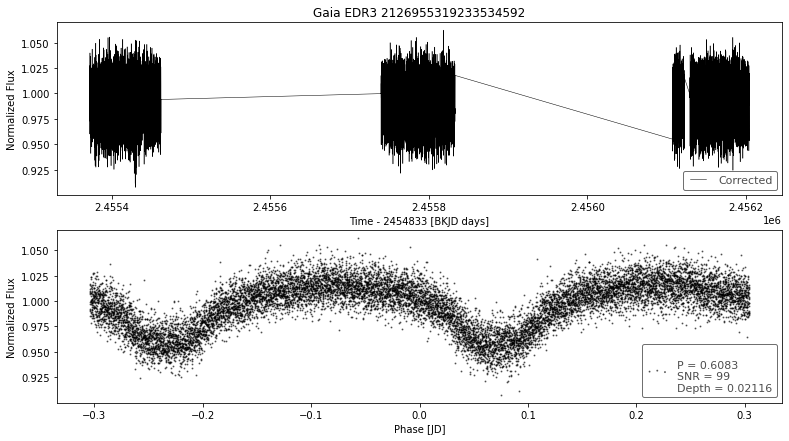

__________________________________________
index                                          51
designation         Gaia EDR3 2126955323535081728
BLS_period                               0.608346
BLS_period_SNR                       104461.91474
BLS_duration                                 0.45
BLS_depth                                0.163123
BLS_transit_time                   2455372.695419
batch                                          80
Name: 7951, dtype: object
ra                            289.522641
ra_error                        0.011964
dec                            44.687548
dec_error                       0.012175
pmra                            3.403953
pmdec                          -7.975554
parallax                        0.748758
parallax_error                  0.013258
phot_g_n_obs                  359.000000
phot_g_mean_flux           145747.616152
phot_g_mean_flux_error       1146.443600
phot_g_mean_mag                12.778363
phot_bp_n_obs                  43.00000

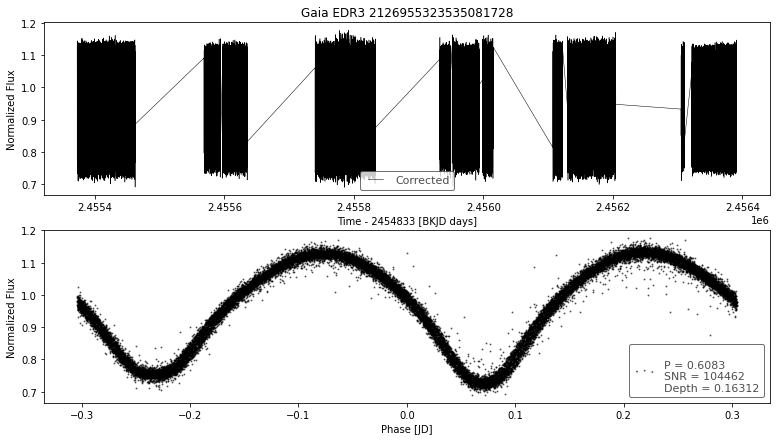

__________________________________________
index                                          52
designation         Gaia EDR3 2126955323535082368
BLS_period                               0.608346
BLS_period_SNR                      104987.797957
BLS_duration                                 0.45
BLS_depth                                0.163085
BLS_transit_time                   2455372.695419
batch                                          80
Name: 7952, dtype: object
ra                           289.523471
ra_error                       0.023688
dec                           44.687579
dec_error                      0.024289
pmra                           3.458211
pmdec                         -8.138202
parallax                       0.688508
parallax_error                 0.026603
phot_g_n_obs                 344.000000
phot_g_mean_flux           10940.655644
phot_g_mean_flux_error        14.499726
phot_g_mean_mag               15.589759
phot_bp_n_obs                  4.000000
phot_bp_mea

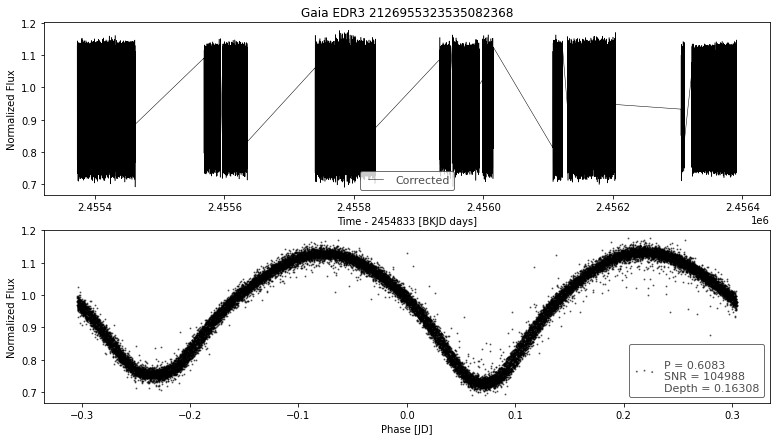

__________________________________________
index                                          17
designation         Gaia EDR3 2127956149696086272
BLS_period                               0.601936
BLS_period_SNR                         193.257546
BLS_duration                                0.399
BLS_depth                                0.019349
BLS_transit_time                   2455372.759749
batch                                          81
Name: 8017, dtype: object
ra                         293.828766
ra_error                     0.149107
dec                         45.208002
dec_error                    0.173860
pmra                        -1.641396
pmdec                       -3.869774
parallax                     0.133046
parallax_error               0.178400
phot_g_n_obs               349.000000
phot_g_mean_flux           460.731490
phot_g_mean_flux_error       1.597538
phot_g_mean_mag             19.028748
phot_bp_n_obs               35.000000
phot_bp_mean_flux          203.360954

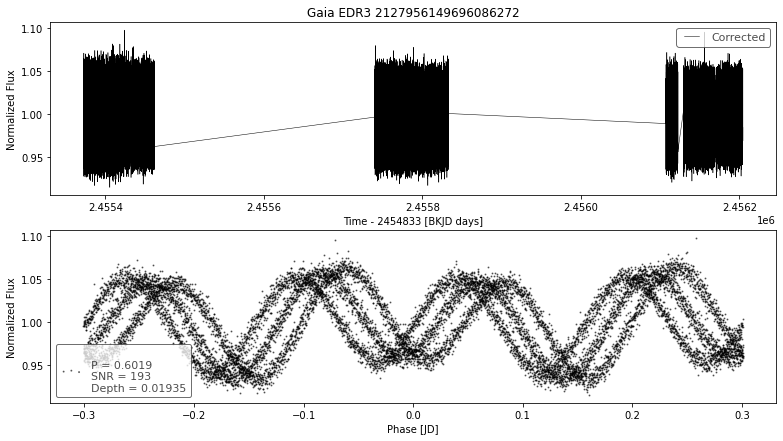

__________________________________________
index                                          76
designation         Gaia EDR3 2085663748472150656
BLS_period                               0.541194
BLS_period_SNR                         589.806737
BLS_duration                                 0.45
BLS_depth                                0.007033
BLS_transit_time                   2455372.694879
batch                                          81
Name: 8076, dtype: object
ra                          298.839118
ra_error                      0.049890
dec                          47.099965
dec_error                     0.055683
pmra                         -2.208021
pmdec                        -4.498306
parallax                      0.218030
parallax_error                0.057152
phot_g_n_obs                346.000000
phot_g_mean_flux           2428.763525
phot_g_mean_flux_error        5.316422
phot_g_mean_mag              17.223904
phot_bp_n_obs                41.000000
phot_bp_mean_flux       

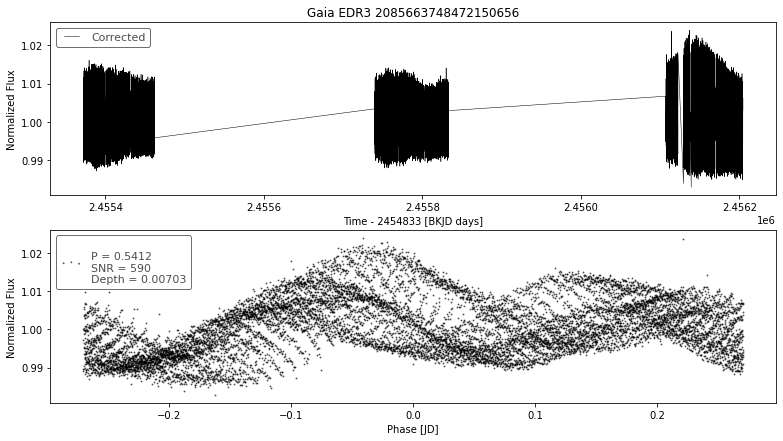

__________________________________________
index                                          77
designation         Gaia EDR3 2085663748472152704
BLS_period                               0.541194
BLS_period_SNR                         209.559857
BLS_duration                                 0.45
BLS_depth                                0.000689
BLS_transit_time                   2455372.694879
batch                                          81
Name: 8077, dtype: object
ra                           298.842590
ra_error                       0.009007
dec                           47.101036
dec_error                      0.010167
pmra                          -3.167157
pmdec                         -3.039215
parallax                       0.234965
parallax_error                 0.010463
phot_g_n_obs                 366.000000
phot_g_mean_flux           84849.192016
phot_g_mean_flux_error        13.969516
phot_g_mean_mag               13.365747
phot_bp_n_obs                 42.000000
phot_bp_mea

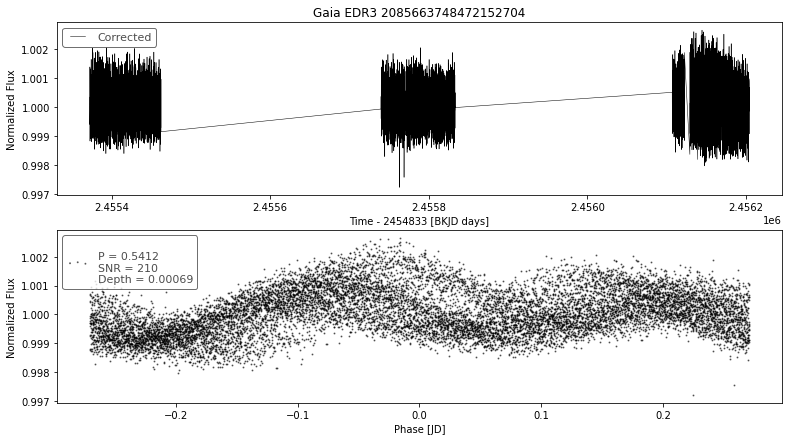

__________________________________________
index                                          48
designation         Gaia EDR3 2130636827760031232
BLS_period                               0.961017
BLS_period_SNR                         104.803268
BLS_duration                                 0.45
BLS_depth                                0.000097
BLS_transit_time                   2455373.196283
batch                                          82
Name: 8148, dtype: object
ra                            287.165258
ra_error                        0.010429
dec                            46.995904
dec_error                       0.010497
pmra                           -3.942831
pmdec                          -7.573927
parallax                        0.399061
parallax_error                  0.011181
phot_g_n_obs                  333.000000
phot_g_mean_flux           355041.896500
phot_g_mean_flux_error         94.971695
phot_g_mean_mag                11.811667
phot_bp_n_obs                  37.00000

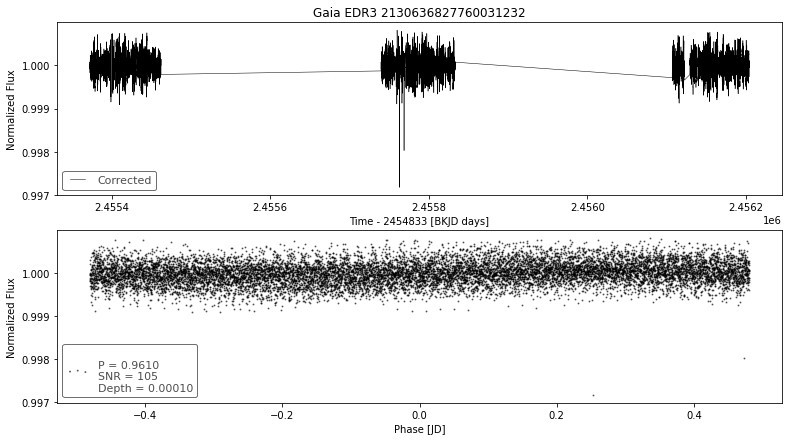

__________________________________________
index                                          50
designation         Gaia EDR3 2130636832059264640
BLS_period                               0.853995
BLS_period_SNR                           50.88369
BLS_duration                                 0.45
BLS_depth                                0.000088
BLS_transit_time                   2455372.770283
batch                                          82
Name: 8150, dtype: object
ra                          287.166715
ra_error                      0.051836
dec                          46.994625
dec_error                     0.050052
pmra                          0.974855
pmdec                         0.706312
parallax                      0.527590
parallax_error                0.052042
phot_g_n_obs                275.000000
phot_g_mean_flux           3508.021913
phot_g_mean_flux_error        2.374139
phot_g_mean_mag              16.824710
phot_bp_n_obs                29.000000
phot_bp_mean_flux       

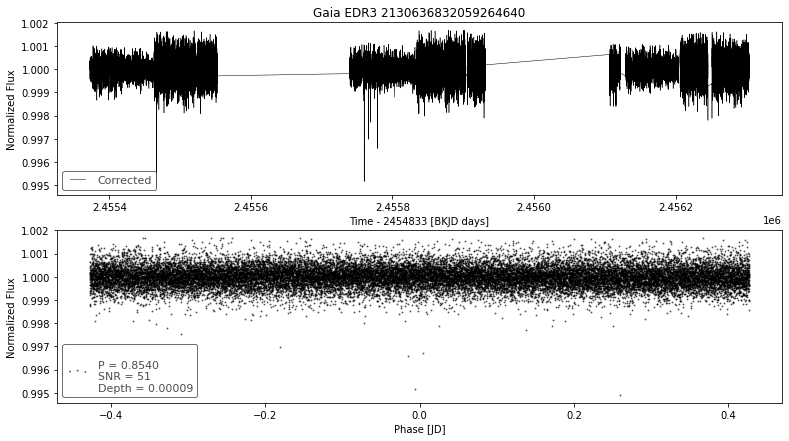

__________________________________________
index                                          19
designation         Gaia EDR3 2119506956886244864
BLS_period                               0.895826
BLS_period_SNR                         108.797825
BLS_duration                                 0.45
BLS_depth                                0.000232
BLS_transit_time                   2455373.172424
batch                                          83
Name: 8219, dtype: object
ra                           282.344432
ra_error                       0.011617
dec                           46.631766
dec_error                      0.011162
pmra                          -2.313970
pmdec                          4.108048
parallax                       0.914169
parallax_error                 0.012394
phot_g_n_obs                 373.000000
phot_g_mean_flux           54251.564011
phot_g_mean_flux_error        16.127220
phot_g_mean_mag               13.851337
phot_bp_n_obs                 42.000000
phot_bp_mea

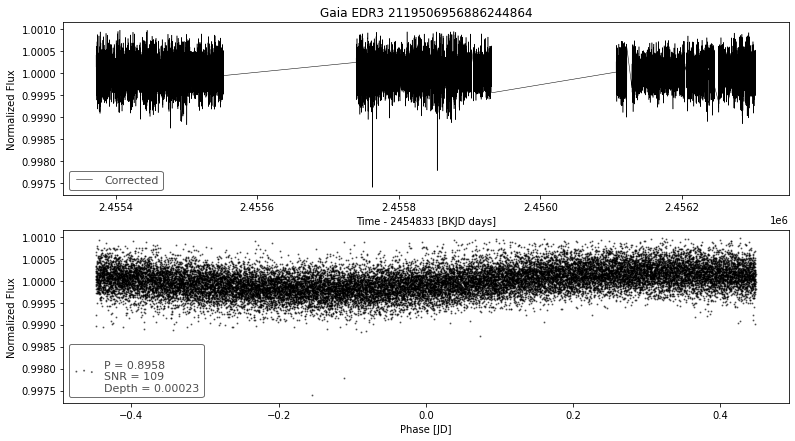

__________________________________________
index                                          40
designation         Gaia EDR3 2131910169602749952
BLS_period                               0.790401
BLS_period_SNR                          62.559156
BLS_duration                                 0.45
BLS_depth                                0.001987
BLS_transit_time                   2455372.698195
batch                                          83
Name: 8240, dtype: object
ra                          285.639530
ra_error                      0.053124
dec                          48.403459
dec_error                     0.057468
pmra                         20.092080
pmdec                        44.917421
parallax                      6.987410
parallax_error                0.059155
phot_g_n_obs                338.000000
phot_g_mean_flux           2360.627789
phot_g_mean_flux_error        2.495586
phot_g_mean_mag              17.254799
phot_bp_n_obs                37.000000
phot_bp_mean_flux       

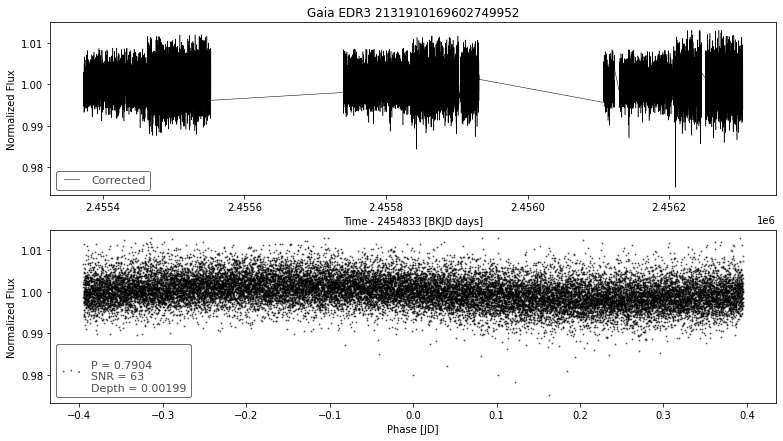

__________________________________________
index                                          50
designation         Gaia EDR3 2082091366475037440
BLS_period                                0.71363
BLS_period_SNR                           25.67678
BLS_duration                                0.174
BLS_depth                                0.000026
BLS_transit_time                   2455463.364678
batch                                          84
Name: 8350, dtype: object
ra                            300.726750
ra_error                        0.011129
dec                            44.567622
dec_error                       0.011229
pmra                           -0.195624
pmdec                          -3.401254
parallax                        0.837710
parallax_error                  0.012713
phot_g_n_obs                  355.000000
phot_g_mean_flux           376684.498967
phot_g_mean_flux_error         65.846954
phot_g_mean_mag                11.747422
phot_bp_n_obs                  41.00000

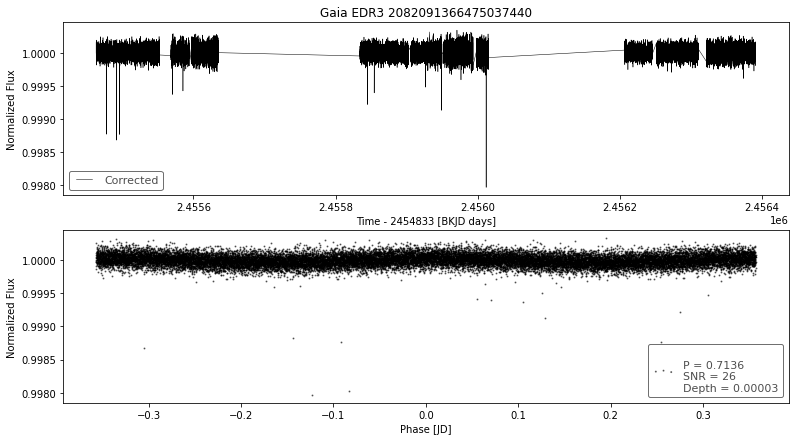

__________________________________________
index                                           6
designation         Gaia EDR3 2076789482746065280
BLS_period                               0.664304
BLS_period_SNR                          91.662875
BLS_duration                                 0.45
BLS_depth                                0.003518
BLS_transit_time                    2455463.50262
batch                                          85
Name: 8406, dtype: object
ra                          296.952021
ra_error                      0.055312
dec                          41.191156
dec_error                     0.066333
pmra                         -3.099467
pmdec                        -4.935100
parallax                      0.248191
parallax_error                0.069203
phot_g_n_obs                388.000000
phot_g_mean_flux           1727.034633
phot_g_mean_flux_error        1.471648
phot_g_mean_mag              17.594114
phot_bp_n_obs                40.000000
phot_bp_mean_flux       

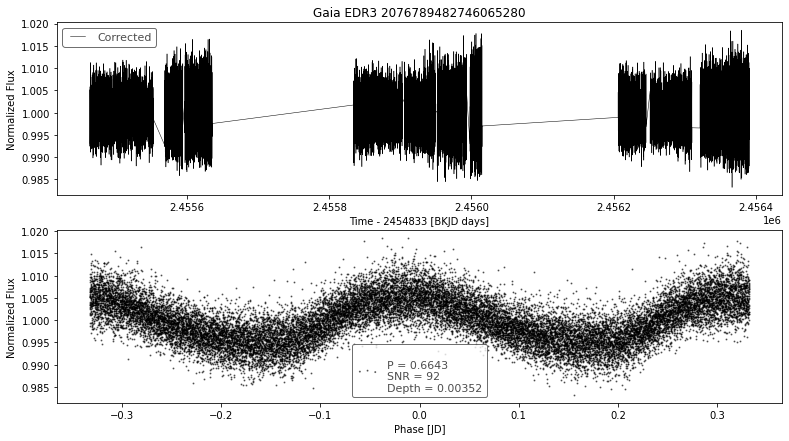

__________________________________________
index                                          10
designation         Gaia EDR3 2076789487048365952
BLS_period                               0.664304
BLS_period_SNR                        2674.591054
BLS_duration                                 0.45
BLS_depth                                0.098122
BLS_transit_time                    2455463.50562
batch                                          85
Name: 8410, dtype: object
ra                          296.955587
ra_error                      0.054468
dec                          41.188995
dec_error                     0.064468
pmra                         -1.223068
pmdec                        -1.814019
parallax                      0.054448
parallax_error                0.067483
phot_g_n_obs                406.000000
phot_g_mean_flux           1697.825377
phot_g_mean_flux_error        9.402326
phot_g_mean_mag              17.612635
phot_bp_n_obs                51.000000
phot_bp_mean_flux       

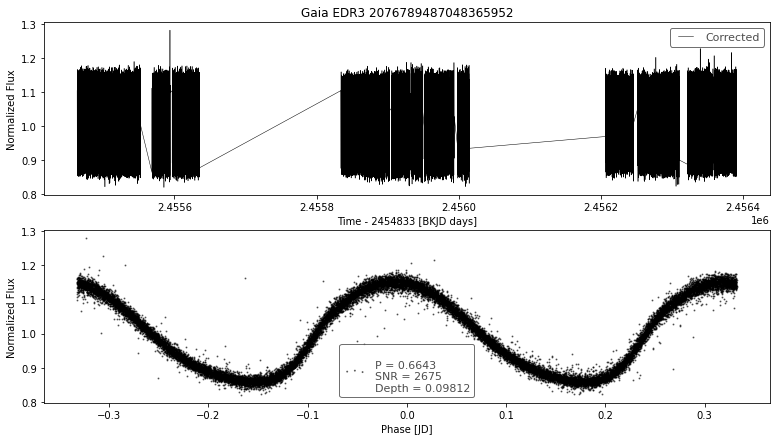

__________________________________________
index                                          59
designation         Gaia EDR3 2073682434684134144
BLS_period                               0.707867
BLS_period_SNR                           95.94668
BLS_duration                                0.126
BLS_depth                                0.003413
BLS_transit_time                   2455463.535708
batch                                          85
Name: 8459, dtype: object
ra                         297.647898
ra_error                     0.481270
dec                         40.233099
dec_error                    0.549531
pmra                        -0.077282
pmdec                        7.850669
parallax                     1.805512
parallax_error               0.607869
phot_g_n_obs               355.000000
phot_g_mean_flux           716.297896
phot_g_mean_flux_error       3.254583
phot_g_mean_mag             18.549633
phot_bp_n_obs               43.000000
phot_bp_mean_flux          326.385808

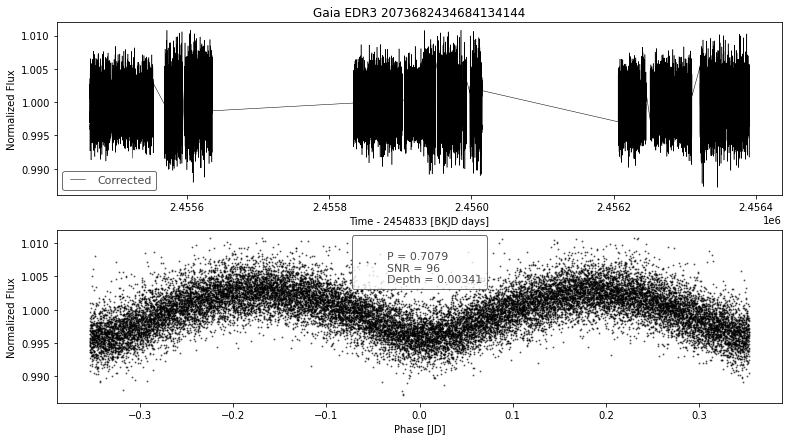

__________________________________________
index                                          61
designation         Gaia EDR3 2073682438979104512
BLS_period                               0.707867
BLS_period_SNR                          86.936338
BLS_duration                                 0.15
BLS_depth                                0.000786
BLS_transit_time                   2455463.535708
batch                                          85
Name: 8461, dtype: object
ra                          297.643884
ra_error                      0.082585
dec                          40.230083
dec_error                     0.093778
pmra                          1.838765
pmdec                        -3.525514
parallax                      0.127866
parallax_error                0.102196
phot_g_n_obs                344.000000
phot_g_mean_flux           1196.001928
phot_g_mean_flux_error        1.542002
phot_g_mean_mag              17.993036
phot_bp_n_obs                43.000000
phot_bp_mean_flux       

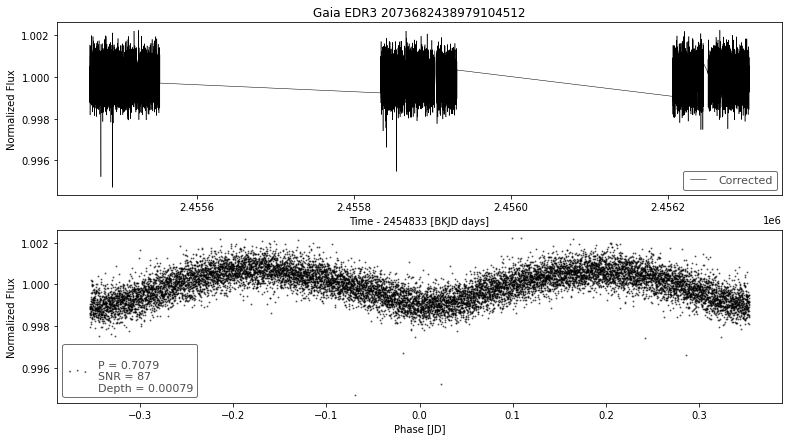

__________________________________________
index                                          62
designation         Gaia EDR3 2073682438979133056
BLS_period                               0.707867
BLS_period_SNR                         174.221121
BLS_duration                                0.126
BLS_depth                                0.023652
BLS_transit_time                   2455463.535708
batch                                          85
Name: 8462, dtype: object
ra                         297.647196
ra_error                     0.285233
dec                         40.234111
dec_error                    0.317502
pmra                        -0.464232
pmdec                        0.309709
parallax                     0.108687
parallax_error               0.358406
phot_g_n_obs               350.000000
phot_g_mean_flux           188.704031
phot_g_mean_flux_error       0.797774
phot_g_mean_mag             19.997913
phot_bp_n_obs               34.000000
phot_bp_mean_flux           49.947714

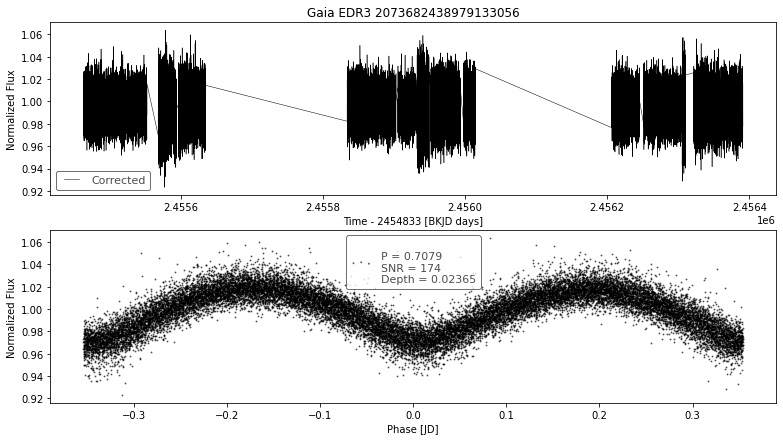

__________________________________________
index                                          63
designation         Gaia EDR3 2073682438989493888
BLS_period                               0.707867
BLS_period_SNR                          80.429246
BLS_duration                                0.126
BLS_depth                                0.001311
BLS_transit_time                   2455463.535708
batch                                          85
Name: 8463, dtype: object
ra                          297.649487
ra_error                      0.066629
dec                          40.231709
dec_error                     0.074900
pmra                         -3.335266
pmdec                         1.727642
parallax                      0.938461
parallax_error                0.082920
phot_g_n_obs                373.000000
phot_g_mean_flux           7769.065452
phot_g_mean_flux_error        8.996428
phot_g_mean_mag              15.961445
phot_bp_n_obs                42.000000
phot_bp_mean_flux       

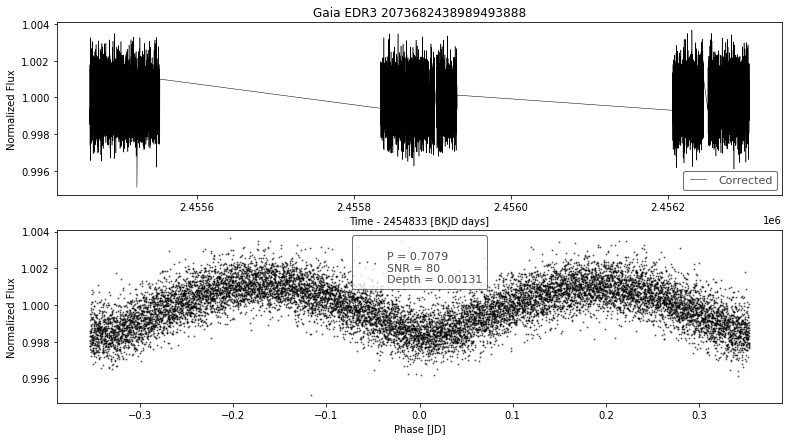

__________________________________________
index                                          71
designation         Gaia EDR3 2073682542068689664
BLS_period                              29.478184
BLS_period_SNR                         132.085585
BLS_duration                                 0.03
BLS_depth                                0.007534
BLS_transit_time                   2455464.276708
batch                                          85
Name: 8471, dtype: object
ra                           297.628964
ra_error                       0.012219
dec                           40.226241
dec_error                      0.012953
pmra                          -0.430982
pmdec                         -1.675476
parallax                       0.740254
parallax_error                 0.014600
phot_g_n_obs                 390.000000
phot_g_mean_flux           37713.483585
phot_g_mean_flux_error         7.238466
phot_g_mean_mag               14.246125
phot_bp_n_obs                 47.000000
phot_bp_mea

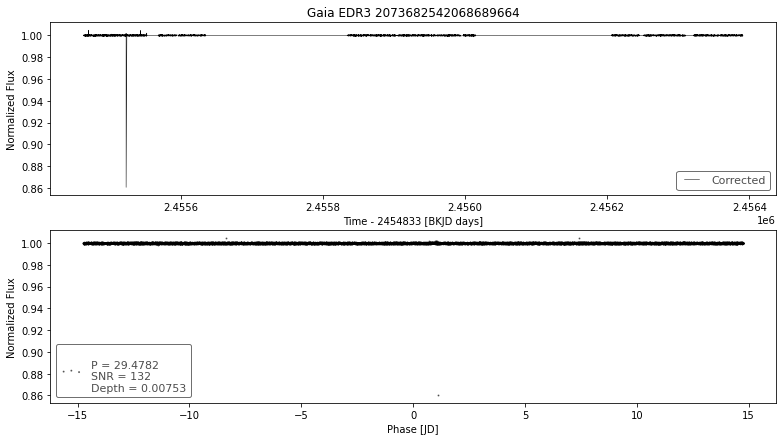

__________________________________________
index                                          72
designation         Gaia EDR3 2073682640842559360
BLS_period                               0.707867
BLS_period_SNR                        1098.842939
BLS_duration                                0.126
BLS_depth                                0.059683
BLS_transit_time                   2455463.538708
batch                                          85
Name: 8472, dtype: object
ra                         297.643417
ra_error                     0.251070
dec                         40.232566
dec_error                    0.279931
pmra                        -4.122195
pmdec                       -4.928272
parallax                    -0.104811
parallax_error               0.305745
phot_g_n_obs               385.000000
phot_g_mean_flux           601.530309
phot_g_mean_flux_error       2.722706
phot_g_mean_mag             18.739223
phot_bp_n_obs               42.000000
phot_bp_mean_flux          290.988913

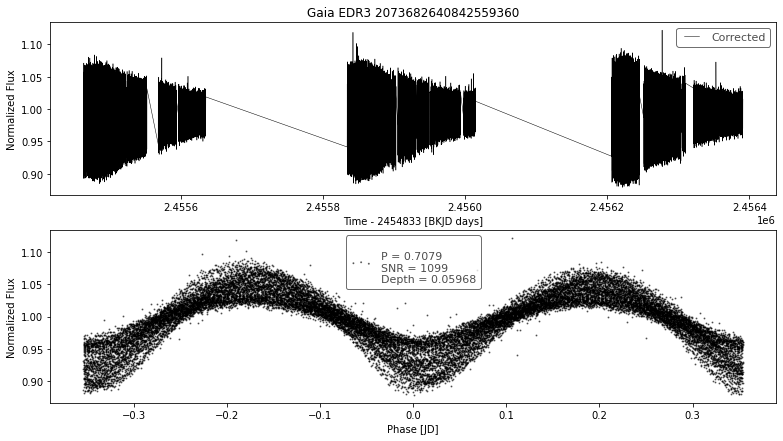

__________________________________________
index                                          73
designation         Gaia EDR3 2073682645147917184
BLS_period                               0.707867
BLS_period_SNR                         255.417719
BLS_duration                                0.126
BLS_depth                                0.001657
BLS_transit_time                   2455463.535708
batch                                          85
Name: 8473, dtype: object
ra                           297.642396
ra_error                       0.013460
dec                           40.229780
dec_error                      0.014419
pmra                           0.399372
pmdec                         -3.615021
parallax                       1.141048
parallax_error                 0.016203
phot_g_n_obs                 401.000000
phot_g_mean_flux           27327.123371
phot_g_mean_flux_error         5.140535
phot_g_mean_mag               14.595882
phot_bp_n_obs                 49.000000
phot_bp_mea

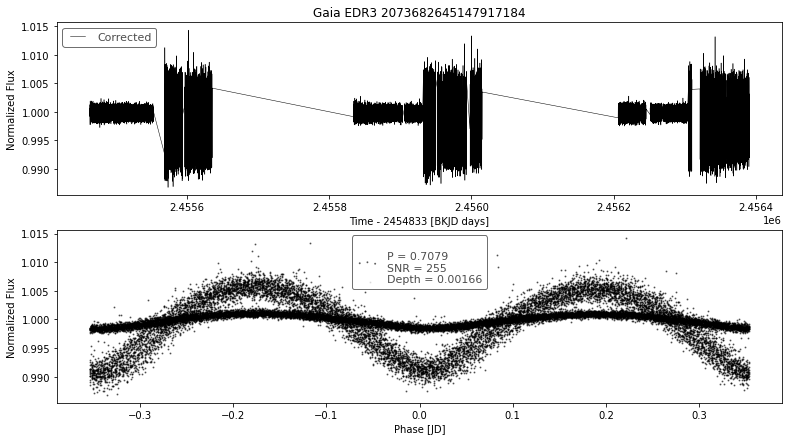

__________________________________________
index                                          97
designation         Gaia EDR3 2077245814431169792
BLS_period                               0.637804
BLS_period_SNR                        1289.253464
BLS_duration                                0.051
BLS_depth                                0.321825
BLS_transit_time                   2455463.807001
batch                                          85
Name: 8497, dtype: object
ra                         295.916197
ra_error                     0.169788
dec                         42.741738
dec_error                    0.176467
pmra                        -5.650139
pmdec                       -9.256659
parallax                     0.166025
parallax_error               0.199385
phot_g_n_obs               343.000000
phot_g_mean_flux           496.937074
phot_g_mean_flux_error       2.404017
phot_g_mean_mag             18.946613
phot_bp_n_obs               37.000000
phot_bp_mean_flux          177.066991

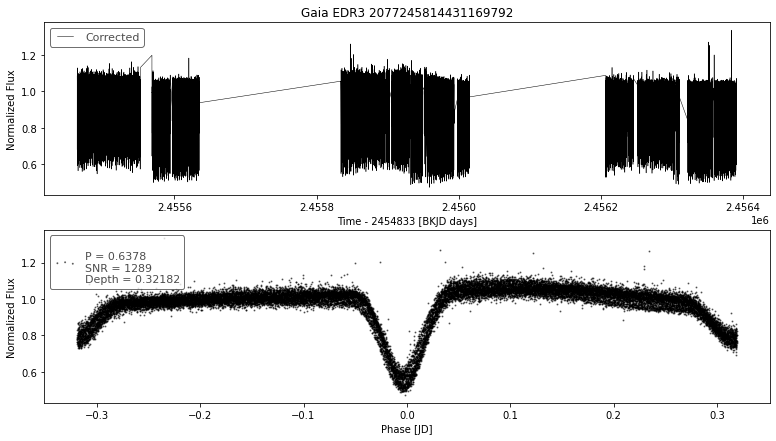

__________________________________________
index                                          28
designation         Gaia EDR3 2079588461390777216
BLS_period                               0.869922
BLS_period_SNR                          58.079964
BLS_duration                                0.099
BLS_depth                                0.009415
BLS_transit_time                   2455463.791954
batch                                          86
Name: 8528, dtype: object
ra                         296.394426
ra_error                     0.142100
dec                         44.295391
dec_error                    0.174346
pmra                        -1.911605
pmdec                       -2.673618
parallax                     0.103886
parallax_error               0.178680
phot_g_n_obs               346.000000
phot_g_mean_flux           442.914347
phot_g_mean_flux_error       1.035106
phot_g_mean_mag             19.071568
phot_bp_n_obs               39.000000
phot_bp_mean_flux          239.863273

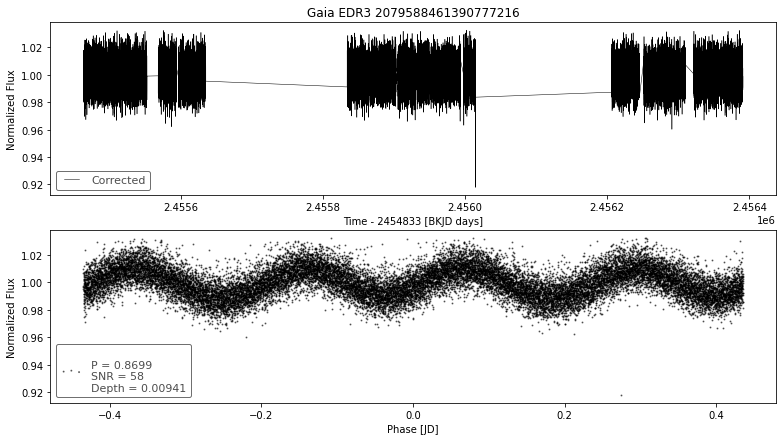

__________________________________________
index                                          53
designation         Gaia EDR3 2127955982195299840
BLS_period                               0.685256
BLS_period_SNR                          45.213605
BLS_duration                                 0.15
BLS_depth                                0.000121
BLS_transit_time                   2455463.349245
batch                                          86
Name: 8553, dtype: object
ra                           293.879934
ra_error                       0.011327
dec                           45.190814
dec_error                      0.012024
pmra                          -2.030802
pmdec                         -5.655126
parallax                       0.217219
parallax_error                 0.012593
phot_g_n_obs                 371.000000
phot_g_mean_flux           47277.643177
phot_g_mean_flux_error         7.575239
phot_g_mean_mag               14.000728
phot_bp_n_obs                 40.000000
phot_bp_mea

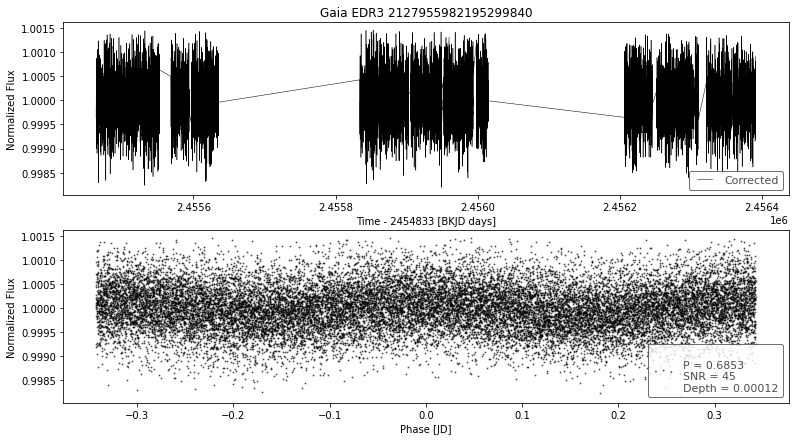

__________________________________________
index                                          80
designation         Gaia EDR3 2128157055384921984
BLS_period                               0.623567
BLS_period_SNR                           30.93479
BLS_duration                                0.399
BLS_depth                                0.000018
BLS_transit_time                   2455463.377695
batch                                          86
Name: 8580, dtype: object
ra                            294.419407
ra_error                        0.012795
dec                            46.794795
dec_error                       0.014039
pmra                            0.914331
pmdec                           0.689064
parallax                        1.319040
parallax_error                  0.014315
phot_g_n_obs                  394.000000
phot_g_mean_flux           844965.036380
phot_g_mean_flux_error        213.297870
phot_g_mean_mag                10.870270
phot_bp_n_obs                  44.00000

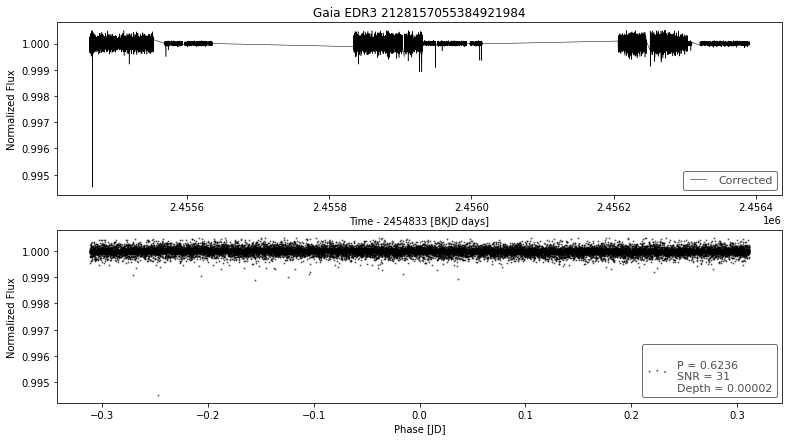

__________________________________________
index                                          28
designation         Gaia EDR3 2052499454125074944
BLS_period                              24.624035
BLS_period_SNR                         990.080396
BLS_duration                                 0.33
BLS_depth                                0.030202
BLS_transit_time                   2455485.642491
batch                                          87
Name: 8628, dtype: object
ra                           293.681723
ra_error                       0.020120
dec                           39.758832
dec_error                      0.021403
pmra                           1.560071
pmdec                         -2.688650
parallax                       0.618882
parallax_error                 0.023272
phot_g_n_obs                 343.000000
phot_g_mean_flux           13890.513815
phot_g_mean_flux_error         3.760886
phot_g_mean_mag               15.330571
phot_bp_n_obs                 34.000000
phot_bp_mea

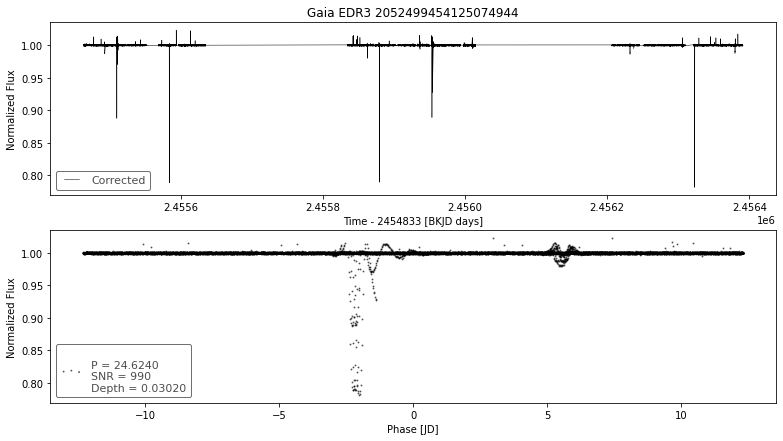

__________________________________________
index                                          31
designation         Gaia EDR3 2052499488484828928
BLS_period                               0.523529
BLS_period_SNR                         499.907249
BLS_duration                                 0.45
BLS_depth                                0.005711
BLS_transit_time                   2455463.445491
batch                                          87
Name: 8631, dtype: object
ra                          293.701484
ra_error                      0.024019
dec                          39.768009
dec_error                     0.025482
pmra                         -1.415074
pmdec                        -4.636086
parallax                      1.014217
parallax_error                0.028051
phot_g_n_obs                353.000000
phot_g_mean_flux           9748.305219
phot_g_mean_flux_error        4.638422
phot_g_mean_mag              15.715044
phot_bp_n_obs                39.000000
phot_bp_mean_flux       

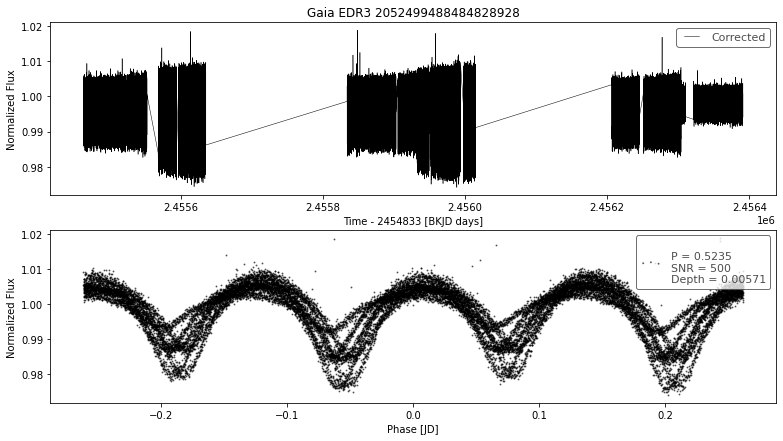

__________________________________________
index                                          32
designation         Gaia EDR3 2052499488484831616
BLS_period                               0.523529
BLS_period_SNR                        1513.347484
BLS_duration                                 0.45
BLS_depth                                0.065289
BLS_transit_time                   2455463.445491
batch                                          87
Name: 8632, dtype: object
ra                         293.704414
ra_error                     0.108091
dec                         39.768631
dec_error                    0.111801
pmra                        -2.288007
pmdec                       -3.526269
parallax                     0.500545
parallax_error               0.128978
phot_g_n_obs               343.000000
phot_g_mean_flux           842.354520
phot_g_mean_flux_error       9.752221
phot_g_mean_mag             18.373630
phot_bp_n_obs               35.000000
phot_bp_mean_flux          467.110431

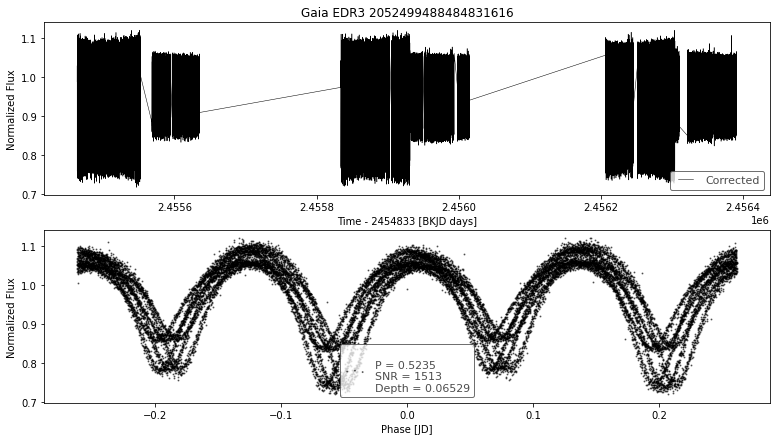

__________________________________________
index                                          54
designation         Gaia EDR3 2053613220739715072
BLS_period                               0.557331
BLS_period_SNR                         210.873709
BLS_duration                                 0.33
BLS_depth                                0.016523
BLS_transit_time                   2455463.592326
batch                                          88
Name: 8754, dtype: object
ra                          292.481541
ra_error                      0.091358
dec                          41.271548
dec_error                     0.108974
pmra                         -2.082847
pmdec                         1.863097
parallax                      2.710107
parallax_error                0.112441
phot_g_n_obs                388.000000
phot_g_mean_flux            860.630152
phot_g_mean_flux_error        1.661444
phot_g_mean_mag              18.350325
phot_bp_n_obs                44.000000
phot_bp_mean_flux       

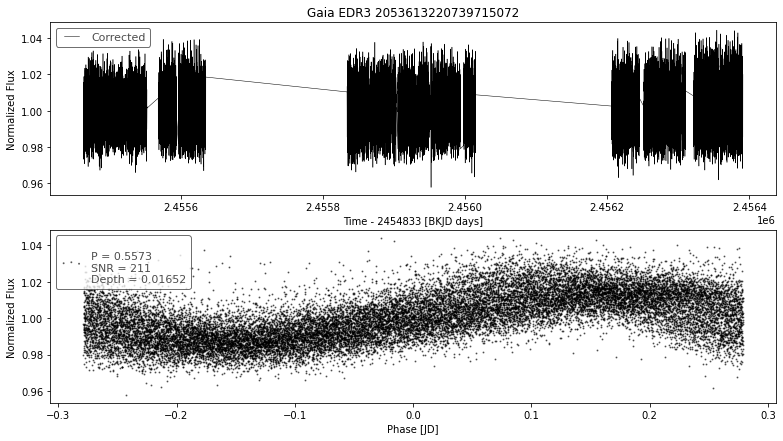

__________________________________________
index                                          99
designation         Gaia EDR3 2130350409282043136
BLS_period                               0.888158
BLS_period_SNR                         569.130967
BLS_duration                                 0.45
BLS_depth                                0.000911
BLS_transit_time                   2455463.867879
batch                                          88
Name: 8799, dtype: object
ra                         2.881512e+02
ra_error                   7.509982e-01
dec                        4.605931e+01
dec_error                  7.710297e-01
pmra                       1.000000e+20
pmdec                      1.000000e+20
parallax                   1.000000e+20
parallax_error             1.000000e+20
phot_g_n_obs               3.560000e+02
phot_g_mean_flux           7.042822e+04
phot_g_mean_flux_error     4.273775e+02
phot_g_mean_mag            1.356800e+01
phot_bp_n_obs              4.000000e+01
phot_bp_mea

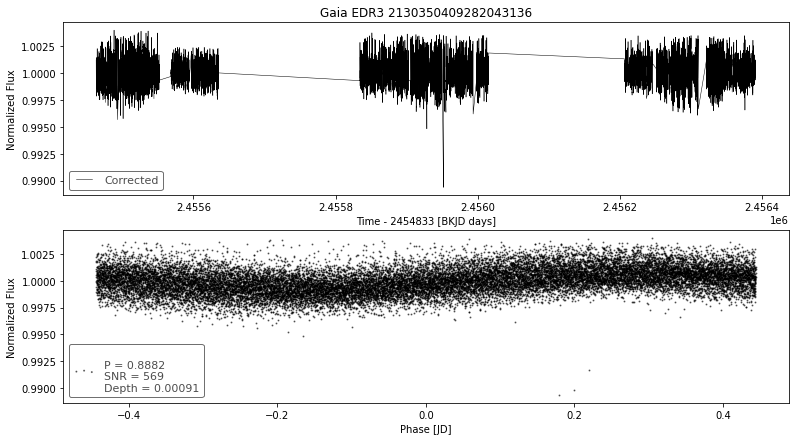

__________________________________________
index                                          12
designation         Gaia EDR3 2132098113073363712
BLS_period                               0.807089
BLS_period_SNR                         230.679035
BLS_duration                                 0.45
BLS_depth                                0.000666
BLS_transit_time                    2455463.40558
batch                                          89
Name: 8812, dtype: object
ra                           286.162970
ra_error                       0.023036
dec                           49.963450
dec_error                      0.022337
pmra                           3.284830
pmdec                         -2.813228
parallax                       0.578120
parallax_error                 0.023715
phot_g_n_obs                 394.000000
phot_g_mean_flux           10412.929840
phot_g_mean_flux_error         3.958680
phot_g_mean_mag               15.643435
phot_bp_n_obs                 44.000000
phot_bp_mea

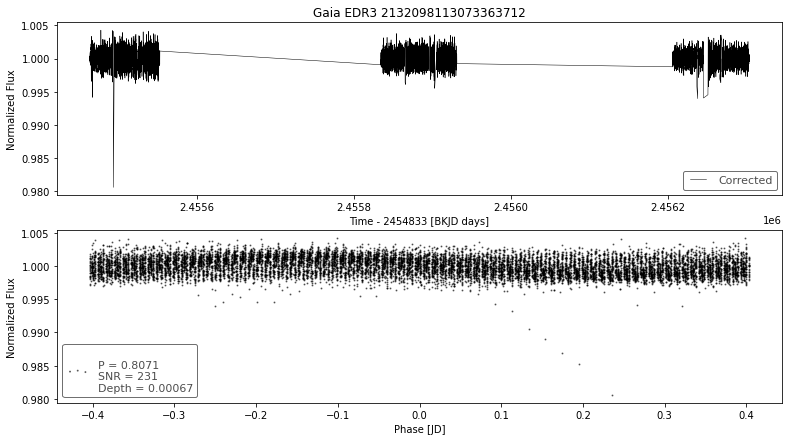

__________________________________________
index                                          13
designation         Gaia EDR3 2132098113073402880
BLS_period                               0.807089
BLS_period_SNR                          639.01347
BLS_duration                                 0.45
BLS_depth                                0.000776
BLS_transit_time                    2455463.40558
batch                                          89
Name: 8813, dtype: object
ra                            286.165356
ra_error                        0.009104
dec                            49.964769
dec_error                       0.008542
pmra                            5.055243
pmdec                          14.079201
parallax                        0.967223
parallax_error                  0.009171
phot_g_n_obs                  408.000000
phot_g_mean_flux           260712.866938
phot_g_mean_flux_error        176.462050
phot_g_mean_mag                12.146960
phot_bp_n_obs                  43.00000

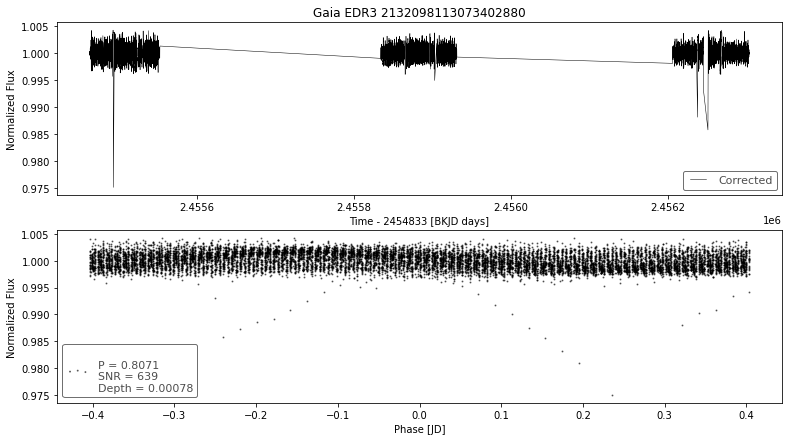

__________________________________________
index                                          14
designation         Gaia EDR3 2132098117372362880
BLS_period                               0.807089
BLS_period_SNR                         232.636007
BLS_duration                                 0.45
BLS_depth                                0.000706
BLS_transit_time                    2455463.42058
batch                                          89
Name: 8814, dtype: object
ra                          286.162920
ra_error                      0.051645
dec                          49.965024
dec_error                     0.050601
pmra                         -0.639413
pmdec                        -1.910948
parallax                      0.215493
parallax_error                0.053420
phot_g_n_obs                367.000000
phot_g_mean_flux           2505.125697
phot_g_mean_flux_error        1.775332
phot_g_mean_mag              17.190292
phot_bp_n_obs                40.000000
phot_bp_mean_flux       

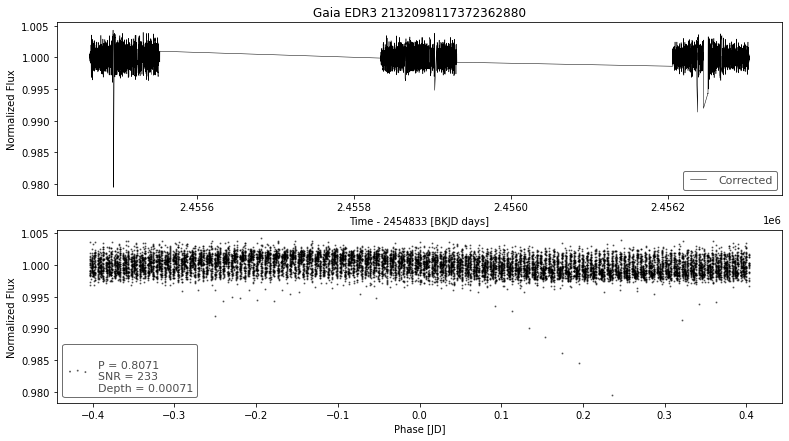

__________________________________________
index                                          15
designation         Gaia EDR3 2132098117372363392
BLS_period                               0.807089
BLS_period_SNR                         428.450745
BLS_duration                                 0.45
BLS_depth                                0.000627
BLS_transit_time                    2455463.42058
batch                                          89
Name: 8815, dtype: object
ra                           286.168949
ra_error                       0.011404
dec                           49.966019
dec_error                      0.010859
pmra                           5.105775
pmdec                         14.141862
parallax                       0.960997
parallax_error                 0.011488
phot_g_n_obs                 393.000000
phot_g_mean_flux           47863.105817
phot_g_mean_flux_error         8.957898
phot_g_mean_mag               13.987365
phot_bp_n_obs                 43.000000
phot_bp_mea

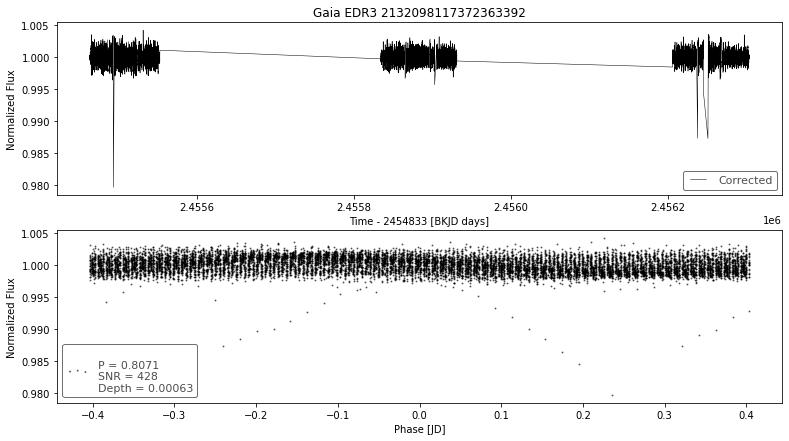

__________________________________________
index                                           8
designation         Gaia EDR3 2107265952198191104
BLS_period                               0.604584
BLS_period_SNR                           34.54987
BLS_duration                                 0.33
BLS_depth                                0.004973
BLS_transit_time                   2455463.516669
batch                                          90
Name: 8908, dtype: object
ra                         285.198109
ra_error                     0.162278
dec                         45.995887
dec_error                    0.183780
pmra                       -10.607010
pmdec                       38.142432
parallax                     2.735751
parallax_error               0.184125
phot_g_n_obs               367.000000
phot_g_mean_flux           371.317751
phot_g_mean_flux_error       0.950669
phot_g_mean_mag             19.263002
phot_bp_n_obs               33.000000
phot_bp_mean_flux           73.823228

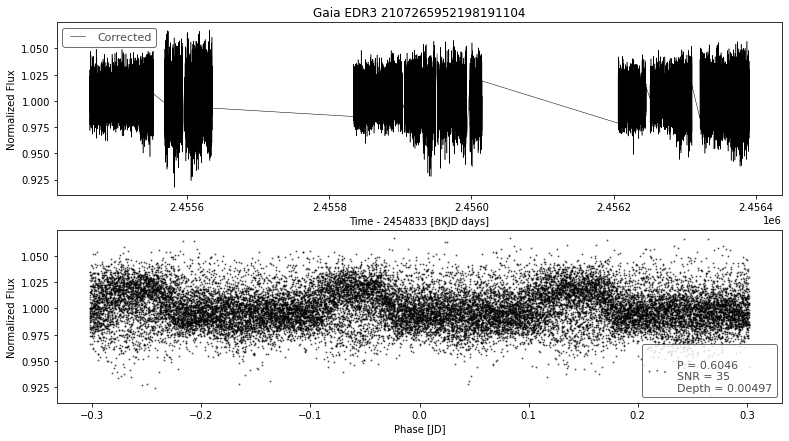

__________________________________________
index                                          10
designation         Gaia EDR3 2107265956497850496
BLS_period                               0.604584
BLS_period_SNR                          45.643727
BLS_duration                                 0.45
BLS_depth                                0.004006
BLS_transit_time                   2455463.516669
batch                                          90
Name: 8910, dtype: object
ra                         285.194510
ra_error                     0.117200
dec                         45.997036
dec_error                    0.136982
pmra                        -2.240439
pmdec                       -2.270700
parallax                     0.127048
parallax_error               0.136148
phot_g_n_obs               380.000000
phot_g_mean_flux           561.672317
phot_g_mean_flux_error       1.055999
phot_g_mean_mag             18.813660
phot_bp_n_obs               34.000000
phot_bp_mean_flux          343.136535

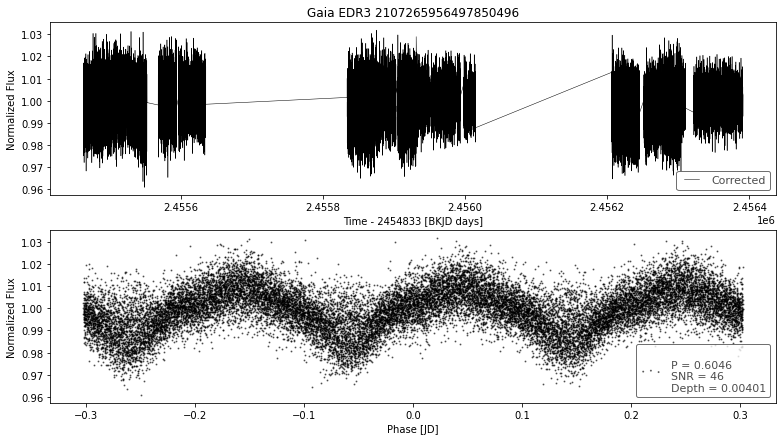

__________________________________________
index                                          71
designation         Gaia EDR3 2103826817266483328
BLS_period                               0.546899
BLS_period_SNR                          27.232656
BLS_duration                                 0.45
BLS_depth                                0.000155
BLS_transit_time                   2455463.474895
batch                                          90
Name: 8971, dtype: object
ra                           285.311754
ra_error                       0.010240
dec                           41.030671
dec_error                      0.012100
pmra                          -2.368618
pmdec                         -4.163018
parallax                       0.203510
parallax_error                 0.012291
phot_g_n_obs                 408.000000
phot_g_mean_flux           51084.832761
phot_g_mean_flux_error         8.289259
phot_g_mean_mag               13.916636
phot_bp_n_obs                 48.000000
phot_bp_mea

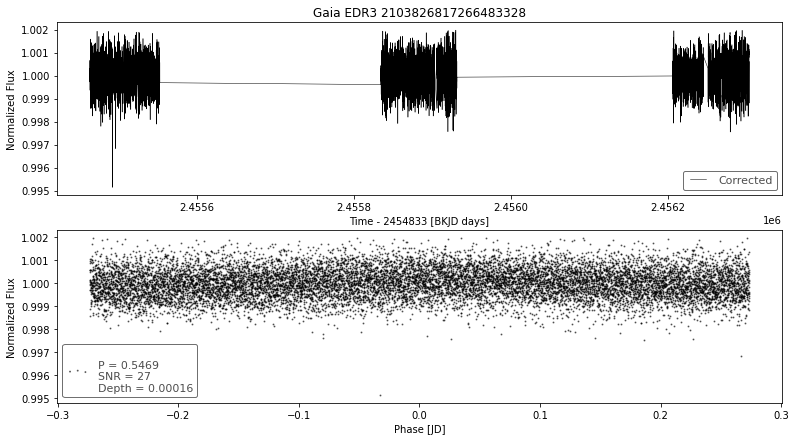

__________________________________________
index                                          77
designation         Gaia EDR3 2105956644307237760
BLS_period                                0.60401
BLS_period_SNR                          97.126891
BLS_duration                                 0.45
BLS_depth                                0.000111
BLS_transit_time                   2455568.591322
batch                                          91
Name: 9077, dtype: object
ra                            284.940011
ra_error                        0.008518
dec                            44.371213
dec_error                       0.009222
pmra                           -1.104466
pmdec                         -11.071544
parallax                        0.914710
parallax_error                  0.009523
phot_g_n_obs                  370.000000
phot_g_mean_flux           932943.991844
phot_g_mean_flux_error         96.641075
phot_g_mean_mag                10.762728
phot_bp_n_obs                  42.00000

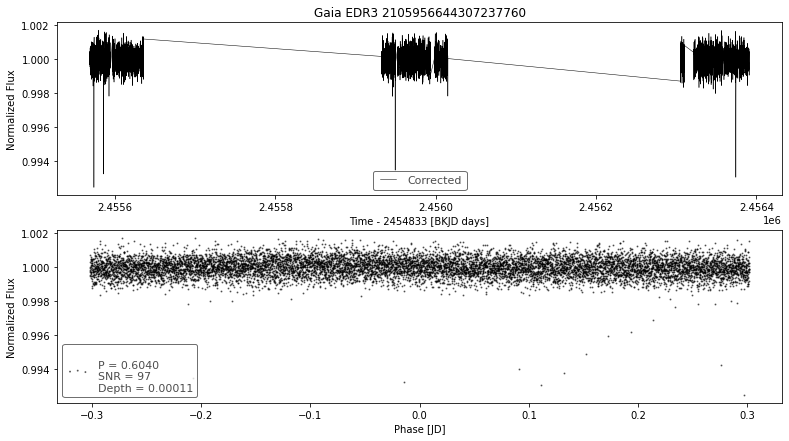

__________________________________________
index                                          78
designation         Gaia EDR3 2105956644307734016
BLS_period                              28.328454
BLS_period_SNR                         187.423462
BLS_duration                                0.126
BLS_depth                                0.001588
BLS_transit_time                   2455581.068322
batch                                          91
Name: 9078, dtype: object
ra                          284.939289
ra_error                      0.164429
dec                          44.370608
dec_error                     0.175635
pmra                        -20.748747
pmdec                        -8.290864
parallax                      1.560995
parallax_error                0.175640
phot_g_n_obs                168.000000
phot_g_mean_flux            968.966040
phot_g_mean_flux_error       16.815647
phot_g_mean_mag              18.221596
phot_bp_n_obs                 2.000000
phot_bp_mean_flux       

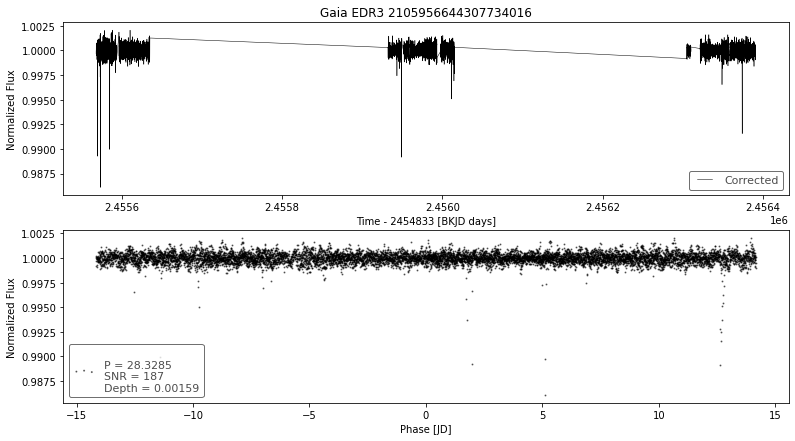

__________________________________________
index                                          14
designation         Gaia EDR3 2086538891008244352
BLS_period                                0.78576
BLS_period_SNR                          80.838452
BLS_duration                                 0.45
BLS_depth                                0.002573
BLS_transit_time                   2455568.951894
batch                                          92
Name: 9114, dtype: object
ra                          298.100620
ra_error                      0.045823
dec                          48.172379
dec_error                     0.049648
pmra                         -1.805872
pmdec                        -3.147216
parallax                      0.498214
parallax_error                0.052058
phot_g_n_obs                381.000000
phot_g_mean_flux           2820.664035
phot_g_mean_flux_error        1.846948
phot_g_mean_mag              17.061490
phot_bp_n_obs                41.000000
phot_bp_mean_flux       

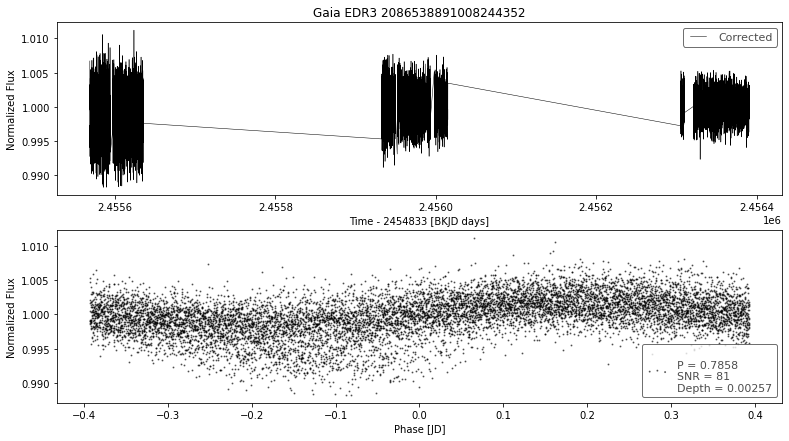

__________________________________________
index                                          15
designation         Gaia EDR3 2086538891010054528
BLS_period                                0.78576
BLS_period_SNR                         148.462188
BLS_duration                                 0.45
BLS_depth                                0.004855
BLS_transit_time                   2455568.954894
batch                                          92
Name: 9115, dtype: object
ra                          298.100358
ra_error                      0.437941
dec                          48.171523
dec_error                     0.549437
pmra                         -6.499390
pmdec                       -15.794841
parallax                     -2.253540
parallax_error                0.542813
phot_g_n_obs                321.000000
phot_g_mean_flux            928.722627
phot_g_mean_flux_error        3.921535
phot_g_mean_mag              18.267653
phot_bp_n_obs                22.000000
phot_bp_mean_flux       

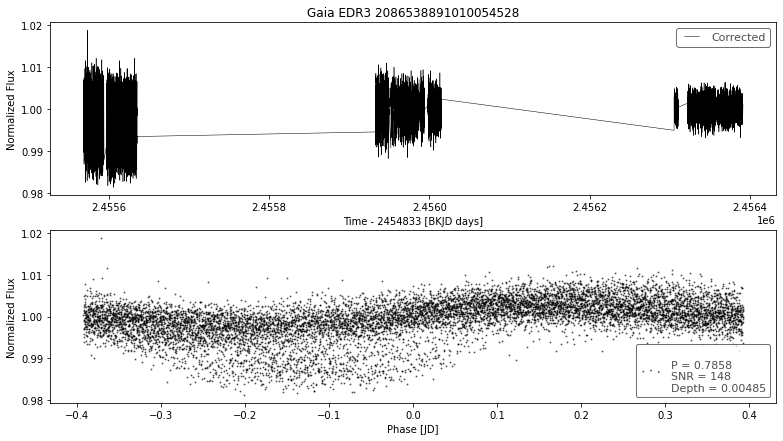

__________________________________________
index                                          62
designation         Gaia EDR3 2126185081277282048
BLS_period                               0.645169
BLS_period_SNR                          93.582815
BLS_duration                                0.399
BLS_depth                                0.015146
BLS_transit_time                   2455568.562909
batch                                          92
Name: 9162, dtype: object
ra                         291.792166
ra_error                     0.293030
dec                         44.321463
dec_error                    0.332402
pmra                        -3.137398
pmdec                       -1.683774
parallax                    -0.024089
parallax_error               0.335272
phot_g_n_obs               347.000000
phot_g_mean_flux           213.676787
phot_g_mean_flux_error       0.831279
phot_g_mean_mag             19.862974
phot_bp_n_obs               33.000000
phot_bp_mean_flux           73.473946

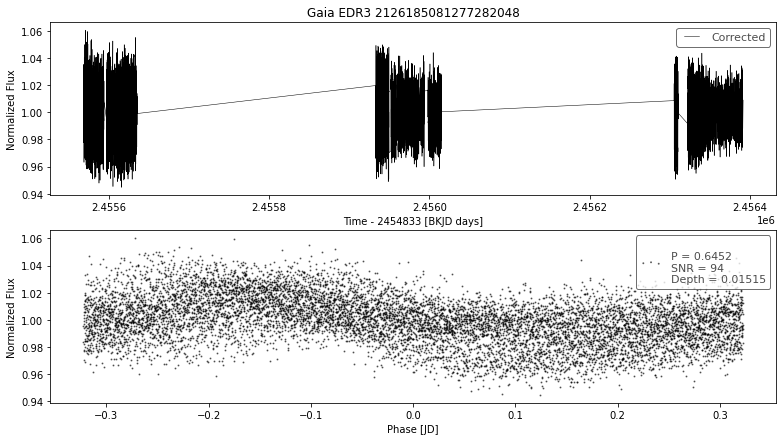

__________________________________________
index                                          63
designation         Gaia EDR3 2126185081280264192
BLS_period                               0.645087
BLS_period_SNR                          370.16712
BLS_duration                                 0.45
BLS_depth                                0.019104
BLS_transit_time                   2455568.588409
batch                                          92
Name: 9163, dtype: object
ra                          291.790600
ra_error                      0.056233
dec                          44.321074
dec_error                     0.060430
pmra                         -3.944730
pmdec                        -1.855432
parallax                      0.557631
parallax_error                0.062798
phot_g_n_obs                358.000000
phot_g_mean_flux           2057.572888
phot_g_mean_flux_error        4.141082
phot_g_mean_mag              17.403978
phot_bp_n_obs                34.000000
phot_bp_mean_flux       

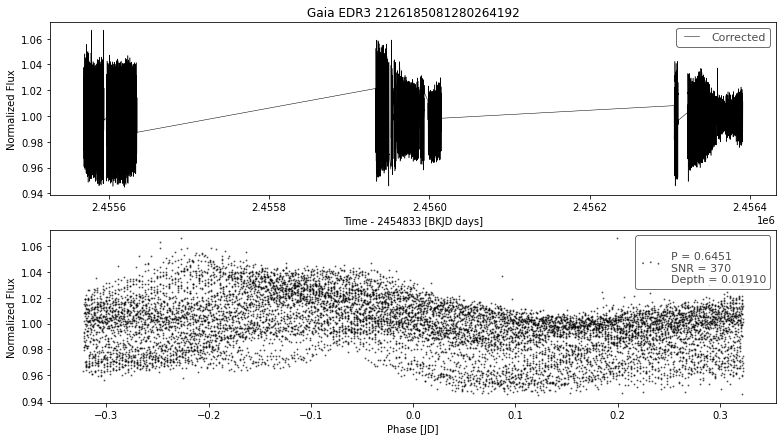

__________________________________________
index                                          98
designation         Gaia EDR3 2078734140854317440
BLS_period                               0.525966
BLS_period_SNR                         304.336778
BLS_duration                                 0.45
BLS_depth                                0.061087
BLS_transit_time                   2455568.642432
batch                                          92
Name: 9198, dtype: object
ra                         297.190426
ra_error                     0.103538
dec                         43.252601
dec_error                    0.137404
pmra                        -2.399501
pmdec                       -3.429649
parallax                    -0.057734
parallax_error               0.130863
phot_g_n_obs               368.000000
phot_g_mean_flux           660.350700
phot_g_mean_flux_error       2.241957
phot_g_mean_mag             18.637930
phot_bp_n_obs               42.000000
phot_bp_mean_flux          313.488364

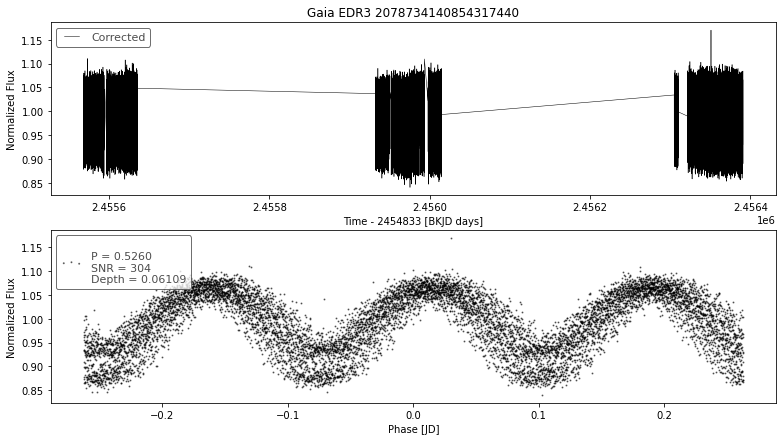

__________________________________________
index                                          18
designation         Gaia EDR3 2101466307541720320
BLS_period                               0.502322
BLS_period_SNR                           9.659386
BLS_duration                                 0.45
BLS_depth                                0.000063
BLS_transit_time                     2455568.6571
batch                                          93
Name: 9218, dtype: object
ra                           289.860822
ra_error                       0.011883
dec                           41.308028
dec_error                      0.013239
pmra                          -2.718299
pmdec                          0.243861
parallax                       0.246172
parallax_error                 0.014410
phot_g_n_obs                 370.000000
phot_g_mean_flux           36339.113368
phot_g_mean_flux_error         6.306000
phot_g_mean_mag               14.286431
phot_bp_n_obs                 41.000000
phot_bp_mea

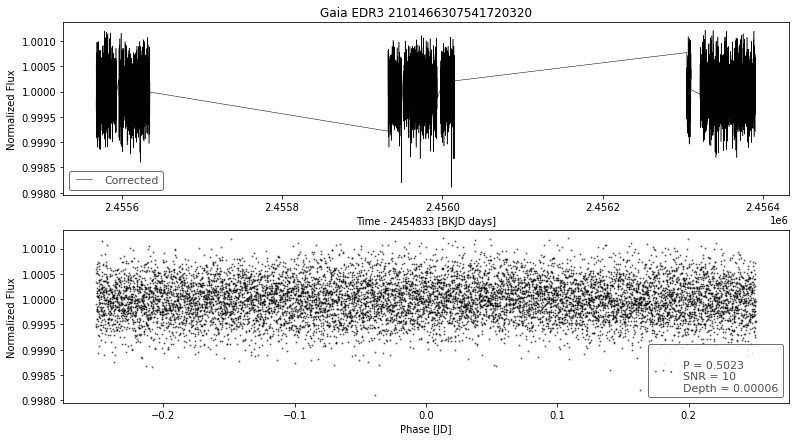

__________________________________________


In [32]:
lcs_dict = {}
for idx, row in to_check.iterrows():
    if not row.batch in lcs_dict.keys():
        aux = pickle.load(open("../data/export/long_bls/bls_shortP_results_%02i.pkl" % (row.batch), "rb"))
        lcs_dict[row.batch] = aux["lc_corrected"]
    lc = lcs_dict[row.batch][row["index"]]
    qua = np.isfinite(big_df.loc[row.designation, ([str(q) for q in quarters], "channel")])
    print(row)
    print(big_df.loc[row.designation, str(quarters[qua][0])])
    
    fig = plt.figure(figsize=(13, 7))
    sub1 = fig.add_subplot(2, 3, (1,3))
    sub1.set_title(row.designation)
    lc.plot(ax=sub1, c="k", label="Corrected")

    sub2 = fig.add_subplot(2, 3, (4,6))
    folded_clc = lc.fold(row.BLS_period)
    info = "\nP = %.4f  \nSNR = %.0f \nDepth = %.5f" % (row.BLS_period, row.BLS_period_SNR, row.BLS_depth)
    folded_clc.scatter(ax=sub2, alpha=.5, c='k', marker='.', 
                                   label=info)

    plt.show()
    print("__________________________________________")
    
    # break
    

In [ ]:
highlights = ["Gaia EDR3 2133277755910244992", "Gaia EDR3 2077708781842667776", "Gaia EDR3 2073608462483635968", "Gaia EDR3 2135153763266322048", "Gaia EDR3 2073620316593418112", "Gaia EDR3 2073685836299371776"]